# Your first neural network

In this project, you'll build your first neural network and use it to predict daily bike rental ridership. We've provided some of the code, but left the implementation of the neural network up to you (for the most part). After you've submitted this project, feel free to explore the data and the model more.



In [2]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

## Load and prepare the data

A critical step in working with neural networks is preparing the data correctly. Variables on different scales make it difficult for the network to efficiently learn the correct weights. Below, we've written the code to load and prepare the data. You'll learn more about this soon!

In [3]:
data_path = 'Bike-Sharing-Dataset/hour.csv'

rides = pd.read_csv(data_path)

In [4]:
rides.head()

,instant,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
0,1,2011-01-01,1,0,1,0,0,6,0,1,0.24,0.2879,0.81,0.0,3,13,16
1,2,2011-01-01,1,0,1,1,0,6,0,1,0.22,0.2727,0.80,0.0,8,32,40
2,3,2011-01-01,1,0,1,2,0,6,0,1,0.22,0.2727,0.80,0.0,5,27,32
3,4,2011-01-01,1,0,1,3,0,6,0,1,0.24,0.2879,0.75,0.0,3,10,13
4,5,2011-01-01,1,0,1,4,0,6,0,1,0.24,0.2879,0.75,0.0,0,1,1


## Checking out the data

This dataset has the number of riders for each hour of each day from January 1 2011 to December 31 2012. The number of riders is split between casual and registered, summed up in the `cnt` column. You can see the first few rows of the data above.

Below is a plot showing the number of bike riders over the first 10 days or so in the data set. (Some days don't have exactly 24 entries in the data set, so it's not exactly 10 days.) You can see the hourly rentals here. This data is pretty complicated! The weekends have lower over all ridership and there are spikes when people are biking to and from work during the week. Looking at the data above, we also have information about temperature, humidity, and windspeed, all of these likely affecting the number of riders. You'll be trying to capture all this with your model.

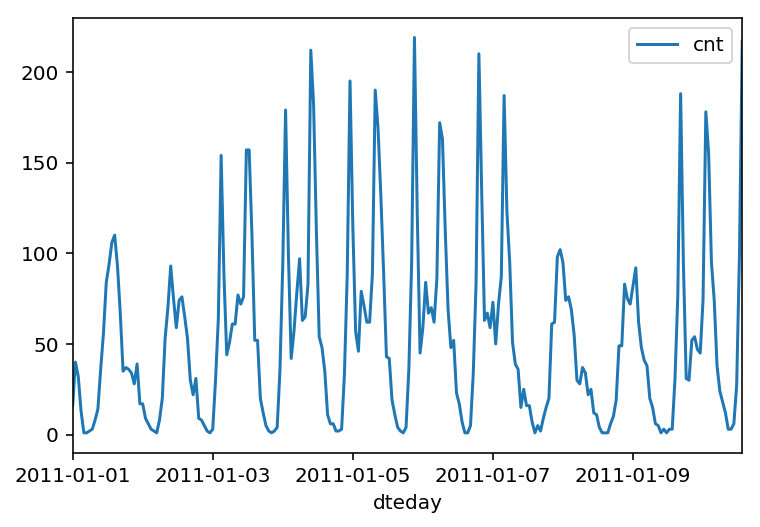

In [5]:
rides[:24*10].plot(x='dteday', y='cnt')

### Dummy variables
Here we have some categorical variables like season, weather, month. To include these in our model, we'll need to make binary dummy variables. This is simple to do with Pandas thanks to `get_dummies()`.

In [6]:
dummy_fields = ['season', 'weathersit', 'mnth', 'hr', 'weekday']
for each in dummy_fields:
    dummies = pd.get_dummies(rides[each], prefix=each, drop_first=False)
    rides = pd.concat([rides, dummies], axis=1)

fields_to_drop = ['instant', 'dteday', 'season', 'weathersit', 
                  'weekday', 'atemp', 'mnth', 'workingday', 'hr']
data = rides.drop(fields_to_drop, axis=1)
data.head()

,yr,holiday,temp,hum,windspeed,casual,registered,cnt,season_1,season_2,...,hr_21,hr_22,hr_23,weekday_0,weekday_1,weekday_2,weekday_3,weekday_4,weekday_5,weekday_6
0,0,0,0.24,0.81,0.0,3,13,16,1,0,...,0,0,0,0,0,0,0,0,0,1
1,0,0,0.22,0.80,0.0,8,32,40,1,0,...,0,0,0,0,0,0,0,0,0,1
2,0,0,0.22,0.80,0.0,5,27,32,1,0,...,0,0,0,0,0,0,0,0,0,1
3,0,0,0.24,0.75,0.0,3,10,13,1,0,...,0,0,0,0,0,0,0,0,0,1
4,0,0,0.24,0.75,0.0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,1


### Scaling target variables
To make training the network easier, we'll standardize each of the continuous variables. That is, we'll shift and scale the variables such that they have zero mean and a standard deviation of 1.

The scaling factors are saved so we can go backwards when we use the network for predictions.

In [7]:
quant_features = ['casual', 'registered', 'cnt', 'temp', 'hum', 'windspeed']
# Store scalings in a dictionary so we can convert back later
scaled_features = {}
for each in quant_features:
    mean, std = data[each].mean(), data[each].std()
    scaled_features[each] = [mean, std]
    data.loc[:, each] = (data[each] - mean)/std

### Splitting the data into training, testing, and validation sets

We'll save the data for the last approximately 21 days to use as a test set after we've trained the network. We'll use this set to make predictions and compare them with the actual number of riders.

In [8]:
# Save data for approximately the last 21 days 
test_data = data[-21*24:]

# Now remove the test data from the data set 
data = data[:-21*24]

# Separate the data into features and targets
target_fields = ['cnt', 'casual', 'registered']
features, targets = data.drop(target_fields, axis=1), data[target_fields]
test_features, test_targets = test_data.drop(target_fields, axis=1), test_data[target_fields]

We'll split the data into two sets, one for training and one for validating as the network is being trained. Since this is time series data, we'll train on historical data, then try to predict on future data (the validation set).

In [9]:
# Hold out the last 60 days or so of the remaining data as a validation set
train_features, train_targets = features[:-60*24], targets[:-60*24]
val_features, val_targets = features[-60*24:], targets[-60*24:]

## Time to build the network

Below you'll build your network. We've built out the structure and the backwards pass. You'll implement the forward pass through the network. You'll also set the hyperparameters: the learning rate, the number of hidden units, and the number of training passes.

<img src="assets/neural_network.png" width=300px>

The network has two layers, a hidden layer and an output layer. The hidden layer will use the sigmoid function for activations. The output layer has only one node and is used for the regression, the output of the node is the same as the input of the node. That is, the activation function is $f(x)=x$. A function that takes the input signal and generates an output signal, but takes into account the threshold, is called an activation function. We work through each layer of our network calculating the outputs for each neuron. All of the outputs from one layer become inputs to the neurons on the next layer. This process is called *forward propagation*.

We use the weights to propagate signals forward from the input to the output layers in a neural network. We use the weights to also propagate error backwards from the output back into the network to update our weights. This is called *backpropagation*.

> **Hint:** You'll need the derivative of the output activation function ($f(x) = x$) for the backpropagation implementation. If you aren't familiar with calculus, this function is equivalent to the equation $y = x$. What is the slope of that equation? That is the derivative of $f(x)$.

Below, you have these tasks:
1. Implement the sigmoid function to use as the activation function. Set `self.activation_function` in `__init__` to your sigmoid function.
2. Implement the forward pass in the `train` method.
3. Implement the backpropagation algorithm in the `train` method, including calculating the output error.
4. Implement the forward pass in the `run` method.
  

In [10]:
#############
# In the my_answers.py file, fill out the TODO sections as specified
#############

from my_answers import NeuralNetwork

In [11]:
def MSE(y, Y):
    return np.mean((y-Y)**2)

## Unit tests

Run these unit tests to check the correctness of your network implementation. This will help you be sure your network was implemented correctly befor you starting trying to train it. These tests must all be successful to pass the project.

In [12]:
import unittest

inputs = np.array([[0.5, -0.2, 0.1]])
targets = np.array([[0.4]])
test_w_i_h = np.array([[0.1, -0.2],
                       [0.4, 0.5],
                       [-0.3, 0.2]])
test_w_h_o = np.array([[0.3],
                       [-0.1]])

class TestMethods(unittest.TestCase):
    
    ##########
    # Unit tests for data loading
    ##########
    
    def test_data_path(self):
        # Test that file path to dataset has been unaltered
        self.assertTrue(data_path.lower() == 'bike-sharing-dataset/hour.csv')
        
    def test_data_loaded(self):
        # Test that data frame loaded
        self.assertTrue(isinstance(rides, pd.DataFrame))
    
    ##########
    # Unit tests for network functionality
    ##########

    def test_activation(self):
        network = NeuralNetwork(3, 2, 1, 0.5)
        # Test that the activation function is a sigmoid
        self.assertTrue(np.all(network.activation_function(0.5) == 1/(1+np.exp(-0.5))))

    def test_train(self):
        # Test that weights are updated correctly on training
        network = NeuralNetwork(3, 2, 1, 0.5)
        network.weights_input_to_hidden = test_w_i_h.copy()
        network.weights_hidden_to_output = test_w_h_o.copy()
        
        network.train(inputs, targets)
        #print("network.weights_hidden_to_output", network.weights_hidden_to_output)
        #print("network.weights_input_to_hidden", network.weights_input_to_hidden)
        self.assertTrue(np.allclose(network.weights_hidden_to_output, 
                                    np.array([[ 0.37275328], 
                                              [-0.03172939]])))
        self.assertTrue(np.allclose(network.weights_input_to_hidden,
                                    np.array([[ 0.10562014, -0.20185996], 
                                              [0.39775194, 0.50074398], 
                                              [-0.29887597, 0.19962801]])))

    def test_run(self):
        # Test correctness of run method
        network = NeuralNetwork(3, 2, 1, 0.5)
        network.weights_input_to_hidden = test_w_i_h.copy()
        network.weights_hidden_to_output = test_w_h_o.copy()

        #print(network.run(inputs))
        self.assertTrue(np.allclose(network.run(inputs), 0.09998924))

suite = unittest.TestLoader().loadTestsFromModule(TestMethods())
unittest.TextTestRunner().run(suite)

.....

[[ 0.09998924]]
error:  [ 0.30001076]
output_error_term:  [ 0.30001076]
hidden_error:  [ 0.09000323 -0.03000108]
hidden_error_term:  [ 0.02248057 -0.00743984]
   hidden_outputs: [ 0.4850045   0.45512111]
delta_weights_i_h:  [[ 0.01124028 -0.00371992]
 [-0.00449611  0.00148797]
 [ 0.00224806 -0.00074398]]
     hidden_error_term:  [ 0.02248057 -0.00743984]
     X[:,None]:  [[ 0.5]
 [-0.2]
 [ 0.1]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ 0.01124028 -0.00371992]
 [-0.00449611  0.00148797]
 [ 0.00224806 -0.00074398]]
     hidden_outputs[:,None]:  [[ 0.4850045 ]
 [ 0.45512111]]
     output_error_term:  [ 0.30001076]
network.weights_hidden_to_output [[ 0.37275328]
 [-0.03172939]]
network.weights_input_to_hidden [[ 0.10562014 -0.20185996]
 [ 0.39775194  0.50074398]
 [-0.29887597  


----------------------------------------------------------------------
Ran 5 tests in 0.015s

OK


<unittest.runner.TextTestResult run=5 errors=0 failures=0>

## Training the network

Here you'll set the hyperparameters for the network. The strategy here is to find hyperparameters such that the error on the training set is low, but you're not overfitting to the data. If you train the network too long or have too many hidden nodes, it can become overly specific to the training set and will fail to generalize to the validation set. That is, the loss on the validation set will start increasing as the training set loss drops.

You'll also be using a method know as Stochastic Gradient Descent (SGD) to train the network. The idea is that for each training pass, you grab a random sample of the data instead of using the whole data set. You use many more training passes than with normal gradient descent, but each pass is much faster. This ends up training the network more efficiently. You'll learn more about SGD later.

### Choose the number of iterations
This is the number of batches of samples from the training data we'll use to train the network. The more iterations you use, the better the model will fit the data. However, this process can have sharply diminishing returns and can waste computational resources if you use too many iterations.  You want to find a number here where the network has a low training loss, and the validation loss is at a minimum. The ideal number of iterations would be a level that stops shortly after the validation loss is no longer decreasing.

### Choose the learning rate
This scales the size of weight updates. If this is too big, the weights tend to explode and the network fails to fit the data. Normally a good choice to start at is 0.1; however, if you effectively divide the learning rate by n_records, try starting out with a learning rate of 1. In either case, if the network has problems fitting the data, try reducing the learning rate. Note that the lower the learning rate, the smaller the steps are in the weight updates and the longer it takes for the neural network to converge.

### Choose the number of hidden nodes
In a model where all the weights are optimized, the more hidden nodes you have, the more accurate the predictions of the model will be.  (A fully optimized model could have weights of zero, after all.) However, the more hidden nodes you have, the harder it will be to optimize the weights of the model, and the more likely it will be that suboptimal weights will lead to overfitting. With overfitting, the model will memorize the training data instead of learning the true pattern, and won't generalize well to unseen data.  

Try a few different numbers and see how it affects the performance. You can look at the losses dictionary for a metric of the network performance. If the number of hidden units is too low, then the model won't have enough space to learn and if it is too high there are too many options for the direction that the learning can take. The trick here is to find the right balance in number of hidden units you choose.  You'll generally find that the best number of hidden nodes to use ends up being between the number of input and output nodes.

In [13]:
import sys

####################
### Set the hyperparameters in you myanswers.py file ###
####################

from my_answers import iterations, learning_rate, hidden_nodes, output_nodes


N_i = train_features.shape[1]
network = NeuralNetwork(N_i, hidden_nodes, output_nodes, learning_rate)

losses = {'train':[], 'validation':[]}
for ii in range(iterations):
    # Go through a random batch of 128 records from the training data set
    batch = np.random.choice(train_features.index, size=128)
    X, y = train_features.ix[batch].values, train_targets.ix[batch]['cnt']
                             
    network.train(X, y)
    
    # Printing out the training progress
    train_loss = MSE(network.run(train_features).T, train_targets['cnt'].values)
    val_loss = MSE(network.run(val_features).T, val_targets['cnt'].values)
    sys.stdout.write("\rProgress: {:2.1f}".format(100 * ii/float(iterations)) \
                     + "% ... Training loss: " + str(train_loss)[:5] \
                     + " ... Validation loss: " + str(val_loss)[:5])
    sys.stdout.flush()
    
    losses['train'].append(train_loss)
    losses['validation'].append(val_loss)

D:\Anaconda3\lib\site-packages\ipykernel\__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate_ix


error:  [-1.05113991]
output_error_term:  [-1.05113991]
hidden_error:  [ 0.28556613 -0.41845495]
hidden_error_term:  [ 0.06401031 -0.10460432]
   hidden_outputs: [ 0.66077219  0.49525509]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.09207722  0.15047069]
 [ 0.02082623 -0.03403379]
 [ 0.0489219  -0.07994716]
 [ 0.06401031 -0.10460432]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06401031 -0.10460432]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06401031 -0.10460432]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06401031 -0.10460432]
 [ 0.    

hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.2167171   0.2909384 ]
 [ 0.          0.        ]
 [-0.34354919  0.52716114]
 [-0.0009599   0.02668649]
 [-0.10931093  0.08284736]
 [ 0.12106667 -0.20499379]
 [-0.11873831  0.14885581]
 [ 0.05187171 -0.07545541]
 [-0.06781297  0.09816167]
 [-0.04008675  0.00522675]
 [ 0.02647385 -0.03865847]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.0589817  -0.1030886 ]
 [ 0.06208496 -0.10190519]
 [-0.11873831  0.14885581]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.01800629  0.02693897]
 [-0.00176663  0.00256332]
 [ 0.00383167 -0.00679603]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06401031 -0.10460432]
 [ 0.07164464 -0.10495771]
 [ 0.0589817  -0.1030886 ]
 [ 0.          0.        ]
 [ 0.          

     hidden_outputs[:,None]:  [[ 0.48948101]
 [ 0.59457175]]
     output_error_term:  [-0.9442557]
error:  [-0.84021904]
output_error_term:  [-0.84021904]
hidden_error:  [ 0.22826466 -0.33448812]
hidden_error_term:  [ 0.05698832 -0.08361245]
   hidden_outputs: [ 0.51846675  0.5053511 ]
delta_weights_i_h:  [[ -2.13629815e-01   2.49702786e-01]
 [ -3.68199832e-04   5.41095349e-04]
 [ -1.53481393e+00   2.26743553e+00]
 [  1.10373227e+00  -1.55933063e+00]
 [ -1.10325447e+00   1.48216282e+00]
 [  3.90704255e-01  -6.41891052e-01]
 [ -3.06614092e-01   4.24420242e-01]
 [  1.84028996e-01  -2.80241816e-01]
 [  2.14839439e-01  -3.05222871e-01]
 [ -3.31113735e-01   4.05217881e-01]
 [  5.88078579e-01  -8.82517733e-01]
 [  2.25993756e-01  -3.25635645e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  2.69309107e-02  -5.75961840e-02]
 [  2.18072013e-01  -3.49977960e-01]
 [  7.29077978e-02  -1.23570316e-01]
 [ -8.12171039e-02   9.36446450e-02]
 [ -2.00351810e-01   2.91928856e-01]
 [  1.40675855e-01  -2.0897

output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -1.39756430e-01   9.18782142e-02]
 [ -3.68199832e-04   5.41095349e-04]
 [ -2.25028408e+00   3.32871700e+00]
 [  1.78736177e+00  -2.59398736e+00]
 [ -9.35276857e-01   1.22948094e+00]
 [  5.72052060e-01  -9.37281330e-01]
 [ -1.81950842e-01   2.13974045e-01]
 [  3.10781115e-01  -4.62162343e-01]
 [  2.15279676e-01  -3.02600457e-01]
 [ -4.30289795e-02  -1.93877890e-02]
 [  6.63888639e-01  -1.02576367e+00]
 [  2.95302348e-01  -4.42918626e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  1.17546358e-01  -1.92194881e-01]
 [  3.74574042e-01  -5.84052247e-01]
 [  7.60311734e-02  -1.53832001e-01]
 [ -2.57142086e-02  -1.88797736e-03]
 [ -1.43490098e-01   2.01596498e-01]
 [  6.76438294e-02  -1.05524488e-01]
 [  3.02527222e-02  -4.60159418e-02]
 [ -1.91031217e-01   2.60142116e-01]
 [  1.74743117e-01  -2.36513432e-01]
 [  

Progress: 0.0% ... Training loss: 0.960 ... Validation loss: 1.303error:  [-0.84461882]
output_error_term:  [-0.84461882]
hidden_error:  [ 0.23483125 -0.33234512]
hidden_error_term:  [ 0.05690284 -0.08255711]
   hidden_outputs: [ 0.41232861  0.53990289]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.01271085 -0.01844145]
 [ 0.09224891 -0.13383872]
 [-0.0467434   0.06781736]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05690284 -0.08255711]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05690284 -0.08255711]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05690284 -0.08255711]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.       

error:  [-0.69208056]
output_error_term:  [-0.69208056]
hidden_error:  [ 0.1924207  -0.27232355]
hidden_error_term:  [ 0.04423551 -0.06791668]
   hidden_outputs: [ 0.6418112   0.52455578]
delta_weights_i_h:  [[ 0.02720564 -0.04514924]
 [ 0.          0.        ]
 [-0.23690768  0.34964641]
 [ 0.13450632 -0.19164498]
 [-0.01739931  0.01827677]
 [ 0.04423551 -0.06791668]
 [ 0.06103678 -0.09297354]
 [-0.0427601   0.06200401]
 [ 0.1277734  -0.18107071]
 [ 0.13338276 -0.19739981]
 [ 0.          0.        ]
 [ 0.05690284 -0.08255711]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.04423551 -0.06791668]
 [ 0.          0.        ]
 [ 0.06103678 -0.09297354]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.0427601   0.06200401]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05690284 -0.08255711]
 [ 0.07087057 -0.0985136 ]
 [ 0.          0.        ]
 [ 0.06103678 -0.09297354]
 [ 0.          0.        ]
 [ 0.07087057 -0.0985136 ]
 [ 0.          0.        ]
 [ 0.    

delta_weights_i_h:  [[ 0.01918831 -0.03392479]
 [ 0.          0.        ]
 [-0.26748509  0.39275832]
 [ 0.13359811 -0.1900515 ]
 [-0.03099938  0.03762232]
 [ 0.05809486 -0.08769154]
 [ 0.06103678 -0.09297354]
 [-0.05077743  0.07322846]
 [ 0.1277734  -0.18107071]
 [ 0.13922477 -0.20595022]
 [ 0.          0.        ]
 [ 0.05690284 -0.08255711]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05809486 -0.08769154]
 [ 0.          0.        ]
 [ 0.06103678 -0.09297354]
 [ 0.          0.        ]
 [-0.00801733  0.01122445]
 [-0.0427601   0.06200401]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05690284 -0.08255711]
 [ 0.07087057 -0.0985136 ]
 [ 0.          0.        ]
 [ 0.06103678 -0.09297354]
 [ 0.          0.        ]
 [ 0.07087057 -0.0985136 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.03383114  0.04782431]
 [ 0.          0.        ]
 [ 0.   

     hidden_error_term:  [ 0.01311049 -0.01828173]
     X[:,None]:  [[ 0.        ]
 [ 0.        ]
 [-0.5036826 ]
 [ 0.16986051]
 [-0.45608552]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T

 [ -3.38457594e-01   4.34763816e-01]]
     hidden_outputs[:,None]:  [[ 0.599114  ]
 [ 0.46551295]]
     output_error_term:  [-0.27826618]
error:  [ 2.0543863]
output_error_term:  [ 2.0543863]
hidden_error:  [-0.5711856   0.80837089]
hidden_error_term:  [-0.14266627  0.18050138]
   hidden_outputs: [ 0.48490607  0.66343102]
delta_weights_i_h:  [[ -7.43415853e-01   1.05078631e+00]
 [ -3.10066554e-02   5.77735044e-02]
 [ -1.87989319e+00   2.65000720e+00]
 [  8.98852012e-01  -1.24870249e+00]
 [ -5.40420077e-01   6.10031685e-01]
 [  3.58426015e-01  -5.02583531e-01]
 [ -1.25798847e-01   1.45712597e-01]
 [ -4.66015324e-01   6.55202933e-01]
 [  8.83305322e-02  -1.59222505e-01]
 [ -5.00918142e-01   6.53253193e-01]
 [  1.39651980e-01  -2.15631613e-01]
 [  2.16208539e-01  -2.98512087e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  1.26950359e-01  -1.79615602e-01]
 [  1.99191298e-01  -2.82756010e-01]
 [  1.05581413e-01  -1.50739717e-01]
 [ -6.20799571e-02   7.27872764e-02]
 [  1.60066550e-02  -2.2862

 [ -2.14075068e-01   2.55678432e-01]]
     hidden_outputs[:,None]:  [[ 0.42085926]
 [ 0.61699958]]
     output_error_term:  [ 1.38776953]
error:  [ 1.98671997]
output_error_term:  [ 1.98671997]
hidden_error:  [-0.55237218  0.78174518]
hidden_error_term:  [-0.13807926  0.17868556]
   hidden_outputs: [ 0.49500371  0.64638087]
delta_weights_i_h:  [[ -9.54436913e-01   1.30054211e+00]
 [ -3.10066554e-02   5.77735044e-02]
 [ -2.31247666e+00   3.24899795e+00]
 [  1.52106084e+00  -2.07063547e+00]
 [ -9.22171570e-01   1.07370679e+00]
 [  5.73782751e-01  -8.15799528e-01]
 [ -1.19813686e-01   1.15479187e-01]
 [ -1.91071432e-01   2.69701159e-01]
 [ -5.48786148e-02  -8.55949375e-03]
 [ -1.60865779e-01   1.14136542e-01]
 [ -2.14391157e-02  -7.14924902e-03]
 [  3.90323914e-01  -5.46165969e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  1.53085600e-01  -2.19131434e-01]
 [  3.37833450e-01  -4.78524530e-01]
 [  1.54368418e-01  -2.31377483e-01]
 [ -2.04672736e-02   1.46849032e-02]
 [  6.74596370e-02  -9.66

output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -6.24806803e-01   8.31862521e-01]
 [ -3.10066554e-02   5.77735044e-02]
 [ -2.46338338e+00   3.46736954e+00]
 [  1.79157747e+00  -2.44905389e+00]
 [ -9.79598875e-01   1.13359309e+00]
 [  8.35416766e-01  -1.18835015e+00]
 [  2.21739993e-02  -8.28679746e-02]
 [ -1.98884298e-01   2.76598091e-01]
 [ -2.06553402e-01   2.01812733e-01]
 [ -2.02469029e-01   1.64390261e-01]
 [  1.33986697e-01  -2.28657379e-01]
 [  5.20635397e-01  -7.28540182e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  2.12843922e-01  -3.01940956e-01]
 [  3.78424178e-01  -5.36155369e-01]
 [  3.25496884e-01  -4.78603993e-01]
 [ -2.04672736e-02   1.46849032e-02]
 [  1.38012798e-01  -1.96176681e-01]
 [ -4.00612474e-01   5.40166466e-01]
 [ -2.09959096e-01   2.97220787e-01]
 [  1.20296590e-01  -1.71348387e-01]


Progress: 1.0% ... Training loss: 0.959 ... Validation loss: 1.303error:  [-0.99900988]
output_error_term:  [-0.99900988]
hidden_error:  [ 0.28250392 -0.39262837]
hidden_error_term:  [ 0.07058039 -0.09763444]
   hidden_outputs: [ 0.51270359  0.46351478]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.03775879 -0.05223204]
 [ 0.11442248 -0.15828157]
 [-0.01494082  0.02066776]
 [ 0.          0.        ]
 [ 0.07058039 -0.09763444]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07058039 -0.09763444]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07058039 -0.09763444]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07058039 -0.0976344

output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ 0.043841   -0.06142316]
 [ 0.01463314 -0.01789202]
 [-0.04297563  0.05914355]
 [ 0.186739   -0.26371253]
 [ 0.02455111 -0.02834249]
 [ 0.043841   -0.06142316]
 [ 0.07058039 -0.09763444]
 [ 0.          0.        ]
 [ 0.01463314 -0.01789202]
 [ 0.00673818 -0.00629338]
 [ 0.07058039 -0.09763444]
 [ 0.05173597 -0.0730218 ]
 [ 0.          0.        ]
 [ 0.05173597 -0.0730218 ]
 [-0.00789496  0.01159864]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07058039 -0.09763444]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.01463314 -0.01789202]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07058039 -0.09763444]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.   

hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ 0.28817423 -0.40900716]
 [ 0.0692245  -0.1024762 ]
 [-0.24643284  0.36932531]
 [ 0.39820948 -0.55702604]
 [ 0.08582906 -0.09099046]
 [ 0.39718613 -0.57558684]
 [ 0.04064266 -0.06915712]
 [ 0.13348099 -0.17832012]
 [-0.04450744  0.06531464]
 [ 0.27393978 -0.40870433]
 [ 0.2011266  -0.27602331]
 [ 0.05173597 -0.0730218 ]
 [ 0.          0.        ]
 [ 0.20658848 -0.29988678]
 [ 0.09251747 -0.12878543]
 [ 0.09808018 -0.14691463]
 [-0.0059583   0.00558476]
 [ 0.07481113 -0.11403593]
 [-0.07859535  0.1098593 ]
 [ 0.09147016 -0.12800373]
 [ 0.09088242 -0.12356115]
 [ 0.00151358  0.00267952]
 [ 0.00598883 -0.00797827]
 [-0.05049627  0.07329291]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07058039 -0.09763444]
 [ 0.2129884  -0.30518613]
 [ 0.07309458 -0.10472986]
 [ 0.2164897  -0.30188742]
 [ 0.          0.        ]
 [ 0.00584068 -0.00814221]
 [ 0.02532826 -0.03519747]
 [-0.10782372  0.14777798]

output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ 0.49614564 -0.70965931]
 [ 0.13883708 -0.20023026]
 [-0.74691554  1.0842482 ]
 [ 0.49907178 -0.70221501]
 [-0.05326644  0.09840279]
 [ 0.55269638 -0.79847313]
 [ 0.10651643 -0.16917261]
 [ 0.11721072 -0.15387747]
 [ 0.09782401 -0.13440342]
 [ 0.52170142 -0.7629123 ]
 [ 0.24376767 -0.33881897]
 [ 0.10877845 -0.15419536]
 [ 0.          0.        ]
 [ 0.30712137 -0.44247832]
 [ 0.1570684  -0.22245948]
 [ 0.09808018 -0.14691463]
 [ 0.0628233  -0.098132  ]
 [ 0.14978025 -0.2184056 ]
 [-0.15647229  0.21793023]
 [ 0.09147016 -0.12800373]
 [ 0.07461216 -0.0991185 ]
 [ 0.07423244 -0.09928449]
 [ 0.00598883 -0.00797827]
 [ 0.01911631 -0.02446115]
 [-0.00957356  0.0133793 ]
 [ 0.          0.        ]
 [ 0.07058039 -0.09763444]
 [ 0.35448886 -0.51086689]
 [ 0.07309458 -0.10472986]
 [ 0.29145882 -0.40625708]
 [ 0.   

 [ 1.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ 0.60061623 -0.86886053]
 [ 0.19568574 -0.28060665]
 [-1.10083433  1.55146108]
 [ 1.37932644 -1.89919189]
 [-0.76142395  1.05153964]
 [ 0.74762429 -1.06377489]
 [ 0.16358013 -0.26356417]
 [ 0.29760537 -0.41113809]
 [ 0.19009151 -0.26309233]
 [ 0.90632088 -1.2999271 ]
 [ 0.2685974  -0.38083608]
 [ 0.22398302 -0.3208063 ]
 [ 0.          0.        ]
 [ 0.41248338 -0.58676711]
 [ 0.28398356 -0.39457028]
 [ 0.12510493 -0.18839115]
 [ 0.00744418 -0.02984196]
 [ 0.05258644 -0.08650347]
 [-0.00919312  0.0131185 ]
 [ 0.1331072  -0.18603713]
 [ 0.19288826 -0.27063538]
 [ 0.09471395 -0.12699482]
 [ 0.09825633 -0.13666718]
 [ 0.01911631 -0.02446115]
 [-0.01159013  0.01618165]
 [ 0.02499401 -0.03469712]
 [ 0.07058039 -0.09763444]
 

 [ -2.20314423e-02   1.56486691e-02]]
     hidden_error_term:  [-0.00997241  0.01396419]
     X[:,None]:  [[ 1.        ]
 [ 0.        ]
 [ 1.15817056]
 [-0.45212727]
 [-1.55384381]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,No

Progress: 2.0% ... Training loss: 0.957 ... Validation loss: 1.307error:  [-0.33062758]
output_error_term:  [-0.33062758]
hidden_error:  [ 0.09638375 -0.12764995]
hidden_error_term:  [ 0.02302988 -0.0315697 ]
   hidden_outputs: [ 0.39483093  0.4481798 ]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05059271 -0.06935323]
 [-0.03309259  0.04536381]
 [ 0.0007346  -0.00100701]
 [ 0.          0.        ]
 [ 0.02302988 -0.0315697 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.02302988 -0.0315697 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.02302988 -0.0315697 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.       

output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.15689548  0.20289783]
 [ 0.          0.        ]
 [ 0.10612336 -0.14269321]
 [ 0.21737042 -0.28133712]
 [ 0.04637543 -0.0583404 ]
 [ 0.          0.        ]
 [-0.1338656   0.17132812]
 [ 0.07807319 -0.10302124]
 [ 0.          0.        ]
 [-0.05579241  0.06830688]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.15689548  0.20289783]
 [ 0.          0.        ]
 [ 0.02302988 -0.0315697 ]
 [ 0.          0.        ]
 [ 0.07807319 -0.10302124]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.

output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.22840798  0.30371887]
 [ 0.          0.        ]
 [ 0.1768903  -0.24202166]
 [ 0.1479249  -0.18357906]
 [ 0.08110796 -0.10712211]
 [ 0.          0.        ]
 [-0.20537809  0.27214916]
 [ 0.07807319 -0.10302124]
 [-0.00999939  0.01322101]
 [-0.0657918   0.0815279 ]
 [ 0.          0.        ]
 [-0.0715125   0.10082104]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.22840798  0.30371887]
 [ 0.          0.        ]
 [ 0.02302988 -0.0315697 ]
 [ 0.          0.        ]
 [ 0.07807319 -0.10302124]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.00999939  0.01322101]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.078

hidden_error:  [-0.040342    0.05342866]
hidden_error_term:  [-0.00897609  0.01188425]
   hidden_outputs: [ 0.66583166  0.66603549]
delta_weights_i_h:  [[-0.2746103   0.36627658]
 [ 0.          0.        ]
 [-0.13117346  0.16674952]
 [ 0.46975281 -0.59891808]
 [ 0.04568761 -0.06576357]
 [ 0.03873742 -0.05286798]
 [-0.20537809  0.27214916]
 [ 0.08969082 -0.11839262]
 [-0.04513628  0.05246319]
 [ 0.02121835 -0.04008088]
 [-0.1234824   0.16117794]
 [-0.01982208  0.03225469]
 [ 0.          0.        ]
 [ 0.04771351 -0.06475224]
 [-0.00897609  0.01188425]
 [ 0.          0.        ]
 [-0.22840798  0.30371887]
 [ 0.          0.        ]
 [ 0.02302988 -0.0315697 ]
 [ 0.03037058 -0.04029206]
 [-0.08414664  0.11102469]
 [ 0.14346688 -0.18912525]
 [-0.09556403  0.11964283]
 [ 0.05042775 -0.06717964]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.04703221 -0.0601403 ]
 [ 0.06042713 -0.08040065]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.15318802 -0.2037319 ]
 [ 0.      

delta_weights_i_h:  [[-0.39177272  0.49400786]
 [-0.06466771  0.0902219 ]
 [-1.175738    1.55201217]
 [ 0.77026003 -0.99066012]
 [-0.279354    0.32422904]
 [ 0.28523768 -0.39866276]
 [-0.38527083  0.49083693]
 [ 0.00756655 -0.00739563]
 [ 0.07793926 -0.09801387]
 [ 0.28404127 -0.4087727 ]
 [-0.21293887  0.28596201]
 [-0.08562973  0.10957536]
 [ 0.          0.        ]
 [ 0.17568857 -0.24013289]
 [ 0.07992731 -0.11476501]
 [ 0.08570532 -0.11505317]
 [-0.2753492   0.36259565]
 [-0.16109832  0.19852152]
 [ 0.07290463 -0.10288   ]
 [-0.03429713  0.04992984]
 [-0.08185241  0.1079685 ]
 [ 0.06360306 -0.08182916]
 [ 0.01398603 -0.01392342]
 [ 0.05042775 -0.06717964]
 [-0.00417294  0.00351246]
 [ 0.          0.        ]
 [ 0.04703221 -0.0601403 ]
 [ 0.06042713 -0.08040065]
 [ 0.36628896 -0.48248679]
 [ 0.          0.        ]
 [ 0.27875253 -0.37425651]
 [ 0.12797505 -0.17538065]
 [ 0.00736819 -0.00966534]
 [ 0.          0.        ]
 [-0.00999939  0.01322101]
 [ 0.          0.        ]
 [-0.023

hidden_error_term:  [ 0.03210066 -0.03596325]
   hidden_outputs: [ 0.53235747  0.6985101 ]
delta_weights_i_h:  [[ -1.17073602e+00   1.41007926e+00]
 [ -3.96443510e-02   6.13346726e-02]
 [ -2.75065564e+00   3.55329513e+00]
 [  2.06026382e+00  -2.56227595e+00]
 [ -9.15732642e-01   1.00432109e+00]
 [  6.32566171e-01  -8.65886891e-01]
 [ -6.89344897e-01   8.96435436e-01]
 [ -3.58373478e-01   4.59732032e-01]
 [ -1.15046789e-01   8.83716382e-02]
 [ -2.50370910e-01   1.99297237e-01]
 [ -2.34612311e-01   3.26091939e-01]
 [ -4.52157709e-02   5.32630382e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  2.56396871e-01  -3.45793728e-01]
 [  2.57390245e-01  -3.51541942e-01]
 [ -1.07279736e-01   1.33571166e-01]
 [ -2.84810051e-01   3.74447343e-01]
 [ -2.49858556e-01   3.15948828e-01]
 [ -2.67358456e-02   1.86908968e-02]
 [ -2.03672337e-01   2.75086830e-01]
 [ -1.36046759e-01   1.73029332e-01]
 [ -1.16234279e-01   1.44421080e-01]
 [  3.95613777e-03  -6.14061733e-02]
 [ -2.60769578e-02   3.82149574e-02]
 

Progress: 3.0% ... Training loss: 0.956 ... Validation loss: 1.306error:  [-0.57582246]
output_error_term:  [-0.57582246]
hidden_error:  [ 0.16870515 -0.22338388]
hidden_error_term:  [ 0.04110375 -0.05442654]
   hidden_outputs: [ 0.57973391  0.57971333]
delta_weights_i_h:  [[ 0.04110375 -0.05442654]
 [ 0.          0.        ]
 [-0.06339599  0.08394427]
 [ 0.03680894 -0.04873967]
 [ 0.00131112 -0.00173609]
 [ 0.04110375 -0.05442654]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.04110375 -0.05442654]
 [ 0.          0.        ]
 [ 0.04110375 -0.05442654]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.       

 [ 0.09963776 -0.1319076 ]]
     hidden_outputs[:,None]:  [[ 0.50626656]
 [ 0.48915164]]
     output_error_term:  [-0.79927603]
error:  [-0.49826221]
output_error_term:  [-0.49826221]
hidden_error:  [ 0.14598146 -0.19329525]
hidden_error_term:  [ 0.03616389 -0.04680919]
   hidden_outputs: [ 0.45234851  0.41147992]
delta_weights_i_h:  [[ 0.04110375 -0.05442654]
 [ 0.          0.        ]
 [-0.08247684  0.10932823]
 [ 0.14267571 -0.18748506]
 [-0.05442759  0.07182031]
 [ 0.04110375 -0.05442654]
 [ 0.09469791 -0.12429024]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.09469791 -0.12429024]
 [ 0.          0.        ]
 [ 0.04110375 -0.05442654]
 [ 0.          0.        ]
 [ 0.04110375 -0.05442654]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.09469791 -0.12429024]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0

delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ 0.18095598 -0.24208579]
 [ 0.          0.        ]
 [-0.1795772   0.24439492]
 [ 0.4247183  -0.57049763]
 [-0.12357076  0.16386237]
 [ 0.14209161 -0.19281792]
 [ 0.20820849 -0.27459712]
 [ 0.09052578 -0.12114102]
 [ 0.04163425 -0.05655784]
 [ 0.09469791 -0.12429024]
 [ 0.17562955 -0.23601167]
 [ 0.21213267 -0.28481199]
 [ 0.          0.        ]
 [ 0.06346382 -0.08871663]
 [ 0.          0.        ]
 [ 0.04731136 -0.06480906]
 [ 0.06619922 -0.08549781]
 [ 0.09469791 -0.12429024]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.12170246 -0.16386723]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08908535 -0.11793293]
 [ 0.06619922 -0.08549781]
 [ 0.          0.        ]
 [ 0.05853402 -0.07748106]
 [ 0.          0.        ]
 [ 0.07862779 -0.10410129]
 [ 0.          0.        ]
 [ 0.03616389 -0.04680919]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [

hidden_error:  [ 0.29361061 -0.38877221]
hidden_error_term:  [ 0.06906443 -0.09541584]
   hidden_outputs: [ 0.37844581  0.43238827]
delta_weights_i_h:  [[ 0.30712177 -0.40358664]
 [ 0.09680803 -0.13060441]
 [-1.11429655  1.50440376]
 [ 0.86165745 -1.16004143]
 [ 0.04313476 -0.08119672]
 [ 0.58489416 -0.79233986]
 [ 0.28561858 -0.37698362]
 [ 0.02847745 -0.02784526]
 [ 0.09103717 -0.1125212 ]
 [ 0.5450586  -0.70695437]
 [ 0.10555899 -0.14363169]
 [ 0.33940976 -0.45910388]
 [ 0.          0.        ]
 [ 0.23543774 -0.32497457]
 [ 0.19343596 -0.25568091]
 [ 0.2168982  -0.2888824 ]
 [ 0.09816362 -0.13130696]
 [ 0.01858606 -0.02674148]
 [ 0.          0.        ]
 [-0.16981055  0.22270059]
 [ 0.03460383 -0.04418904]
 [ 0.19486086 -0.24908301]
 [ 0.04940292 -0.05596335]
 [ 0.          0.        ]
 [ 0.11844872 -0.15556881]
 [ 0.06619922 -0.08549781]
 [ 0.072905   -0.09557157]
 [ 0.28667313 -0.36339076]
 [ 0.21876427 -0.29656736]
 [ 0.15289299 -0.20004996]
 [ 0.          0.        ]
 [ 0.112453

delta_weights_h_o:  [[  1.85779955e-01  -3.15787641e-01]
 [  2.33759819e-01  -3.18041319e-01]
 [ -2.29955671e+00   3.00749891e+00]
 [  2.11251472e+00  -2.75364820e+00]
 [ -7.79248812e-02   3.81427588e-02]
 [  9.95736064e-01  -1.34360362e+00]
 [  4.91184075e-01  -6.49693188e-01]
 [  7.62500347e-02  -9.41754436e-02]
 [  1.35679433e-01  -2.25573543e-01]
 [  7.75582711e-01  -1.07414852e+00]
 [  3.68649391e-01  -4.89867926e-01]
 [  5.54617505e-01  -7.49029351e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  3.30200417e-01  -4.52196541e-01]
 [  4.38573720e-01  -5.84200450e-01]
 [  2.45570752e-01  -3.27322213e-01]
 [  2.04706183e-01  -2.78462013e-01]
 [  1.59777533e-01  -2.07866369e-01]
 [ -2.24073385e-03   3.79918845e-03]
 [ -2.87694067e-01   3.75694642e-01]
 [  2.43203061e-02  -2.72620284e-02]
 [  2.61150938e-01  -3.40692900e-01]
 [  1.10295319e-01  -1.91716517e-01]
 [  9.12402456e-04  -1.27686846e-03]
 [  2.13276837e-01  -2.81543728e-01]
 [  1.81203866e-01  -2.46545139e-01]
 [  2.68966342e-01

Progress: 4.0% ... Training loss: 0.954 ... Validation loss: 1.310error:  [-0.92563174]
output_error_term:  [-0.92563174]
hidden_error:  [ 0.28128933 -0.35139417]
hidden_error_term:  [ 0.06764697 -0.08784829]
   hidden_outputs: [ 0.59752478  0.49915567]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.09028226  0.11724314]
 [ 0.02551574 -0.03313548]
 [ 0.00215779 -0.00280217]
 [ 0.06764697 -0.08784829]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06764697 -0.08784829]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06764697 -0.08784829]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.       

hidden_error_term:  [ 0.05050888 -0.05987554]
   hidden_outputs: [ 0.55221454  0.37609967]
delta_weights_i_h:  [[ 0.08400206 -0.08664802]
 [ 0.          0.        ]
 [-0.39713609  0.50279722]
 [ 0.44692117 -0.5458752 ]
 [-0.19523491  0.24349107]
 [ 0.2624191  -0.33071505]
 [ 0.0351968  -0.04465572]
 [-0.14046894  0.17431263]
 [ 0.08400206 -0.08664802]
 [ 0.0905856  -0.09599293]
 [ 0.1505634  -0.19171323]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07320127 -0.09581751]
 [ 0.1098123  -0.13908829]
 [ 0.          0.        ]
 [ 0.0351968  -0.04465572]
 [-0.1498735   0.18651798]
 [ 0.00940456 -0.01220535]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08400206 -0.08664802]
 [ 0.          0.        ]
 [ 0.07940553 -0.09580925]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.15720332 -0.18246553]
 [ 0.0351968  -0.04465572]
 [ 0.06764697 -0.08784829

     output_error_term:  [-0.27803409]
error:  [ 1.26074516]
output_error_term:  [ 1.26074516]
hidden_error:  [-0.38312662  0.47861205]
hidden_error_term:  [-0.09252964  0.11878225]
   hidden_outputs: [ 0.59213083  0.45734618]
delta_weights_i_h:  [[-0.01024034  0.01910262]
 [ 0.          0.        ]
 [-0.94710185  1.18607036]
 [ 0.51228206 -0.62562124]
 [-0.2389421   0.28776186]
 [ 0.6865191  -0.86855292]
 [ 0.13152884 -0.16745449]
 [-0.25595848  0.31041772]
 [ 0.06898719 -0.07241211]
 [ 0.20889584 -0.2591555 ]
 [ 0.26087961 -0.33448652]
 [ 0.1613012  -0.20435977]
 [ 0.          0.        ]
 [ 0.39487789 -0.50203322]
 [-0.00292578  0.00404517]
 [ 0.22509506 -0.28753758]
 [ 0.          0.        ]
 [ 0.07019368 -0.08774038]
 [-0.02681319  0.04049117]
 [ 0.06373117 -0.08121467]
 [-0.23267478  0.27278027]
 [ 0.02288942 -0.02951552]
 [ 0.08400206 -0.08664802]
 [-0.0467044   0.05518023]
 [ 0.07940553 -0.09580925]
 [ 0.07373788 -0.09358551]
 [ 0.          0.        ]
 [ 0.07640194 -0.0929368

hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ 0.14038413 -0.17597993]
 [ 0.          0.        ]
 [-1.04381954  1.32903003]
 [ 0.71079682 -0.86428044]
 [-0.33421545  0.38209062]
 [ 0.88694678 -1.13299775]
 [ 0.06703046 -0.09221432]
 [-0.01642418  0.01254326]
 [ 0.02104803 -0.01021654]
 [ 0.46283164 -0.59295633]
 [ 0.29312404 -0.37339189]
 [ 0.2026454  -0.25653713]
 [ 0.          0.        ]
 [ 0.56822272 -0.73058576]
 [ 0.02415707 -0.03184712]
 [ 0.22509506 -0.28753758]
 [ 0.          0.        ]
 [ 0.0056953  -0.01250022]
 [-0.02681319  0.04049117]
 [ 0.17896919 -0.22614417]
 [-0.1083785   0.11983532]
 [ 0.02288942 -0.02951552]
 [ 0.08400206 -0.08664802]
 [-0.09464356  0.1173758 ]
 [ 0.07940553 -0.09580925]
 [ 0.19406629 -0.24160758]
 [ 0.          0.        ]
 [ 0.18307909 -0.23452833]
 [ 0.0801836  -0.10110093]
 [ 0.14424578 -0.17665725]
 [ 0.15720332 -0.18246553]
 [ 0.18037126 -0.22920031]
 [ 0.10805196 -0.13895953]
 [-0.05118544  0.0666049 ]

hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -1.83800956e-01   2.00984206e-01]
 [  6.92518417e-02  -9.39613717e-02]
 [ -2.27103988e+00   2.83575304e+00]
 [  1.60462066e+00  -1.96120445e+00]
 [ -6.08926957e-02   5.90504434e-02]
 [  1.15658267e+00  -1.47812444e+00]
 [  1.17238419e-01  -1.57670191e-01]
 [ -3.37314021e-01   3.88419645e-01]
 [ -4.11176620e-02   6.01058339e-02]
 [  2.75038735e-01  -4.00816004e-01]
 [  3.43305097e-01  -4.37743570e-01]
 [  2.77045570e-01  -3.48709577e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  5.68222717e-01  -7.30585757e-01]
 [  2.93474856e-01  -3.81002556e-01]
 [  2.25413153e-01  -2.83508835e-01]
 [  6.76934990e-02  -8.61526311e-02]
 [  5.69529980e-03  -1.25002195e-02]
 [ -4.42987231e-02   6.11879330e-02]
 [ -2.75972740e-01   3.38046253e-01]
 [ -1.51263660e-01   1.59014300e-01]
 [  1.99826668e-01  -2.57008544e-01]
 [ -2.36634397e-02   3.90757001e-02]
 [ -4.91437542e-02   6.19744

output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.36009178  0.41412768]
 [ 0.06925184 -0.09396137]
 [-2.9836812   3.72774357]
 [ 1.68680778 -2.07299431]
 [-0.09081885  0.11428303]
 [ 1.32159751 -1.6869799 ]
 [ 0.07578679 -0.10682198]
 [-0.56381519  0.66627553]
 [ 0.0914986  -0.11025628]
 [ 0.43097962 -0.60413589]
 [ 0.21704252 -0.28493717]
 [ 0.27704557 -0.34870958]
 [ 0.          0.        ]
 [ 0.63937055 -0.82210417]
 [ 0.27402506 -0.34676785]
 [ 0.33872996 -0.43508059]
 [ 0.0676935  -0.08615263]
 [ 0.0056953  -0.01250022]
 [-0.21270391  0.26575366]
 [-0.38285972  0.47136743]
 [-0.14461528  0.1507426 ]
 [ 0.20051765 -0.25791966]
 [ 0.03109136 -0.0332421 ]
 [ 0.02871771 -0.03606985]
 [ 0.07940553 -0.09580925]
 [ 0.26660485 -0.32994824]
 [ 0.          0.        ]
 [ 0.33012142 -0.

Progress: 5.0% ... Training loss: 0.952 ... Validation loss: 1.309error:  [-0.94740777]
output_error_term:  [-0.94740777]
hidden_error:  [ 0.29098549 -0.36137534]
hidden_error_term:  [ 0.07145831 -0.09013911]
   hidden_outputs: [ 0.56653226  0.47619832]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.12505723  0.15774997]
 [-0.013789    0.01739376]
 [-0.0325911   0.04111114]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07145831 -0.09013911]
 [ 0.07145831 -0.09013911]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07145831 -0.09013911]
 [ 0.          0.        ]
 [ 0.          0.       

     X[:,None]:  [[ 0.        ]
 [ 0.        ]
 [ 1.98909715]
 [-0.34846264]
 [ 0.88607317]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_ou

 [-0.22776777  0.26310741]]
     hidden_error_term:  [-0.0212752   0.02557479]
     X[:,None]:  [[ 0.        ]
 [ 0.        ]
 [ 0.22337816]
 [ 1.31017145]
 [ 1.61845695]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:

output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.89321132  1.08990351]
 [-0.02906535  0.03618279]
 [-0.64532212  0.76343332]
 [ 0.87613185 -1.07911613]
 [-0.17140763  0.23351174]
 [ 0.23401082 -0.30480062]
 [-0.72378591  0.88874949]
 [-0.12241047  0.14309628]
 [-0.02331199  0.02241904]
 [-0.52730228  0.6369135 ]
 [-0.25647605  0.3162303 ]
 [ 0.14828078 -0.2036796 ]
 [ 0.          0.        ]
 [ 0.07041399 -0.08852415]
 [ 0.02150212 -0.0284358 ]
 [-0.24548058  0.3062596 ]
 [-0.10643456  0.13216169]
 [ 0.          0.        ]
 [-0.30295192  0.35768947]
 [-0.03922311  0.04209443]
 [ 0.20509142 -0.25181808]
 [-0.28562666  0.34951721]
 [-0.0212752   0.02557479]
 [ 0.          0.        ]
 [ 0.06848695 -0.09505498]
 [ 0.          0.        ]
 [ 0.20957337 -0.27202017]
 [ 0.          0.

output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.87649457  1.06603022]
 [-0.02906535  0.03618279]
 [-0.76430602  0.91771119]
 [ 1.20575869 -1.48444972]
 [-0.22629543  0.30761762]
 [ 0.44479781 -0.57328731]
 [-0.78814341  0.96638175]
 [ 0.09251008 -0.11780436]
 [ 0.0035009  -0.01098252]
 [-0.21150281  0.23767397]
 [-0.25647605  0.3162303 ]
 [ 0.22064424 -0.28959671]
 [ 0.          0.        ]
 [ 0.13678515 -0.17089593]
 [ 0.02150212 -0.0284358 ]
 [-0.17314789  0.20953442]
 [-0.17079206  0.20979396]
 [ 0.          0.        ]
 [-0.30295192  0.35768947]
 [-0.03922311  0.04209443]
 [ 0.28616566 -0.35332363]
 [-0.16974533  0.21229761]
 [-0.0212752   0.02557479]
 [ 0.04477786 -0.05557706]
 [ 0.14057008 -0.1844447 ]
 [ 0.          0.        ]
 [ 0.28193684 -0.35793728]
 [ 0.06637117 -0.08237178]
 [ 0.30809781 -0.3894871 ]
 [ 0.          0.        ]
 [ 0.   

delta_weights_h_o:  [[ -1.16605528e+00   1.40600672e+00]
 [ -2.90653534e-02   3.61827891e-02]
 [ -1.07383898e+00   1.31184713e+00]
 [  1.42947741e+00  -1.73596328e+00]
 [ -4.10655948e-01   5.17866007e-01]
 [  5.71719053e-01  -7.36438608e-01]
 [ -6.94306872e-01   8.27112690e-01]
 [  8.25390205e-02  -1.09602840e-01]
 [ -2.10428468e-02   2.27633783e-02]
 [ -8.06543790e-02   5.04180756e-02]
 [ -3.21693352e-01   3.92731172e-01]
 [  3.41256086e-01  -4.39314627e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  1.82416884e-01  -2.30027886e-01]
 [  7.38117893e-02  -9.35832261e-02]
 [ -1.12316867e-01   1.20280605e-01]
 [ -2.81641097e-01   3.45426786e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.59097371e-01   1.72041400e-01]
 [ -1.27161033e-01   1.47242402e-01]
 [  3.64132528e-01  -4.50270082e-01]
 [ -3.21350097e-01   4.00747132e-01]
 [  3.74836467e-02  -4.45583296e-02]
 [  4.47778630e-02  -5.55770569e-02]
 [  2.37852110e-01  -3.07887125e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  3.40695683e-01

delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -1.36171960e+00   1.64700886e+00]
 [ -2.90653534e-02   3.61827891e-02]
 [ -1.13823389e+00   1.40410510e+00]
 [  1.50119539e+00  -1.84056445e+00]
 [ -1.34377627e-01   1.65158590e-01]
 [  5.96069008e-01  -7.82802105e-01]
 [ -9.27503895e-01   1.12939821e+00]
 [  1.06600539e-01  -1.39191415e-01]
 [  2.05239807e-02  -2.48492272e-02]
 [ -3.01611151e-01   3.22650272e-01]
 [ -2.43955302e-01   2.99219817e-01]
 [  3.41256086e-01  -4.39314627e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  2.50472769e-01  -3.19396455e-01]
 [  1.71008169e-01  -2.25604382e-01]
 [ -4.76828436e-01   5.86175110e-01]
 [ -2.81641097e-01   3.45426786e-01]
 [ -5.23612999e-02   6.45588140e-02]
 [ -1.16323836e-01   1.18899829e-01]
 [ -1.15689014e-01   1.33453362e-01]
 [  3.76722027e-01  -4.66069617e-01]
 [ -3.21350097e-01   4.00747132e-01]
 [  3.74836467e-02  -4.45583296e-02]
 [  4.47778630e-02  -5.55770569e-02]
 [  2.79418938e-01  -3.55499730e-01]
 [  0.00000000e+00   0

error:  [ 0.13849221]
output_error_term:  [ 0.13849221]
hidden_error:  [-0.0425363  0.0528259]
hidden_error_term:  [-0.00984355  0.01069596]
   hidden_outputs: [ 0.36367441  0.7180008 ]
delta_weights_i_h:  [[ -1.33455782e+00   1.61565327e+00]
 [  3.59688302e-02  -4.30045457e-02]
 [ -1.31710676e+00   1.62650564e+00]
 [  1.87884676e+00  -2.31534736e+00]
 [ -2.49424681e-01   3.15676093e-01]
 [  5.40576120e-01  -7.08008881e-01]
 [ -8.56692711e-01   1.03903897e+00]
 [  3.38868557e-02  -4.70515473e-02]
 [  9.36359440e-02  -1.13459724e-01]
 [ -2.14467358e-01   2.17793078e-01]
 [ -3.13589208e-01   3.89919124e-01]
 [  3.39462775e-01  -4.37193381e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  3.24625729e-01  -4.11223767e-01]
 [  1.71008169e-01  -2.25604382e-01]
 [ -5.36957937e-01   6.63822223e-01]
 [ -2.81641097e-01   3.45426786e-01]
 [ -5.23612999e-02   6.45588140e-02]
 [ -1.07707548e-01   1.08323339e-01]
 [ -1.04702324e-01   1.19810379e-01]
 [  3.76722027e-01  -4.66069617e-01]
 [ -4.13364576e-0

     hidden_error_term:  [-0.0618469   0.07673671]
     X[:,None]:  [[ 1.        ]
 [ 0.        ]
 [ 1.7813655 ]
 [-0.97045042]
 [-0.82146002]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T

delta_weights_i_h:  [[-1.43912729  1.71820806]
 [ 0.01044927 -0.012829  ]
 [-1.64324338  2.05875971]
 [ 1.92324294 -2.34902687]
 [-0.21514387  0.24249319]
 [ 0.53956806 -0.72924338]
 [-0.99583899  1.20187084]
 [ 0.21216549 -0.26493894]
 [ 0.0473726  -0.05549757]
 [-0.27642682  0.27351742]
 [-0.26135964  0.31644501]
 [ 0.34105362 -0.43777149]
 [ 0.          0.        ]
 [ 0.50324159 -0.63656263]
 [ 0.02840252 -0.0660916 ]
 [-0.57397622  0.70841381]
 [-0.21340804  0.24986782]
 [-0.19789373  0.24621293]
 [-0.12682974  0.13082753]
 [-0.10108071  0.11492033]
 [ 0.45674746 -0.56195211]
 [-0.3614577   0.45396216]
 [ 0.07264637 -0.08552118]
 [ 0.04477786 -0.05557706]
 [ 0.27209749 -0.34630905]
 [ 0.12645854 -0.15409042]
 [ 0.38346922 -0.48121197]
 [ 0.18570601 -0.23067759]
 [ 0.45555347 -0.57533786]
 [ 0.07334772 -0.09806908]
 [ 0.25370962 -0.34136057]
 [ 0.21672605 -0.27089139]
 [-0.39159738  0.48269105]
 [-0.63454872  0.79687929]
 [ 0.08053794 -0.09711363]
 [ 0.14731907 -0.1759041 ]
 [ 0.006

Progress: 6.0% ... Training loss: 0.951 ... Validation loss: 1.309error:  [-0.71190242]
output_error_term:  [-0.71190242]
hidden_error:  [ 0.22050196 -0.27148945]
hidden_error_term:  [ 0.05305555 -0.06776352]
   hidden_outputs: [ 0.59688854  0.47997764]
delta_weights_i_h:  [[ 0.05305555 -0.06776352]
 [ 0.          0.        ]
 [-0.07080843  0.09043782]
 [ 0.06676188 -0.08526949]
 [-0.01123107  0.01434453]
 [ 0.05305555 -0.06776352]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05305555 -0.06776352]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05305555 -0.06776352]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.       

hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ 0.05305555 -0.06776352]
 [ 0.          0.        ]
 [-0.2212778   0.27139131]
 [ 0.01645993 -0.02557545]
 [-0.06657851  0.08052506]
 [ 0.05305555 -0.06776352]
 [ 0.          0.        ]
 [-0.13547279  0.1630917 ]
 [ 0.          0.        ]
 [-0.13547279  0.1630917 ]
 [ 0.05305555 -0.06776352]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05305555 -0.06776352]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.07355415  0.08669972]
 [-0.06191864  0.07639198]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.         

     hidden_error_term:  [ 0.07563615 -0.0923072 ]
     X[:,None]:  [[ 0.        ]
 [ 0.        ]
 [ 0.63884145]
 [ 0.7918483 ]
 [-0.45608552]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T

output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.40271696  0.48501856]
 [-0.07900047  0.09831363]
 [-1.35019983  1.66379198]
 [ 0.63325167 -0.76515413]
 [-0.79455562  0.9341744 ]
 [ 0.33499453 -0.41474709]
 [-0.44099264  0.53810712]
 [-0.28368156  0.35951359]
 [ 0.0166695  -0.04165818]
 [-0.46254249  0.56794363]
 [-0.06578415  0.06251   ]
 [ 0.15531648 -0.1892382 ]
 [ 0.          0.        ]
 [ 0.09260989 -0.11419262]
 [ 0.13957354 -0.17645619]
 [ 0.24311576 -0.2923135 ]
 [-0.01828119  0.01803066]
 [-0.54904624  0.67082168]
 [-0.20329679  0.26054649]
 [-0.03686183  0.04477703]
 [ 0.07214335 -0.08939206]
 [-0.12963617  0.16105213]
 [-0.02900421  0.02308065]
 [ 0.01270992 -0.02425024]
 [ 0.03296379 -0.04048859]
 [ 0.06281919 -0.07566503]
 [ 0.07563615 -0.0923072 ]
 [ 0.15636499 -0.

 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.45510706  0.55550313]
 [-0.13977621  0.1819301 ]
 [-1.80934399  2.2563457 ]
 [ 0.83135723 -0.98994115]
 [-0.63945024  0.73307426]
 [ 0.47666926 -0.60272477]
 [-0.48915363  0.60666109]
 [-0.2847943   0.35486095]
 [ 0.08234365 -0.1197698 ]
 [-0.53479943  0.65121997]
 [ 0.16454794 -0.2229543 ]
 [ 0.15531648 -0.1892382 ]
 [ 0.          0.        ]
 [ 0.14651006 -0.19346766]
 [ 0.23118991 -0.29084677]
 [ 0.23927396 -0.28662555]
 [-0.03307857  0.03513696]
 [-0.58240985  0.72226935]
 [-0.20329679  0.26054649]
 [ 0.0083345  -0.0132188 ]
 [ 0.02583429 -0.03604887]
 [-0.12963617  0.16105213]
 [ 0.04797569 -0.06831375]
 [ 0.01270992 -0.02425024]
 [ 0.02165804 -0.02720581]
 [ 0.06281919 -0.07566503]
 [ 0.07563615 -0.0923072 ]
 

hidden_error:  [ 0.31423129 -0.38689215]
hidden_error_term:  [ 0.07834051 -0.09577943]
   hidden_outputs: [ 0.47370213  0.45061424]
delta_weights_i_h:  [[-0.41586459  0.47697734]
 [-0.13977621  0.1819301 ]
 [-2.60743058  3.25240246]
 [ 1.3819918  -1.65352904]
 [-1.05720585  1.22584602]
 [ 0.82885816 -1.05620652]
 [-0.51650462  0.60884626]
 [-0.21968257  0.27419696]
 [ 0.31952703 -0.4040388 ]
 [-0.47523605  0.54390309]
 [ 0.66759881 -0.85086732]
 [ 0.21983524 -0.27023786]
 [ 0.          0.        ]
 [ 0.31190579 -0.40220323]
 [ 0.37615731 -0.47806107]
 [ 0.28230679 -0.34565431]
 [-0.1345181   0.13065761]
 [-0.4802119   0.59479663]
 [-0.17324537  0.22009072]
 [ 0.01517604 -0.0187995 ]
 [ 0.01930664 -0.0283977 ]
 [-0.12420624  0.15440755]
 [ 0.13596225 -0.16885117]
 [ 0.16190674 -0.20798181]
 [ 0.02165804 -0.02720581]
 [ 0.14263992 -0.17480793]
 [ 0.28839086 -0.35422679]
 [ 0.15636499 -0.19019051]
 [ 0.08018739 -0.09762498]
 [ 0.39264074 -0.48413415]
 [ 0.37726416 -0.46917954]
 [ 0.204942

hidden_error_term:  [ 0.06547207 -0.08069068]
   hidden_outputs: [ 0.48353076  0.49493282]
delta_weights_i_h:  [[ -4.94928752e-01   5.64005291e-01]
 [ -6.44205415e-02   8.75056688e-02]
 [ -2.81781069e+00   3.48724216e+00]
 [  1.95063502e+00  -2.34630527e+00]
 [ -1.12980804e+00   1.31384985e+00]
 [  8.97459003e-01  -1.14254007e+00]
 [ -4.66336174e-01   5.45143347e-01]
 [ -2.64987619e-01   3.16126809e-01]
 [  4.04455551e-01  -5.07520945e-01]
 [ -4.38482560e-01   4.92759102e-01]
 [  6.50688859e-01  -8.36544820e-01]
 [  3.58384463e-01  -4.45005142e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  3.11905790e-01  -4.02203230e-01]
 [  3.76157305e-01  -4.78061066e-01]
 [  3.44048897e-01  -4.23505268e-01]
 [ -1.33354683e-01   1.29213584e-01]
 [ -4.24348131e-01   5.24055143e-01]
 [ -1.73245367e-01   2.20090721e-01]
 [ -7.67551339e-02   8.25876910e-02]
 [  1.93066447e-02  -2.83976994e-02]
 [ -7.75801116e-02   9.49502096e-02]
 [  2.15752786e-01  -2.66392989e-01]
 [  1.85357431e-01  -2.36366621e-01]
 

Progress: 7.0% ... Training loss: 0.950 ... Validation loss: 1.309error:  [-0.77937476]
output_error_term:  [-0.77937476]
hidden_error:  [ 0.2439344 -0.2973851]
hidden_error_term:  [ 0.06047981 -0.05792086]
   hidden_outputs: [ 0.54544535  0.73501665]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.04930798  0.04722172]
 [-0.00540091  0.00517239]
 [ 0.11261582 -0.10785095]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06047981 -0.05792086]
 [ 0.06047981 -0.05792086]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06047981 -0.05792086]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]

 [ 0.51942781]]
     output_error_term:  [-0.30321973]
error:  [ 0.8121625]
output_error_term:  [ 0.8121625]
hidden_error:  [-0.25419655  0.30989587]
hidden_error_term:  [-0.06297669  0.07537585]
   hidden_outputs: [ 0.54745522  0.58228242]
delta_weights_i_h:  [[ 0.02182858 -0.02888113]
 [ 0.          0.        ]
 [-0.01576075  0.0093155 ]
 [ 0.01986177 -0.02424697]
 [ 0.10455205 -0.10131381]
 [ 0.          0.        ]
 [-0.04114811  0.04649472]
 [ 0.          0.        ]
 [ 0.06047981 -0.05792086]
 [ 0.08230839 -0.08680198]
 [-0.06297669  0.07537585]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.04114811  0.04649472]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06047981 -0.05792086]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.     

output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.09718594  0.11300165]
 [ 0.          0.        ]
 [-0.229759    0.27364566]
 [ 0.42024316 -0.52143184]
 [ 0.10300885 -0.09519287]
 [ 0.07013661 -0.07692485]
 [ 0.09645596 -0.12078452]
 [-0.35680827  0.43524856]
 [ 0.06047981 -0.05792086]
 [-0.13673793  0.18156313]
 [ 0.00700204 -0.0019448 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.00693036  0.00872209]
 [ 0.07706697 -0.08564695]
 [ 0.04050186 -0.05255132]
 [ 0.          0.        ]
 [-0.09310144  0.11776025]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.20775273  0.24925511]
 [ 0.06047981 -0.05792086]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.21467103 -0.25292619]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.   

   hidden_outputs: [ 0.52110577  0.48656523]
delta_weights_i_h:  [[ -7.61972817e-01   9.04361578e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.62095879e+00   1.99276098e+00]
 [  1.16434806e+00  -1.40171191e+00]
 [  2.87851046e-01  -3.24844608e-01]
 [  1.59671360e-01  -2.05772785e-01]
 [ -5.22461001e-01   6.15446457e-01]
 [ -5.35749865e-01   6.46562621e-01]
 [  2.92876202e-02  -1.83539309e-02]
 [ -7.80198992e-01   9.20414078e-01]
 [ -9.51936683e-02   1.24962978e-01]
 [  6.14077502e-03  -7.49469377e-03]
 [  0.00000000e+00   0.00000000e+00]
 [  1.61958898e-01  -2.15615806e-01]
 [ -1.45423531e-01   1.80559905e-01]
 [  1.43135994e-01  -1.70716883e-01]
 [  3.35636816e-02  -4.69315971e-02]
 [ -3.40063637e-01   4.14744312e-01]
 [ -2.95131286e-01   3.49653533e-01]
 [ -1.26174080e-02   1.93325376e-02]
 [ -3.97049651e-02   4.84464865e-02]
 [ -3.48266502e-01   4.08496412e-01]
 [ -3.37074402e-03   2.14387144e-02]
 [ -2.33323853e-02   2.84747491e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  1.0111

     hidden_outputs[:,None]:  [[ 0.49968373]
 [ 0.6378074 ]]
     output_error_term:  [-0.60223999]
error:  [-0.68832537]
output_error_term:  [-0.68832537]
hidden_error:  [ 0.2154371  -0.26264349]
hidden_error_term:  [ 0.05310622 -0.06068425]
   hidden_outputs: [ 0.55912237  0.63765241]
delta_weights_i_h:  [[ -1.85054804e+00   2.14679419e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -3.07152654e+00   3.71104518e+00]
 [  2.54448299e+00  -2.98554122e+00]
 [ -2.96023475e-01   2.85953580e-01]
 [  3.19299310e-01  -4.18000262e-01]
 [ -8.70937233e-01   1.04617754e+00]
 [ -4.84724215e-01   5.85577873e-01]
 [ -3.39800876e-01   3.63074309e-01]
 [ -1.46678762e+00   1.71069749e+00]
 [ -2.05287199e-01   2.23343854e-01]
 [  2.95911803e-01  -3.57211882e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  3.10903897e-01  -4.06867846e-01]
 [ -2.32181715e-01   2.96560420e-01]
 [  2.40577128e-01  -3.07692836e-01]
 [ -5.60926229e-02   6.17270386e-02]
 [ -5.31600527e-01   6.49079764e-01]
 [ -3.62414324e-01   4.373

Progress: 8.0% ... Training loss: 0.950 ... Validation loss: 1.305error:  [ 0.39309314]
output_error_term:  [ 0.39309314]
hidden_error:  [-0.1213565   0.15333124]
hidden_error_term:  [-0.03018363  0.03808192]
   hidden_outputs: [ 0.53579532  0.54045091]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.01301246  0.01641749]
 [ 0.0308562  -0.03893049]
 [-0.00833968  0.01052197]
 [ 0.          0.        ]
 [-0.03018363  0.03808192]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.03018363  0.03808192]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.03018363  0.03808192]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.       

 [ 0.52059353]]
     output_error_term:  [-0.43905225]
error:  [-0.88262125]
output_error_term:  [-0.88262125]
hidden_error:  [ 0.2724846  -0.34427824]
hidden_error_term:  [ 0.06779022 -0.07743051]
   hidden_outputs: [ 0.53484944  0.65840836]
delta_weights_i_h:  [[ 0.14042589 -0.17746659]
 [ 0.          0.        ]
 [-0.11633199  0.17560464]
 [ 0.12260646 -0.15517084]
 [ 0.0414199  -0.07368772]
 [ 0.07263567 -0.10003608]
 [-0.05340451  0.07535555]
 [ 0.07940413 -0.10008695]
 [ 0.02642275 -0.0332308 ]
 [ 0.08723483 -0.10238055]
 [ 0.0770685  -0.09706084]
 [-0.03924529  0.0414431 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07263567 -0.10003608]
 [ 0.          0.        ]
 [-0.03018363  0.03808192]
 [ 0.04101242 -0.05199913]
 [-0.06423331  0.08927276]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07940413 -0.10008695]
 [ 0.0262093  -0.0329613 ]
 [ 0.          0.        ]
 [ 0.00021345 -0.0002695 ]
 [ 0.          0.        ]
 [ 0.06779022 -0.07743051]
 [ 0.077

     output_error_term:  [-0.45411469]
error:  [ 0.20684668]
output_error_term:  [ 0.20684668]
hidden_error:  [-0.06385812  0.08068332]
hidden_error_term:  [-0.01590959  0.01878194]
   hidden_outputs: [ 0.52933276  0.63120235]
delta_weights_i_h:  [[ -3.51983238e-01   4.34602032e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.98985603e+00   2.57719600e+00]
 [  8.62326364e-01  -1.06387218e+00]
 [  2.97766790e-01  -4.39295366e-01]
 [  2.88617207e-01  -3.91468799e-01]
 [ -1.72286218e-01   2.10969208e-01]
 [ -4.24620225e-01   5.43195142e-01]
 [  8.33323788e-02  -9.69952907e-02]
 [ -1.48393947e-01   1.76594038e-01]
 [ -1.12537567e-01   1.33660617e-01]
 [  3.59746578e-02  -4.45543948e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  2.28823517e-01  -3.05618635e-01]
 [  8.01903658e-02  -1.09757423e-01]
 [  1.56058670e-01  -2.13344039e-01]
 [ -3.01836305e-02   3.80819187e-02]
 [ -2.89268945e-01   3.63444575e-01]
 [ -1.70830376e-01   2.21263331e-01]
 [ -3.65899350e-01   4.66692432e-01]
 [ -1.0674787

hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -4.53016744e-01   5.74420732e-01]
 [  6.05214906e-02  -7.80434730e-02]
 [ -2.52076111e+00   3.27873975e+00]
 [  7.46340015e-01  -8.93648223e-01]
 [  4.91524645e-01  -6.93197000e-01]
 [  3.00223149e-01  -4.06136764e-01]
 [ -1.68329995e-01   2.05976046e-01]
 [ -4.69816235e-01   6.01779850e-01]
 [ -3.10924606e-02   5.27598932e-02]
 [ -2.70741157e-01   3.32494045e-01]
 [ -1.34249042e-01   1.66439375e-01]
 [  3.59746578e-02  -4.45543948e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  3.60220771e-01  -4.74335159e-01]
 [  8.59394641e-02  -1.24537052e-01]
 [  3.05182599e-02  -4.45158513e-02]
 [ -2.16391212e-02   2.72846940e-02]
 [ -2.89268945e-01   3.63444575e-01]
 [ -1.75418663e-01   2.27067394e-01]
 [ -4.11095360e-01   5.25277140e-01]
 [ -1.06747879e-01   1.30596596e-01]
 [ -3.08685620e-02   6.54368610e-02]
 [ -2.35692328e-02   2.67077558e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  2.12913726e-01  -2.680479

 [ -5.09108982e-01   6.27351174e-01]]
     hidden_outputs[:,None]:  [[ 0.49147793]
 [ 0.60154826]]
     output_error_term:  [ 1.41408631]
error:  [-0.65020215]
output_error_term:  [-0.65020215]
hidden_error:  [ 0.20073171 -0.25362005]
hidden_error_term:  [ 0.04601428 -0.06336996]
   hidden_outputs: [ 0.64410849  0.48824349]
delta_weights_i_h:  [[ -1.03920931e+00   1.26969260e+00]
 [  1.41787329e-02  -2.19617533e-02]
 [ -3.84869701e+00   4.94775827e+00]
 [  1.79399996e+00  -2.18014460e+00]
 [  8.34085032e-02  -2.03525102e-01]
 [  5.71995596e-01  -7.72687573e-01]
 [ -9.31562493e-01   1.14564803e+00]
 [ -5.28562904e-01   6.69594619e-01]
 [  2.64817199e-02  -2.30397864e-02]
 [ -9.19487687e-01   1.11870458e+00]
 [  2.18649471e-02  -5.46348958e-02]
 [  3.59746578e-02  -4.45543948e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  4.74082216e-01  -6.26407782e-01]
 [  6.74182132e-02  -1.07700055e-01]
 [  9.56531714e-02  -1.31199283e-01]
 [  3.43696658e-02  -4.48440102e-02]
 [ -5.26486669e-01   6.53

     X[:,None]:  [[ 1.        ]
 [ 0.        ]
 [ 0.32724398]
 [ 1.05100987]
 [-1.55384381]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_ou

Progress: 9.0% ... Training loss: 0.949 ... Validation loss: 1.304error:  [-1.07593608]
output_error_term:  [-1.07593608]
hidden_error:  [ 0.33247964 -0.42329219]
hidden_error_term:  [ 0.07625081 -0.10373408]
   hidden_outputs: [ 0.35626339  0.42975002]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.04871218 -0.06626963]
 [ 0.12361517 -0.16817009]
 [-0.11848185  0.16118655]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07625081 -0.10373408]
 [ 0.          0.        ]
 [ 0.07625081 -0.10373408]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07625081 -0.10373408]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.       

output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.0228703   0.02801677]
 [ 0.          0.        ]
 [ 0.14566659 -0.19039982]
 [ 0.21780914 -0.2910977 ]
 [-0.13807702  0.19138711]
 [-0.05688696  0.07231304]
 [ 0.          0.        ]
 [ 0.11387557 -0.14642229]
 [ 0.09702291 -0.1267323 ]
 [ 0.05698861 -0.07410925]
 [ 0.09702291 -0.1267323 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.05688696  0.07231304]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.03401666 -0.04429626]
 [ 0.15610972 -0.2058601 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.02077211 -0.02299822]
 [ 0.          0.        ]
 [ 0.03401666 -0.04429626]
 [ 0.          0.        ]
 [ 0.07625081 -0.10373408]
 [ 0.          0.        ]
 [ 0.   

output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ 0.0395402  -0.07215889]
 [ 0.07271857 -0.09132534]
 [-0.68291907  0.81994877]
 [ 1.15015994 -1.43391935]
 [ 0.01095595  0.03303109]
 [ 0.34816877 -0.45077223]
 [ 0.13198653 -0.16718985]
 [ 0.22922246 -0.30093706]
 [ 0.08988258 -0.10052397]
 [ 0.15514691 -0.21652788]
 [ 0.48779386 -0.61689263]
 [ 0.15631957 -0.18600259]
 [ 0.          0.        ]
 [ 0.22349184 -0.2863185 ]
 [ 0.0772357  -0.10871338]
 [ 0.08493757 -0.10501687]
 [ 0.03480917 -0.04312447]
 [-0.02287162  0.02863922]
 [ 0.04969568 -0.06328592]
 [-0.03120127  0.04071668]
 [ 0.20478551 -0.25768539]
 [-0.0611091   0.03988409]
 [ 0.18585778 -0.20137819]
 [ 0.          0.        ]
 [ 0.05362906 -0.06314037]
 [ 0.0379094  -0.04820087]
 [ 0.1057943  -0.13740068]
 [ 0.06097241 -0.

     output_error_term:  [ 0.054473]
error:  [ 0.01008853]
output_error_term:  [ 0.01008853]
hidden_error:  [-0.0031175   0.00396901]
hidden_error_term:  [-0.00072306  0.00099212]
   hidden_outputs: [ 0.63440284  0.4941927 ]
delta_weights_i_h:  [[-0.50842828  0.58286822]
 [ 0.07271857 -0.09132534]
 [-1.4048161   1.68720842]
 [ 1.88821256 -2.33698601]
 [-0.67810775  0.83815199]
 [ 0.35621558 -0.4693982 ]
 [-0.06614577  0.06982585]
 [ 0.1033607  -0.17118291]
 [ 0.15740335 -0.18246993]
 [-0.2104136   0.20678322]
 [ 0.48631165 -0.62460785]
 [ 0.27493581 -0.33540056]
 [ 0.          0.        ]
 [ 0.18649969 -0.23849758]
 [ 0.0772357  -0.10871338]
 [ 0.15304816 -0.20163332]
 [ 0.03528106 -0.04649593]
 [-0.21291626  0.25978117]
 [ 0.10075144 -0.12992147]
 [-0.04193696  0.05377495]
 [ 0.00697252 -0.03493919]
 [-0.0611091   0.03988409]
 [ 0.18585778 -0.20137819]
 [ 0.06752078 -0.08194596]
 [ 0.05362906 -0.06314037]
 [ 0.0379094  -0.04820087]
 [ 0.1057943  -0.13740068]
 [ 0.18593517 -0.24045331]

delta_weights_i_h:  [[ -6.39195907e-01   7.40911029e-01]
 [ -1.06954729e-02   1.90783675e-02]
 [ -2.60593149e+00   3.25597819e+00]
 [  2.25328108e+00  -2.79794250e+00]
 [ -1.23792200e+00   1.53384114e+00]
 [  7.79318453e-01  -1.02359931e+00]
 [ -6.48681580e-02   6.02380474e-02]
 [ -4.20483945e-02   1.84454613e-02]
 [  2.48232313e-01  -2.96595814e-01]
 [ -1.38028078e-01   1.01441650e-01]
 [  7.81664221e-01  -1.00491270e+00]
 [  2.76998071e-01  -3.38040560e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  2.64972523e-01  -3.43930583e-01]
 [  1.93799190e-01  -2.53568822e-01]
 [  3.81114702e-01  -5.05545976e-01]
 [  1.82554775e-01  -2.42892098e-01]
 [ -3.01326051e-01   3.73529580e-01]
 [  4.31651348e-02  -5.68615228e-02]
 [ -1.38775175e-01   1.81599090e-01]
 [ -4.15983634e-02   2.68650358e-02]
 [ -6.11090980e-02   3.98840883e-02]
 [  2.10623236e-01  -2.30786391e-01]
 [  1.03546636e-01  -1.28379751e-01]
 [  8.36667022e-02  -1.01424265e-01]
 [  3.79093974e-02  -4.82008722e-02]
 [  1.05794302e-01

output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -8.74211788e-01   1.04073694e+00]
 [ -1.06954729e-02   1.90783675e-02]
 [ -2.95389626e+00   3.69894592e+00]
 [  2.64954752e+00  -3.29744736e+00]
 [ -1.22654324e+00   1.51885160e+00]
 [  9.95724741e-01  -1.29710658e+00]
 [ -5.96265918e-02   5.35245448e-02]
 [ -6.00319191e-02   4.24059156e-02]
 [  3.27359831e-01  -3.97727811e-01]
 [ -2.14832820e-01   2.04461043e-01]
 [  9.90207491e-01  -1.27706861e+00]
 [  4.28051390e-01  -5.26296364e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  4.05906721e-01  -5.21893506e-01]
 [  1.93799190e-01  -2.53568822e-01]
 [  5.46983066e-01  -7.18206712e-01]
 [  2.18188380e-02  -3.97777512e-02]
 [ -2.25744821e-01   2.80818120e-01]
 [  4.31651348e-02  -5.68615228e-02]
 [ -2.20264900e-01   2.87362449e-01]
 [  2.19078373e-02  -5.49378695e-02]
 [ -6.11090980e-02   3.98840883e-02]
 [  

Progress: 10.0% ... Training loss: 0.946 ... Validation loss: 1.309error:  [-1.00217892]
output_error_term:  [-1.00217892]
hidden_error:  [ 0.32352013 -0.38470982]
hidden_error_term:  [ 0.08037134 -0.08561114]
   hidden_outputs: [ 0.46034696  0.33427226]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.09891649  0.10536534]
 [ 0.05114441 -0.05447876]
 [-0.12488451  0.13302634]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08037134 -0.08561114]
 [ 0.08037134 -0.08561114]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08037134 -0.08561114]
 [ 0.          0.        ]
 [ 0.          0.      

output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.10715567  0.11809136]
 [-0.012538    0.02067843]
 [-0.05525973  0.04460507]
 [ 0.01927974 -0.0267653 ]
 [ 0.06258105 -0.07610257]
 [ 0.          0.        ]
 [ 0.08037134 -0.08561114]
 [ 0.14295239 -0.16171371]
 [ 0.01927974 -0.0267653 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.01927974 -0.0267653 ]
 [ 0.06258105 -0.07610257]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08037134 -0.08561114]
 [ 0.06258105 -0.07610257]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08037134 -0.08561114]
 [ 0.   

     hidden_error_term:  [ 0.06086757 -0.0724637 ]
     X[:,None]:  [[ 0.        ]
 [ 0.        ]
 [ 0.63884145]
 [ 1.62116534]
 [-1.55384381]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T

 [  1.32465216e-01  -1.49879487e-01]]
     hidden_outputs[:,None]:  [[ 0.53014792]
 [ 0.52508571]]
     output_error_term:  [-0.9536592]
error:  [-0.46088072]
output_error_term:  [-0.46088072]
hidden_error:  [ 0.14878001 -0.17691985]
hidden_error_term:  [ 0.03581381 -0.0428094 ]
   hidden_outputs: [ 0.59635073  0.58960681]
delta_weights_i_h:  [[ -3.36854356e-02   4.48871021e-02]
 [  0.00000000e+00   0.00000000e+00]
 [ -7.37259718e-01   8.67427827e-01]
 [  1.25284778e+00  -1.47719512e+00]
 [ -6.79618119e-02   6.08849924e-02]
 [  3.99987374e-02  -5.08949135e-02]
 [ -2.27712669e-01   2.59334369e-01]
 [ -9.78026392e-02   1.26195799e-01]
 [  1.97056523e-01  -2.16735890e-01]
 [ -3.46389230e-01   4.23857773e-01]
 [  4.79463119e-02  -6.07458616e-02]
 [  2.09982871e-01  -2.45212549e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -8.41782051e-03   1.04102890e-02]
 [  2.91368210e-02  -3.45398982e-02]
 [  1.92797369e-02  -2.67653043e-02]
 [  3.96332314e-02  -4.95740625e-02]
 [ -5.65986703e-02   6.937

output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.29581332  0.33170783]
 [ 0.          0.        ]
 [-0.9800212   1.14190754]
 [ 1.68885425 -1.99037033]
 [ 0.21825943 -0.31147903]
 [ 0.12895254 -0.16240192]
 [-0.22968347  0.26018404]
 [-0.20442415  0.25887338]
 [ 0.02446505 -0.03070891]
 [-0.26093947  0.31312656]
 [-0.27007331  0.30620987]
 [ 0.25032276 -0.29338985]
 [ 0.          0.        ]
 [ 0.05459805 -0.06847929]
 [ 0.05507476 -0.06715733]
 [ 0.01927974 -0.0267653 ]
 [-0.11593026  0.13629566]
 [ 0.01979775 -0.01969036]
 [-0.13355096  0.14357874]
 [ 0.16106858 -0.19522047]
 [-0.31439692  0.39247221]
 [-0.10652001  0.10914971]
 [ 0.05856704 -0.06185937]
 [-0.05676996  0.06659456]
 [ 0.07809216 -0.08297216]
 [ 0.10327383 -0.12469337]
 [ 0.14594297 -0.17289387]
 [ 0.08180611 -0.

output_error_term:  [-0.26323514]
hidden_error:  [ 0.08497671 -0.10104897]
hidden_error_term:  [ 0.02115307 -0.02369763]
   hidden_outputs: [ 0.53274293  0.6244337 ]
delta_weights_i_h:  [[ -1.29825425e-01   1.28109324e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.03492789e+00   1.21606329e+00]
 [  2.11810164e+00  -2.49514953e+00]
 [  3.00492559e-01  -4.03873136e-01]
 [  1.38112874e-01  -1.74587058e-01]
 [ -2.98685441e-02   1.97097167e-02]
 [ -2.32865612e-01   2.97900414e-01]
 [  1.59709595e-01  -1.83339329e-01]
 [ -9.77666077e-02   1.18249839e-01]
 [ -1.17467836e-01   1.34823754e-01]
 [  2.50322756e-01  -2.93389850e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  5.45980475e-02  -6.84792889e-02]
 [  6.42350897e-02  -7.93424651e-02]
 [  1.92797369e-02  -2.67653043e-02]
 [  9.12376606e-03  -1.65754861e-02]
 [  9.45586467e-02  -1.07293536e-01]
 [ -5.93731687e-02   6.01969745e-02]
 [  2.40675443e-01  -2.90339803e-01]
 [ -4.96623023e-01   6.10000338e-01]
 [ -5.43841167e-02   4.62368106e-02]


hidden_error:  [-0.00193664  0.00230293]
hidden_error_term:  [-0.00047025  0.00055934]
   hidden_outputs: [ 0.58476436  0.58436959]
delta_weights_i_h:  [[ -9.40746583e-02   2.45106799e-02]
 [  7.74170016e-02  -9.27828894e-02]
 [ -2.03464435e+00   2.38755618e+00]
 [  2.86901410e+00  -3.35260219e+00]
 [ -2.57660944e-01   1.47697809e-01]
 [  3.05510586e-01  -3.91876852e-01]
 [  1.68888944e-01  -2.26645926e-01]
 [ -3.99533259e-01   4.55197639e-01]
 [  3.36033571e-01  -3.94413797e-01]
 [  1.30910606e-01  -2.22244702e-01]
 [ -3.44339423e-02   3.80282551e-02]
 [  3.14423178e-01  -3.73522489e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  1.76241696e-01  -2.16455116e-01]
 [  1.23702227e-01  -1.65018862e-01]
 [  8.84020861e-02  -1.12786194e-01]
 [  1.95868501e-01  -2.42641586e-01]
 [  6.87775335e-03  -4.29393116e-03]
 [ -2.88018714e-02   2.29287165e-02]
 [  3.40915423e-01  -4.07663053e-01]
 [ -5.22490851e-01   6.41094535e-01]
 [ -2.95423915e-01   2.89763089e-01]
 [  1.20522616e-01  -1.27879264e-0

     output_error_term:  [-1.1084681]
error:  [-1.04175008]
output_error_term:  [-1.04175008]
hidden_error:  [ 0.33629436 -0.39990014]
hidden_error_term:  [ 0.08216835 -0.09834361]
   hidden_outputs: [ 0.42473114  0.43612846]
delta_weights_i_h:  [[ -6.25451243e-02  -9.40430568e-03]
 [  1.56243238e-01  -1.87553509e-01]
 [ -2.11296262e+00   2.48058399e+00]
 [  3.27703434e+00  -3.83838913e+00]
 [ -6.25793032e-01   5.77951373e-01]
 [  3.33698010e-01  -4.22218845e-01]
 [  1.52618061e-01  -2.07397306e-01]
 [ -2.99454677e-01   3.38574505e-01]
 [  4.37318741e-01  -5.17959163e-01]
 [  2.18166582e-01  -3.23966623e-01]
 [  9.15903749e-02  -1.11511698e-01]
 [  3.14423178e-01  -3.73522489e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  1.75730478e-01  -2.15866140e-01]
 [  7.35746323e-02  -1.01179210e-01]
 [  8.84020861e-02  -1.12786194e-01]
 [  6.16943484e-02  -8.25696205e-02]
 [  4.26126763e-02  -4.67736647e-02]
 [  8.59569318e-02  -1.14281946e-01]
 [  4.08403548e-01  -4.85419137e-01]
 [ -5.22490851

Progress: 11.0% ... Training loss: 0.945 ... Validation loss: 1.310error:  [-0.24762738]
output_error_term:  [-0.24762738]
hidden_error:  [ 0.08132191 -0.09436576]
hidden_error_term:  [ 0.01549824 -0.02349613]
   hidden_outputs: [ 0.74376441  0.53178097]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.02390357  0.03623904]
 [-0.01263035  0.01914825]
 [ 0.04209656 -0.06382054]
 [ 0.01549824 -0.02349613]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.01549824 -0.02349613]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.01549824 -0.02349613]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

   hidden_outputs: [ 0.5603605   0.55128624]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.03038977 -0.02700279]
 [-0.00259482  0.00757358]
 [ 0.09636122 -0.12716003]
 [ 0.01549824 -0.02349613]
 [ 0.07278783 -0.08481018]
 [ 0.          0.        ]
 [ 0.00195199 -0.00211438]
 [ 0.09023807 -0.11042069]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.01549824 -0.02349613]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07278783 -0.08481018]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.00195199 -0.00211438]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07278783 -0.08481018]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.

hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ 0.02966377 -0.03534709]
 [ 0.          0.        ]
 [-0.03679909  0.04491441]
 [ 0.04685369 -0.04880805]
 [ 0.08730521 -0.11829243]
 [ 0.05319973 -0.06426699]
 [ 0.11287765 -0.13238455]
 [ 0.          0.        ]
 [ 0.00195199 -0.00211438]
 [ 0.13676648 -0.16165774]
 [ 0.0312629  -0.03710819]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05319973 -0.06426699]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.01042605 -0.01222728]
 [ 0.1024516  -0.12015727]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.00195199 -0.00211438]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.0312629  -0.03710819]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07278783 -0.08481018]
 [ 0.          0.        ]
 [ 0.03770149 -0.04077087]
 [ 0.          0.        ]

error:  [ 1.33315545]
output_error_term:  [ 1.33315545]
hidden_error:  [-0.43781406  0.50803843]
hidden_error_term:  [-0.10118251  0.12286177]
   hidden_outputs: [ 0.36255327  0.40964283]
delta_weights_i_h:  [[ -5.41638148e-01   5.86889566e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.28296651e+00   1.47134306e+00]
 [  1.10328676e+00  -1.21390866e+00]
 [ -1.06396911e+00   1.18549389e+00]
 [  1.75298642e-01  -2.12297176e-01]
 [ -3.62259178e-01   3.86754026e-01]
 [  5.92915806e-02  -8.18320114e-02]
 [ -4.80861382e-02   6.43217225e-02]
 [ -7.90828579e-01   8.74325227e-01]
 [  2.90917686e-01  -3.45144031e-01]
 [  3.24155798e-01  -3.72234635e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  2.66341191e-02  -2.59949067e-02]
 [  1.65176228e-01  -1.97776714e-01]
 [  2.38496697e-02  -4.17716039e-02]
 [ -2.68904998e-01   2.81063347e-01]
 [ -9.14962549e-02   1.02890083e-01]
 [  4.72371458e-03  -4.70654261e-04]
 [  7.18807802e-02  -8.32591251e-02]
 [ -9.13786307e-02   9.30193755e-02]
 [ -1.34185912e

hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -4.74136630e-01   4.97633096e-01]
 [  5.69994351e-02  -7.08588834e-02]
 [ -2.03989301e+00   2.43620702e+00]
 [  2.96250095e+00  -3.34532840e+00]
 [ -1.21283070e+00   1.32646906e+00]
 [  3.39409980e-01  -4.56306103e-01]
 [ -4.36944098e-01   4.75190288e-01]
 [  2.97387235e-01  -3.61532887e-01]
 [  1.03353756e-01  -1.08862111e-01]
 [ -8.62736317e-01   9.04905254e-01]
 [  4.33449217e-01  -5.08705312e-01]
 [  7.32493973e-01  -8.47710755e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  2.93726483e-01  -3.62910329e-01]
 [  6.84630518e-02  -7.67868663e-02]
 [ -5.47257961e-02   1.21287190e-02]
 [ -1.51690010e-01   1.44520994e-01]
 [ -2.95654722e-01   3.38869249e-01]
 [  1.69822754e-02  -1.14712050e-02]
 [  1.38006502e-01  -1.60973761e-01]
 [ -8.64295505e-02   9.00949108e-02]
 [  9.77310835e-02  -1.13961149e-01]
 [  2.35786419e-01  -2.58283898e-01]


Progress: 12.0% ... Training loss: 0.944 ... Validation loss: 1.312error:  [-1.01909509]
output_error_term:  [-1.01909509]
hidden_error:  [ 0.34143917 -0.38425903]
hidden_error_term:  [ 0.0853597  -0.09557011]
   hidden_outputs: [ 0.49948524  0.46412119]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.02526229  0.02828406]
 [ 0.01892363 -0.02118721]
 [-0.01806938  0.02023077]
 [ 0.0853597  -0.09557011]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.0853597  -0.09557011]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.0853597  -0.09557011]
 [ 0.          0.        ]
 [ 0.          0.      

   hidden_outputs: [ 0.60569069  0.69565264]
delta_weights_i_h:  [[-0.01059062  0.0106426 ]
 [ 0.          0.        ]
 [-0.06205923  0.07224675]
 [ 0.08150979 -0.08018451]
 [-0.06459083  0.06287517]
 [ 0.08629141 -0.10067737]
 [-0.03164815  0.03317163]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05464325 -0.06750574]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.01097556 -0.01512767]
 [-0.01004386  0.0100204 ]
 [ 0.          0.        ]
 [-0.03164815  0.03317163]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.0853597  -0.09557011]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.0853597  -0.09557011]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.

hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.01945284  0.0218114 ]
 [ 0.          0.        ]
 [ 0.05566879 -0.05992314]
 [ 0.07597223 -0.07395882]
 [ 0.10519104 -0.127231  ]
 [ 0.03196221 -0.0386442 ]
 [-0.03164815  0.03317163]
 [ 0.05817781 -0.06506506]
 [-0.07899275  0.08880528]
 [-0.06596786  0.06913202]
 [ 0.          0.        ]
 [ 0.04546698 -0.05086437]
 [ 0.          0.        ]
 [ 0.0090454  -0.00975053]
 [ 0.01097556 -0.01512767]
 [-0.07341845  0.0818041 ]
 [ 0.          0.        ]
 [-0.03164815  0.03317163]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05817781 -0.06506506]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.00636695 -0.00676482]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.0853597  -0.09557011]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          

hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.48720796  0.53798649]
 [ 0.          0.        ]
 [-0.86222206  0.95280352]
 [ 1.07656379 -1.18933464]
 [-0.13102474  0.14896385]
 [ 0.08524045 -0.10130512]
 [-0.21080744  0.23629602]
 [-0.35076922  0.38080596]
 [ 0.03649167 -0.0397557 ]
 [-0.72635507  0.80189769]
 [ 0.15719168 -0.18321518]
 [ 0.12931885 -0.14264136]
 [ 0.          0.        ]
 [ 0.08927623 -0.10075225]
 [ 0.01097556 -0.01512767]
 [-0.10037104  0.1101449 ]
 [-0.2016062   0.22878457]
 [-0.03164815  0.03317163]
 [-0.18009042  0.19754444]
 [-0.26681009  0.29466918]
 [-0.03033912  0.0321582 ]
 [ 0.14891731 -0.16922605]
 [ 0.03163255 -0.036784  ]
 [ 0.08385187 -0.09177699]
 [ 0.00636695 -0.00676482]
 [ 0.08023084 -0.09100172]
 [ 0.08693324 -0.09649393]
 [ 0.08323102 -0.09556311]
 [ 0.16921158 -0.18734709]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.02244691 -0.02566019]
 [-0.06351656  

delta_weights_h_o:  [[-0.64633514  0.70423019]
 [ 0.          0.        ]
 [-1.77195039  1.949369  ]
 [ 1.65596654 -1.80417049]
 [-0.85586629  0.92922094]
 [ 0.38481746 -0.42888348]
 [-0.37782929  0.40288653]
 [-0.25115006  0.27164141]
 [ 0.2399621  -0.26642971]
 [-0.47194306  0.51179903]
 [ 0.23977404 -0.28223304]
 [ 0.22796924 -0.25035124]
 [ 0.          0.        ]
 [ 0.32229191 -0.35382057]
 [ 0.01097556 -0.01512767]
 [-0.07530379  0.08125445]
 [-0.06308632  0.06720837]
 [-0.28952152  0.31256985]
 [-0.14729111  0.16063469]
 [-0.24109956  0.26512128]
 [ 0.08220704 -0.09476199]
 [ 0.00474487 -0.00735381]
 [ 0.23510297 -0.26345801]
 [ 0.08385187 -0.09177699]
 [ 0.07292829 -0.08127486]
 [ 0.16691102 -0.18934986]
 [ 0.08693324 -0.09649393]
 [ 0.15242052 -0.17809858]
 [ 0.25552978 -0.28834926]
 [ 0.17207216 -0.19187284]
 [ 0.07673197 -0.08546364]
 [ 0.05124986 -0.05476524]
 [ 0.16318444 -0.17487144]
 [-0.255352    0.29267857]
 [-0.0500716   0.05107705]
 [-0.00220667  0.00250258]
 [ 0.012

 [  1.99915729e-02  -7.31197257e-02]]
     hidden_outputs[:,None]:  [[ 0.49085954]
 [ 0.45205265]]
     output_error_term:  [ 0.52622119]
error:  [ 1.44919528]
output_error_term:  [ 1.44919528]
hidden_error:  [-0.4855406   0.54643221]
hidden_error_term:  [-0.12138512  0.12747094]
   hidden_outputs: [ 0.49973614  0.62931127]
delta_weights_i_h:  [[ -1.24693267e+00   1.31165956e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.38290036e+00   2.58968452e+00]
 [  2.26083508e+00  -2.41070537e+00]
 [ -1.29503628e+00   1.38161886e+00]
 [  4.28157930e-01  -4.76985577e-01]
 [ -5.24355760e-01   5.64297802e-01]
 [ -4.88160726e-01   5.36016549e-01]
 [ -5.73883476e-02   6.92882051e-03]
 [ -1.15283065e+00   1.21094397e+00]
 [  2.83114503e-01  -3.30335137e-01]
 [  2.27969240e-01  -2.50351241e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  3.22291912e-01  -3.53820572e-01]
 [  1.09755581e-02  -1.51276713e-02]
 [ -3.19633274e-02   3.31523595e-02]
 [ -1.99077708e-01   2.19512896e-01]
 [ -3.33583274e-01   3.61

delta_weights_i_h:  [[-1.5215788   1.56753058]
 [ 0.08061249 -0.0905036 ]
 [-3.26940774  3.56583453]
 [ 2.97891605 -3.20249372]
 [-1.57101093  1.66300819]
 [ 0.61441993 -0.68901531]
 [-0.21118687  0.18374696]
 [-0.57283922  0.63074499]
 [-0.093144    0.01398993]
 [-1.09385059  1.08800298]
 [ 0.45355483 -0.51615898]
 [ 0.3775456  -0.43237743]
 [ 0.          0.        ]
 [ 0.4029044  -0.44432417]
 [ 0.0790829  -0.09102624]
 [ 0.09235993 -0.10798854]
 [-0.10437456  0.08416399]
 [-0.29010393  0.31200392]
 [ 0.0367362  -0.04689721]
 [-0.0696203   0.0748929 ]
 [-0.57902672  0.62970215]
 [-0.10456511  0.07348487]
 [-0.01564268 -0.02255567]
 [ 0.15290924 -0.16975446]
 [ 0.13659045 -0.15223495]
 [ 0.30276684 -0.33147327]
 [ 0.08693324 -0.09649393]
 [ 0.28409612 -0.32374353]
 [ 0.34440311 -0.38908377]
 [ 0.42695464 -0.47622511]
 [ 0.14226889 -0.17207626]
 [ 0.2603701  -0.29163112]
 [ 0.17404186 -0.18051209]
 [-0.2794658   0.31753877]
 [-0.02214034  0.01893622]
 [-0.08517598  0.08714022]
 [-0.153

   hidden_outputs: [ 0.6312269   0.47283281]
delta_weights_i_h:  [[-1.48671145  1.51309757]
 [ 0.15875313 -0.18068185]
 [-3.58844541  3.91880375]
 [ 2.83504337 -3.029311  ]
 [-1.29507507  1.37556016]
 [ 0.80213108 -0.90752904]
 [-0.26486218  0.24100341]
 [-0.52583397  0.57710574]
 [ 0.01354985 -0.08867256]
 [-1.07883489  1.06237852]
 [ 0.61958022 -0.70543105]
 [ 0.48423946 -0.53503992]
 [ 0.          0.        ]
 [ 0.43182339 -0.48495312]
 [ 0.23787507 -0.26891102]
 [ 0.00805733 -0.01569034]
 [-0.07374727  0.04912224]
 [-0.29010393  0.31200392]
 [ 0.0367362  -0.04689721]
 [-0.0696203   0.0748929 ]
 [-0.57902672  0.62970215]
 [-0.05755985  0.01984561]
 [ 0.09105117 -0.12521817]
 [ 0.15290924 -0.16975446]
 [ 0.13659045 -0.15223495]
 [ 0.34364634 -0.37692784]
 [ 0.21181489 -0.2455024 ]
 [ 0.492552   -0.55810972]
 [ 0.34440311 -0.38908377]
 [ 0.42695464 -0.47622511]
 [ 0.14226889 -0.17207626]
 [ 0.3856138  -0.43389142]
 [ 0.08973926 -0.08821388]
 [-0.42509218  0.4823997 ]
 [ 0.01439631 -0.

Progress: 13.0% ... Training loss: 0.942 ... Validation loss: 1.312error:  [-0.23766654]
output_error_term:  [-0.23766654]
hidden_error:  [ 0.08027186 -0.08997136]
hidden_error_term:  [ 0.01694503 -0.02017172]
   hidden_outputs: [ 0.69724208  0.66061884]
delta_weights_i_h:  [[ 0.01694503 -0.02017172]
 [ 0.          0.        ]
 [-0.02085499  0.02482621]
 [-0.02610562  0.03107667]
 [ 0.0356937  -0.04249053]
 [ 0.01694503 -0.02017172]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.01694503 -0.02017172]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.01694503 -0.02017172]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

error:  [-0.07444001]
output_error_term:  [-0.07444001]
hidden_error:  [ 0.02514211 -0.02818011]
hidden_error_term:  [ 0.00628485 -0.00669476]
   hidden_outputs: [ 0.50518101  0.61148806]
delta_weights_i_h:  [[ 0.10087929 -0.11309762]
 [ 0.          0.        ]
 [ 0.08997264 -0.09803409]
 [-0.05210018  0.05962767]
 [ 0.04317443 -0.05057135]
 [ 0.01694503 -0.02017172]
 [ 0.          0.        ]
 [ 0.08393425 -0.0929259 ]
 [ 0.00628485 -0.00669476]
 [ 0.02322989 -0.02686648]
 [ 0.08393425 -0.0929259 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.01694503 -0.02017172]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08393425 -0.0929259 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.00628485 -0.00669476]
 [ 0.          0.        ]
 [ 0.08393425 -0.0929259 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.    

hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ 0.10087929 -0.11309762]
 [ 0.          0.        ]
 [ 0.08820522 -0.09101206]
 [ 0.0345368  -0.03264138]
 [-0.0011359  -0.00488202]
 [ 0.01694503 -0.02017172]
 [-0.0580729   0.06557375]
 [ 0.15284021 -0.16544351]
 [ 0.00628485 -0.00669476]
 [ 0.03406294 -0.03381034]
 [ 0.08393425 -0.0929259 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.01694503 -0.02017172]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.0580729   0.06557375]
 [ 0.          0.        ]
 [ 0.15284021 -0.16544351]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.00628485 -0.00669476]
 [ 0.          0.        ]
 [ 0.08393425 -0.0929259 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06890596 -0.07251761]
 [ 0.         

output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ 0.03102635 -0.03432617]
 [ 0.          0.        ]
 [-0.0225503   0.03209435]
 [ 0.06929623 -0.06964188]
 [ 0.02932758 -0.03926897]
 [ 0.01694503 -0.02017172]
 [-0.12792584  0.1443452 ]
 [ 0.10909302 -0.11717787]
 [ 0.00628485 -0.00669476]
 [-0.00968425  0.0144553 ]
 [ 0.01408131 -0.01415445]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.01694503 -0.02017172]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.12792584  0.1443452 ]
 [ 0.          0.        ]
 [ 0.10909302 -0.11717787]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.00628485 -0.00669476]
 [ 0.          0.        ]
 [ 0.08393425 -0.0929259 ]
 [ 0.          0.

 [ 0.3919402]]
     output_error_term:  [ 1.2535403]
error:  [ 0.88708724]
output_error_term:  [ 0.88708724]
hidden_error:  [-0.29961367  0.33581692]
hidden_error_term:  [-0.07427957  0.08236451]
   hidden_outputs: [ 0.54563089  0.5688032 ]
delta_weights_i_h:  [[-0.16827929  0.17667093]
 [ 0.05925994 -0.06881737]
 [-1.83316838  2.09738965]
 [ 0.44749155 -0.4760992 ]
 [ 0.53506163 -0.61917209]
 [ 0.38282734 -0.45802121]
 [-0.70064927  0.77702704]
 [-0.0907506   0.10876787]
 [-0.04891329  0.05766786]
 [-0.52447324  0.55572216]
 [-0.01744911  0.02499061]
 [ 0.08443653 -0.09527121]
 [ 0.          0.        ]
 [ 0.20354824 -0.24281253]
 [ 0.24524956 -0.27513803]
 [-0.06597046  0.05992935]
 [-0.12170878  0.12235806]
 [-0.14115623  0.15956625]
 [-0.46720825  0.52895655]
 [ 0.1908532  -0.20884166]
 [-0.20992973  0.23624983]
 [-0.04225007  0.04750589]
 [ 0.02517659 -0.02645384]
 [-0.11880914  0.13376965]
 [ 0.04471927 -0.04964795]
 [ 0.          0.        ]
 [ 0.13939873 -0.15994036]
 [ 0.     

     hidden_outputs[:,None]:  [[ 0.4098094 ]
 [ 0.53671251]]
     output_error_term:  [ 2.27021724]
error:  [ 2.58712393]
output_error_term:  [ 2.58712393]
hidden_error:  [-0.87380097  0.97938507]
hidden_error_term:  [-0.21639788  0.2215327 ]
   hidden_outputs: [ 0.45153577  0.65428638]
delta_weights_i_h:  [[-0.68115237  0.73106266]
 [-0.01467785 -0.00557619]
 [-3.26078021  3.69298104]
 [ 1.1624112  -1.23258596]
 [-0.18049109  0.15808362]
 [ 0.66626703 -0.78387094]
 [-1.40261289  1.54242037]
 [-0.2762049   0.32246365]
 [ 0.0866962  -0.09134968]
 [-1.02950044  1.10933452]
 [ 0.01920935 -0.02439991]
 [ 0.08443653 -0.09527121]
 [ 0.          0.        ]
 [ 0.20354824 -0.24281253]
 [ 0.52868925 -0.60098776]
 [-0.06597046  0.05992935]
 [-0.6033844   0.6338696 ]
 [-0.36144423  0.41344803]
 [-0.65266255  0.74265233]
 [ 0.1908532  -0.20884166]
 [-0.20992973  0.23624983]
 [ 0.04186102 -0.04457732]
 [ 0.02517659 -0.02645384]
 [-0.06731074  0.07683531]
 [ 0.04471927 -0.04964795]
 [ 0.          0.

output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.99589672  1.02210901]
 [-0.04298881  0.02761692]
 [-4.95570748  5.54180189]
 [ 2.26380764 -2.36862763]
 [-1.53498335  1.58593236]
 [ 1.07363274 -1.2678339 ]
 [-1.82902106  2.01824345]
 [-0.54057072  0.57238684]
 [-0.18512087  0.20103234]
 [-1.73307892  1.82312297]
 [ 0.16756248 -0.20402302]
 [ 0.08443653 -0.09527121]
 [ 0.          0.        ]
 [ 0.20354824 -0.24281253]
 [ 0.69648921 -0.80752651]
 [ 0.11865618 -0.15468858]
 [-0.62364535  0.65431673]
 [-0.50284182  0.57027053]
 [-0.9525168   1.08032432]
 [ 0.06481116 -0.07053409]
 [-0.28483795  0.2755538 ]
 [-0.10704619  0.11723086]
 [ 0.02517659 -0.02645384]
 [-0.20458212  0.22710172]
 [ 0.08570895 -0.09895368]
 [ 0.          0.        ]
 [ 0.21023259 -0.24876618]
 [ 0.1523015  -0.1838756 ]
 [ 0.08504149 -0.0971

Progress: 14.0% ... Training loss: 0.941 ... Validation loss: 1.308error:  [-0.96571597]
output_error_term:  [-0.96571597]
hidden_error:  [ 0.32432503 -0.37328932]
hidden_error_term:  [ 0.07471053 -0.08667706]
   hidden_outputs: [ 0.64015357  0.36657615]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.11522911  0.13368557]
 [ 0.04754215 -0.05515707]
 [-0.03407439  0.03953215]
 [ 0.07471053 -0.08667706]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07471053 -0.08667706]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07471053 -0.08667706]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.07334049  0.08103428]
 [ 0.          0.        ]
 [-0.06878549  0.08009128]
 [ 0.1461616  -0.16162346]
 [-0.02804272  0.0316653 ]
 [ 0.03957782 -0.04611002]
 [-0.03820777  0.04046724]
 [ 0.          0.        ]
 [-0.00482862  0.00552083]
 [ 0.02490678 -0.03296296]
 [-0.03513272  0.04056704]
 [ 0.00676737 -0.00772602]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.03513272  0.04056704]
 [ 0.07471053 -0.08667706]
 [-0.04497514  0.04819327]
 [ 0.00676737 -0.00772602]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.00482862  0.00552083]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07471053 -0.08667706]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]

output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.04342436  0.00234638]
 [ 0.02347798 -0.02669455]
 [-0.61742658  0.67607145]
 [ 0.62060211 -0.61967019]
 [-0.298874    0.26699529]
 [ 0.24553074 -0.28062659]
 [-0.07066787  0.03827585]
 [ 0.00492761 -0.01311628]
 [ 0.13819896 -0.14742523]
 [ 0.17714654 -0.24365136]
 [ 0.05521705 -0.06525972]
 [ 0.08562585 -0.09398117]
 [ 0.          0.        ]
 [ 0.13607758 -0.15407116]
 [ 0.03474263 -0.03987837]
 [ 0.03532607 -0.04080033]
 [-0.15234269  0.13345596]
 [ 0.07404205 -0.08626927]
 [ 0.12973424 -0.15170349]
 [ 0.          0.        ]
 [-0.07778939  0.08379964]
 [ 0.          0.        ]
 [ 0.07885848 -0.08625515]
 [-0.02011303  0.02305767]
 [ 0.0794535  -0.08422775]
 [ 0.06247808 -0.06953956]
 [ 0.14613317 -0.16479839]
 [ 0.          0.

error:  [-0.09463109]
output_error_term:  [-0.09463109]
hidden_error:  [ 0.03178081 -0.03657885]
hidden_error_term:  [ 0.00785145 -0.00889485]
   hidden_outputs: [ 0.44568576  0.5826477 ]
delta_weights_i_h:  [[ -2.38460295e-01   2.23064016e-01]
 [  2.34779788e-02  -2.66945547e-02]
 [ -1.10691779e+00   1.23080808e+00]
 [  8.49285847e-01  -8.74139534e-01]
 [ -4.89157259e-01   4.78884924e-01]
 [  3.46501690e-01  -3.98008956e-01]
 [ -6.30430971e-02   2.92769679e-02]
 [ -1.82256886e-01   1.98706504e-01]
 [  2.02689749e-01  -2.18063194e-01]
 [  7.66988709e-02  -1.29755682e-01]
 [  1.33941967e-01  -1.55352943e-01]
 [  9.32506182e-02  -1.02980052e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  1.36077577e-01  -1.54071157e-01]
 [  5.69886656e-02  -6.71675107e-02]
 [  4.29508385e-02  -4.97992168e-02]
 [ -1.52342688e-01   1.33455956e-01]
 [  7.40420493e-02  -8.62692659e-02]
 [ -5.25323813e-03   2.87952573e-04]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.99379461e-02   7.49047879e-02]
 [ -6.00484643e

error:  [-0.40142861]
output_error_term:  [-0.40142861]
hidden_error:  [ 0.13481536 -0.15516883]
hidden_error_term:  [ 0.0335272 -0.0380164]
   hidden_outputs: [ 0.53619694  0.57070908]
delta_weights_i_h:  [[ -2.72864951e-01   2.66896197e-01]
 [  2.34779788e-02  -2.66945547e-02]
 [ -1.20698221e+00   1.34462142e+00]
 [  9.95745457e-01  -1.05188324e+00]
 [ -2.68971586e-01   2.24479100e-01]
 [  4.07997478e-01  -4.68544341e-01]
 [  2.05881615e-02  -6.48699650e-02]
 [ -1.82256886e-01   1.98706504e-01]
 [  2.29280837e-01  -2.49189471e-01]
 [  1.54927188e-01  -2.15985445e-01]
 [  2.27431784e-01  -2.64931776e-01]
 [  9.32506182e-02  -1.02980052e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  1.36077577e-01  -1.54071157e-01]
 [  5.69886656e-02  -6.71675107e-02]
 [  1.37973829e-01  -1.58351000e-01]
 [ -8.42697172e-02   5.59228555e-02]
 [  5.60731345e-02  -6.48667002e-02]
 [ -5.25323813e-03   2.87952573e-04]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.99379461e-02   7.49047879e-02]
 [ -3.34573765e-0

delta_weights_h_o:  [[-0.60628234  0.59758359]
 [ 0.02347798 -0.02669455]
 [-2.18556306  2.44105707]
 [ 1.76679395 -1.86858054]
 [-1.0360058   1.03715763]
 [ 0.67058888 -0.7862041 ]
 [ 0.02187936 -0.0801492 ]
 [-0.49033529  0.52388388]
 [ 0.3362579  -0.37429908]
 [ 0.09504783 -0.2031945 ]
 [ 0.29212681 -0.34695057]
 [ 0.15121622 -0.16662344]
 [ 0.          0.        ]
 [ 0.19005223 -0.21908904]
 [ 0.19469125 -0.22269174]
 [ 0.17059691 -0.21100335]
 [ 0.04177746 -0.09334494]
 [-0.03039176  0.02465655]
 [-0.31970501  0.33512446]
 [ 0.04412629 -0.05309953]
 [-0.10769086  0.11834518]
 [ 0.01555408 -0.02386631]
 [ 0.07885848 -0.08625515]
 [ 0.10234336 -0.11122368]
 [ 0.15817841 -0.17432098]
 [ 0.13143042 -0.14581388]
 [ 0.14613317 -0.16479839]
 [ 0.07872491 -0.09009323]
 [ 0.15519629 -0.18686624]
 [ 0.15742753 -0.18359298]
 [ 0.          0.        ]
 [ 0.04765372 -0.05658185]
 [ 0.30279141 -0.35586998]
 [ 0.0960287  -0.11625379]
 [ 0.          0.        ]
 [ 0.01203004 -0.01651769]
 [ 0.065

hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-1.04851246  1.09317599]
 [ 0.02347798 -0.02669455]
 [-3.00498959  3.34945896]
 [ 2.52019978 -2.71422931]
 [-0.78110278  0.76634578]
 [ 0.53489104 -0.63416416]
 [-0.2669235   0.24137951]
 [-0.44386124  0.4705712 ]
 [ 0.56659737 -0.59534902]
 [-0.13801152  0.09301489]
 [ 0.37749897 -0.44395392]
 [ 0.15121622 -0.16662344]
 [ 0.          0.        ]
 [ 0.19005223 -0.21908904]
 [ 0.28048775 -0.32407543]
 [-0.05089743  0.04242029]
 [ 0.04177746 -0.09334494]
 [-0.17891376  0.18769374]
 [-0.45998587  0.49361598]
 [ 0.09060033 -0.10641221]
 [-0.10769086  0.11834518]
 [ 0.01555408 -0.02386631]
 [ 0.22618229 -0.22330762]
 [ 0.18535903 -0.19522114]
 [ 0.15817841 -0.17432098]
 [ 0.19986891 -0.22215316]
 [ 0.14613317 -0.16479839]
 [ 0.07872491 -0.09009323]
 [ 0.23821196 -0.2708637 ]
 [ 0.25142644 -0.26980481]
 [ 0.          0.        ]
 [ 0.04765372 -0.05658185]
 [ 0.30279141 -

hidden_error:  [ 0.34751029 -0.39997492]
hidden_error_term:  [ 0.08670692 -0.09886775]
   hidden_outputs: [ 0.47784007  0.44694215]
delta_weights_i_h:  [[-1.63474769  1.75479904]
 [-0.02615462  0.03144519]
 [-3.32190837  3.70721109]
 [ 3.21896496 -3.44652751]
 [-0.47056618  0.39534404]
 [ 0.35585024 -0.42214342]
 [-0.27980412  0.25478188]
 [-0.51804822  0.56363888]
 [ 0.61764421 -0.65650364]
 [-0.56998155  0.57553369]
 [ 0.38802618 -0.44686218]
 [ 0.35759749 -0.38889781]
 [ 0.          0.        ]
 [ 0.19005223 -0.21908904]
 [ 0.2522606  -0.28703482]
 [-0.41048844  0.45316052]
 [ 0.15473205 -0.22261773]
 [-0.18130981  0.19198679]
 [-0.34219316  0.34934682]
 [ 0.2970832  -0.33271213]
 [-0.43470427  0.48844877]
 [ 0.02944313 -0.02771111]
 [ 0.21027582 -0.20798715]
 [ 0.25231234 -0.27169623]
 [ 0.15817841 -0.17432098]
 [ 0.19986891 -0.22215316]
 [ 0.14613317 -0.16479839]
 [ 0.16406311 -0.18747122]
 [ 0.39824287 -0.45225859]
 [ 0.41961323 -0.45259304]
 [ 0.15099622 -0.17534773]
 [ 0.047653

     hidden_outputs[:,None]:  [[ 0.55075033]
 [ 0.39715198]]
     output_error_term:  [-0.54446318]
error:  [ 2.15085564]
output_error_term:  [ 2.15085564]
hidden_error:  [-0.72234109  0.83139502]
hidden_error_term:  [-0.16728562  0.20682039]
   hidden_outputs: [ 0.36430962  0.46483018]
delta_weights_i_h:  [[-2.35591275  2.60041022]
 [ 0.04701492 -0.05238417]
 [-4.41120037  4.98236916]
 [ 4.28502751 -4.65932645]
 [-0.03890618 -0.12014131]
 [ 0.49583508 -0.58492547]
 [-0.41159514  0.40046793]
 [-1.12707874  1.2835031 ]
 [ 0.66288624 -0.70689188]
 [-1.18329565  1.2935559 ]
 [ 0.44574561 -0.51250441]
 [ 0.35759749 -0.38889781]
 [ 0.          0.        ]
 [ 0.20802268 -0.23814266]
 [ 0.37427499 -0.43076324]
 [-0.41048844  0.45316052]
 [-0.02967713 -0.01662283]
 [-0.12869165  0.13167794]
 [-0.69296277  0.773502  ]
 [ 0.17504282 -0.19450084]
 [-0.43470427  0.48844877]
 [-0.10677739  0.12978662]
 [ 0.21027582 -0.20798715]
 [ 0.29755437 -0.32208447]
 [ 0.15817841 -0.17432098]
 [ 0.27279631 -0.

Progress: 15.0% ... Training loss: 0.940 ... Validation loss: 1.307error:  [-0.9438371]
output_error_term:  [-0.9438371]
hidden_error:  [ 0.32027965 -0.36647491]
hidden_error_term:  [ 0.07894799 -0.0913056 ]
   hidden_outputs: [ 0.55918559  0.47076941]
delta_weights_i_h:  [[ 0.07894799 -0.0913056 ]
 [ 0.          0.        ]
 [ 0.02583526 -0.02987921]
 [ 0.10343541 -0.11962599]
 [ 0.00251827 -0.00291245]
 [ 0.          0.        ]
 [ 0.07894799 -0.0913056 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07894799 -0.0913056 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07894799 -0.0913056 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        

output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ 0.14223965 -0.16369104]
 [ 0.          0.        ]
 [ 0.0723011  -0.08400318]
 [ 0.1424956  -0.16296613]
 [ 0.03703658 -0.0424394 ]
 [ 0.          0.        ]
 [ 0.19284355 -0.22310273]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.0506039  -0.05941169]
 [ 0.          0.        ]
 [ 0.14223965 -0.16369104]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.14223965 -0.16369104]
 [ 0.0506039  -0.05941169]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.    

output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ 0.20480372 -0.2345309 ]
 [ 0.          0.        ]
 [-0.00319166 -0.00228663]
 [ 0.2470484  -0.27750235]
 [-0.1321129   0.14433484]
 [ 0.          0.        ]
 [ 0.19284355 -0.22310273]
 [ 0.          0.        ]
 [ 0.10885874 -0.12020143]
 [ 0.11316797 -0.13025154]
 [ 0.04629467 -0.04936157]
 [ 0.14223965 -0.16369104]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.14223965 -0.16369104]
 [ 0.0506039  -0.05941169]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06256407 -0.07083985]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.04629467 -0.04936157]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.078

   hidden_outputs: [ 0.36817384  0.51021774]
delta_weights_i_h:  [[ 0.35799021 -0.41420377]
 [ 0.          0.        ]
 [-0.42254559  0.44585104]
 [ 1.3610446  -1.52397286]
 [-0.98720039  1.11794428]
 [ 0.11322557 -0.12877671]
 [-0.09760899  0.10770918]
 [ 0.1675037  -0.21415507]
 [ 0.32605382 -0.36064265]
 [ 0.13311147 -0.16511501]
 [ 0.04326983 -0.05098805]
 [ 0.33279282 -0.37976219]
 [ 0.          0.        ]
 [ 0.08565826 -0.09794474]
 [-0.02353076  0.03583766]
 [ 0.07931748 -0.09861477]
 [-0.08122061  0.09102803]
 [-0.01147359  0.01140089]
 [ 0.05515818 -0.06690445]
 [ 0.24300312 -0.29013697]
 [ 0.09300231 -0.10444997]
 [-0.09370223  0.09863838]
 [ 0.13567027 -0.14743545]
 [-0.01900298  0.02207772]
 [ 0.04629467 -0.04936157]
 [ 0.          0.        ]
 [ 0.157001   -0.17323988]
 [ 0.2794875  -0.32480569]
 [ 0.17395062 -0.20207459]
 [ 0.08293768 -0.09814205]
 [ 0.23947581 -0.2751618 ]
 [ 0.04629467 -0.04936157]
 [ 0.06667648 -0.07538079]
 [ 0.06710596 -0.07322952]
 [-0.01900298  0.

output_error_term:  [ 0.39644321]
hidden_error:  [-0.13452819  0.15393175]
hidden_error_term:  [-0.03359605  0.03729196]
   hidden_outputs: [ 0.51635899  0.58796063]
delta_weights_i_h:  [[ 0.15843424 -0.19088476]
 [ 0.          0.        ]
 [-1.3389681   1.5563763 ]
 [ 2.58115641 -2.88487237]
 [-1.59610066  1.78415771]
 [ 0.45480173 -0.56422246]
 [ 0.21016986 -0.23803201]
 [ 0.09329235 -0.12122578]
 [ 0.23205792 -0.2488982 ]
 [ 0.96122689 -1.14514042]
 [-0.09596332  0.10603223]
 [ 0.1250583  -0.13327025]
 [ 0.          0.        ]
 [ 0.16510728 -0.20294394]
 [ 0.15795946 -0.19057402]
 [ 0.15995439 -0.20264964]
 [-0.05644562  0.06280586]
 [ 0.201123   -0.22570186]
 [ 0.12556544 -0.14732072]
 [ 0.30416646 -0.35267578]
 [-0.13037349  0.15236431]
 [-0.08774587  0.08766107]
 [ 0.13777628 -0.14807173]
 [ 0.02767752 -0.02229922]
 [-0.01444299  0.01702722]
 [ 0.06710547 -0.07566003]
 [ 0.42989081 -0.49905198]
 [ 0.2794875  -0.32480569]
 [ 0.414675   -0.46395859]
 [ 0.16783941 -0.19648426]
 [ 0

Progress: 16.0% ... Training loss: 0.938 ... Validation loss: 1.311error:  [-0.99220735]
output_error_term:  [-0.99220735]
hidden_error:  [ 0.34515515 -0.38018672]
hidden_error_term:  [ 0.08521427 -0.09294265]
   hidden_outputs: [ 0.55579551  0.42560783]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.00133331 -0.00145423]
 [ 0.08514419 -0.09286621]
 [ 0.06512771 -0.07103437]
 [ 0.          0.        ]
 [ 0.08521427 -0.09294265]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08521427 -0.09294265]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08521427 -0.09294265]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[  1.97391480e-01  -2.18548280e-01]
 [  8.86217332e-02  -9.84546997e-02]
 [  8.75413271e-03  -6.10677037e-03]
 [  4.86581684e-01  -5.35091070e-01]
 [ -4.54102608e-02   4.39958250e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  1.24195181e-02  -1.24407810e-02]
 [  1.58547032e-01  -1.74473863e-01]
 [ -6.20037967e-02   5.65847680e-02]
 [  2.53502922e-02  -2.87430716e-02]
 [  4.76398078e-02  -5.49167689e-02]
 [  3.59726533e-02  -4.66700354e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -9.07317861e-02   1.01491217e-01]
 [  1.03151304e-01  -1.13931998e-01]
 [ -7.71867742e-03   8.51070579e-03]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  1.66265709e-01  -1.82984569e-01]
 [ -6.20037967e-02   5.65847680e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.000000

error:  [ 0.73586549]
output_error_term:  [ 0.73586549]
hidden_error:  [-0.25598255  0.28196353]
hidden_error_term:  [-0.06391677  0.07004933]
   hidden_outputs: [ 0.48244743  0.53957247]
delta_weights_i_h:  [[ -3.21833551e-01   2.80295536e-01]
 [  1.62300900e-01  -1.84750729e-01]
 [ -1.14675611e+00   1.14171395e+00]
 [  1.27684050e+00  -1.26976016e+00]
 [ -7.50721209e-01   7.42716599e-01]
 [  1.48425683e-01  -1.68595007e-01]
 [  1.66414129e-01  -1.87268416e-01]
 [ -3.25182076e-01   2.97008014e-01]
 [  3.79475884e-02  -7.12086511e-02]
 [ -7.15543661e-02   1.62588107e-02]
 [  1.95942956e-01  -2.28357050e-01]
 [ -9.67832660e-02   8.20341790e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  2.60669115e-01  -2.92420587e-01]
 [ -1.80668823e-01   2.09094083e-01]
 [  1.27740737e-01  -1.43690985e-01]
 [ -1.56305923e-03   4.20806791e-03]
 [  8.26600981e-03  -1.64094053e-02]
 [  2.84197953e-02  -3.52081002e-02]
 [ -4.71574904e-02   5.15301157e-02]
 [ -2.96955511e-01   2.65902459e-01]
 [ -9.98446030e

hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.44861862  0.41867393]
 [ 0.1623009  -0.18475073]
 [-1.40097481  1.44737041]
 [ 1.62422836 -1.63295981]
 [-0.40677588  0.33548944]
 [ 0.2302208  -0.27469228]
 [ 0.23317584 -0.25851358]
 [-0.28069454  0.25026437]
 [ 0.09808417 -0.13811044]
 [ 0.03804368 -0.11781635]
 [ 0.27938928 -0.31836797]
 [-0.03664668  0.01513239]
 [ 0.          0.        ]
 [ 0.1338434  -0.15164059]
 [-0.07166801  0.07553497]
 [ 0.22736077 -0.25700915]
 [ 0.08188326 -0.08580285]
 [ 0.04112814 -0.05276145]
 [-0.02112695  0.0199097 ]
 [-0.02467932  0.02649188]
 [-0.35983965  0.33422187]
 [-0.01495111  0.00189939]
 [ 0.08516527 -0.10536916]
 [ 0.07927653 -0.08669896]
 [ 0.12439395 -0.13982758]
 [ 0.09124315 -0.09016312]
 [ 0.12686788 -0.14271615]
 [ 0.08521427 -0.09294265]
 [ 0.          0.        ]
 [ 0.26131708 -0.28347917]
 [ 0.25456107 -0.27986896]
 [ 0.03613847 -0.04371881]
 [ 0.13068366 -

delta_weights_h_o:  [[-0.30858287  0.23812734]
 [ 0.23555548 -0.26643602]
 [-2.28389453  2.45021702]
 [ 2.74377701 -2.82765222]
 [-0.39391893  0.27965644]
 [ 0.53172449 -0.62526525]
 [ 0.43891129 -0.51117325]
 [-0.38399279  0.35624431]
 [ 0.09611476 -0.14088108]
 [ 0.18057045 -0.31966666]
 [ 0.2975538  -0.3450306 ]
 [ 0.20463349 -0.25637802]
 [ 0.          0.        ]
 [ 0.20165101 -0.23033135]
 [ 0.00576465 -0.01855826]
 [ 0.40637892 -0.47479491]
 [ 0.15447211 -0.16748453]
 [ 0.15362256 -0.18040086]
 [-0.08134323  0.0767893 ]
 [ 0.0973835  -0.1103171 ]
 [-0.58426445  0.57283465]
 [-0.01588737  0.00607552]
 [ 0.13159347 -0.15392484]
 [ 0.07624893 -0.08336068]
 [ 0.13713764 -0.15760223]
 [ 0.13767135 -0.1387188 ]
 [ 0.20467794 -0.22890984]
 [ 0.23667151 -0.26536947]
 [ 0.15371484 -0.1791168 ]
 [ 0.34739255 -0.37489047]
 [ 0.40991656 -0.46318095]
 [ 0.13442943 -0.14675232]
 [ 0.13962598 -0.15716536]
 [-0.05827839  0.07145578]
 [-0.0994602   0.10367836]
 [ 0.04171113 -0.04591468]
 [ 0.009

     X[:,None]:  [[ 0.        ]
 [ 0.        ]
 [ 0.53497563]
 [ 1.31017145]
 [-0.82146002]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_ou

Progress: 17.0% ... Training loss: 0.937 ... Validation loss: 1.310error:  [ 1.2941203]
output_error_term:  [ 1.2941203]
hidden_error:  [-0.45330354  0.49900044]
hidden_error_term:  [-0.11248463  0.1223408 ]
   hidden_outputs: [ 0.45692059  0.56948579]
delta_weights_i_h:  [[-0.11248463  0.1223408 ]
 [ 0.          0.        ]
 [-0.17700962  0.19251962]
 [ 0.11499109 -0.12506689]
 [-0.03107931  0.03380255]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.11248463  0.1223408 ]
 [ 0.          0.        ]
 [-0.11248463  0.1223408 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.11248463  0.1223408 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        

     X[:,None]:  [[ 0.        ]
 [ 0.        ]
 [ 1.26203639]
 [-1.07411506]
 [-0.45608552]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_ou

delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.25111325  0.258552  ]
 [ 0.          0.        ]
 [-0.45123421  0.4738154 ]
 [ 0.28020539 -0.30335085]
 [-0.14533971  0.1492003 ]
 [ 0.05446674 -0.06065685]
 [ 0.10185398 -0.11562443]
 [-0.33752527  0.35293491]
 [ 0.08641202 -0.0943829 ]
 [-0.20423661  0.21095669]
 [ 0.10944408 -0.12868598]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05446674 -0.06065685]
 [ 0.05966236 -0.06734341]
 [ 0.          0.        ]
 [ 0.04219162 -0.04828102]
 [-0.26095484  0.27511465]
 [-0.07657043  0.07782026]
 [ 0.          0.        ]
 [ 0.08641202 -0.0943829 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08641202 -0.0943829 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.0366303   0.03304034]
 [

     hidden_error_term:  [ 0.07496666 -0.082206  ]
     X[:,None]:  [[ 0.        ]
 [ 0.        ]
 [ 0.32724398]
 [ 0.53268672]
 [-0.69966852]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T

hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.48071312  0.49828236]
 [ 0.          0.        ]
 [-1.40606616  1.53524205]
 [ 0.95677419 -1.06630949]
 [-0.4093473   0.44115144]
 [ 0.05139015 -0.07021041]
 [ 0.23360956 -0.26226398]
 [-0.78848215  0.84549856]
 [ 0.1704539  -0.19469269]
 [-0.45433617  0.47111788]
 [ 0.23749125 -0.27819191]
 [-0.11618362  0.12540551]
 [ 0.          0.        ]
 [ 0.09891318 -0.11788311]
 [-0.10198977  0.10832956]
 [ 0.10252143 -0.1122461 ]
 [ 0.10155779 -0.11346495]
 [ 0.00212685 -0.00531489]
 [ 0.08187023 -0.0918949 ]
 [-0.75145867  0.8129937 ]
 [-0.03702348  0.03250487]
 [ 0.          0.        ]
 [ 0.1704539  -0.19469269]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08641202 -0.0943829 ]
 [ 0.09141545 -0.10000531]
 [ 0.          0.        ]
 [ 0.08552615 -0.10192421]
 [ 0.16315511 -0.17994051]
 [ 0.         

hidden_error_term:  [ 0.08041971 -0.08930244]
   hidden_outputs: [ 0.58023315  0.43440203]
delta_weights_i_h:  [[ -4.11652619e-01   4.20571057e-01]
 [  5.72021856e-02  -6.40093165e-02]
 [ -1.97079687e+00   2.15344241e+00]
 [  1.17191225e+00  -1.30441674e+00]
 [ -1.86382785e-01   1.96091327e-01]
 [  2.65232336e-01  -3.03591092e-01]
 [  4.10292487e-01  -4.55060208e-01]
 [ -7.19421646e-01   7.67787263e-01]
 [  2.63393501e-01  -2.96871855e-01]
 [ -1.35696061e-01   1.21856041e-01]
 [  3.37474790e-01  -3.85406366e-01]
 [  1.77179494e-02  -2.41855685e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  3.12755365e-01  -3.51263796e-01]
 [ -1.01989773e-01   1.08329558e-01]
 [  1.45481403e-01  -1.60502035e-01]
 [  2.35280745e-01  -2.58005241e-01]
 [  2.12685167e-03  -5.31488867e-03]
 [  8.18702318e-02  -9.18948991e-02]
 [ -7.51458671e-01   8.12993698e-01]
 [ -3.70234786e-02   3.25048668e-02]
 [  6.90605036e-02  -7.77113019e-02]
 [  1.70453899e-01  -1.94692686e-01]
 [  0.00000000e+00   0.00000000e+00]
 

hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -7.72138398e-01   7.80438390e-01]
 [  5.72021856e-02  -6.40093165e-02]
 [ -2.23899036e+00   2.41522099e+00]
 [  1.46869374e+00  -1.57197725e+00]
 [ -6.17403368e-01   6.42077532e-01]
 [  2.50513017e-01  -2.85100736e-01]
 [  4.05877691e-01  -4.50740032e-01]
 [ -7.41015190e-01   7.88261466e-01]
 [  1.51966157e-01  -2.02315171e-01]
 [ -4.74666245e-01   4.59102350e-01]
 [  4.29745609e-01  -4.86680066e-01]
 [  1.12262312e-01  -1.22316759e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  3.12755365e-01  -3.51263796e-01]
 [ -1.01989773e-01   1.08329558e-01]
 [  1.10726352e-01  -1.20829099e-01]
 [  2.50901681e-01  -2.74867644e-01]
 [  2.12685167e-03  -5.31488867e-03]
 [  1.18378826e-01  -1.32056410e-01]
 [ -7.72091754e-01   8.31211846e-01]
 [ -3.70234786e-02   3.25048668e-02]
 [ -2.15931585e-01   2.01197740e-01]
 [  2.43734526e-01  -2.69285587e-01]


     hidden_outputs[:,None]:  [[ 0.60020484]
 [ 0.50213306]]
     output_error_term:  [ 1.00641867]
error:  [-0.94550569]
output_error_term:  [-0.94550569]
hidden_error:  [ 0.33119106 -0.36457797]
hidden_error_term:  [ 0.07443288 -0.08840292]
   hidden_outputs: [ 0.65892441  0.41328285]
delta_weights_i_h:  [[ -1.09435373e+00   1.12888721e+00]
 [  5.72021856e-02  -6.40093165e-02]
 [ -3.16170364e+00   3.47914155e+00]
 [  1.38337024e+00  -1.44896500e+00]
 [ -7.23845230e-01   7.66722071e-01]
 [  5.48228156e-01  -6.41573349e-01]
 [  3.30239891e-01  -3.74087059e-01]
 [ -8.58071581e-01   9.08127308e-01]
 [  1.51966157e-01  -2.02315171e-01]
 [ -5.00112443e-01   4.47985387e-01]
 [  5.04405499e-01  -5.75320893e-01]
 [  1.68069567e-01  -1.82512765e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  5.19792615e-01  -5.94521891e-01]
 [ -6.01644015e-02   5.68695030e-02]
 [  3.08439106e-01  -3.55470417e-01]
 [  2.42803129e-01  -2.65877670e-01]
 [  2.12685167e-03  -5.31488867e-03]
 [ -9.80206578e-02   1.084

output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-1.47396259  1.5433094 ]
 [ 0.13835495 -0.15305334]
 [-3.505538    3.84682668]
 [ 1.89149784 -1.99316966]
 [-0.2982745   0.31029554]
 [ 0.69775806 -0.81016589]
 [ 0.21941364 -0.24856936]
 [-0.76734209  0.80710145]
 [-0.04117245  0.01272209]
 [-0.65168233  0.61006966]
 [ 0.68744326 -0.78351763]
 [ 0.07289623 -0.06546374]
 [ 0.          0.        ]
 [ 0.44654767 -0.51800973]
 [ 0.02098836 -0.03217452]
 [ 0.45006119 -0.51153109]
 [ 0.05781612 -0.06223967]
 [ 0.02109411 -0.02594764]
 [-0.04282715  0.0510059 ]
 [-0.64177557  0.68443624]
 [-0.23310538  0.24031121]
 [-0.17649277  0.15900698]
 [ 0.05059592 -0.05424833]
 [ 0.06281506 -0.06734189]
 [ 0.0929396  -0.10217917]
 [ 0.18291319 -0.2031622 ]
 [ 0.1608449  -0.18278582]
 [ 0.50882142 -0.57800982]
 [ 0.          0.    

hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-1.91078097  2.01883978]
 [ 0.10851241 -0.11522184]
 [-3.68888278  4.06710301]
 [ 2.73148479 -2.91246131]
 [-0.42621347  0.44218084]
 [ 0.83292523 -0.97491385]
 [-0.05961488  0.0547689 ]
 [-0.75336931  0.7958123 ]
 [-0.06853656  0.04648378]
 [-0.80679466  0.7688975 ]
 [ 0.61924982 -0.70281858]
 [ 0.13894931 -0.14392779]
 [ 0.          0.        ]
 [ 0.44654767 -0.51800973]
 [ 0.02098836 -0.03217452]
 [ 0.58522836 -0.67627905]
 [-0.18584191  0.20287419]
 [-0.01427639  0.01227676]
 [-0.04282715  0.0510059 ]
 [-0.67161811  0.72226775]
 [-0.18929006  0.19119056]
 [-0.17649277  0.15900698]
 [-0.04301401  0.04654751]
 [ 0.14182487 -0.1478756 ]
 [ 0.08017562 -0.08867961]
 [ 0.24896627 -0.28162625]
 [ 0.29413892 -0.34046602]
 [ 0.50882142 -0.57800982]
 [ 0.0790098  -0.0805337 ]
 [ 0.26626138 -0.30196915]
 [ 0.23221561 -0.25765182]
 [ 0.20452864 

delta_weights_i_h:  [[-2.02762357  2.11886915]
 [ 0.10851241 -0.11522184]
 [-3.74667903  4.15230659]
 [ 3.09441611 -3.29747146]
 [-0.51041263  0.51108512]
 [ 0.71744574 -0.87355805]
 [ 0.17951424 -0.21078573]
 [-0.83121892  0.87858037]
 [ 0.18252336 -0.21765056]
 [-0.66595668  0.61409562]
 [ 0.69032438 -0.79403291]
 [ 0.22389673 -0.24347667]
 [ 0.          0.        ]
 [ 0.44654767 -0.51800973]
 [ 0.02098836 -0.03217452]
 [ 0.53996241 -0.66237518]
 [-0.08450744  0.09901494]
 [-0.01427639  0.01227676]
 [ 0.02475397 -0.02323756]
 [-0.67161811  0.72226775]
 [-0.18929006  0.19119056]
 [-0.25434238  0.24177505]
 [ 0.12059928 -0.12764121]
 [ 0.14182487 -0.1478756 ]
 [ 0.16762225 -0.17862523]
 [ 0.24896627 -0.28162625]
 [ 0.29413892 -0.34046602]
 [ 0.50882142 -0.57800982]
 [ 0.16645644 -0.17047932]
 [ 0.26626138 -0.30196915]
 [ 0.37706391 -0.42710547]
 [ 0.20452864 -0.22702611]
 [ 0.08804363 -0.09658821]
 [-0.74920459  0.82031492]
 [-0.03041245  0.02706112]
 [ 0.10545795 -0.1006018 ]
 [ 0.166

Progress: 18.0% ... Training loss: 0.936 ... Validation loss: 1.308error:  [-0.99817369]
output_error_term:  [-0.99817369]
hidden_error:  [ 0.35121084 -0.38836244]
hidden_error_term:  [ 0.08693212 -0.09709049]
   hidden_outputs: [ 0.45021211  0.50056823]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05553584 -0.06202543]
 [ 0.11389598 -0.12720518]
 [ 0.00277295 -0.00309698]
 [ 0.          0.        ]
 [ 0.08693212 -0.09709049]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08693212 -0.09709049]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08693212 -0.09709049]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

     output_error_term:  [ 0.56294727]
error:  [ 1.04900063]
output_error_term:  [ 1.04900063]
hidden_error:  [-0.36909447  0.40813783]
hidden_error_term:  [-0.09226968  0.09720448]
   hidden_outputs: [ 0.49673564  0.60878499]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.12186745  0.12829357]
 [ 0.12234986 -0.13421081]
 [-0.04552391  0.04630008]
 [ 0.          0.        ]
 [ 0.08693212 -0.09709049]
 [-0.14099556  0.15178754]
 [ 0.          0.        ]
 [-0.14099556  0.15178754]
 [ 0.08693212 -0.09709049]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08693212 -0.09709049]
 [ 0.          0.        ]
 [-0.09226968  0.09720448]
 [ 0.          0.        ]
 [-0.04872587  0.05458306]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.       

hidden_error_term:  [-0.06706176  0.07679739]
   hidden_outputs: [ 0.40562936  0.48219458]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.11437805  0.12030849]
 [ 0.13462086 -0.14088804]
 [ 0.02129697 -0.02857041]
 [ 0.          0.        ]
 [ 0.13591604 -0.14908417]
 [-0.14099556  0.15178754]
 [-0.03695009  0.04336937]
 [-0.12896173  0.14316323]
 [ 0.08693212 -0.09709049]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.04898392 -0.05199368]
 [ 0.08693212 -0.09709049]
 [ 0.          0.        ]
 [-0.09226968  0.09720448]
 [ 0.          0.        ]
 [-0.04872587  0.05458306]
 [-0.06706176  0.07679739]
 [ 0.          0.        ]
 [ 0.03011167 -0.03342802]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.13591604 -0.14908417]
 [-0.06706176  0.07679739

hidden_error_term:  [ 0.0272322  -0.03034279]
   hidden_outputs: [ 0.44426845  0.53494114]
delta_weights_i_h:  [[-0.01280884  0.00763844]
 [-0.10437226  0.1332523 ]
 [-0.31897848  0.38032357]
 [ 0.28878698 -0.31604143]
 [-0.06677465  0.02789446]
 [ 0.00618786 -0.01809745]
 [ 0.17164983 -0.19278832]
 [-0.14806847  0.1737408 ]
 [-0.01517739  0.01893748]
 [-0.09605514  0.10888905]
 [ 0.11064697 -0.12709654]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.00903277 -0.02093215]
 [-0.00284491  0.0028347 ]
 [ 0.07993065 -0.08728896]
 [ 0.11416432 -0.12743327]
 [-0.02244514  0.02193391]
 [-0.12904468  0.15071886]
 [ 0.03653178 -0.03954576]
 [-0.05555557  0.0625677 ]
 [-0.06706176  0.07679739]
 [ 0.          0.        ]
 [ 0.05188437 -0.05785991]
 [ 0.04391426 -0.05101352]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.24758621 -0.28173945]
 [-0.06706176  0.07679739

     output_error_term:  [-1.01676452]
error:  [ 1.0344749]
output_error_term:  [ 1.0344749]
hidden_error:  [-0.36398354  0.40248626]
hidden_error_term:  [-0.08990603  0.10053869]
   hidden_outputs: [ 0.55471956  0.51434984]
delta_weights_i_h:  [[ 0.26649297 -0.30066392]
 [-0.10437226  0.1332523 ]
 [-0.44139728  0.55246874]
 [ 0.37404782 -0.44270708]
 [ 0.15149555 -0.17683985]
 [ 0.31499369 -0.36135355]
 [ 0.1039472  -0.11725174]
 [ 0.13154879 -0.13157431]
 [-0.10158502  0.11580511]
 [ 0.2869707  -0.30772652]
 [ 0.16193395 -0.18664796]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.23945723 -0.28413573]
 [ 0.07838137 -0.08005252]
 [-0.00284491  0.0028347 ]
 [ 0.07993065 -0.08728896]
 [ 0.11416432 -0.12743327]
 [-0.09014778  0.0974705 ]
 [ 0.03005453 -0.02266597]
 [ 0.08813422 -0.09610993]
 [ 0.01336005 -0.0127984 ]
 [-0.06706176  0.07679739]
 [-0.08640763  0.09686763]
 [ 0.05188437 -0.05785991]
 [ 0.04391426 -0.05101352]
 [ 0.08156347 -0.09016406]
 [ 0.16234876 -0.19098082]

hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[  2.78503699e-01  -3.14419477e-01]
 [ -1.23529475e-01   1.56538390e-01]
 [ -6.19678663e-01   7.43713698e-01]
 [  8.49090348e-01  -9.46153526e-01]
 [ -2.94873985e-01   2.91379898e-01]
 [  3.46343158e-01  -4.00123335e-01]
 [  2.34140606e-01  -2.62695767e-01]
 [  1.90816717e-01  -1.97530818e-01]
 [  1.77077638e-01  -1.74125765e-01]
 [  6.55786264e-01  -7.00262736e-01]
 [  2.92591856e-01  -3.34212949e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  2.17447352e-01  -2.55161937e-01]
 [  1.58820985e-01  -1.79057362e-01]
 [ -2.99251800e-02   3.40959635e-02]
 [  7.99306533e-02  -8.72889638e-02]
 [  2.44357729e-01  -2.72877304e-01]
 [ -9.01477756e-02   9.74705014e-02]
 [  5.50119784e-02  -5.05678584e-02]
 [  1.22444694e-01  -1.34164557e-01]
 [  1.33600451e-02  -1.27984022e-02]
 [ -4.41823942e-02   5.18455393e-02]


output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[  2.04117235e-01  -2.56522277e-01]
 [ -1.23529475e-01   1.56538390e-01]
 [ -1.18754489e+00   1.36509221e+00]
 [  1.08701270e+00  -1.20221515e+00]
 [ -3.36057845e-01   3.30357399e-01]
 [  5.75301017e-01  -6.63701905e-01]
 [  1.96686903e-01  -2.20956319e-01]
 [ -6.50098101e-02   6.99013330e-02]
 [  3.28584922e-01  -3.35540051e-01]
 [  4.22589471e-01  -4.65856769e-01]
 [  4.65419468e-01  -5.22366320e-01]
 [  1.47554094e-01  -1.62073854e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  3.05064471e-01  -3.57977549e-01]
 [  2.46888574e-01  -2.77737634e-01]
 [  2.33479723e-02  -2.79867215e-02]
 [  7.99306533e-02  -8.72889638e-02]
 [  2.06904025e-01  -2.31137857e-01]
 [ -9.01477756e-02   9.74705014e-02]
 [  7.03744527e-02  -6.76142002e-02]
 [ -1.74676601e-02   1.85514902e-03]
 [ -3.04718227e-02   3.80912370e-02]
 [  

output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -5.10389251e-01   5.09037363e-01]
 [ -1.23529475e-01   1.56538390e-01]
 [ -2.34531803e+00   2.64399738e+00]
 [  1.78568580e+00  -2.01715298e+00]
 [ -5.05557444e-01   4.82523829e-01]
 [  8.61754338e-01  -1.00418119e+00]
 [  9.79512555e-03  -2.33141597e-02]
 [ -4.41923889e-01   4.69082911e-01]
 [  3.28584922e-01  -3.35540051e-01]
 [  2.62603009e-01  -2.95474435e-01]
 [  2.84399646e-01  -3.54667178e-01]
 [  2.11207841e-01  -2.43810880e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  4.26620150e-01  -4.86375749e-01]
 [  2.81460634e-01  -3.15898917e-01]
 [  1.53673553e-01  -2.01906527e-01]
 [  1.57728976e-01  -1.76191860e-01]
 [  2.42332088e-01  -2.68137517e-01]
 [ -3.90265938e-01   4.21015218e-01]
 [  1.02001479e-01  -1.04008066e-01]
 [ -4.31422960e-01   4.43386289e-01]
 [ -2.50576278e-02   3.21355407e-02]
 [  

hidden_error_term:  [-0.21610808  0.23008394]
   hidden_outputs: [ 0.44927402  0.60849873]
delta_weights_i_h:  [[ -5.42965412e-01   5.22645649e-01]
 [ -6.45035343e-02   8.77926926e-02]
 [ -2.88370683e+00   3.22470953e+00]
 [  2.99176447e+00  -3.33297115e+00]
 [ -5.89377055e-01   5.76278669e-01]
 [  1.05902825e+00  -1.22789628e+00]
 [  1.07216831e-01  -1.34578199e-01]
 [ -4.70590377e-01   4.95706731e-01]
 [  3.87610863e-01  -4.04285749e-01]
 [  4.35299191e-01  -4.83094481e-01]
 [  4.36758533e-01  -5.44148135e-01]
 [  2.11207841e-01  -2.43810880e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  4.97483921e-01  -5.68187706e-01]
 [  2.81460634e-01  -3.15898917e-01]
 [  2.85521465e-01  -3.41356977e-01]
 [  1.17531591e-01  -1.40831313e-01]
 [  2.99979049e-01  -3.32302024e-01]
 [ -3.90265938e-01   4.21015218e-01]
 [  1.02001479e-01  -1.04008066e-01]
 [ -6.06208820e-01   6.31886428e-01]
 [  1.21061744e-01  -1.29740778e-01]
 [  8.06529289e-02  -8.39042911e-02]
 [  1.23673985e-01  -1.17307489e-01]
 

error:  [-0.56921799]
output_error_term:  [-0.56921799]
hidden_error:  [ 0.2002813  -0.22146736]
hidden_error_term:  [ 0.04887464 -0.05347607]
   hidden_outputs: [ 0.42273412  0.40760153]
delta_weights_i_h:  [[ -4.99346223e-01   4.73903102e-01]
 [ -2.08843460e-02   3.90501456e-02]
 [ -3.63010027e+00   4.10194405e+00]
 [  3.02803975e+00  -3.34574698e+00]
 [ -6.33624347e-01   5.85450108e-01]
 [  1.38447794e+00  -1.61094739e+00]
 [  2.11754781e-01  -2.51679204e-01]
 [ -4.66013510e-01   4.96263764e-01]
 [  4.13193418e-01  -4.31132119e-01]
 [  7.03268413e-01  -7.96379673e-01]
 [  5.80061730e-01  -7.03828329e-01]
 [  2.60082484e-01  -2.97286947e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  7.03005167e-01  -8.19018345e-01]
 [  4.01389077e-01  -4.48119388e-01]
 [  3.41184773e-01  -4.04981915e-01]
 [  1.17531591e-01  -1.40831313e-01]
 [  3.48853692e-01  -3.85778091e-01]
 [ -3.72110436e-01   4.00785455e-01]
 [  4.97763462e-02  -4.43826878e-02]
 [ -5.67562322e-01   5.93047846e-01]
 [  1.21061744e

Progress: 19.0% ... Training loss: 0.934 ... Validation loss: 1.311error:  [-0.67354812]
output_error_term:  [-0.67354812]
hidden_error:  [ 0.24328179 -0.25937446]
hidden_error_term:  [ 0.05984741 -0.06475193]
   hidden_outputs: [ 0.5632427   0.48119852]
delta_weights_i_h:  [[ 0.05984741 -0.06475193]
 [ 0.          0.        ]
 [-0.0114958   0.01243788]
 [-0.02395662  0.02591987]
 [-0.04187335  0.04530489]
 [ 0.          0.        ]
 [ 0.05984741 -0.06475193]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05984741 -0.06475193]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05984741 -0.06475193]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05984741 -0.06475193]
 [ 0.          0.      

hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ 0.14184191 -0.15180787]
 [ 0.          0.        ]
 [-0.25000659  0.25556309]
 [ 0.2150145  -0.21969984]
 [-0.09128455  0.09541131]
 [ 0.15227559 -0.15651216]
 [ 0.05984741 -0.06475193]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.212123   -0.22126409]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.15227559 -0.15651216]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05984741 -0.06475193]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05984741 -0.06475193]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07028108 

delta_weights_h_o:  [[-0.19722635  0.20758047]
 [ 0.          0.        ]
 [-0.53848624  0.56031456]
 [ 0.56518369 -0.58133331]
 [-0.49831825  0.51746295]
 [ 0.10154224 -0.10165972]
 [-0.13432262  0.1396413 ]
 [-0.19545287  0.20463315]
 [-0.00119524 -0.00332367]
 [-0.05839379  0.07113395]
 [-0.1710347   0.16815711]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.15227559 -0.15651216]
 [ 0.          0.        ]
 [-0.03922156  0.04271366]
 [ 0.03558728 -0.03624562]
 [-0.1699099   0.17588691]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08450244 -0.0915293 ]
 [-0.27995531  0.29616245]
 [-0.0818452   0.07603355]
 [ 0.08064996 -0.07935722]
 [-0.0115118   0.01213878]
 [ 0.05984741 -0.06475193]
 [ 0.08450244 -0.0915293 ]
 [ 0.          0.        ]
 [ 0.08064996 -0.07935722]
 [ 0.09396561 -0.10160077]
 [ 0.          0.        ]
 [ 0.10586836 -0.10570184]
 [ 0.04277295 -0.04434228]
 [-0.2187424   0.22996995]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.011

hidden_error_term:  [-0.1815457   0.18390925]
   hidden_outputs: [ 0.43776599  0.62703662]
delta_weights_i_h:  [[-0.32940017  0.3040848 ]
 [ 0.          0.        ]
 [-1.41977868  1.50652396]
 [ 1.53242696 -1.56134009]
 [-1.23180784  1.22933066]
 [ 0.32843124 -0.36852587]
 [-0.13486322  0.12166361]
 [-0.2101345   0.22028312]
 [ 0.10399478 -0.10500131]
 [-0.10354792  0.106137  ]
 [ 0.00525125 -0.02190652]
 [ 0.18572497 -0.21581094]
 [ 0.          0.        ]
 [ 0.25356954 -0.27488751]
 [ 0.16446028 -0.18760834]
 [-0.04389807  0.04684683]
 [ 0.15885793 -0.16708364]
 [-0.39401806  0.39718599]
 [ 0.0661082  -0.07345438]
 [ 0.          0.        ]
 [ 0.13124883 -0.14252974]
 [-0.34138333  0.36281286]
 [ 0.05884826 -0.0623155 ]
 [ 0.04514653 -0.0426858 ]
 [-0.0115118   0.01213878]
 [ 0.16226372 -0.19248488]
 [ 0.1560543  -0.16696577]
 [ 0.24172443 -0.25077118]
 [ 0.08064996 -0.07935722]
 [ 0.09396561 -0.10160077]
 [ 0.16706522 -0.18645714]
 [ 0.10586836 -0.10570184]
 [ 0.12365378 -0.12706509

delta_weights_i_h:  [[-0.94959484  0.94946032]
 [ 0.          0.        ]
 [-2.02827447  2.13204393]
 [ 1.98040562 -2.02433254]
 [-1.69174869  1.69485155]
 [ 0.32843124 -0.36852587]
 [-0.75505789  0.76703913]
 [-0.20647101  0.21631063]
 [ 0.10399478 -0.10500131]
 [-0.09988443  0.10216451]
 [-0.32145162  0.30825041]
 [-0.10776683  0.09940766]
 [ 0.          0.        ]
 [ 0.25356954 -0.27488751]
 [ 0.16446028 -0.18760834]
 [-0.04389807  0.04684683]
 [ 0.15885793 -0.16708364]
 [-0.44085967  0.44376821]
 [-0.50724486  0.52533893]
 [ 0.          0.        ]
 [ 0.13124883 -0.14252974]
 [-0.33771984  0.35884037]
 [ 0.05884826 -0.0623155 ]
 [ 0.04514653 -0.0426858 ]
 [-0.0115118   0.01213878]
 [ 0.16226372 -0.19248488]
 [ 0.1560543  -0.16696577]
 [ 0.24172443 -0.25077118]
 [ 0.08064996 -0.07935722]
 [ 0.09396561 -0.10160077]
 [ 0.16706522 -0.18645714]
 [ 0.10586836 -0.10570184]
 [ 0.12365378 -0.12706509]
 [-0.16553797  0.17539649]
 [-0.04684161  0.04658221]
 [ 0.02143635 -0.02029897]
 [-0.155

hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -9.56146112e-01   9.30996912e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -3.48798640e+00   3.73667986e+00]
 [  2.84495381e+00  -2.90428568e+00]
 [ -1.49304156e+00   1.42319233e+00]
 [  7.13535462e-01  -8.04838704e-01]
 [ -5.78370865e-01   5.70817708e-01]
 [ -4.70575677e-01   5.01740445e-01]
 [  3.21265982e-01  -3.43905077e-01]
 [  1.40258903e-01  -1.81460567e-01]
 [ -2.80237276e-01   2.59974399e-01]
 [  1.25833275e-01  -1.54699461e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  4.68018413e-01  -5.21827063e-01]
 [  3.29248317e-01  -3.78052492e-01]
 [  3.11857335e-02  -2.73858598e-02]
 [  3.18119581e-01  -3.38491443e-01]
 [ -3.52169172e-01   3.50088819e-01]
 [ -6.67988228e-01   6.95694968e-01]
 [  6.60424406e-02  -6.97172502e-02]
 [ -4.71404861e-02   4.73733650e-02]
 [ -5.23952214e-01   5.40687664e-01]
 [  2.41914090e-01  -2.47673557e-01]
 [  1.24923612e-01  -1.27592

Progress: 20.0% ... Training loss: 0.933 ... Validation loss: 1.310error:  [-0.51723361]
output_error_term:  [-0.51723361]
hidden_error:  [ 0.1883891  -0.20080153]
hidden_error_term:  [ 0.04677451 -0.05019234]
   hidden_outputs: [ 0.45860815  0.50632851]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.03473977 -0.03727822]
 [ 0.03703832 -0.03974472]
 [-0.02133318  0.022892  ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.04677451 -0.05019234]
 [ 0.          0.        ]
 [ 0.04677451 -0.05019234]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.04677451 -0.05019234]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

hidden_error_term:  [ 0.06508407 -0.0703325 ]
   hidden_outputs: [ 0.42785758  0.54261643]
delta_weights_i_h:  [[-0.00652891  0.02227801]
 [ 0.          0.        ]
 [ 0.15837348 -0.19119809]
 [ 0.11827781 -0.1517765 ]
 [-0.22086393  0.2594298 ]
 [-0.07161297  0.09261051]
 [ 0.06508407 -0.0703325 ]
 [ 0.04677451 -0.05019234]
 [ 0.          0.        ]
 [ 0.0402456  -0.02791433]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.07161297  0.09261051]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06508407 -0.0703325 ]
 [ 0.          0.        ]
 [ 0.04677451 -0.05019234]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06508407 -0.0703325 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.04677451 -0.05019234]
 [ 0.          0.        

     hidden_error_term:  [ 0.07421591 -0.08603859]
     X[:,None]:  [[ 1.        ]
 [ 0.        ]
 [-1.02301172]
 [-0.71128885]
 [ 0.03189788]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T

hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[  3.67550627e-01  -3.90859398e-01]
 [ -2.19199208e-02   3.74189052e-02]
 [ -1.14126988e+00   1.30819874e+00]
 [  1.28412406e+00  -1.39871368e+00]
 [ -3.35637985e-01   2.55504511e-01]
 [  3.57337507e-01  -4.26275339e-01]
 [  3.70273472e-01  -4.02735802e-01]
 [  2.46708474e-02  -1.20492782e-02]
 [  7.35522299e-02  -7.68556597e-02]
 [  2.72423489e-01  -3.11142151e-01]
 [  2.81892962e-01  -2.91367233e-01]
 [  2.71517605e-01  -3.15406695e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  3.30835078e-01  -3.58702972e-01]
 [ -6.23164669e-02   5.74951066e-02]
 [  2.42139360e-01  -2.89177595e-01]
 [  8.31684404e-02  -9.05299631e-02]
 [  1.21920151e-01  -1.35154130e-01]
 [  1.18644168e-02  -1.29415870e-02]
 [ -1.36791147e-02   2.90564550e-02]
 [ -2.43962825e-02   2.55768737e-02]
 [  3.60443985e-02  -3.59332002e-02]
 [  0.00000000e+00   0.00000000e+00]


     X[:,None]:  [[ 0.        ]
 [ 0.        ]
 [-0.19208513]
 [ 1.31017145]
 [ 1.61845695]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_ou

Progress: 21.0% ... Training loss: 0.931 ... Validation loss: 1.311error:  [ 2.43784146]
output_error_term:  [ 2.43784146]
hidden_error:  [-0.90101833  0.94264871]
hidden_error_term:  [-0.22487602  0.23054409]
   hidden_outputs: [ 0.52049739  0.57368496]
delta_weights_i_h:  [[-0.22487602  0.23054409]
 [ 0.          0.        ]
 [-0.21373093  0.21911808]
 [ 0.31147779 -0.31932868]
 [-0.2542164   0.260624  ]
 [ 0.          0.        ]
 [-0.22487602  0.23054409]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.22487602  0.23054409]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.22487602  0.23054409]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

 [ 0.          0.        ]]
     hidden_outputs[:,None]:  [[ 0.50329456]
 [ 0.34202831]]
     output_error_term:  [-0.39534781]
error:  [-0.64539551]
output_error_term:  [-0.64539551]
hidden_error:  [ 0.23853609 -0.24955734]
hidden_error_term:  [ 0.05569195 -0.05787183]
   hidden_outputs: [ 0.37144616  0.63454397]
delta_weights_i_h:  [[-0.26473337  0.27161344]
 [ 0.          0.        ]
 [-0.2899675   0.29669072]
 [ 0.50708782 -0.52325512]
 [-0.48262821  0.49546052]
 [-0.00650015  0.00628658]
 [-0.40348057  0.41852611]
 [ 0.07591286 -0.0800971 ]
 [ 0.09222019 -0.09227457]
 [-0.40822288  0.42761833]
 [ 0.12471536 -0.13044743]
 [ 0.04165985 -0.04472987]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.01539083  0.01609697]
 [ 0.          0.        ]
 [-0.39458989  0.40871572]
 [ 0.          0.        ]
 [ 0.03425301 -0.03536723]
 [ 0.06612636 -0.06970225]
 [-0.02446651  0.02497238]
 [ 0.05569195 -0.05787183]
 [ 0.03652823 -0.03440274]
 [ 0.          0

output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ 0.11975431 -0.12166873]
 [-0.04602568  0.04907961]
 [-0.27776046  0.28651323]
 [ 1.01002675 -1.05754516]
 [-0.57253343  0.59861985]
 [ 0.03178825 -0.03747436]
 [-0.10860983  0.11365152]
 [ 0.27607721 -0.28505755]
 [ 0.35653546 -0.36251548]
 [ 0.18461028 -0.18935657]
 [ 0.32952095 -0.33730943]
 [ 0.04165985 -0.04472987]
 [ 0.          0.        ]
 [-0.02367976  0.02526959]
 [ 0.          0.        ]
 [ 0.01846548 -0.02347443]
 [ 0.04385712 -0.04728649]
 [-0.11546442  0.12166849]
 [ 0.03988661 -0.04213783]
 [ 0.13563165 -0.14156616]
 [ 0.12502546 -0.12632594]
 [ 0.05172001 -0.05484796]
 [ 0.02962844 -0.03106226]
 [ 0.09949469 -0.09666721]
 [ 0.15122581 -0.15496567]
 [ 0.11607314 -0.12195817]
 [ 0.          0.        ]
 [ 0.2731558  -0.

output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.07620887  0.07938876]
 [ 0.03441812 -0.036396  ]
 [-0.49811907  0.5088131 ]
 [ 1.6451085  -1.7011498 ]
 [-0.50129339  0.52053158]
 [ 0.04542779 -0.05314441]
 [-0.33663287  0.3487361 ]
 [ 0.44440444 -0.46328381]
 [ 0.44021807 -0.44237134]
 [ 0.02678722 -0.03081366]
 [ 0.46100836 -0.46917548]
 [ 0.10562184 -0.11007431]
 [ 0.          0.        ]
 [-0.04470886  0.04629373]
 [ 0.06396199 -0.06534444]
 [-0.02478652  0.01976901]
 [ 0.13491392 -0.14254012]
 [-0.4205856   0.43741352]
 [ 0.03988661 -0.04213783]
 [ 0.22652804 -0.23975026]
 [ 0.2024563  -0.20636811]
 [ 0.05172001 -0.05484796]
 [ 0.08038265 -0.07627442]
 [ 0.13242308 -0.1313109 ]
 [ 0.15122581 -0.15496567]
 [ 0.11607314 -0.12195817]
 [ 0.09105679 -0.09525363]
 [ 0.2731558  -0.28092438]
 [ 0.17419736 -0.1823

     hidden_error_term:  [ 0.08604543 -0.08679424]
     X[:,None]:  [[ 1.        ]
 [ 0.        ]
 [ 0.01564651]
 [ 0.01436357]
 [-1.55384381]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T

error:  [-0.89593246]
output_error_term:  [-0.89593246]
hidden_error:  [ 0.33113374 -0.34643334]
hidden_error_term:  [ 0.07755441 -0.08630474]
   hidden_outputs: [ 0.62566338  0.47039688]
delta_weights_i_h:  [[-0.63848787  0.61997009]
 [ 0.03441812 -0.036396  ]
 [-2.69604752  2.80523342]
 [ 2.54740418 -2.63882779]
 [-0.61977554  0.60990951]
 [ 0.5606083  -0.61784905]
 [-0.10580877  0.13158716]
 [-0.11783906  0.12245258]
 [ 0.3446644  -0.34931278]
 [ 0.26291949 -0.26886586]
 [-0.0086957  -0.00752324]
 [ 0.42740108 -0.43673298]
 [ 0.          0.        ]
 [ 0.15523665 -0.17376525]
 [ 0.22609388 -0.2433529 ]
 [ 0.205871   -0.23317294]
 [ 0.25597982 -0.26744245]
 [-0.35897458  0.37998277]
 [ 0.01047938  0.00935105]
 [-0.36845217  0.37244099]
 [ 0.271432   -0.27719357]
 [-0.3345022   0.32407597]
 [ 0.24520931 -0.22511467]
 [ 0.24769232 -0.24966959]
 [ 0.12555947 -0.1292615 ]
 [ 0.19051843 -0.19782068]
 [ 0.26716063 -0.27699666]
 [ 0.42286863 -0.44554958]
 [ 0.41922286 -0.44253621]
 [ 0.    

Progress: 22.0% ... Training loss: 0.930 ... Validation loss: 1.316error:  [-0.71865172]
output_error_term:  [-0.71865172]
hidden_error:  [ 0.27362411 -0.27258488]
hidden_error_term:  [ 0.06788217 -0.06724519]
   hidden_outputs: [ 0.54375513  0.44250644]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.04336595 -0.04295901]
 [ 0.13115917 -0.12992841]
 [ 0.076739   -0.07601891]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06788217 -0.06724519]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06788217 -0.06724519]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06788217 -0.06724519]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

hidden_error:  [-0.12391836  0.12344771]
hidden_error_term:  [-0.03094381  0.03080635]
   hidden_outputs: [ 0.48300771  0.52121839]
delta_weights_i_h:  [[-0.2086604   0.20272407]
 [ 0.          0.        ]
 [-0.22688325  0.21976761]
 [ 0.27267336 -0.26621223]
 [ 0.11235958 -0.11042084]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.14077823  0.13547888]
 [-0.03094381  0.03080635]
 [-0.2086604   0.20272407]
 [ 0.          0.        ]
 [ 0.03693836 -0.03643884]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.2086604   0.20272407]
 [ 0.06788217 -0.06724519]
 [-0.03094381  0.03080635]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.      

     hidden_outputs[:,None]:  [[ 0.53522494]
 [ 0.48067537]]
     output_error_term:  [-0.76945539]
error:  [-0.05934918]
output_error_term:  [-0.05934918]
hidden_error:  [ 0.02259699 -0.02251117]
hidden_error_term:  [ 0.00560676 -0.00434433]
   hidden_outputs: [ 0.54336182  0.73877703]
delta_weights_i_h:  [[-0.13940648  0.13397536]
 [ 0.          0.        ]
 [-0.29950487  0.30808233]
 [ 0.26563172 -0.25504171]
 [ 0.15257964 -0.14695271]
 [-0.00362442  0.00410598]
 [ 0.07565337 -0.08626591]
 [-0.06789989  0.06262419]
 [-0.03094381  0.03080635]
 [-0.13379972  0.12963103]
 [ 0.07004661 -0.08192158]
 [ 0.03693836 -0.03643884]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06642219 -0.0778156 ]
 [ 0.          0.        ]
 [ 0.00560676 -0.00434433]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.2086604   0.20272407]
 [ 0.14076052 -0.14009988]
 [-0.03094381  0.03080635]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.

error:  [ 0.40277445]
output_error_term:  [ 0.40277445]
hidden_error:  [-0.15335496  0.15277251]
hidden_error_term:  [-0.03818445  0.03797816]
   hidden_outputs: [ 0.46828143  0.46248862]
delta_weights_i_h:  [[-0.74455459  0.69872616]
 [ 0.          0.        ]
 [-1.55150452  1.5067369 ]
 [ 1.29443249 -1.22745046]
 [-0.20335381  0.17882775]
 [ 0.07697748 -0.07727341]
 [-0.4814846   0.43037062]
 [-0.37349072  0.36223964]
 [-0.1145046   0.10980921]
 [-1.08677029  1.02891343]
 [ 0.1573295  -0.16732853]
 [ 0.03693836 -0.03643884]
 [ 0.          0.        ]
 [ 0.07843159 -0.07918824]
 [ 0.00217031 -0.00219115]
 [ 0.06642219 -0.0778156 ]
 [-0.1194191   0.10177722]
 [-0.43211211  0.41051498]
 [ 0.          0.        ]
 [-0.189598    0.19142277]
 [-0.31057213  0.29710665]
 [ 0.08130307 -0.08526509]
 [-0.03094381  0.03080635]
 [ 0.          0.        ]
 [-0.03818445  0.03797816]
 [ 0.07843159 -0.07918824]
 [ 0.07004661 -0.08192158]
 [ 0.06837835 -0.06456104]
 [ 0.07287834 -0.07285469]
 [ 0.    

hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.51276064  0.48080091]
 [ 0.          0.        ]
 [-1.73982649  1.70568211]
 [ 1.13990142 -1.05502619]
 [-0.02135473  0.00548802]
 [ 0.17222528 -0.17373177]
 [-0.4378629   0.39479104]
 [-0.40252179  0.39494477]
 [-0.24231577  0.24524511]
 [-0.96250351  0.90276874]
 [ 0.04900218 -0.04933842]
 [ 0.00302614  0.00781883]
 [ 0.          0.        ]
 [ 0.17367939 -0.1756466 ]
 [ 0.00217031 -0.00219115]
 [ 0.11461703 -0.12551683]
 [-0.21714368  0.20678822]
 [-0.33896067  0.31762563]
 [ 0.00961713 -0.00957385]
 [-0.31619981  0.32139586]
 [-0.22261853  0.20941255]
 [ 0.00877487 -0.00416364]
 [-0.08622678  0.0851408 ]
 [ 0.          0.        ]
 [-0.03818445  0.03797816]
 [ 0.07843159 -0.07918824]
 [ 0.15800021 -0.16961568]
 [ 0.25820544 -0.25082819]
 [ 0.07287834 -0.07285469]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.189598    0.19142277]

delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.83755377  0.79021379]
 [ 0.04778021 -0.05119543]
 [-2.54311394  2.51925291]
 [ 1.72681175 -1.5982777 ]
 [ 0.07191609 -0.13368064]
 [ 0.20765557 -0.23388936]
 [-0.4366008   0.39609511]
 [-0.74908649  0.72612557]
 [-0.21074007  0.21297794]
 [-1.27817816  1.18465299]
 [ 0.08638022 -0.09116256]
 [ 0.00302614  0.00781883]
 [ 0.          0.        ]
 [ 0.22609955 -0.24146842]
 [ 0.02715831 -0.03816538]
 [ 0.07263916 -0.08387837]
 [-0.21714368  0.20678822]
 [-0.24750552  0.22529426]
 [-0.1051862   0.10455962]
 [-0.40106681  0.3947537 ]
 [-0.35357114  0.34058141]
 [-0.06578422  0.06972525]
 [-0.08622678  0.0851408 ]
 [ 0.          0.        ]
 [-0.03818445  0.03797816]
 [ 0.1262118  -0.13038367]
 [ 0.22537358 -0.24833959]
 [ 0.25820544 -0.25082819]
 [ 0.07287834 -0.07285469]
 [ 0.          0.        ]
 [ 0.09145514 -0.09233137]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.34351301  0.34877427]
 [ 0.          0.        ]
 [

     hidden_error_term:  [ 0.06573633 -0.0666441 ]
     X[:,None]:  [[ 0.        ]
 [ 0.        ]
 [-1.43847501]
 [-0.14113338]
 [-0.69966852]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T

hidden_error:  [ 0.24820374 -0.24726105]
hidden_error_term:  [ 0.06181312 -0.06053538]
   hidden_outputs: [ 0.53095419  0.42805402]
delta_weights_i_h:  [[-1.13002538  1.0827586 ]
 [ 0.13961085 -0.14316144]
 [-3.35379412  3.31801168]
 [ 2.15490486 -2.01829738]
 [ 0.5221371  -0.57080422]
 [ 0.47740023 -0.5061287 ]
 [-0.57834557  0.52830274]
 [-0.91276515  0.89462799]
 [ 0.26641292 -0.25393529]
 [-1.46325753  1.37438883]
 [ 0.65340729 -0.65949431]
 [ 0.06255267 -0.05202778]
 [ 0.          0.        ]
 [ 0.29183588 -0.30811252]
 [ 0.2613355  -0.27420935]
 [ 0.0335928  -0.04469486]
 [-0.2195147   0.20884132]
 [-0.24580766  0.22434167]
 [-0.55550724  0.55034256]
 [-0.38409834  0.37633285]
 [-0.29686086  0.28524637]
 [ 0.02018107 -0.01651986]
 [-0.01676381  0.01765376]
 [ 0.14177865 -0.13786084]
 [ 0.22253113 -0.21849436]
 [ 0.25169869 -0.24947187]
 [ 0.31721228 -0.34054222]
 [ 0.31491572 -0.30616323]
 [ 0.2449549  -0.24566131]
 [ 0.19890247 -0.19593713]
 [ 0.09145514 -0.09233137]
 [ 0.255738

error:  [ 0.62535594]
output_error_term:  [ 0.62535594]
hidden_error:  [-0.23810207  0.23719775]
hidden_error_term:  [-0.05933654  0.04758351]
   hidden_outputs: [ 0.47182744  0.72224554]
delta_weights_i_h:  [[-1.52038312  1.42292481]
 [ 0.13961085 -0.14316144]
 [-3.71358902  3.62886055]
 [ 2.3455042  -2.19262237]
 [ 0.46950781 -0.51822647]
 [ 0.4619816  -0.48877778]
 [-0.56706817  0.51716051]
 [-1.22836771  1.16985977]
 [ 0.20707638 -0.20635178]
 [-1.46739877  1.38059753]
 [ 0.27846819 -0.33667903]
 [ 0.06255267 -0.05202778]
 [ 0.          0.        ]
 [ 0.29183588 -0.30811252]
 [ 0.24591687 -0.25685843]
 [ 0.0335928  -0.04469486]
 [-0.2195147   0.20884132]
 [-0.24580766  0.22434167]
 [-0.54422984  0.53920033]
 [-0.38409834  0.37633285]
 [-0.61246342  0.56047815]
 [ 0.02018107 -0.01651986]
 [-0.07610035  0.06523727]
 [ 0.14177865 -0.13786084]
 [ 0.22253113 -0.21849436]
 [ 0.25169869 -0.24947187]
 [ 0.31721228 -0.34054222]
 [ 0.31491572 -0.30616323]
 [ 0.2449549  -0.24566131]
 [ 0.1989

 [ 0.51196916]]
     output_error_term:  [-0.32390018]
error:  [-0.59382833]
output_error_term:  [-0.59382833]
hidden_error:  [ 0.22609805 -0.22523932]
hidden_error_term:  [ 0.05300138 -0.05626245]
   hidden_outputs: [ 0.62482914  0.4854971 ]
delta_weights_i_h:  [[-1.54261136  1.42134773]
 [ 0.13961085 -0.14316144]
 [-4.6930386   4.58676791]
 [ 2.89273155 -2.72808995]
 [ 0.59664752 -0.6432666 ]
 [ 0.63504071 -0.67408717]
 [-0.31727813  0.26236083]
 [-1.63113401  1.54365503]
 [ 0.43467566 -0.43321975]
 [-1.20483398  1.09127552]
 [ 0.44236811 -0.50277386]
 [-0.1162299   0.11020728]
 [ 0.          0.        ]
 [ 0.39006342 -0.41330754]
 [ 0.23905682 -0.25075544]
 [ 0.15724705 -0.17353013]
 [-0.18676732  0.17732638]
 [-0.19280628  0.16807922]
 [-0.46846367  0.46215085]
 [-0.36587657  0.3502513 ]
 [-1.03345148  0.96035496]
 [ 0.02018107 -0.01651986]
 [-0.07610035  0.06523727]
 [ 0.36937793 -0.36472881]
 [ 0.26884361 -0.26584926]
 [ 0.25169869 -0.24947187]
 [ 0.47360113 -0.49780627]
 [ 0.314

Progress: 23.0% ... Training loss: 0.928 ... Validation loss: 1.311error:  [-0.35767604]
output_error_term:  [-0.35767604]
hidden_error:  [ 0.1353964  -0.13864242]
hidden_error_term:  [ 0.02996035 -0.02815662]
   hidden_outputs: [ 0.6694734   0.71659158]
delta_weights_i_h:  [[ 0.02996035 -0.02815662]
 [ 0.          0.        ]
 [-0.0368735   0.03465358]
 [-0.04615709  0.04337826]
 [ 0.08867658 -0.08333793]
 [ 0.02996035 -0.02815662]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.02996035 -0.02815662]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.02996035 -0.02815662]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

output_error_term:  [ 0.03183479]
hidden_error:  [-0.01205089  0.01233981]
hidden_error_term:  [-0.00258222  0.00292848]
   hidden_outputs: [ 0.68900682  0.61260554]
delta_weights_i_h:  [[ 0.02737813 -0.02522814]
 [ 0.          0.        ]
 [ 0.05686482 -0.05713161]
 [ 0.1223542  -0.1155601 ]
 [ 0.0937262  -0.09949541]
 [ 0.02737813 -0.02522814]
 [ 0.          0.        ]
 [ 0.08256614 -0.07505754]
 [-0.08931644  0.08942588]
 [ 0.02062782 -0.0108598 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.02737813 -0.02522814]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08256614 -0.07505754]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.08931644  0.08942588]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0

     hidden_outputs[:,None]:  [[ 0.5613292 ]
 [ 0.41554547]]
     output_error_term:  [-0.1606347]
error:  [-0.93962005]
output_error_term:  [-0.93962005]
hidden_error:  [ 0.35568826 -0.36421563]
hidden_error_term:  [ 0.08818106 -0.08864609]
   hidden_outputs: [ 0.54564335  0.41869213]
delta_weights_i_h:  [[-0.04224846  0.03974065]
 [ 0.          0.        ]
 [ 0.01156191 -0.01185114]
 [ 0.44051736 -0.44283209]
 [ 0.18545063 -0.17729329]
 [ 0.04832972 -0.04632131]
 [ 0.13561856 -0.13737203]
 [-0.1742458   0.1742236 ]
 [ 0.06506176 -0.0661291 ]
 [-0.25651383  0.25679444]
 [ 0.21961584 -0.22127856]
 [ 0.11166223 -0.11111471]
 [ 0.          0.        ]
 [ 0.02737813 -0.02522814]
 [ 0.00493723 -0.0049746 ]
 [ 0.1033428  -0.10453873]
 [-0.02492415  0.02819407]
 [ 0.08123229 -0.08543558]
 [-0.00801803  0.00828964]
 [ 0.          0.        ]
 [-0.04405021  0.04401134]
 [-0.0335065   0.03421975]
 [-0.04546508  0.04420582]
 [ 0.1031542  -0.10376829]
 [-0.08931644  0.08942588]
 [ 0.          0. 

error:  [ 1.82807017]
output_error_term:  [ 1.82807017]
hidden_error:  [-0.69200642  0.70859675]
hidden_error_term:  [-0.17098177  0.17504193]
   hidden_outputs: [ 0.554026    0.55453294]
delta_weights_i_h:  [[-0.72804382  0.7226704 ]
 [ 0.          0.        ]
 [-1.04362232  1.06401448]
 [ 1.53243694 -1.527523  ]
 [ 0.15587137 -0.14536346]
 [ 0.18178993 -0.19114471]
 [-0.32389487  0.32051643]
 [-0.30765108  0.30470405]
 [ 0.09187547 -0.09299929]
 [-0.85266127  0.84900133]
 [ 0.38311849 -0.39681013]
 [ 0.11166223 -0.11111471]
 [ 0.          0.        ]
 [ 0.19088078 -0.20075971]
 [-0.02510522  0.02573357]
 [ 0.1033428  -0.10453873]
 [-0.11687165  0.11872874]
 [-0.28633363  0.28191821]
 [-0.15120702  0.14740166]
 [ 0.          0.        ]
 [ 0.04383862 -0.04510131]
 [-0.11161161  0.11470084]
 [-0.04546508  0.04420582]
 [ 0.12996791 -0.13063847]
 [-0.08931644  0.08942588]
 [ 0.07885278 -0.08608123]
 [ 0.23568364 -0.24259632]
 [ 0.09668908 -0.09599252]
 [ 0.          0.        ]
 [ 0.    

hidden_error:  [-0.6115046   0.62616497]
hidden_error_term:  [-0.1491272   0.15482815]
   hidden_outputs: [ 0.42170124  0.44769469]
delta_weights_i_h:  [[-0.85985018  0.85972796]
 [ 0.          0.        ]
 [-1.70780793  1.75100527]
 [ 1.45120279 -1.43696139]
 [ 0.07886253 -0.06623705]
 [ 0.33324025 -0.35150612]
 [-0.31911048  0.31271093]
 [-0.55247931  0.55767055]
 [ 0.14269942 -0.15286999]
 [-0.9585421   0.94419745]
 [ 0.45122977 -0.46707737]
 [ 0.11166223 -0.11111471]
 [ 0.          0.        ]
 [ 0.26725487 -0.28212672]
 [ 0.04997102 -0.05326083]
 [ 0.1033428  -0.10453873]
 [-0.11208726  0.11092324]
 [-0.28633363  0.28191821]
 [-0.30033422  0.30222981]
 [ 0.          0.        ]
 [ 0.04383862 -0.04510131]
 [-0.20731264  0.21283918]
 [-0.11048145  0.10177049]
 [ 0.12996791 -0.13063847]
 [ 0.02652388 -0.02800949]
 [ 0.07885278 -0.08608123]
 [ 0.23568364 -0.24259632]
 [ 0.09668908 -0.09599252]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.17045497 -0.16417019]
 [ 0.100550

hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-1.34739198  1.33978421]
 [ 0.          0.        ]
 [-2.80730941  2.85312279]
 [ 1.86928907 -1.81874471]
 [-0.35743212  0.36058841]
 [ 0.517098   -0.55085687]
 [-0.43112323  0.39414861]
 [-1.1025621   1.11310821]
 [ 0.14269942 -0.15286999]
 [-1.51737777  1.46461962]
 [ 0.53182763 -0.54997495]
 [ 0.11166223 -0.11111471]
 [ 0.          0.        ]
 [ 0.26725487 -0.28212672]
 [ 0.04997102 -0.05326083]
 [ 0.23873619 -0.25354747]
 [-0.02553916  0.01631786]
 [-0.48489448  0.45796127]
 [-0.33357268  0.33431244]
 [-0.49956195  0.50541818]
 [ 0.04383862 -0.04510131]
 [-0.22459503  0.23077603]
 [-0.11048145  0.10177049]
 [ 0.12996791 -0.13063847]
 [ 0.07498824 -0.07835151]
 [ 0.15945065 -0.16897881]
 [ 0.23568364 -0.24259632]
 [ 0.18800484 -0.19098631]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.17045497 -0.16417019]
 [ 0.13903569 -0.14266339]
 [-0.42748554  

hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-1.54109345  1.47752021]
 [-0.03099074  0.02424154]
 [-3.84536101  3.87477308]
 [ 2.46208959 -2.35406264]
 [-0.71143519  0.68525213]
 [ 0.69021119 -0.75506102]
 [-0.41133225  0.36318083]
 [-1.4078641   1.39206651]
 [ 0.14269942 -0.15286999]
 [-1.59555248  1.47587875]
 [ 0.49760451 -0.51744771]
 [ 0.11166223 -0.11111471]
 [ 0.          0.        ]
 [ 0.32230232 -0.34152322]
 [ 0.10582191 -0.11438054]
 [ 0.30095105 -0.33723541]
 [ 0.02898753 -0.05161202]
 [-0.48489448  0.45796127]
 [-0.44815114  0.45255363]
 [-0.40315209  0.4042983 ]
 [-0.27803051  0.25369778]
 [-0.22459503  0.23077603]
 [-0.11048145  0.10177049]
 [ 0.12996791 -0.13063847]
 [ 0.07498824 -0.07835151]
 [ 0.20868333 -0.21935096]
 [ 0.30162351 -0.32581998]
 [ 0.2844147  -0.29210619]
 [ 0.08551744 -0.09217142]
 [ 0.          0.        ]
 [ 0.17045497 -0.16417019]
 [ 0.17734684 -0.18347987]
 [-0.3724381   0.36997135]
 [ 0.05734233 -0.05699416]

hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-1.7550645   1.69985323]
 [-0.08636742  0.09611073]
 [-4.05772409  4.15937324]
 [ 2.77236883 -2.62774348]
 [-0.24568002  0.18944531]
 [ 0.67171559 -0.74782467]
 [-0.47489277  0.44616927]
 [-1.31967772  1.31571712]
 [ 0.15047476 -0.18896786]
 [-1.59576852  1.48047121]
 [ 0.26814768 -0.31182716]
 [ 0.35524069 -0.3435502 ]
 [ 0.          0.        ]
 [ 0.33299104 -0.36356403]
 [ 0.10582191 -0.11438054]
 [ 0.27176672 -0.30795825]
 [ 0.04188305 -0.06445029]
 [-0.54027116  0.52983045]
 [-0.46923051  0.47651115]
 [-0.40846093  0.40978875]
 [-0.18453528  0.17185794]
 [-0.22459503  0.23077603]
 [-0.18229591  0.14344252]
 [ 0.2095577  -0.20840837]
 [ 0.07498824 -0.07835151]
 [ 0.20868333 -0.21935096]
 [ 0.50438114 -0.53299826]
 [ 0.2844147  -0.29210619]
 [ 0.08551744 -0.09217142]
 [ 0.          0.        ]
 [ 0.17045497 -0.16417019]
 [ 0.17734684 -0.18347987]
 [-0.30690315  0.30184438]
 [ 0.05734233 -0.05699416]

output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -1.95913341e+00   1.90733525e+00]
 [ -3.50987504e-03   9.59007622e-03]
 [ -4.78417059e+00   4.91988861e+00]
 [  3.40518421e+00  -3.27600087e+00]
 [ -5.02254754e-01   4.67786943e-01]
 [  9.91906935e-01  -1.09366725e+00]
 [ -6.57137457e-01   6.33515287e-01]
 [ -1.38866712e+00   1.38342910e+00]
 [  3.53657240e-01  -4.02618879e-01]
 [ -1.32715793e+00   1.18444540e+00]
 [  3.88316453e-01  -4.40560715e-01]
 [  2.38601070e-01  -2.23226431e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  3.80156228e-01  -4.11139997e-01]
 [  1.84804426e-01  -1.95491813e-01]
 [  3.83850527e-01  -4.38191918e-01]
 [ -1.40361633e-01   1.22895725e-01]
 [ -5.40271159e-01   5.29830454e-01]
 [ -5.21731388e-01   5.27347330e-01]
 [ -4.24949452e-01   4.26664553e-01]
 [ -1.84535277e-01   1.71857944e-01]


delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -2.46319246e+00   2.34261458e+00]
 [ -3.50987504e-03   9.59007622e-03]
 [ -5.25293003e+00   5.29339363e+00]
 [  5.10117593e+00  -4.93787843e+00]
 [ -1.35101321e+00   1.28698148e+00]
 [  1.01118941e+00  -1.10729639e+00]
 [ -6.42500439e-01   6.13138994e-01]
 [ -1.49768287e+00   1.46038708e+00]
 [  2.97000401e-01  -3.88829281e-01]
 [ -1.55370617e+00   1.34609226e+00]
 [  3.87537886e-01  -4.47426835e-01]
 [  3.34174780e-01  -3.21265018e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  4.12406116e-01  -4.39431160e-01]
 [  7.25332890e-02  -7.27937230e-02]
 [  5.76919582e-01  -6.41277990e-01]
 [ -2.09160670e-01   1.95948038e-01]
 [ -6.26431497e-01   6.08545798e-01]
 [ -3.44822271e-01   3.52464256e-01]
 [ -4.72735888e-01   4.66593387e-01]
 [ -3.46842643e-01   3.06676217e-01]
 [ -4.56151537e-01   4.23937937e-01]
 [  8.00630296e-02  -1.26186327e-01]
 [  2.48643765e-01  -2.57433063e-01]
 [  2.33585225e-01  -2.39642967e-01]
 [  2.87665840e-01  -3

Progress: 24.0% ... Training loss: 0.927 ... Validation loss: 1.307error:  [-1.00666682]
output_error_term:  [-1.00666682]
hidden_error:  [ 0.37983387 -0.39799333]
hidden_error_term:  [ 0.09492209 -0.09871967]
   hidden_outputs: [ 0.49021406  0.45576794]
delta_weights_i_h:  [[ 0.09492209 -0.09871967]
 [ 0.          0.        ]
 [-0.01823312  0.01896258]
 [ 0.12436422 -0.12933969]
 [-0.14749411  0.15339495]
 [ 0.          0.        ]
 [ 0.09492209 -0.09871967]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.09492209 -0.09871967]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.09492209 -0.09871967]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

error:  [-0.89658178]
output_error_term:  [-0.89658178]
hidden_error:  [ 0.33829677 -0.35447038]
hidden_error_term:  [ 0.08296119 -0.08857306]
   hidden_outputs: [ 0.43094935  0.51120856]
delta_weights_i_h:  [[ 0.09492209 -0.09871967]
 [ 0.08296119 -0.08857306]
 [-0.08199647  0.08600076]
 [ 0.06151881 -0.06539891]
 [-0.42441407  0.44632407]
 [ 0.          0.        ]
 [-0.03600642  0.03865676]
 [ 0.          0.        ]
 [ 0.08296119 -0.08857306]
 [ 0.08296119 -0.08857306]
 [-0.03600642  0.03865676]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.13092851  0.13737643]
 [ 0.09492209 -0.09871967]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08296119 -0.08857306]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08296119 -0.08857306]
 [ 0.          0.        ]
 [ 0.09492209 -0.09871967]
 [ 0.    

hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.18869009  0.16313726]
 [ 0.08296119 -0.08857306]
 [-0.44188973  0.42866564]
 [ 0.38467042 -0.36524132]
 [-0.63314761  0.63620595]
 [ 0.0846745  -0.08508175]
 [-0.3115758   0.29197956]
 [ 0.          0.        ]
 [ 0.10794402 -0.11540658]
 [-0.04672083  0.01501409]
 [-0.07223644  0.07647714]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.0846745  -0.08508175]
 [ 0.          0.        ]
 [-0.37831068  0.36141299]
 [ 0.05869207 -0.06089929]
 [ 0.00804281 -0.00853413]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08296119 -0.08857306]
 [ 0.02498283 -0.02683352]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08296119 -0.08857306]
 [ 0.          0.        ]
 [ 0.09492209 -0.09871967]
 [ 0.0846745  -0.08508175]
 [ 0.          0.        ]
 [ 0.         

hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.82253481  0.74826918]
 [ 0.08296119 -0.08857306]
 [-2.06025029  2.09036879]
 [ 1.73781568 -1.72313107]
 [-1.84415446  1.82946252]
 [ 0.31924093 -0.36268965]
 [-0.71016703  0.68480759]
 [-0.1833086   0.16186183]
 [ 0.26652107 -0.27688222]
 [-0.57176937  0.49518281]
 [ 0.07427885 -0.09146629]
 [ 0.18977689 -0.19661897]
 [ 0.          0.        ]
 [ 0.04483406 -0.0570944 ]
 [ 0.27440687 -0.30559525]
 [-0.06992962  0.06932357]
 [-0.26227185  0.24483383]
 [-0.50787612  0.51323144]
 [-0.13057857  0.10154517]
 [-0.18681559  0.18865881]
 [ 0.13851135 -0.14963664]
 [ 0.20392601 -0.20358724]
 [ 0.08296119 -0.08857306]
 [ 0.06175327 -0.06125613]
 [ 0.04336536 -0.04475254]
 [ 0.10507488 -0.11430805]
 [ 0.27601349 -0.31071967]
 [ 0.          0.        ]
 [ 0.35696432 -0.37998055]
 [ 0.0846745  -0.08508175]
 [ 0.15812874 -0.16743573]
 [ 0.12033626 -0.11179825]
 [-0.07644993  0.08159282]
 [-0.13092851  0.13737643]

     X[:,None]:  [[ 0.        ]
 [ 0.        ]
 [-1.02301172]
 [-1.54060589]
 [-0.21168512]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_ou

Progress: 25.0% ... Training loss: 0.925 ... Validation loss: 1.310error:  [-1.03170219]
output_error_term:  [-1.03170219]
hidden_error:  [ 0.39928737 -0.40544444]
hidden_error_term:  [ 0.0945572  -0.09855786]
   hidden_outputs: [ 0.38517361  0.41684951]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.10951336 -0.11414682]
 [ 0.03566601 -0.03717502]
 [-0.04312617  0.04495081]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.0945572  -0.09855786]
 [ 0.          0.        ]
 [ 0.0945572  -0.09855786]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.0945572  -0.09855786]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.11620691  0.11785256]
 [ 0.          0.        ]
 [-0.09169047  0.09193865]
 [-0.31079327  0.31751659]
 [ 0.06987545 -0.06693185]
 [ 0.1675081  -0.17231981]
 [-0.11620691  0.11785256]
 [-0.02435033  0.02320979]
 [ 0.          0.        ]
 [-0.01899935  0.01963936]
 [ 0.04595021 -0.05089682]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.1675081  -0.17231981]
 [ 0.          0.        ]
 [-0.11620691  0.11785256]
 [ 0.          0.        ]
 [-0.13410724  0.14019889]
 [ 0.1853228  -0.19361846]
 [-0.07556588  0.07662936]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.0945572  -0.09855786]
 [ 0.   

hidden_error:  [ 0.08038001 -0.08161948]
hidden_error_term:  [ 0.02007416 -0.01942797]
   hidden_outputs: [ 0.51610181  0.60940252]
delta_weights_i_h:  [[ -4.51095976e-01   4.12021551e-01]
 [  1.52121985e-01  -1.50861088e-01]
 [ -1.35658909e+00   1.43990425e+00]
 [  7.36437913e-01  -6.43812476e-01]
 [  1.61971770e-01  -2.22829485e-01]
 [  2.24659090e-01  -2.77543987e-01]
 [ -2.12093736e-01   1.79952805e-01]
 [ -2.36767230e-01   2.65128502e-01]
 [  2.88518214e-01  -2.79834245e-01]
 [ -4.37579452e-01   3.93258465e-01]
 [  3.87178089e-01  -3.90878791e-01]
 [  1.14717701e-01  -1.14676600e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  7.94358458e-02  -8.92516226e-02]
 [  1.12102748e-01  -1.51100196e-01]
 [ -2.57675310e-01   2.49194360e-01]
 [  1.01470268e-01  -1.06351414e-01]
 [  8.54685642e-02  -1.02132916e-01]
 [ -2.42344005e-01   2.42249496e-01]
 [ -1.87706815e-01   2.01649742e-01]
 [ -7.55658775e-02   7.66293560e-02]
 [  1.80686868e-01  -1.72777460e-01]
 [  1.44273037e-01  -1.37294330e-0

output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.34452444  0.30284112]
 [ 0.15212199 -0.15086109]
 [-1.25143496  1.33217329]
 [ 0.74031105 -0.64776948]
 [ 0.16537118 -0.22631211]
 [ 0.22465909 -0.27754399]
 [-0.18897176  0.15627325]
 [-0.15331767  0.17962763]
 [ 0.28851821 -0.27983425]
 [-0.33100791  0.28407803]
 [ 0.38717809 -0.39087879]
 [ 0.1147177  -0.1146766 ]
 [ 0.          0.        ]
 [ 0.07943585 -0.08925162]
 [ 0.11210275 -0.1511002 ]
 [-0.25767531  0.24919436]
 [ 0.10147027 -0.10635141]
 [ 0.10859054 -0.12581247]
 [-0.242344    0.2422495 ]
 [-0.10425725  0.11614887]
 [-0.07556588  0.07662936]
 [ 0.18068687 -0.17277746]
 [ 0.14427304 -0.13729433]
 [ 0.12417101 -0.12311194]
 [ 0.          0.        ]
 [ 0.0331205  -0.03719217]
 [ 0.23137014 -0.25095781]
 [ 0.09463977 -0.0856769 ]
 [ 0.          0.        ]
 [ 0.27146843 -0.28692893]
 [ 0.163

delta_weights_i_h:  [[ -8.21650498e-01   7.74286049e-01]
 [  1.52121985e-01  -1.50861088e-01]
 [ -2.31089346e+00   2.41538809e+00]
 [  1.17587543e+00  -1.09622341e+00]
 [ -1.60855427e-01   1.22677046e-01]
 [  4.40238596e-01  -5.15190296e-01]
 [ -5.56063964e-01   5.16699190e-01]
 [ -5.69928325e-01   5.89903644e-01]
 [  2.88518214e-01  -2.79834245e-01]
 [ -1.13654751e+00   1.07602135e+00]
 [  6.24594332e-01  -6.49766462e-01]
 [  1.14717701e-01  -1.14676600e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  1.31045575e-01  -1.45712465e-01]
 [  2.76072524e-01  -3.32285662e-01]
 [ -2.57675310e-01   2.49194360e-01]
 [  6.76647619e-02  -7.55973390e-02]
 [ -1.92426924e-01   1.71861431e-01]
 [ -2.61235314e-01   2.60581093e-01]
 [ -3.39661518e-01   3.54601200e-01]
 [ -9.20701738e-02   9.34047364e-02]
 [  2.60684927e-03  -4.06279096e-03]
 [  1.44273037e-01  -1.37294330e-01]
 [  1.24171014e-01  -1.23111940e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  1.11181502e-01  -1.17899285e-01]
 [  2.31370137e-01

hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -1.44268232e+00   1.37713079e+00]
 [  1.52121985e-01  -1.50861088e-01]
 [ -2.69584672e+00   2.80516336e+00]
 [  2.01102117e+00  -1.91954617e+00]
 [ -1.16257978e-01   2.83574572e-02]
 [  3.62432375e-01  -4.36547038e-01]
 [ -8.11850546e-01   7.31853892e-01]
 [ -7.22242136e-01   7.42915321e-01]
 [  2.88518214e-01  -2.79834245e-01]
 [ -1.61437259e+00   1.54772533e+00]
 [  5.39878006e-01  -5.87475488e-01]
 [  1.91352494e-01  -2.01861916e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  2.17440971e-01  -2.41151689e-01]
 [  1.11870907e-01  -1.58203180e-01]
 [ -2.72834843e-01   2.64039715e-01]
 [ -1.70100982e-02  -1.81728338e-02]
 [ -3.48379114e-01   3.14746273e-01]
 [ -3.69966222e-01   3.71334062e-01]
 [ -3.07261248e-01   3.20391741e-01]
 [ -9.20701738e-02   9.34047364e-02]
 [ -7.33763220e-02   7.24053748e-02]
 [  1.44273037e-01  -1.37294330e-01]
 [  1.24171014e-01  -1.23111

error:  [-0.9293856]
output_error_term:  [-0.9293856]
hidden_error:  [ 0.359689   -0.36523546]
hidden_error_term:  [ 0.08882407 -0.08605874]
   hidden_outputs: [ 0.5552551  0.3801058]
delta_weights_i_h:  [[ -1.63118797e+00   1.57022602e+00]
 [  1.52121985e-01  -1.50861088e-01]
 [ -3.09864353e+00   3.18212800e+00]
 [  2.56321741e+00  -2.49052368e+00]
 [ -2.47301390e-01   1.49153283e-01]
 [  3.62439963e-01  -4.19755001e-01]
 [ -6.41046000e-01   5.58074417e-01]
 [ -8.89525090e-01   8.96602079e-01]
 [  3.21312664e-01  -3.17633633e-01]
 [ -1.78460466e+00   1.71559459e+00]
 [  6.31545159e-01  -6.84096211e-01]
 [  3.06241033e-01  -3.14210515e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  3.23833456e-01  -3.46261345e-01]
 [  1.11870907e-01  -1.58203180e-01]
 [ -3.79219739e-01   3.85941408e-01]
 [  6.84277369e-02  -1.09462977e-01]
 [ -2.63012404e-01   2.32256941e-01]
 [ -4.96551333e-01   4.94101162e-01]
 [ -3.07261248e-01   3.20391741e-01]
 [ -2.54340351e-01   2.43815693e-01]
 [  4.81960119e-02 

     hidden_outputs[:,None]:  [[ 0.51567846]
 [ 0.55435155]]
     output_error_term:  [-0.89189137]
error:  [-0.91110217]
output_error_term:  [-0.91110217]
hidden_error:  [ 0.35261298 -0.35805033]
hidden_error_term:  [ 0.06793827 -0.08921161]
   hidden_outputs: [ 0.73943489  0.52899289]
delta_weights_i_h:  [[-1.58046155  1.51778005]
 [ 0.26542622 -0.2675632 ]
 [-3.74954473  3.91715692]
 [ 3.04099898 -3.00610075]
 [ 0.21755628 -0.38652082]
 [ 0.65170045 -0.75235109]
 [-0.68139356  0.61883607]
 [-0.94485076  0.94998971]
 [ 0.28243069 -0.2754002 ]
 [-1.81114188  1.74529494]
 [ 0.7280303  -0.79912816]
 [ 0.39099839 -0.40509229]
 [ 0.          0.        ]
 [ 0.46039831 -0.49876406]
 [ 0.19662827 -0.24908495]
 [-0.31128147  0.2967298 ]
 [ 0.04562141 -0.08227933]
 [-0.20385762  0.17817468]
 [-0.57324735  0.58176143]
 [-0.30726125  0.32039174]
 [-0.30966603  0.29720332]
 [ 0.04819601 -0.04708592]
 [ 0.15979381 -0.1541775 ]
 [ 0.05674217 -0.05505816]
 [ 0.04582054 -0.04673657]
 [ 0.18758653 -0.

hidden_error_term:  [ 0.03123246 -0.03274746]
   hidden_outputs: [ 0.62668072  0.40821341]
delta_weights_i_h:  [[-1.54461285  1.46683707]
 [ 0.26542622 -0.2675632 ]
 [-4.0974725   4.32293987]
 [ 3.0453389  -2.99775027]
 [ 0.45432294 -0.66401888]
 [ 0.76005406 -0.89113872]
 [-0.53825728  0.46234079]
 [-0.8550019   0.85859648]
 [ 0.28243069 -0.2754002 ]
 [-1.80926332  1.73055491]
 [ 1.03578671 -1.13600545]
 [ 0.42270217 -0.4401511 ]
 [ 0.          0.        ]
 [ 0.658222   -0.72992791]
 [ 0.10715818 -0.15670872]
 [-0.22970307  0.20343244]
 [ 0.14396631 -0.18137128]
 [-0.24064464  0.21406871]
 [-0.57324735  0.58176143]
 [-0.30726125  0.32039174]
 [-0.31098755  0.29837319]
 [ 0.13936641 -0.13964901]
 [ 0.15979381 -0.1541775 ]
 [ 0.05674217 -0.05505816]
 [ 0.04582054 -0.04673657]
 [ 0.25871307 -0.28949967]
 [ 0.45576211 -0.50774182]
 [ 0.25448163 -0.25881832]
 [ 0.18310921 -0.17579414]
 [ 0.46532211 -0.47951017]
 [ 0.32745516 -0.35429342]
 [ 0.17718415 -0.17920161]
 [-0.32728485  0.32301513

Progress: 26.0% ... Training loss: 0.924 ... Validation loss: 1.310error:  [ 0.89021578]
output_error_term:  [ 0.89021578]
hidden_error:  [-0.34821339  0.35047567]
hidden_error_term:  [-0.08382082  0.07601099]
   hidden_outputs: [ 0.40365075  0.68199038]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.10578492  0.09592863]
 [ 0.09872246 -0.0895242 ]
 [-0.06406272  0.0580938 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.08382082  0.07601099]
 [ 0.          0.        ]
 [-0.08382082  0.07601099]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.08382082  0.07601099]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.06270427  0.06578604]
 [ 0.          0.        ]
 [-0.16800754  0.15784327]
 [ 0.10444162 -0.09138405]
 [ 0.10897789 -0.12053586]
 [-0.06270427  0.06578604]
 [ 0.          0.        ]
 [-0.08382082  0.07601099]
 [ 0.08532926 -0.08623264]
 [-0.08382082  0.07601099]
 [-0.06270427  0.06578604]
 [ 0.08532926 -0.08623264]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.06270427  0.06578604]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.08382082  0.07601099]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08532926 -0.08623264]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08532926 -0.08623264]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.   

delta_weights_h_o:  [[ 0.00701646 -0.00985222]
 [ 0.          0.        ]
 [-0.44386071  0.44643706]
 [ 0.27260965 -0.26311964]
 [ 0.02718318 -0.047103  ]
 [ 0.03971497 -0.04629648]
 [ 0.          0.        ]
 [-0.08382082  0.07601099]
 [ 0.18076328 -0.17880203]
 [ 0.04431171 -0.05300266]
 [ 0.00701646 -0.00985222]
 [ 0.08532926 -0.08623264]
 [ 0.          0.        ]
 [ 0.06972073 -0.07563826]
 [-0.03000575  0.02934178]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.08382082  0.07601099]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08532926 -0.08623264]
 [ 0.09543402 -0.09256939]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08532926 -0.08623264]
 [ 0.07610936 -0.07342755]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06972073 -0.07563826]
 [ 0.          0.        ]
 [ 0.   

output_error_term:  [-0.67008453]
hidden_error:  [ 0.26210769 -0.26381056]
hidden_error_term:  [ 0.06385831 -0.0649109 ]
   hidden_outputs: [ 0.57978815  0.43716024]
delta_weights_i_h:  [[-0.36174344  0.34767317]
 [ 0.          0.        ]
 [-1.07246027  1.07284249]
 [ 1.09271234 -1.07147181]
 [-0.21222895  0.18784422]
 [ 0.09271625 -0.10045072]
 [-0.00247219 -0.00961823]
 [-0.45557228  0.44934595]
 [ 0.27065397 -0.26518479]
 [-0.29027289  0.27143865]
 [ 0.06925711 -0.0699951 ]
 [ 0.12634152 -0.12735135]
 [ 0.          0.        ]
 [ 0.0789039  -0.08618062]
 [ 0.03385255 -0.03556911]
 [-0.0200402   0.02129901]
 [ 0.09945411 -0.09834933]
 [-0.21137901  0.20209349]
 [ 0.02563189 -0.0373514 ]
 [-0.05773389  0.06211942]
 [ 0.04360976 -0.04225172]
 [-0.35762733  0.35346726]
 [ 0.08532926 -0.08623264]
 [ 0.13226723 -0.12935163]
 [ 0.05305749 -0.04960052]
 [ 0.          0.        ]
 [ 0.08532926 -0.08623264]
 [ 0.07610936 -0.07342755]
 [ 0.          0.        ]
 [ 0.09945411 -0.09834933]
 [ 0

hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.76668149  0.73659534]
 [ 0.          0.        ]
 [-1.43398414  1.43617337]
 [ 1.4014095  -1.38136763]
 [-0.25909341  0.22279352]
 [-0.14422249  0.12054636]
 [-0.23421046  0.22178111]
 [-0.36475973  0.35792902]
 [ 0.34942419 -0.34039729]
 [-0.64128524  0.61015523]
 [ 0.11891784 -0.12067094]
 [ 0.12859891 -0.12962508]
 [ 0.          0.        ]
 [ 0.12856462 -0.13685646]
 [ 0.00351295 -0.01021344]
 [-0.27630007  0.26761626]
 [ 0.02173569 -0.02059049]
 [-0.23396613  0.22482666]
 [-0.10580084  0.09355593]
 [-0.05773389  0.06211942]
 [ 0.13442232 -0.13366865]
 [-0.32142948  0.31967324]
 [ 0.12564423 -0.12537738]
 [ 0.13452462 -0.13162536]
 [ 0.05305749 -0.04960052]
 [ 0.          0.        ]
 [ 0.17614182 -0.17764956]
 [ 0.07610936 -0.07342755]
 [ 0.          0.        ]
 [ 0.09945411 -0.09834933]
 [ 0.08278388 -0.08546561]
 [ 0.04977957 -0.05515192]
 [ 0.          

hidden_error_term:  [ 0.09115181 -0.0750539 ]
   hidden_outputs: [ 0.49029336  0.28655873]
delta_weights_i_h:  [[ -1.15666161e+00   1.08162895e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.40573546e+00   2.37795957e+00]
 [  1.91821674e+00  -1.82786752e+00]
 [ -7.39898971e-01   6.20300467e-01]
 [ -1.16110958e-01   8.14848369e-02]
 [ -1.41562591e-01   1.29445744e-01]
 [ -7.49773321e-01   7.12231533e-01]
 [  3.65617876e-01  -3.56726665e-01]
 [ -7.35397759e-01   6.95160332e-01]
 [ -3.50301465e-02   9.00200337e-04]
 [  1.28598911e-01  -1.29625084e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  1.52685976e-01  -1.64625198e-01]
 [ -4.61333234e-02   3.90007247e-02]
 [ -2.22663611e-01   2.07109310e-01]
 [  1.14383554e-01  -1.12925857e-01]
 [ -2.33966127e-01   2.24826660e-01]
 [ -2.40622568e-01   2.17429077e-01]
 [ -5.77338933e-02   6.21194207e-02]
 [ -2.06921351e-01   1.71814616e-01]
 [ -2.30277671e-01   2.44619340e-01]
 [  1.25644234e-01  -1.25377383e-01]
 [  1.50718301e-01  -1.47954742e-01]
 

     hidden_error_term:  [ 0.08924607 -0.0889737 ]
     X[:,None]:  [[ 0.        ]
 [ 0.        ]
 [ 0.95043892]
 [ 0.84368061]
 [-0.82146002]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T

   hidden_outputs: [ 0.47799497  0.53582823]
delta_weights_i_h:  [[-1.41491021  1.34432525]
 [ 0.04614992 -0.04663196]
 [-3.08931275  3.06716583]
 [ 2.37776426 -2.27791813]
 [-1.54689752  1.40733656]
 [ 0.15380094 -0.19644574]
 [ 0.13421126 -0.15618907]
 [-0.62964302  0.5887272 ]
 [ 0.59894638 -0.57447077]
 [ 0.10334611 -0.14275154]
 [-0.00348946 -0.03033905]
 [ 0.15745891 -0.16528779]
 [ 0.          0.        ]
 [ 0.30507187 -0.31740035]
 [ 0.04356563 -0.04925364]
 [-0.32305272  0.28827559]
 [ 0.23999541 -0.24064795]
 [-0.24107707  0.23619359]
 [-0.10686391  0.08403688]
 [ 0.01574482 -0.01228081]
 [-0.02824117 -0.00660392]
 [-0.22228188  0.23808618]
 [ 0.12564423 -0.12537738]
 [ 0.1507183  -0.14795474]
 [ 0.29809205 -0.28545183]
 [ 0.          0.        ]
 [ 0.35924619 -0.36066875]
 [ 0.42209907 -0.4197723 ]
 [ 0.07347872 -0.07440024]
 [ 0.29447284 -0.28164826]
 [ 0.478759   -0.50316497]
 [ 0.1659226  -0.16860538]
 [-0.0556642   0.05893419]
 [ 0.08872473 -0.08971902]
 [ 0.02801066 -0.

delta_weights_h_o:  [[-1.37743208  1.28457419]
 [ 0.04614992 -0.04663196]
 [-3.25386525  3.23995874]
 [ 2.83153457 -2.71412094]
 [-1.84488658  1.67828547]
 [ 0.14851413 -0.21160759]
 [ 0.1739141  -0.19875633]
 [-0.54707333  0.5025038 ]
 [ 0.64295503 -0.61801801]
 [ 0.01210134 -0.06772345]
 [ 0.24874969 -0.29286688]
 [ 0.15745891 -0.16528779]
 [ 0.          0.        ]
 [ 0.39429929 -0.40998863]
 [ 0.13465484 -0.14684883]
 [-0.44137615  0.39452915]
 [ 0.04107018 -0.04256353]
 [-0.15026924  0.14205098]
 [-0.02632369  0.00629589]
 [ 0.0279724  -0.02771418]
 [ 0.04210094 -0.07739396]
 [-0.22228188  0.23808618]
 [ 0.12564423 -0.12537738]
 [ 0.1507183  -0.14795474]
 [ 0.3421007  -0.32899907]
 [ 0.07034211 -0.07079003]
 [ 0.53059424 -0.53255235]
 [ 0.42209907 -0.4197723 ]
 [ 0.15325464 -0.15704908]
 [ 0.38556205 -0.37924345]
 [ 0.478759   -0.50316497]
 [ 0.1659226  -0.16860538]
 [-0.0556642   0.05893419]
 [-0.1102005   0.1083654 ]
 [ 0.02801066 -0.02705501]
 [ 0.04700241 -0.04867336]
 [ 0.   

output_error_term:  [ 1.89270589]
hidden_error:  [-0.74034356  0.74515345]
hidden_error_term:  [-0.18318274  0.17335085]
   hidden_outputs: [ 0.55070141  0.36823424]
delta_weights_i_h:  [[ -2.05653027e+00   1.92455020e+00]
 [  9.92157198e-02  -9.87551340e-02]
 [ -4.36561938e+00   4.38331076e+00]
 [  3.67044131e+00  -3.51854153e+00]
 [ -2.26651956e+00   2.06674812e+00]
 [  1.27810780e-01  -2.23688109e-01]
 [  4.90237633e-02  -8.66443060e-02]
 [ -7.32998490e-01   6.90322657e-01]
 [  4.08629613e-01  -4.19122401e-01]
 [ -5.80882494e-01   4.57642072e-01]
 [  4.52648594e-01  -4.99104846e-01]
 [ -1.93004323e-02   2.33061592e-03]
 [  0.00000000e+00   0.00000000e+00]
 [  4.47365088e-01  -4.62111808e-01]
 [  1.89411988e-02  -5.80589512e-02]
 [ -3.99431650e-01   3.45781928e-01]
 [  1.26343025e-01  -1.31002814e-01]
 [ -1.97553165e-01   1.86133920e-01]
 [ -1.89202954e-01   1.62764256e-01]
 [ -2.72315923e-02   3.00171157e-02]
 [ -8.86202225e-02   5.26936009e-02]
 [ -5.57616350e-01   5.59184955e-01]


Progress: 27.0% ... Training loss: 0.922 ... Validation loss: 1.307error:  [-0.86517456]
output_error_term:  [-0.86517456]
hidden_error:  [ 0.33905037 -0.34545771]
hidden_error_term:  [ 0.07029014 -0.07050835]
   hidden_outputs: [ 0.70660412  0.28576005]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.10111061  0.1014245 ]
 [ 0.11030864 -0.11065108]
 [-0.0491798   0.04933247]
 [ 0.07029014 -0.07050835]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07029014 -0.07050835]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07029014 -0.07050835]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

     X[:,None]:  [[ 0.        ]
 [ 0.        ]
 [ 0.11951233]
 [ 1.05100987]
 [ 0.03189788]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_ou

output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.49104483  0.48926846]
 [-0.0360925   0.03688296]
 [-0.89841449  0.89741879]
 [ 0.37493062 -0.37762943]
 [-0.11886381  0.11956952]
 [ 0.18335336 -0.18240061]
 [-0.14985274  0.13840193]
 [-0.21784013  0.21790259]
 [ 0.01268442 -0.01140742]
 [-0.30831289  0.31600126]
 [-0.05040174  0.03945142]
 [ 0.18705954 -0.19295618]
 [ 0.          0.        ]
 [ 0.04264135 -0.04036856]
 [ 0.07029014 -0.07050835]
 [ 0.16027205 -0.16817136]
 [-0.0360925   0.03688296]
 [-0.20361043  0.19816664]
 [ 0.          0.        ]
 [-0.13579254  0.13394242]
 [ 0.03440969 -0.03479265]
 [-0.11645728  0.11875283]
 [-0.0023716   0.00247792]
 [-0.04898088  0.04909977]
 [ 0.06403691 -0.06298511]
 [ 0.04586971 -0.04651017]
 [ 0.          0.        ]
 [ 0.          0.

     X[:,None]:  [[ 0.        ]
 [ 0.        ]
 [ 0.53497563]
 [-0.50395959]
 [-0.21168512]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_ou

delta_weights_h_o:  [[-0.50714183  0.47845244]
 [ 0.09452475 -0.10230162]
 [-1.36392628  1.37102175]
 [ 1.23886613 -1.19927937]
 [-0.34136715  0.31841513]
 [ 0.44896368 -0.46964538]
 [-0.27167034  0.23180113]
 [ 0.16166004 -0.16377855]
 [ 0.1597153  -0.14776793]
 [ 0.14302391 -0.15303654]
 [ 0.16302881 -0.19782059]
 [ 0.19261596 -0.19853361]
 [ 0.          0.        ]
 [ 0.22334265 -0.2278532 ]
 [ 0.08604227 -0.08735014]
 [ 0.2436823  -0.26642623]
 [ 0.0400283  -0.04514474]
 [-0.40623528  0.3780468 ]
 [ 0.01857118 -0.01869104]
 [ 0.03445437 -0.03894933]
 [ 0.13676812 -0.13690591]
 [-0.04211477  0.04541102]
 [-0.0023716   0.00247792]
 [ 0.1167176  -0.10635731]
 [ 0.04978355 -0.04764857]
 [ 0.04586971 -0.04651017]
 [ 0.33038497 -0.34465818]
 [ 0.16876542 -0.17463394]
 [ 0.16998875 -0.17140754]
 [ 0.          0.        ]
 [ 0.07029014 -0.07050835]
 [ 0.21090439 -0.212506  ]
 [-0.00190445  0.00681867]
 [ 0.          0.        ]
 [ 0.06403691 -0.06298511]
 [ 0.06593088 -0.06726806]
 [-0.110

hidden_error_term:  [-0.08515837  0.08822531]
   hidden_outputs: [ 0.34215696  0.64537252]
delta_weights_i_h:  [[-0.36183278  0.34029547]
 [ 0.19328555 -0.20274087]
 [-1.57504719  1.58195083]
 [ 1.65065024 -1.61439599]
 [-0.45332598  0.46255577]
 [ 0.31611155 -0.32876925]
 [-0.19217469  0.16393193]
 [ 0.08982925 -0.10779206]
 [ 0.11812544 -0.14103411]
 [ 0.0758234  -0.09171986]
 [ 0.12040648 -0.17117816]
 [ 0.13566167 -0.15076547]
 [ 0.          0.        ]
 [ 0.27174036 -0.27507068]
 [-0.09520757  0.10074346]
 [ 0.2436823  -0.26642623]
 [ 0.2316191  -0.23474472]
 [-0.43317207  0.41155227]
 [-0.12456334  0.12583345]
 [ 0.07755403 -0.08703016]
 [ 0.13676812 -0.13690591]
 [-0.09906906  0.09317916]
 [-0.04396146  0.00921174]
 [ 0.1167176  -0.10635731]
 [ 0.04978355 -0.04764857]
 [ 0.13469978 -0.1369915 ]
 [ 0.51367213 -0.52103177]
 [ 0.366615   -0.37628317]
 [ 0.16998875 -0.17140754]
 [ 0.          0.        ]
 [ 0.07029014 -0.07050835]
 [ 0.21090439 -0.212506  ]
 [-0.00190445  0.00681867

delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.67805526  0.60226287]
 [ 0.26625744 -0.27832163]
 [-1.78099601  1.81681946]
 [ 1.49153935 -1.4849249 ]
 [-0.47488342  0.49972885]
 [ 0.5862369  -0.61710735]
 [-0.49600678  0.4715555 ]
 [ 0.18995865 -0.21158871]
 [-0.19550417  0.13333254]
 [ 0.10201642 -0.11538785]
 [-0.15406862  0.04800199]
 [ 0.1367368  -0.15642216]
 [ 0.          0.        ]
 [ 0.45098573 -0.46780257]
 [-0.00432759  0.00513725]
 [-0.00880045 -0.00921739]
 [ 0.18026976 -0.18432999]
 [-0.43317207  0.41155227]
 [-0.12456334  0.12583345]
 [ 0.14482525 -0.15749049]
 [ 0.13676812 -0.13690591]
 [-0.06621088  0.05984285]
 [-0.35759108  0.2835784 ]
 [ 0.1167176  -0.10635731]
 [ 0.04978355 -0.04764857]
 [ 0.21620346 -0.21206238]
 [ 0.51367213 -0.52103177]
 [ 0.366615   -0.37628317]
 [ 0.34641468 -0.35683115]
 [ 0.          0.        ]
 [ 0.07029014 -0.07050835]
 [ 0.26559236 -0.27082602]
 [-0.00190445  0.00681867]
 [-0.33368467  0.34064098]
 [ 0.01573285 -0.01274493]
 [

hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.41376683  0.31977725]
 [ 0.26625744 -0.27832163]
 [-2.02991684  2.08981949]
 [ 1.34938587 -1.32640998]
 [-0.31597462  0.35266089]
 [ 0.82225958 -0.86762706]
 [-0.41145581  0.38987921]
 [ 0.0753612  -0.09400681]
 [-0.50435119  0.42930906]
 [-0.00869088 -0.02576115]
 [-0.14623214  0.03973772]
 [ 0.1367368  -0.15642216]
 [ 0.          0.        ]
 [ 0.52610198 -0.55492976]
 [ 0.15657883 -0.15825527]
 [-0.00880045 -0.00921739]
 [ 0.23270292 -0.22942151]
 [-0.36022332  0.3413951 ]
 [-0.16539428  0.15940585]
 [ 0.07972986 -0.09002384]
 [ 0.08726605 -0.08679067]
 [-0.06621088  0.05984285]
 [-0.46655196  0.38165114]
 [-0.08316853  0.09154646]
 [ 0.04978355 -0.04764857]
 [ 0.29131972 -0.29918958]
 [ 0.6005653  -0.61801975]
 [ 0.366615   -0.37628317]
 [ 0.44135872 -0.44863065]
 [ 0.          0.        ]
 [ 0.07029014 -0.07050835]
 [ 0.26559236 -0.27082602]
 [-0.09234585  0.09926715]
 [-0.29715145  0.3040554 ]

hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -4.45636421e-01   3.48367190e-01]
 [  3.56882104e-01  -3.71979329e-01]
 [ -2.59656321e+00   2.65969387e+00]
 [  1.87969144e+00  -1.86029864e+00]
 [ -2.89490302e-01   3.21967987e-01]
 [  1.05236330e+00  -1.10565905e+00]
 [ -5.80006891e-01   5.46402997e-01]
 [  1.04260069e-01  -1.24595725e-01]
 [ -3.25243956e-01   2.53555694e-01]
 [  2.23201358e-01  -2.64537025e-01]
 [ -1.08565637e-01  -9.33689264e-03]
 [  1.36736799e-01  -1.56422165e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  5.26101978e-01  -5.54929762e-01]
 [  2.96057897e-01  -3.02629549e-01]
 [ -8.80045060e-03  -9.21738627e-03]
 [  2.29396209e-01  -2.35639511e-01]
 [ -4.10698751e-01   3.89720925e-01]
 [ -2.51264350e-01   2.43232900e-01]
 [  7.97298592e-02  -9.00238365e-02]
 [  8.72660538e-02  -8.67906741e-02]
 [  1.94232453e-02  -2.86491561e-02]
 [ -4.66551956e-01   3.81651141e-01]
 [ -8.00535985e-02   8.85818

hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -6.00763636e-01   4.90280594e-01]
 [  3.56882104e-01  -3.71979329e-01]
 [ -2.81837041e+00   2.87063553e+00]
 [  2.32921692e+00  -2.29234876e+00]
 [ -7.84117600e-01   8.17605896e-01]
 [  1.12561482e+00  -1.17589044e+00]
 [ -6.74329121e-01   6.36061711e-01]
 [  3.92437950e-01  -4.15735739e-01]
 [ -4.27711059e-01   3.51311495e-01]
 [  3.08399243e-01  -3.46319608e-01]
 [ -7.08727086e-02  -5.95829257e-02]
 [  1.78486052e-01  -1.98350444e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  4.20692900e-01  -4.44023568e-01]
 [  3.78590117e-01  -3.87961207e-01]
 [  8.73279255e-02  -1.05023319e-01]
 [  2.28370946e-01  -2.39899118e-01]
 [ -5.03995718e-01   4.83639247e-01]
 [ -1.97558241e-01   1.87537322e-01]
 [  1.80246049e-01  -1.86086263e-01]
 [  2.20333386e-01  -2.25277646e-01]
 [ -1.57272584e-01   1.39607663e-01]
 [ -3.91434981e-01   3.10255085e-01]


Progress: 28.0% ... Training loss: 0.921 ... Validation loss: 1.308error:  [ 2.42890864]
output_error_term:  [ 2.42890864]
hidden_error:  [-0.96384381  0.9689838 ]
hidden_error_term:  [-0.23547308  0.22246188]
   hidden_outputs: [ 0.42454315  0.64288924]
delta_weights_i_h:  [[-0.23547308  0.22246188]
 [ 0.          0.        ]
 [-0.29717559  0.28075499]
 [ 0.14307915 -0.13517323]
 [-0.26619609  0.25148728]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.23547308  0.22246188]
 [ 0.          0.        ]
 [-0.23547308  0.22246188]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.23547308  0.22246188]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

output_error_term:  [ 0.52398172]
hidden_error:  [-0.20792735  0.20903618]
hidden_error_term:  [-0.05162661  0.04619379]
   hidden_outputs: [ 0.45866723  0.6703389 ]
delta_weights_i_h:  [[-0.28709969  0.26865567]
 [ 0.          0.        ]
 [-0.36576804  0.34254546]
 [ 0.16510819 -0.1527813 ]
 [-0.32664286  0.307353  ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.23547308  0.22246188]
 [-0.03372944  0.02801318]
 [-0.26920252  0.25047506]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.28709969  0.26865567]
 [ 0.          0.        ]
 [ 0.01789717 -0.01818061]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0

     output_error_term:  [ 0.76956111]
error:  [-0.67734834]
output_error_term:  [-0.67734834]
hidden_error:  [ 0.26878656 -0.27021995]
hidden_error_term:  [ 0.06719585 -0.06451994]
   hidden_outputs: [ 0.50171512  0.39401996]
delta_weights_i_h:  [[-0.26358065  0.24501213]
 [ 0.          0.        ]
 [-0.53024993  0.50385691]
 [ 0.32426924 -0.31126297]
 [-0.42121263  0.39770488]
 [ 0.          0.        ]
 [ 0.02351904 -0.02364354]
 [-0.31024363  0.29738261]
 [ 0.03346641 -0.03650676]
 [-0.27677723  0.26087585]
 [ 0.          0.        ]
 [ 0.02351904 -0.02364354]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.02351904 -0.02364354]
 [-0.07477055  0.07492073]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.28709969  0.26865567]
 [ 0.          0.        ]
 [ 0.01789717 -0.01818061]
 [ 0.06719585 -0.06451994]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.       

delta_weights_h_o:  [[ -6.51797700e-01   5.78135054e-01]
 [  4.73816453e-02  -4.57569533e-02]
 [ -1.65813194e+00   1.61134314e+00]
 [  9.85246521e-01  -9.12470063e-01]
 [ -2.76033337e-01   1.73058323e-01]
 [  4.94552145e-01  -5.33615776e-01]
 [  7.74280584e-02  -8.78913258e-02]
 [ -5.03372530e-01   4.51963264e-01]
 [ -7.28055144e-03  -8.37526880e-03]
 [ -5.53355860e-02  -3.39928099e-02]
 [  3.23091643e-02  -6.13108022e-02]
 [  8.43535434e-02  -8.26154951e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  1.85768413e-01  -2.00524343e-01]
 [  1.55672592e-01  -1.64959418e-01]
 [  7.49195141e-03  -1.54960867e-02]
 [ -1.42423323e-02   9.73020809e-03]
 [  4.25895536e-02  -4.60512728e-02]
 [  1.36498767e-01  -1.40207314e-01]
 [ -3.21462301e-01   2.89491827e-01]
 [ -6.59613472e-04  -6.97512695e-03]
 [ -2.57288075e-01   2.41352437e-01]
 [ -9.29500876e-02   8.05205389e-02]
 [  9.34973916e-02  -9.28481040e-02]
 [  1.26410863e-01  -1.31952453e-01]
 [  8.40679544e-02  -8.51969670e-02]
 [  0.00000000e+00

output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-1.3649861   1.20407952]
 [ 0.14259645 -0.14445518]
 [-2.57765859  2.57069872]
 [ 2.48681249 -2.18834123]
 [-1.45262596  1.20005289]
 [ 0.6409729  -0.70437481]
 [-0.02727128 -0.06053116]
 [-0.69040344  0.63123401]
 [-0.00814252 -0.01356365]
 [-0.72607572  0.54060933]
 [ 0.55687783 -0.60522945]
 [ 0.08435354 -0.0826155 ]
 [ 0.          0.        ]
 [ 0.38643698 -0.42457242]
 [ 0.07483386 -0.08593977]
 [-0.16486587  0.15106557]
 [-0.36245377  0.28265442]
 [ 0.38970754 -0.38815097]
 [ 0.22166878 -0.22136013]
 [-0.47807083  0.43613062]
 [ 0.21399461 -0.22248472]
 [-0.77216191  0.75799776]
 [ 0.00398134 -0.01686535]
 [ 0.17115382 -0.17874421]
 [ 0.23093111 -0.23696644]
 [ 0.2382829  -0.24172839]
 [ 0.24300326 -0.25104167]
 [ 0.34147357 -0.

Progress: 29.0% ... Training loss: 0.920 ... Validation loss: 1.305error:  [-0.30517187]
output_error_term:  [-0.30517187]
hidden_error:  [ 0.12116384 -0.12338033]
hidden_error_term:  [ 0.02984986 -0.03065383]
   hidden_outputs: [ 0.43966314  0.53937154]
delta_weights_i_h:  [[ 0.02984986 -0.03065383]
 [ 0.          0.        ]
 [ 0.01906933 -0.01958294]
 [ 0.01590062 -0.01632889]
 [-0.00631877  0.00648896]
 [ 0.          0.        ]
 [ 0.02984986 -0.03065383]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.02984986 -0.03065383]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.02984986 -0.03065383]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

   hidden_outputs: [ 0.48241492  0.52185572]
delta_weights_i_h:  [[ -1.09713769e-02   1.87784509e-04]
 [  0.00000000e+00   0.00000000e+00]
 [  1.35439542e-01  -1.32596624e-01]
 [ -1.03606550e-01   8.61263616e-02]
 [  2.23152355e-01  -2.12174506e-01]
 [ -9.86023854e-02   9.46227648e-02]
 [  1.51810559e-01  -1.61126633e-01]
 [  8.66801960e-02  -8.64597938e-02]
 [ -1.11116228e-02   7.65044596e-03]
 [  1.10038512e-01  -1.22309834e-01]
 [ -6.95221055e-02   6.59604817e-02]
 [  8.82603402e-02  -8.89638639e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.99673985e-02   6.28667739e-02]
 [  5.26565107e-02  -5.04240679e-02]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.76841744e-02   2.37808044e-02]
 [  1.84883432e-01  -1.89187172e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -9.93719629e-02   9.66143098e-02]
 [  8.82603402e-02  -8.89638639e-02]
 [  8.6680

output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.9469237   0.82215765]
 [ 0.05277431 -0.0494367 ]
 [-1.62596718  1.61310413]
 [ 0.84064192 -0.70362798]
 [-0.04136131 -0.02873168]
 [-0.11185218  0.0668714 ]
 [ 0.5322205  -0.544559  ]
 [-0.70533174  0.67243262]
 [-0.18987071  0.1576676 ]
 [-0.33924431  0.22849646]
 [-0.34525369  0.331191  ]
 [ 0.20966388 -0.20727485]
 [ 0.          0.        ]
 [ 0.08226857 -0.09916742]
 [ 0.01736414 -0.03096429]
 [-0.19867956  0.18081387]
 [ 0.08991261 -0.09048081]
 [ 0.17467085 -0.17740843]
 [ 0.27302574 -0.2809495 ]
 [-0.43275088  0.41909536]
 [-0.09386373  0.10676531]
 [-0.67547908  0.61287148]
 [ 0.1812432  -0.17884026]
 [-0.10744611  0.10473595]
 [ 0.21490013 -0.21405865]
 [ 0.15925852 -0.17531558]
 [ 0.0812915  -0.08218006]
 [ 0.09184373 -0.

output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.99207967  0.76925534]
 [ 0.05277431 -0.0494367 ]
 [-2.85775761  2.79355386]
 [ 2.70736537 -2.46862262]
 [-0.42628787  0.32102727]
 [ 0.22998953 -0.30392781]
 [ 0.27101902 -0.34067892]
 [-0.46073908  0.40558515]
 [ 0.07323282 -0.11592918]
 [-0.32771758  0.12201486]
 [ 0.06583175 -0.10667087]
 [ 0.37538814 -0.37029475]
 [ 0.          0.        ]
 [ 0.04923191 -0.06364028]
 [ 0.23005078 -0.26093701]
 [-0.03648783  0.00446024]
 [ 0.05365782 -0.06172737]
 [ 0.26561259 -0.26621643]
 [ 0.0446935  -0.10585099]
 [-0.1861447   0.16970466]
 [-0.19555778  0.19991619]
 [-0.82222722  0.72961168]
 [ 0.36792917 -0.36686564]
 [ 0.04411967 -0.03597785]
 [ 0.2986244  -0.29742797]
 [ 0.32966703 -0.3339126 ]
 [ 0.16884769 -0.17101619]
 [ 0.32453062 -0.32418864]
 [ 0.35677371 -0.3642

Progress: 30.0% ... Training loss: 0.918 ... Validation loss: 1.303error:  [-0.45128759]
output_error_term:  [-0.45128759]
hidden_error:  [ 0.18039794 -0.18472003]
hidden_error_term:  [ 0.03902189 -0.0461791 ]
   hidden_outputs: [ 0.68354811  0.49777748]
delta_weights_i_h:  [[ 0.03902189 -0.0461791 ]
 [ 0.          0.        ]
 [-0.06829114  0.08081677]
 [-0.05202698  0.06156951]
 [-0.02730239  0.03231006]
 [ 0.03902189 -0.0461791 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.03902189 -0.0461791 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.03902189 -0.0461791 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.08040404  0.07015553]
 [ 0.          0.        ]
 [-0.22547125  0.23607807]
 [-0.02521934  0.04375273]
 [-0.07651001  0.07939931]
 [ 0.01389094 -0.01889279]
 [ 0.07412207 -0.08237939]
 [-0.05797431  0.05930703]
 [ 0.          0.        ]
 [-0.056922    0.04618941]
 [ 0.          0.        ]
 [ 0.08696071 -0.08815456]
 [ 0.          0.        ]
 [ 0.03902189 -0.0461791 ]
 [-0.02513095  0.0272863 ]
 [ 0.06171693 -0.06521721]
 [-0.07455556  0.07099239]
 [ 0.          0.        ]
 [ 0.02470127 -0.02443044]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.00428512 -0.0044171 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.    

hidden_error:  [ 0.24946134 -0.2554381 ]
hidden_error_term:  [ 0.05952616 -0.06043221]
   hidden_outputs: [ 0.60668271  0.61583344]
delta_weights_i_h:  [[ 0.16298372 -0.21773666]
 [-0.09895009  0.07944461]
 [-0.95822472  1.01905269]
 [ 0.40769011 -0.40329192]
 [ 0.01056512  0.00258409]
 [ 0.33877241 -0.36779032]
 [ 0.18362388 -0.19677829]
 [-0.15009035  0.15351085]
 [-0.01754334 -0.00704228]
 [ 0.20254711 -0.22820993]
 [-0.06710325  0.04355539]
 [ 0.21931875 -0.2334455 ]
 [ 0.          0.        ]
 [ 0.11066271 -0.11886066]
 [ 0.11765128 -0.12679548]
 [ 0.17217535 -0.18735139]
 [ 0.03494625 -0.04340651]
 [ 0.          0.        ]
 [ 0.07963801 -0.08170438]
 [-0.10500572  0.10522768]
 [ 0.05301753 -0.05085609]
 [-0.09077947  0.09268907]
 [-0.16199916  0.13991663]
 [ 0.14445582 -0.14695891]
 [ 0.          0.        ]
 [ 0.07340997 -0.07523834]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.15117027 -0.16493133]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.152279

   hidden_outputs: [ 0.46748728  0.52406733]
delta_weights_i_h:  [[ -1.95955211e-01   1.54537763e-01]
 [ -2.68199384e-02   5.44454308e-03]
 [ -1.33469800e+00   1.44864301e+00]
 [  6.78008742e-01  -7.03968337e-01]
 [  2.09543386e-01  -2.97151827e-01]
 [  4.77912093e-01  -5.38629366e-01]
 [ -4.65327950e-03   2.41557305e-03]
 [ -1.04163999e-01   1.26607096e-01]
 [ -2.43809426e-02  -7.39834557e-04]
 [  6.15856269e-02  -7.21929747e-02]
 [ -1.32100878e-01   1.18923734e-01]
 [  4.15229123e-01  -4.57077291e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  1.17745772e-01  -1.25933045e-01]
 [  1.89781432e-01  -2.00795547e-01]
 [  2.32101817e-01  -2.77117989e-01]
 [  3.49462489e-02  -4.34065078e-02]
 [ -1.88277163e-01   1.99193858e-01]
 [ -5.74897638e-02   6.76640274e-02]
 [ -1.72637621e-02   1.29637507e-02]
 [  5.30175348e-02  -5.08560888e-02]
 [  4.53269860e-03   8.68084401e-03]
 [ -1.13945767e-01   9.31315932e-02]
 [  7.35929150e-02  -7.74191425e-02]
 [  1.59719098e-02  -1.64522852e-02]
 [  2.0853

hidden_error:  [ 0.32905879 -0.33694261]
hidden_error_term:  [ 0.07547387 -0.08344319]
   hidden_outputs: [ 0.64365626  0.45150337]
delta_weights_i_h:  [[-1.13752706  0.97637263]
 [-0.02681994  0.00544454]
 [-2.53228721  2.6266219 ]
 [ 2.55870818 -2.52190953]
 [-0.42862549  0.29383007]
 [ 0.10873366 -0.24929033]
 [-0.49883277  0.46357839]
 [ 0.13887454 -0.12573435]
 [-0.14337514  0.1211422 ]
 [-1.0274863   0.9036046 ]
 [ 0.14652392 -0.16333767]
 [ 0.48636267 -0.53057102]
 [ 0.          0.        ]
 [ 0.01734691 -0.05344264]
 [ 0.27236197 -0.28831086]
 [-0.08541491 -0.00979544]
 [-0.00321513 -0.01751083]
 [-0.67813868  0.67150239]
 [-0.05748976  0.06766403]
 [ 0.06301804 -0.062945  ]
 [ 0.12145051 -0.13071406]
 [ 0.09885646 -0.08789388]
 [-0.11444273  0.09363801]
 [ 0.0688317  -0.07256241]
 [-0.09776411  0.1000666 ]
 [ 0.29464503 -0.29467218]
 [ 0.18972709 -0.2123126 ]
 [ 0.13937589 -0.12904738]
 [ 0.33071603 -0.35745081]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.246602

delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-1.13290019  0.96975487]
 [-0.02681994  0.00544454]
 [-2.59667559  2.70706139]
 [ 2.74769287 -2.71564077]
 [-0.43555857  0.29653123]
 [ 0.15819728 -0.31125092]
 [-0.31845148  0.27395647]
 [ 0.34653195 -0.33288869]
 [-0.30853888  0.29390286]
 [-0.68577631  0.55109665]
 [-0.08661864  0.08278429]
 [ 0.65013382 -0.71016122]
 [ 0.          0.        ]
 [ 0.09901831 -0.14781408]
 [ 0.19599609 -0.20811037]
 [-0.04125679 -0.05758509]
 [ 0.07888463 -0.10272959]
 [-0.67813868  0.67150239]
 [ 0.04079178 -0.03673913]
 [ 0.09634722 -0.09415333]
 [ 0.19659219 -0.20841767]
 [ 0.19804301 -0.18613627]
 [-0.27960647  0.26639867]
 [ 0.0688317  -0.07256241]
 [-0.09776411  0.1000666 ]
 [ 0.36978671 -0.37237578]
 [ 0.18972709 -0.2123126 ]
 [ 0.13937589 -0.12904738]
 [ 0.59583482 -0.64313343]
 [ 0.20290339 -0.20562851]
 [ 0.          0.        ]
 [ 0.30490538 -0.31292767]
 [-0.40844006  0.43819261]
 [-0.02527413  0.02982553]
 [-0.02811872  0.01333847]
 [

Progress: 31.0% ... Training loss: 0.917 ... Validation loss: 1.301error:  [-0.9543112]
output_error_term:  [-0.9543112]
hidden_error:  [ 0.3826266  -0.39426393]
hidden_error_term:  [ 0.07592336 -0.09741603]
   hidden_outputs: [ 0.72709741  0.55400656]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.10132801  0.13001233]
 [-0.01071532  0.01374865]
 [ 0.14137233 -0.18139254]
 [ 0.07592336 -0.09741603]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07592336 -0.09741603]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07592336 -0.09741603]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        

 [-0.01884131  0.01834712]]
     hidden_outputs[:,None]:  [[ 0.40838293]
 [ 0.65794765]]
     output_error_term:  [ 1.41647836]
error:  [ 0.58259797]
output_error_term:  [ 0.58259797]
hidden_error:  [-0.23358992  0.24069441]
hidden_error_term:  [-0.0574581   0.05903995]
   hidden_outputs: [ 0.43658479  0.5686288 ]
delta_weights_i_h:  [[-0.15605687  0.15004867]
 [ 0.          0.        ]
 [-0.35531274  0.37957641]
 [ 0.27769052 -0.26748992]
 [ 0.08598671 -0.12740269]
 [ 0.07592336 -0.09741603]
 [-0.15605687  0.15004867]
 [-0.0574581   0.05903995]
 [ 0.07372444 -0.07450934]
 [-0.06386718  0.03716325]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07592336 -0.09741603]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.01884131  0.01834712]
 [-0.13721556  0.13170155]
 [-0.0574581   0.05903995]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07372444 -0.07450934]
 [ 0.          0.        ]
 [ 0.          0

hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -7.15498231e-01   6.08978989e-01]
 [ -1.34054912e-02   1.27346759e-02]
 [ -1.29377021e+00   1.21806929e+00]
 [  9.65250322e-01  -8.28525396e-01]
 [ -2.02906185e-01   7.78090896e-02]
 [  1.91080243e-01  -2.34865778e-01]
 [ -5.75258346e-01   5.32871612e-01]
 [ -1.89426790e-01   1.39084262e-01]
 [  1.58451946e-01  -1.62019323e-01]
 [ -1.57954890e-01   4.42995758e-02]
 [ -3.03922582e-01   2.90055924e-01]
 [  4.67245255e-02  -5.92847271e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  1.31964986e-01  -1.56699894e-01]
 [  6.01300167e-02  -7.20194030e-02]
 [  3.59600235e-02  -4.58052373e-02]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.83840416e-01   2.68858111e-01]
 [ -3.28392712e-01   3.03672258e-01]
 [ -4.16728635e-02   4.35259221e-02]
 [ -1.47753927e-01   9.55583395e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  6.03189460e-02  -6.17746689e-02]


 [-0.15792978  0.12456699]]
     hidden_outputs[:,None]:  [[ 0.44325354]
 [ 0.65673119]]
     output_error_term:  [ 0.57643845]
error:  [-1.01062366]
output_error_term:  [-1.01062366]
hidden_error:  [ 0.40520482 -0.41752885]
hidden_error_term:  [ 0.09664612 -0.10373497]
   hidden_outputs: [ 0.39281688  0.53937224]
delta_weights_i_h:  [[-1.62069489  1.5464004 ]
 [-0.01340549  0.01273468]
 [-2.72448441  2.7511219 ]
 [ 1.79218133 -1.64670605]
 [ 0.1620834  -0.45167357]
 [ 0.46823459 -0.54335519]
 [-1.08176417  1.02435998]
 [-0.53587441  0.5413171 ]
 [ 0.26974593 -0.26799416]
 [-0.15328205 -0.01298701]
 [-0.82058072  0.87392756]
 [ 0.0942047  -0.10661281]
 [ 0.          0.        ]
 [ 0.20983415 -0.2370164 ]
 [ 0.18961015 -0.21896325]
 [-0.05780365  0.04912622]
 [-0.10219966  0.10058167]
 [-0.58558479  0.54858239]
 [-0.26738577  0.23869415]
 [-0.54453362  0.60398104]
 [ 0.039845   -0.09359413]
 [-0.0311858   0.0309302 ]
 [ 0.10301822 -0.09731076]
 [ 0.16672771 -0.1706834 ]
 [ 0.          0

output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -1.32409625e+00   1.24352304e+00]
 [ -1.34054912e-02   1.27346759e-02]
 [ -2.94940067e+00   2.98177817e+00]
 [  2.21916725e+00  -2.09057215e+00]
 [  2.16855257e-01  -4.92121159e-01]
 [  5.84310453e-01  -6.65127305e-01]
 [ -9.76281098e-01   9.20233736e-01]
 [ -3.87390702e-01   3.88311282e-01]
 [  5.28873022e-01  -5.28845006e-01]
 [  2.52613292e-02  -1.99277697e-01]
 [ -5.44984145e-01   5.99218486e-01]
 [  2.69234491e-01  -2.85368083e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  2.91666853e-01  -3.24707423e-01]
 [  2.23853307e-01  -2.53044332e-01]
 [ -5.78036484e-02   4.91262215e-02]
 [  3.28340882e-03  -3.54457423e-03]
 [ -5.85584791e-01   5.48582391e-01]
 [ -2.67385774e-01   2.38694147e-01]
 [ -4.53921315e-01   5.10707407e-01]
 [  9.77164117e-02  -1.53326321e-01]
 [ -3.11857984e-02   3.09301957e-02]
 [  

output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -1.80612835e+00   1.70049612e+00]
 [ -1.34054912e-02   1.27346759e-02]
 [ -4.10600859e+00   4.19068758e+00]
 [  3.19076824e+00  -3.03170272e+00]
 [ -1.28924406e-01  -1.07463146e-01]
 [  6.48318128e-01  -7.65036238e-01]
 [ -1.10221912e+00   1.03002417e+00]
 [ -4.98117318e-01   5.03817458e-01]
 [  5.01754648e-01  -4.87475173e-01]
 [ -1.84769630e-01  -3.27788884e-02]
 [ -6.60692756e-01   7.29846187e-01]
 [  3.95198727e-01  -4.15737086e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  4.29889345e-01  -4.87079998e-01]
 [  3.60089620e-01  -3.99154032e-01]
 [ -2.10390228e-01   1.96303395e-01]
 [  3.28340882e-03  -3.54457423e-03]
 [ -7.58616513e-01   7.08441716e-01]
 [ -2.81096826e-01   2.53203972e-01]
 [ -9.22878206e-01   9.91355672e-01]
 [  2.80126898e-01  -3.38373478e-01]
 [  1.47574195e-01  -1.52347288e-01]
 [  

hidden_error_term:  [ 0.09929019 -0.10065015]
   hidden_outputs: [ 0.51259454  0.43509947]
delta_weights_i_h:  [[-1.59850441  1.47977312]
 [ 0.03722312 -0.04063349]
 [-4.15214282  4.24623518]
 [ 3.86641581 -3.71657861]
 [-0.17947157 -0.0581241 ]
 [ 0.79456835 -0.92077375]
 [-0.60208673  0.513787  ]
 [-0.38694688  0.38057571]
 [ 0.6003936  -0.58939563]
 [ 0.20287064 -0.4424009 ]
 [-0.39007017  0.44490192]
 [ 0.59312788 -0.61830769]
 [ 0.          0.        ]
 [ 0.57613956 -0.6428175 ]
 [ 0.36008962 -0.39915403]
 [-0.21039023  0.19630339]
 [ 0.25420832 -0.27491684]
 [-0.69398023  0.64763882]
 [-0.09652563  0.06914197]
 [-0.87174388  0.93690966]
 [ 0.34016302 -0.40716922]
 [ 0.1475742  -0.15234729]
 [ 0.46320508 -0.45508914]
 [ 0.16672771 -0.1706834 ]
 [-0.02953919  0.03637691]
 [ 0.1880929  -0.18784204]
 [ 0.25367449 -0.27400657]
 [ 0.24959532 -0.26745247]
 [ 0.35742589 -0.37993466]
 [ 0.10634777 -0.10974973]
 [ 0.89159304 -0.96041568]
 [ 0.31287402 -0.32875834]
 [ 0.05533352 -0.0604855 

Progress: 32.0% ... Training loss: 0.915 ... Validation loss: 1.302error:  [ 1.04826427]
output_error_term:  [ 1.04826427]
hidden_error:  [-0.42663764  0.43453983]
hidden_error_term:  [-0.10334368  0.1034632 ]
   hidden_outputs: [ 0.41184235  0.6090949 ]
delta_weights_i_h:  [[-0.10334368  0.1034632 ]
 [ 0.          0.        ]
 [-0.10895573  0.10908174]
 [-0.08718906  0.08728989]
 [ 0.02187632 -0.02190162]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.10334368  0.1034632 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.10334368  0.1034632 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.10334368  0.1034632 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.10334368  0.1034632 ]
 [ 0.          0.        ]
 [-0.11711883  0.1140975 ]
 [ 0.0763641  -0.07601063]
 [ 0.06965589 -0.07105467]
 [-0.02944518  0.03260671]
 [ 0.          0.        ]
 [-0.10334368  0.1034632 ]
 [ 0.09836364 -0.09532875]
 [ 0.06891846 -0.06272204]
 [-0.10334368  0.1034632 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.02944518  0.03260671]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.10334368  0.1034632 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.09836364 -0.09532875]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 

delta_weights_h_o:  [[-0.65687157  0.65812205]
 [ 0.13082823 -0.13501865]
 [-0.71189768  0.75652003]
 [ 0.51494569 -0.49247979]
 [ 0.19042077 -0.22442259]
 [ 0.43251689 -0.47715305]
 [ 0.25530344 -0.25516525]
 [-0.3478524   0.34132937]
 [ 0.06735036 -0.06151112]
 [-0.14961832  0.13394229]
 [ 0.47514592 -0.51080231]
 [ 0.08179069 -0.07564003]
 [ 0.          0.        ]
 [ 0.08411786 -0.07611765]
 [ 0.11363518 -0.13889357]
 [ 0.15822216 -0.18299411]
 [-0.03488817  0.03834292]
 [ 0.30210848 -0.3057932 ]
 [-0.01191687  0.01228502]
 [ 0.27407181 -0.28367794]
 [-0.37668034  0.38062585]
 [-0.19291687  0.1860366 ]
 [ 0.          0.        ]
 [-0.03070594  0.03666335]
 [ 0.12227099 -0.11897732]
 [ 0.07814889 -0.08787392]
 [ 0.09465714 -0.09827727]
 [ 0.10487121 -0.10679911]
 [ 0.38480984 -0.38583437]
 [ 0.10354146 -0.1058496 ]
 [ 0.06928543 -0.08640825]
 [ 0.14894422 -0.15097347]
 [-0.02613845  0.04302242]
 [-0.55222311  0.54981021]
 [-0.17083897  0.17406197]
 [ 0.11584171 -0.10994627]
 [ 0.111

output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-1.18890828  1.09508588]
 [ 0.22802153 -0.23458473]
 [-1.59628264  1.53137294]
 [ 1.50081716 -1.44918022]
 [-1.181324    1.03703889]
 [ 0.71880024 -0.77789732]
 [ 0.05890341 -0.09128185]
 [-0.54435767  0.48595648]
 [ 0.63092055 -0.60730015]
 [-0.52832692  0.43913189]
 [ 1.21131374 -1.26050456]
 [ 0.18127971 -0.16915017]
 [ 0.          0.        ]
 [-0.02940631  0.02658273]
 [ 0.21945074 -0.24595723]
 [ 0.37535704 -0.4008508 ]
 [-0.06053316  0.05578647]
 [-0.08826166  0.0689857 ]
 [ 0.12011496 -0.13181703]
 [ 0.30739684 -0.31765116]
 [-0.49481422  0.44948745]
 [-0.09833093  0.09029571]
 [ 0.23668896 -0.21293604]
 [ 0.11834083 -0.11772001]
 [ 0.25826344 -0.25472864]
 [ 0.2209892  -0.22787983]
 [ 0.24432571 -0.24610398]
 [ 0.44674345 -0.

Progress: 33.0% ... Training loss: 0.914 ... Validation loss: 1.305error:  [-0.20697177]
output_error_term:  [-0.20697177]
hidden_error:  [ 0.08624537 -0.08462094]
hidden_error_term:  [ 0.0215123 -0.0202681]
   hidden_outputs: [ 0.52384682  0.60238955]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.00413219  0.0038932 ]
 [-0.00415114  0.00391105]
 [ 0.05317442 -0.05009899]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.0215123  -0.0202681 ]
 [ 0.          0.        ]
 [ 0.0215123  -0.0202681 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.0215123  -0.0202681 ]
 [ 0.          0.        ]
 [ 0.          0.        

     output_error_term:  [-0.66938317]
error:  [-0.40012596]
output_error_term:  [-0.40012596]
hidden_error:  [ 0.16673294 -0.16359252]
hidden_error_term:  [ 0.03320182 -0.04079368]
   hidden_outputs: [ 0.72553992  0.52526836]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.00403893  0.01118361]
 [ 0.0155766  -0.00494426]
 [ 0.1293801  -0.14314809]
 [ 0.03320182 -0.04079368]
 [ 0.          0.        ]
 [ 0.06973275 -0.06744409]
 [ 0.0215123  -0.0202681 ]
 [ 0.10293457 -0.10823777]
 [ 0.0215123  -0.0202681 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.03320182 -0.04079368]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06973275 -0.06744409]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.0215123  -0.0202681 ]
 [ 0.06973275 -0.06744409]
 [ 0.          0.        ]
 [ 0.          0.       

output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.01756538  0.02128579]
 [ 0.          0.        ]
 [-0.22971679  0.27879955]
 [ 0.15807175 -0.14237416]
 [ 0.24203906 -0.25357242]
 [ 0.20870772 -0.22507077]
 [-0.19307128  0.20556288]
 [ 0.22029722 -0.21099542]
 [ 0.0215123  -0.0202681 ]
 [ 0.06199775 -0.06180109]
 [ 0.06936258 -0.06298362]
 [ 0.12608563 -0.1259867 ]
 [ 0.          0.        ]
 [ 0.15360867 -0.16263155]
 [ 0.05509905 -0.06243922]
 [ 0.          0.        ]
 [ 0.04842231 -0.04960028]
 [ 0.          0.        ]
 [-0.17176084  0.18771907]
 [ 0.10271419 -0.10083581]
 [ 0.04785028 -0.04271552]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.0215123  -0.0202681 ]
 [ 0.15822698 -0.15673982]
 [ 0.10271419 -0.10083581]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.065

output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-1.24049315  1.175622  ]
 [ 0.          0.        ]
 [-1.71578222  1.71249002]
 [ 1.27032891 -1.12873234]
 [-0.02744636 -0.02366055]
 [ 0.40700709 -0.46787477]
 [-0.89979065  0.85359669]
 [-0.03293203  0.04155848]
 [-0.17422325  0.19356561]
 [-1.07189335  0.96118915]
 [ 0.36053402 -0.34838438]
 [ 0.01142049  0.00804125]
 [ 0.          0.        ]
 [ 0.46970711 -0.47678675]
 [ 0.05509905 -0.06243922]
 [-0.06288679  0.01887404]
 [-0.15521293  0.17178322]
 [-0.0860971   0.08210943]
 [-0.64366015  0.58473712]
 [ 0.12061961 -0.11107798]
 [-0.24063107  0.23631376]
 [ 0.01734668 -0.01623321]
 [-0.22277485  0.23919477]
 [ 0.02703931 -0.02536105]
 [ 0.0215123  -0.0202681 ]
 [ 0.15822698 -0.15673982]
 [ 0.10271419 -0.10083581]
 [ 0.20771029 -0.

   hidden_outputs: [ 0.26598086  0.62977495]
delta_weights_i_h:  [[-1.55271073  1.46481374]
 [-0.03800453  0.04283398]
 [-3.70559927  3.68928957]
 [ 2.88809602 -2.72936031]
 [ 0.17820183 -0.32139493]
 [ 0.90927436 -0.97063915]
 [-1.18990335  1.17572633]
 [-0.24025652  0.22709383]
 [ 0.05881843 -0.02836493]
 [-1.71314379  1.59545878]
 [ 0.8037252  -0.79326649]
 [ 0.44735151 -0.39837621]
 [ 0.          0.        ]
 [ 0.70297695 -0.72216629]
 [ 0.2239675  -0.21549513]
 [ 0.13232785 -0.17476695]
 [-0.05894342  0.0772325 ]
 [-0.49933839  0.50095487]
 [-0.80911457  0.74298796]
 [-0.07818947  0.08422846]
 [-0.23677685  0.23841683]
 [ 0.02040397 -0.02210428]
 [-0.22277485  0.23919477]
 [ 0.14377422 -0.13720262]
 [ 0.21961998 -0.20746402]
 [ 0.30009761 -0.30775171]
 [ 0.19258467 -0.18902731]
 [ 0.28321213 -0.27304546]
 [ 0.26976146 -0.25712524]
 [ 0.28113612 -0.26272135]
 [ 0.22287901 -0.24456739]
 [ 0.12100453 -0.11870632]
 [-0.16248477  0.14964896]
 [-0.50047251  0.52884867]
 [ 0.01979895 -0.

Progress: 34.0% ... Training loss: 0.912 ... Validation loss: 1.302error:  [ 0.75636365]
output_error_term:  [ 0.75636365]
hidden_error:  [-0.31635056  0.31452555]
hidden_error_term:  [-0.07880513  0.07834056]
   hidden_outputs: [ 0.47011632  0.53040796]
delta_weights_i_h:  [[-0.07880513  0.07834056]
 [ 0.          0.        ]
 [ 0.03150761 -0.03132187]
 [ 0.14183091 -0.1409948 ]
 [-0.00251372  0.0024989 ]
 [ 0.          0.        ]
 [-0.07880513  0.07834056]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.07880513  0.07834056]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.07880513  0.07834056]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

     hidden_error_term:  [ 0.03280854 -0.03456638]
     X[:,None]:  [[ 0.        ]
 [ 0.        ]
 [ 1.57363386]
 [-0.40029496]
 [-0.82146002]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T

output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.04913154 -0.00387416]
 [ 0.          0.        ]
 [-1.19866358  1.23916944]
 [ 0.87929937 -0.87865946]
 [-0.12747634  0.12003411]
 [ 0.39974852 -0.44687647]
 [ 0.08850861 -0.0999142 ]
 [-0.14299892  0.12496882]
 [ 0.41069679 -0.40087846]
 [ 0.5014229  -0.53529332]
 [ 0.18760411 -0.19605227]
 [ 0.06692798 -0.09135471]
 [ 0.          0.        ]
 [ 0.27963115 -0.31270947]
 [ 0.17150667 -0.18175208]
 [-0.06826359  0.06379554]
 [ 0.09862263 -0.10953931]
 [ 0.00676027 -0.00658536]
 [ 0.06696774 -0.06844182]
 [ 0.07590386 -0.07467467]
 [-0.25778471  0.25192241]
 [ 0.17355552 -0.18398233]
 [ 0.07115631 -0.07101875]
 [ 0.16924363 -0.16012839]
 [-0.03134448  0.03041391]
 [ 0.          0.        ]
 [ 0.35969893 -0.36466694]
 [ 0.0994297  -0.

hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.07429308  0.02073941]
 [ 0.          0.        ]
 [-1.10224321  1.14669863]
 [ 1.14690725 -1.13599666]
 [-0.39812484  0.37933344]
 [ 0.39974852 -0.44687647]
 [ 0.05049729 -0.06262052]
 [-0.09777267  0.08205243]
 [ 0.2469883  -0.24329756]
 [ 0.35777913 -0.39601525]
 [ 0.17475432 -0.18337216]
 [ 0.06692798 -0.09135471]
 [ 0.          0.        ]
 [ 0.27963115 -0.31270947]
 [ 0.17150667 -0.18175208]
 [-0.06826359  0.06379554]
 [ 0.07346109 -0.08492574]
 [-0.00608952  0.00609476]
 [ 0.06696774 -0.06844182]
 [ 0.07590386 -0.07467467]
 [-0.21255847  0.20900601]
 [ 0.17355552 -0.18398233]
 [ 0.07115631 -0.07101875]
 [ 0.00553515 -0.0025475 ]
 [-0.03134448  0.03041391]
 [ 0.          0.        ]
 [ 0.35969893 -0.36466694]
 [ 0.0994297  -0.09978997]
 [ 0.16479059 -0.18123953]
 [ 0.1032975  -0.10254681]
 [ 0.10106347 -0.09855776]
 [ 0.13159214 -0.13399886]
 [ 0.07558941 -0.07018611]
 [ 0.04049712 -0.04328728]

output_error_term:  [ 1.10207926]
hidden_error:  [-0.46094679  0.4582876 ]
hidden_error_term:  [-0.10959963  0.11438149]
   hidden_outputs: [ 0.3894137   0.47961669]
delta_weights_i_h:  [[-0.37240933  0.31796768]
 [ 0.          0.        ]
 [-1.93692789  1.98484791]
 [ 1.98240507 -1.90012726]
 [-0.98047946  0.92128732]
 [ 0.54528514 -0.59324232]
 [ 0.03358672 -0.05849426]
 [-0.44907212  0.43407779]
 [ 0.17726197 -0.17404262]
 [ 0.05594555 -0.11573644]
 [ 0.18418818 -0.18461027]
 [ 0.06692798 -0.09135471]
 [ 0.          0.        ]
 [ 0.27963115 -0.31270947]
 [ 0.27451168 -0.2845462 ]
 [-0.02573198  0.02022382]
 [ 0.0796878  -0.10711342]
 [-0.00608952  0.00609476]
 [ 0.04383047 -0.04212788]
 [-0.09062067  0.11087377]
 [-0.48277081  0.45873583]
 [ 0.25899294 -0.26723523]
 [ 0.07115631 -0.07101875]
 [-0.06419118  0.06670744]
 [-0.03134448  0.03041391]
 [ 0.21434853 -0.20808941]
 [ 0.35969893 -0.36466694]
 [ 0.17774597 -0.17924841]
 [ 0.16479059 -0.18123953]
 [ 0.1032975  -0.10254681]
 [ 0

hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.17383873  0.1227042 ]
 [ 0.02698396 -0.02624516]
 [-2.07605469  2.09734649]
 [ 2.2158677  -2.10228028]
 [-1.18633253  1.09635071]
 [ 0.87757402 -0.91213073]
 [ 0.12852421 -0.14855219]
 [-0.21977896  0.20504269]
 [ 0.36067956 -0.34680156]
 [ 0.56540637 -0.59540303]
 [ 0.41440698 -0.41468728]
 [ 0.16718547 -0.19235148]
 [ 0.          0.        ]
 [ 0.36420162 -0.40288241]
 [ 0.49524613 -0.48701652]
 [-0.02573198  0.02022382]
 [ 0.1482054  -0.17089138]
 [ 0.02033037 -0.02018521]
 [ 0.04383047 -0.04212788]
 [ 0.03587242 -0.01296175]
 [-0.37997073  0.35353625]
 [ 0.25899294 -0.26723523]
 [ 0.21680464 -0.21092282]
 [-0.02642193  0.03385258]
 [-0.00436052  0.00416876]
 [ 0.21434853 -0.20808941]
 [ 0.46416238 -0.467606  ]
 [ 0.38786651 -0.38877378]
 [ 0.26504808 -0.28223631]
 [ 0.19397895 -0.17353161]
 [ 0.18896867 -0.18817724]
 [ 0.13159214 

     hidden_error_term:  [ 0.10452646 -0.1072443 ]
     X[:,None]:  [[ 1.        ]
 [ 0.        ]
 [ 0.8465731 ]
 [ 1.62116534]
 [ 0.27629827]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T

delta_weights_h_o:  [[ 0.27018738 -0.30371739]
 [ 0.02698396 -0.02624516]
 [-1.97655877  1.994187  ]
 [ 2.23938229 -2.14231005]
 [-0.69148866  0.64209221]
 [ 0.98698473 -1.02331033]
 [ 0.24257272 -0.25654692]
 [ 0.05422833 -0.06265289]
 [ 0.36067956 -0.34680156]
 [ 0.77250656 -0.8027217 ]
 [ 0.70477331 -0.69423851]
 [ 0.16718547 -0.19235148]
 [ 0.          0.        ]
 [ 0.4135     -0.45117812]
 [ 0.55535847 -0.54990041]
 [ 0.05577817 -0.05228271]
 [ 0.11865985 -0.14217175]
 [ 0.08241428 -0.08439305]
 [ 0.04383047 -0.04212788]
 [ 0.18289102 -0.15072462]
 [-0.3575085   0.33084784]
 [ 0.3635194  -0.37447953]
 [ 0.21680464 -0.21092282]
 [-0.02642193  0.03385258]
 [-0.00436052  0.00416876]
 [ 0.21434853 -0.20808941]
 [ 0.56483532 -0.56772974]
 [ 0.38786651 -0.38877378]
 [ 0.3790883  -0.38578942]
 [ 0.2985054  -0.28077591]
 [ 0.18896867 -0.18817724]
 [ 0.13159214 -0.13399886]
 [ 0.07558941 -0.07018611]
 [-0.19949792  0.21019951]
 [-0.11094655  0.11254373]
 [ 0.02979551 -0.03048874]
 [ 0.019

 [ 0.42062179]]
     output_error_term:  [-0.56359786]
error:  [ 2.03410081]
output_error_term:  [ 2.03410081]
hidden_error:  [-0.85076661  0.84585856]
hidden_error_term:  [-0.19718664  0.18415468]
   hidden_outputs: [ 0.36500093  0.67968492]
delta_weights_i_h:  [[ 0.29444279 -0.35790705]
 [ 0.02698396 -0.02624516]
 [-2.48164023  2.47086241]
 [ 3.28434734 -3.11789203]
 [-1.01740395  0.92155302]
 [ 1.00136763 -1.07405059]
 [ 0.47194199 -0.4823247 ]
 [-0.0585303   0.0383576 ]
 [ 0.36067956 -0.34680156]
 [ 0.76107269 -0.83720324]
 [ 0.84720072 -0.83526453]
 [ 0.16718547 -0.19235148]
 [ 0.          0.        ]
 [ 0.34414297 -0.41433242]
 [ 0.62189168 -0.61805428]
 [ 0.0221545  -0.01994644]
 [ 0.18403505 -0.20274524]
 [ 0.1398847  -0.14150784]
 [ 0.15035411 -0.15021739]
 [ 0.26046275 -0.22747912]
 [-0.54783886  0.50861283]
 [ 0.3635194  -0.37447953]
 [ 0.21680464 -0.21092282]
 [-0.02642193  0.03385258]
 [ 0.04646987 -0.04759959]
 [ 0.21434853 -0.20808941]
 [ 0.56483532 -0.56772974]
 [ 0.479

hidden_error:  [ 0.44972796 -0.44713349]
hidden_error_term:  [ 0.10735155 -0.11002476]
   hidden_outputs: [ 0.39371408  0.56271426]
delta_weights_i_h:  [[  4.56532599e-01  -5.32422527e-01]
 [  2.69839613e-02  -2.62451551e-02]
 [ -2.71109586e+00   2.73875776e+00]
 [  3.58325806e+00  -3.41370832e+00]
 [ -1.20960875e+00   1.08106560e+00]
 [  1.14616098e+00  -1.24671119e+00]
 [  6.31123476e-01  -6.39079567e-01]
 [ -7.11105323e-02   5.10132586e-02]
 [  5.13708140e-01  -5.01856501e-01]
 [  9.91572960e-01  -1.08772993e+00]
 [  1.01544660e+00  -1.01152240e+00]
 [  2.12862503e-01  -2.37381663e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  4.37232197e-01  -5.19340294e-01]
 [  7.21392754e-01  -7.25972046e-01]
 [ -2.56424598e-02   2.03186010e-02]
 [  3.41294459e-01  -3.57551902e-01]
 [  1.41806786e-01  -1.43456037e-01]
 [  1.50354107e-01  -1.50217388e-01]
 [  2.70399014e-01  -2.37505744e-01]
 [ -5.70355352e-01   5.31295119e-01]
 [  3.63519396e-01  -3.74479530e-01]
 [  3.69833220e-01  -3.65977761e-0

Progress: 35.0% ... Training loss: 0.910 ... Validation loss: 1.307error:  [-0.54738508]
output_error_term:  [-0.54738508]
hidden_error:  [ 0.23547255 -0.22464828]
hidden_error_term:  [ 0.05494587 -0.05586878]
   hidden_outputs: [ 0.629062    0.53613226]
delta_weights_i_h:  [[ 0.05494587 -0.05586878]
 [ 0.          0.        ]
 [-0.10186625  0.10357728]
 [-0.03623441  0.03684303]
 [-0.0384439   0.03908963]
 [ 0.05494587 -0.05586878]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05494587 -0.05586878]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05494587 -0.05586878]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.07243514  0.06154059]
 [ 0.          0.        ]
 [-0.35238157  0.3461697 ]
 [ 0.12789863 -0.1237108 ]
 [-0.1655873   0.16243032]
 [ 0.05494587 -0.05586878]
 [ 0.07280073 -0.07982176]
 [-0.09228662  0.08523953]
 [ 0.          0.        ]
 [-0.0502133   0.04185023]
 [ 0.08567328 -0.09230124]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05494587 -0.05586878]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08567328 -0.09230124]
 [ 0.          0.        ]
 [-0.01287255  0.01247948]
 [-0.12738101  0.11740937]
 [ 0.03509439 -0.03216984]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08567328 -0.09230124]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          

output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.48488271  0.40873931]
 [ 0.          0.        ]
 [-1.34504922  1.27585059]
 [ 1.10884539 -0.98538834]
 [-0.48939314  0.45418597]
 [ 0.33661433 -0.34787172]
 [ 0.2224467  -0.22120274]
 [-0.62409966  0.56493313]
 [-0.06441508  0.05692009]
 [-0.36364737  0.2845769 ]
 [ 0.23419366 -0.23179814]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.13858094 -0.14486659]
 [ 0.02953947 -0.02902141]
 [ 0.08926885 -0.08961082]
 [ 0.10133141 -0.10691684]
 [ 0.13398785 -0.12676538]
 [-0.28827987  0.24883132]
 [-0.12738101  0.11740937]
 [ 0.04418518 -0.04195471]
 [-0.26549651  0.25312662]
 [-0.06441508  0.05692009]
 [ 0.          0.        ]
 [ 0.07922506 -0.08437289]
 [ 0.          0.        ]
 [ 0.08567328 -0.09230124]
 [ 0.20384467 -0.18663212]
 [ 0.          0.        ]
 [ 0.17290392 -0.17860863]
 [ 0.079

output_error_term:  [ 0.16051579]
hidden_error:  [-0.06905023  0.0658761 ]
hidden_error_term:  [-0.01721649  0.0150823 ]
   hidden_outputs: [ 0.47417121  0.3549121 ]
delta_weights_i_h:  [[-0.49289158  0.42348324]
 [-0.10121985  0.09831873]
 [-2.0079906   1.93674338]
 [ 1.85697648 -1.7145981 ]
 [-0.43043849  0.39350807]
 [ 0.41164806 -0.42111974]
 [ 0.17206212 -0.16200101]
 [-0.83376131  0.77356903]
 [-0.19528027  0.18488233]
 [-0.76992811  0.69594765]
 [ 0.29565615 -0.29277843]
 [ 0.02894056 -0.02783861]
 [ 0.          0.        ]
 [ 0.13858094 -0.14486659]
 [ 0.1045732  -0.10226943]
 [ 0.08926885 -0.08961082]
 [ 0.12560068 -0.12918215]
 [ 0.032768   -0.02844665]
 [-0.26171388  0.23197962]
 [-0.20110281  0.1923443 ]
 [ 0.15212721 -0.13820046]
 [-0.50937839  0.48307334]
 [-0.03547452  0.02908148]
 [-0.15980575  0.15580084]
 [ 0.07922506 -0.08437289]
 [ 0.          0.        ]
 [ 0.12887059 -0.13249657]
 [ 0.29277522 -0.27219827]
 [ 0.          0.        ]
 [ 0.17290392 -0.17860863]
 [ 0

delta_weights_h_o:  [[-0.43060241  0.36888534]
 [-0.2024397   0.19663747]
 [-2.09946115  2.02875106]
 [ 2.0838175  -1.93278878]
 [-0.7523894   0.69687367]
 [ 0.50842009 -0.51408654]
 [ 0.28826032 -0.26956729]
 [-0.70434081  0.65175112]
 [-0.181711    0.16983377]
 [-0.74592471  0.67644203]
 [ 0.62761276 -0.61067236]
 [ 0.02894056 -0.02783861]
 [ 0.          0.        ]
 [ 0.24074112 -0.24479228]
 [ 0.05511787 -0.05106471]
 [ 0.13333604 -0.13385666]
 [ 0.28653221 -0.28147489]
 [-0.06845185  0.06987209]
 [-0.20522735  0.17838736]
 [-0.1036764   0.10127304]
 [ 0.15212721 -0.13820046]
 [-0.4773843   0.4523267 ]
 [ 0.05948929 -0.06152722]
 [-0.24120029  0.23136099]
 [ 0.07922506 -0.08437289]
 [ 0.15145033 -0.14420096]
 [ 0.12887059 -0.13249657]
 [ 0.29277522 -0.27219827]
 [ 0.11080417 -0.10419567]
 [ 0.2750641  -0.27853432]
 [ 0.28459351 -0.27168991]
 [ 0.          0.        ]
 [ 0.02894056 -0.02783861]
 [ 0.          0.        ]
 [ 0.04091742 -0.04463654]
 [ 0.11166092 -0.10786514]
 [-0.107

     output_error_term:  [-1.03315836]
error:  [ 1.56745003]
output_error_term:  [ 1.56745003]
hidden_error:  [-0.67428117  0.64328563]
hidden_error_term:  [-0.12761612  0.15378759]
   hidden_outputs: [ 0.25355015  0.60456676]
delta_weights_i_h:  [[ -3.20732983e-01   2.80767936e-01]
 [ -1.57818103e-01   1.88470856e-01]
 [ -2.94766001e+00   2.87645084e+00]
 [  2.90234454e+00  -2.74126374e+00]
 [ -8.57432361e-01   7.47532823e-01]
 [  7.26901314e-01  -7.13233227e-01]
 [  4.18274761e-01  -3.91706837e-01]
 [ -9.72377855e-01   9.24526433e-01]
 [ -9.20823381e-02   8.57462508e-02]
 [ -6.94131895e-01   6.52957481e-01]
 [  7.45907215e-01  -7.19786252e-01]
 [  2.89405626e-02  -2.78386089e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  3.96489674e-01  -3.85220142e-01]
 [  6.48743764e-02  -5.95149114e-02]
 [  1.86312199e-01  -1.84125283e-01]
 [  3.12927212e-01  -3.07284248e-01]
 [  1.17360473e-01  -1.04881050e-01]
 [ -2.87420246e-01   2.56810306e-01]
 [ -1.83948010e-01   2.09797440e-01]
 [ -3.5638226

hidden_error_term:  [-0.06075463  0.05839301]
   hidden_outputs: [ 0.44189429  0.53926436]
delta_weights_i_h:  [[-0.55636024  0.47187462]
 [-0.1578181   0.18847086]
 [-3.28218214  3.16686041]
 [ 3.66359965 -3.39489552]
 [-1.30303223  1.12481198]
 [ 0.57128803 -0.59016981]
 [ 0.52028746 -0.48695192]
 [-0.95003244  0.90217431]
 [ 0.00734108  0.00533852]
 [-0.70606888  0.65281748]
 [ 0.74573987 -0.71961405]
 [ 0.10921314 -0.10281233]
 [ 0.          0.        ]
 [ 0.39648967 -0.38522014]
 [ 0.06455199 -0.05920113]
 [ 0.11129388 -0.13634937]
 [ 0.31292721 -0.30728425]
 [ 0.05660584 -0.04648804]
 [-0.2049255   0.17814594]
 [-0.08775426  0.12023882]
 [-0.20441403  0.17845064]
 [-0.38230179  0.36699143]
 [ 0.14911795 -0.14561474]
 [-0.24120029  0.23136099]
 [ 0.17849345 -0.16463905]
 [ 0.15145033 -0.14420096]
 [ 0.31005746 -0.30463814]
 [ 0.29277522 -0.27219827]
 [ 0.20466059 -0.19277125]
 [ 0.5770655  -0.55137857]
 [ 0.46451466 -0.44142555]
 [ 0.24833954 -0.2227286 ]
 [ 0.02894056 -0.02783861

output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -7.12678906e-01   5.81246392e-01]
 [  2.23102672e-02   1.31460141e-02]
 [ -3.77392719e+00   3.62524101e+00]
 [  4.15558312e+00  -3.84394640e+00]
 [ -1.12323262e+00   8.71351470e-01]
 [  6.94649696e-01  -7.34823965e-01]
 [  6.46712775e-01  -6.19051732e-01]
 [ -9.12694974e-01   8.43809384e-01]
 [ -6.18692478e-02   6.64701880e-02]
 [ -8.17161726e-01   7.07823621e-01]
 [  9.84592049e-01  -9.62747169e-01]
 [  1.99367926e-01  -1.88672577e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  4.74625522e-01  -4.75508667e-01]
 [  1.09777812e-01  -1.13566761e-01]
 [  2.01448661e-01  -2.22209613e-01]
 [  3.94766974e-01  -3.86957038e-01]
 [  1.10366146e-02  -1.30548184e-02]
 [ -1.00689626e-01   7.79358200e-02]
 [ -8.64067690e-02   9.28357157e-02]
 [ -3.51536500e-01   3.20870735e-01]


output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.69005701  0.53947834]
 [ 0.02231027  0.01314601]
 [-4.80883191  4.65938872]
 [ 4.93809087 -4.60410264]
 [-0.9770494   0.68483013]
 [ 0.92876153 -0.99150505]
 [ 0.64358325 -0.62574285]
 [-0.91269497  0.84380938]
 [ 0.35776894 -0.31303109]
 [-0.61613168  0.49116612]
 [ 1.20458639 -1.15713548]
 [ 0.42896403 -0.42050025]
 [ 0.          0.        ]
 [ 0.53761086 -0.53544084]
 [ 0.18513515 -0.20291548]
 [ 0.37097572 -0.40031704]
 [ 0.47900541 -0.47308779]
 [ 0.11680227 -0.11335587]
 [-0.36758114  0.32838373]
 [-0.08640677  0.09283572]
 [-0.3515365   0.32087074]
 [-0.37263555  0.3549513 ]
 [ 0.42932171 -0.40080713]
 [-0.10176586  0.1070521 ]
 [ 0.17849345 -0.16463905]
 [ 0.15145033 -0.14420096]
 [ 0.47746453 -0.48374243]
 [ 0.59197697 -0.56204164]
 [ 0.31042625 -0.2930723 ]
 [ 0.84938165 -0.83452815]
 [ 0.644

Progress: 36.0% ... Training loss: 0.908 ... Validation loss: 1.308error:  [-0.30704403]
output_error_term:  [-0.30704403]
hidden_error:  [ 0.13454572 -0.12603739]
hidden_error_term:  [ 0.03307861 -0.03072814]
   hidden_outputs: [ 0.56438884  0.57872859]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.0314392  -0.02920522]
 [ 0.03476595 -0.03229558]
 [ 0.06967813 -0.064727  ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.03307861 -0.03072814]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.03307861 -0.03072814]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.03307861 -0.03072814]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

   hidden_outputs: [ 0.45299535  0.49112442]
delta_weights_i_h:  [[ 0.03656399 -0.030855  ]
 [ 0.          0.        ]
 [ 0.10243463 -0.09737538]
 [ 0.13428034 -0.13430129]
 [-0.02407361  0.02216773]
 [ 0.03656399 -0.030855  ]
 [ 0.          0.        ]
 [ 0.14323854 -0.13480916]
 [ 0.          0.        ]
 [ 0.03656399 -0.030855  ]
 [ 0.11015992 -0.10408102]
 [ 0.03307861 -0.03072814]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.03656399 -0.030855  ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.03307861 -0.03072814]
 [ 0.11015992 -0.10408102]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.11015992 -0.10408102]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.

     hidden_error_term:  [-0.27154273  0.24987951]
     X[:,None]:  [[ 1.        ]
 [ 0.        ]
 [ 1.05430474]
 [-0.45212727]
 [ 0.03189788]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T

     output_error_term:  [-0.05033133]
error:  [-0.69030724]
output_error_term:  [-0.69030724]
hidden_error:  [ 0.30249045 -0.28336173]
hidden_error_term:  [ 0.0752543  -0.06461438]
   hidden_outputs: [ 0.53489434  0.64822989]
delta_weights_i_h:  [[ -8.56418542e-01   7.69497225e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.93207782e+00   1.77333568e+00]
 [  1.80400299e+00  -1.59523594e+00]
 [  3.99119419e-01  -5.41879572e-01]
 [  6.22977395e-01  -6.15331260e-01]
 [  2.98501954e-01  -2.76727192e-01]
 [ -4.99895220e-01   4.78697331e-01]
 [  1.82460876e-01  -1.58206762e-01]
 [  2.75739540e-02  -1.32975167e-02]
 [  3.34559361e-01  -3.40625002e-01]
 [  2.41911689e-01  -2.17645364e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  2.58358660e-01  -2.57886958e-01]
 [  1.51297468e-01  -1.38549900e-01]
 [  1.42920823e-01  -1.59675447e-01]
 [  1.83671552e-01  -1.70967654e-01]
 [  4.76099113e-02  -4.29022814e-02]
 [ -6.42795189e-02   5.14442576e-02]
 [  3.30786144e-02  -3.07281448e-02]
 [ -3.1428274

hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -8.37493393e-01   7.42706117e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.76910228e+00   2.57159382e+00]
 [  1.90445450e+00  -1.67908845e+00]
 [  1.32739848e-01  -2.92759699e-01]
 [  7.24640268e-01  -7.15696025e-01]
 [  4.88816779e-01  -4.57807937e-01]
 [ -1.00049650e+00   9.52438364e-01]
 [  1.70857897e-01  -1.52462897e-01]
 [ -2.35028640e-01   2.30343065e-01]
 [  3.08578956e-01  -3.20607788e-01]
 [  3.10268126e-01  -2.83263772e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  3.26715097e-01  -3.23505366e-01]
 [  1.84603904e-01  -1.73296256e-01]
 [  1.42920823e-01  -1.59675447e-01]
 [  1.83671552e-01  -1.70967654e-01]
 [  5.05429227e-02  -4.56567763e-02]
 [ -9.46268789e-02   8.63714874e-02]
 [ -6.64664592e-02   5.83954692e-02]
 [ -3.14282740e-01   3.03528929e-01]
 [ -4.03699438e-01   3.83821816e-01]
 [  2.02497589e-01  -1.84027249e-01]
 [ -4.38693167e-02   4.10489065e-02]
 [  2.15811387e-01  -1.895663

output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -2.06499170e+00   1.85986368e+00]
 [  8.41412422e-02  -7.54905216e-02]
 [ -4.02804400e+00   3.77344197e+00]
 [  3.15612410e+00  -2.79611576e+00]
 [  5.50127780e-01  -7.24809853e-01]
 [  7.08067933e-01  -7.10593662e-01]
 [  5.20830897e-01  -5.11676388e-01]
 [ -1.55849505e+00   1.46089700e+00]
 [ -2.19546665e-01   2.12971740e-01]
 [ -1.15583950e+00   1.03346285e+00]
 [  3.89018139e-02  -7.04586340e-02]
 [  5.67794791e-01  -5.11405528e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  2.23650715e-01  -2.26616965e-01]
 [  1.84603904e-01  -1.73296256e-01]
 [  3.91588104e-01  -4.26657717e-01]
 [  2.56385893e-01  -2.45419789e-01]
 [ -2.57381892e-01   2.39839015e-01]
 [ -1.58577650e-01   1.26367902e-01]
 [ -3.06144590e-01   2.85001843e-01]
 [ -3.54382554e-01   3.40379798e-01]
 [ -8.65006512e-01   8.29005331e-01]
 [  

   hidden_outputs: [ 0.52118517  0.42443101]
delta_weights_i_h:  [[ -1.89179081e+00   1.69066654e+00]
 [  8.41412422e-02  -7.54905216e-02]
 [ -4.19968870e+00   3.95572155e+00]
 [  3.44909458e+00  -3.04092151e+00]
 [  5.21084828e-01  -7.03686544e-01]
 [  9.39755562e-01  -9.45503074e-01]
 [  5.74355822e-01  -5.62339669e-01]
 [ -1.23097960e+00   1.15559548e+00]
 [  6.70676815e-02  -3.65415181e-02]
 [ -8.04752727e-01   6.96935119e-01]
 [  5.05235748e-01  -5.09130173e-01]
 [  6.49716441e-01  -5.76593729e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  3.35298098e-01  -3.40503696e-01]
 [  2.55484978e-01  -2.44882483e-01]
 [  3.91588104e-01  -4.26657717e-01]
 [  2.56385893e-01  -2.45419789e-01]
 [ -2.03856967e-01   1.89175734e-01]
 [ -1.58577650e-01   1.26367902e-01]
 [ -1.82329430e-01   1.63886902e-01]
 [ -2.45377555e-01   2.43034081e-01]
 [ -7.70311221e-01   7.42164469e-01]
 [  2.02497589e-01  -1.84027249e-01]
 [  1.42514790e-01  -1.21633432e-01]
 [  3.26882833e-01  -2.90293505e-01]
 [  7.0881

Progress: 37.0% ... Training loss: 0.907 ... Validation loss: 1.307error:  [-0.47960068]
output_error_term:  [-0.47960068]
hidden_error:  [ 0.21259232 -0.19737583]
hidden_error_term:  [ 0.05006335 -0.04513047]
   hidden_outputs: [ 0.62045773  0.353892  ]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.02521604  0.02273143]
 [ 0.09673037 -0.08719925]
 [ 0.04435979 -0.0399889 ]
 [ 0.05006335 -0.04513047]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05006335 -0.04513047]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05006335 -0.04513047]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

     hidden_outputs[:,None]:  [[ 0.70236079]
 [ 0.4385983 ]]
     output_error_term:  [-0.88060885]
error:  [-0.66970641]
output_error_term:  [-0.66970641]
hidden_error:  [ 0.29686038 -0.27561233]
hidden_error_term:  [ 0.06978493 -0.06752057]
   hidden_outputs: [ 0.6221613   0.42917531]
delta_weights_i_h:  [[ 0.15138701 -0.15675612]
 [ 0.          0.        ]
 [-0.22603114  0.22968415]
 [ 0.15076945 -0.14069837]
 [ 0.05213387 -0.05035142]
 [ 0.20145036 -0.20188659]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08160208 -0.08923555]
 [ 0.          0.        ]
 [ 0.11984828 -0.11265104]
 [ 0.          0.        ]
 [ 0.06978493 -0.06752057]
 [ 0.13166543 -0.13436602]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.

hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ 0.42106805 -0.40841993]
 [ 0.          0.        ]
 [-0.17624424  0.18702471]
 [ 0.39071346 -0.36005033]
 [ 0.03039511 -0.03507743]
 [ 0.20145036 -0.20188659]
 [ 0.27630844 -0.2560867 ]
 [ 0.12336692 -0.11412145]
 [-0.11703246  0.10909818]
 [ 0.27876012 -0.27380725]
 [ 0.          0.        ]
 [ 0.20533314 -0.1891893 ]
 [ 0.          0.        ]
 [ 0.06978493 -0.06752057]
 [ 0.13166543 -0.13436602]
 [ 0.          0.        ]
 [ 0.06119332 -0.05730618]
 [ 0.21511512 -0.19878052]
 [ 0.          0.        ]
 [-0.03455239  0.03218767]
 [ 0.08548486 -0.07653826]
 [-0.04459801  0.03932733]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08160208 -0.08923555]
 [ 0.0957921  -0.08743861]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07243445 -0.06977085]
 [ 0.10145449 

output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -2.11905950e-02  -5.22778592e-02]
 [  5.53287933e-02  -5.23106227e-02]
 [ -1.14832743e+00   1.01559056e+00]
 [  8.96913081e-01  -8.07611845e-01]
 [ -3.76713254e-01   2.54963193e-01]
 [  4.46939258e-01  -4.21300708e-01]
 [ -2.89147399e-02   1.14795383e-02]
 [  1.97460374e-01  -2.18960556e-01]
 [  3.93557832e-02  -3.87773481e-02]
 [  3.14499598e-01  -3.67947449e-01]
 [  1.87038432e-01  -1.69298208e-01]
 [  1.53302645e-01  -1.30313417e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  4.10460023e-02  -3.92843670e-02]
 [  2.20215108e-01  -2.23713768e-01]
 [  2.44043003e-01  -2.16364350e-01]
 [  2.61898802e-01  -2.55971270e-01]
 [ -2.91319298e-01   2.69309999e-01]
 [ -5.02682719e-02   4.82147657e-02]
 [  1.66426949e-01  -1.51588827e-01]
 [ -4.

     hidden_outputs[:,None]:  [[ 0.4122281]
 [ 0.4875012]]
     output_error_term:  [-0.73163637]
error:  [-0.73246466]
output_error_term:  [-0.73246466]
hidden_error:  [ 0.32467919 -0.30143998]
hidden_error_term:  [ 0.08115219 -0.07482887]
   hidden_outputs: [ 0.50736492  0.45802419]
delta_weights_i_h:  [[ -8.45963951e-01   6.32466818e-01]
 [  5.53287933e-02  -5.23106227e-02]
 [ -2.42019961e+00   2.12508867e+00]
 [  1.30553677e+00  -1.15936909e+00]
 [ -2.60972053e-01   2.87047308e-02]
 [  5.00060886e-01  -4.92898561e-01]
 [ -4.56720780e-01   3.75172772e-01]
 [  2.58595333e-01  -3.11156256e-01]
 [  1.62722177e-01  -1.22065080e-01]
 [  2.44887300e-01  -3.22555516e-01]
 [ -8.04375599e-03  -2.51536417e-02]
 [  2.27814073e-01  -2.03237967e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  6.55635028e-02  -6.14330502e-02]
 [  3.85375672e-01  -3.78091252e-01]
 [  1.82083754e-01  -1.88009135e-01]
 [  3.35048771e-01  -3.30734685e-01]
 [ -7.31463764e-01   6.76581371e-01]
 [ -3.30654084e-01   2.65566

Progress: 38.0% ... Training loss: 0.905 ... Validation loss: 1.309error:  [ 0.80766435]
output_error_term:  [ 0.80766435]
hidden_error:  [-0.36390196  0.33138529]
hidden_error_term:  [-0.0895703   0.08096374]
   hidden_outputs: [ 0.43785949  0.57537211]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.11304098  0.10217918]
 [-0.07556873  0.06830754]
 [ 0.0189607  -0.01713882]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.0895703   0.08096374]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.0895703   0.08096374]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.0895703   0.08096374]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

     output_error_term:  [-0.68197391]
error:  [-0.60849249]
output_error_term:  [-0.60849249]
hidden_error:  [ 0.27416291 -0.24966492]
hidden_error_term:  [ 0.06853006 -0.06167634]
   hidden_outputs: [ 0.4937627   0.55443843]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.00774098  0.00701906]
 [ 0.08057845 -0.07317706]
 [ 0.03637392 -0.03239665]
 [ 0.          0.        ]
 [ 0.07665897 -0.06989975]
 [-0.02104024  0.0192874 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.14518904 -0.13157609]
 [-0.0895703   0.08096374]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07665897 -0.06989975]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.02104024  0.0192874 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06853006 -0.06167634]
 [ 0.          0.        ]
 [ 0.          0.       

error:  [ 0.16591127]
output_error_term:  [ 0.16591127]
hidden_error:  [-0.07475313  0.06807352]
hidden_error_term:  [-0.0170575   0.01605906]
   hidden_outputs: [ 0.64770118  0.38128824]
delta_weights_i_h:  [[-0.1916362   0.15908305]
 [ 0.          0.        ]
 [-0.17605967  0.14239711]
 [-0.07026036  0.06449691]
 [ 0.00616255  0.01112125]
 [-0.0170575   0.01605906]
 [-0.16143588  0.14065187]
 [ 0.0857349  -0.08826419]
 [ 0.07871426 -0.07304307]
 [-0.3349575   0.30009637]
 [ 0.41048358 -0.38565644]
 [-0.0895703   0.08096374]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.0170575   0.01605906]
 [-0.37998629  0.34242264]
 [ 0.          0.        ]
 [ 0.11991797 -0.10992371]
 [ 0.20540759 -0.19939865]
 [ 0.          0.        ]
 [-0.02104024  0.0192874 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07871426 -0.07304307]
 [ 0.          0.        ]
 [ 0.14724432 -0.13471941]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.11526041 -0.10650481]
 [ 0.1067

hidden_error_term:  [ 0.00548715 -0.00512676]
   hidden_outputs: [ 0.60004322  0.56139209]
delta_weights_i_h:  [[ -3.41671491e-01   2.36517700e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.09469446e+00   9.99800508e-01]
 [  2.85020827e-01  -2.40989769e-01]
 [  1.97982168e-01  -1.36384553e-01]
 [  4.26091542e-01  -4.09156704e-01]
 [ -4.05421440e-01   3.18936216e-01]
 [  8.41314547e-03  -2.56090930e-02]
 [ -5.43573989e-02   3.08168314e-02]
 [ -6.34097773e-01   5.21462273e-01]
 [  6.98393925e-01  -6.87438760e-01]
 [ -8.95703042e-02   8.09637373e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  1.86588562e-01  -1.86468877e-01]
 [  1.09689365e-01  -1.01099340e-01]
 [ -5.76452298e-01   4.99719219e-01]
 [ -4.41118302e-02   1.46512094e-02]
 [  2.60106039e-01  -2.37539255e-01]
 [  1.91625403e-01  -1.87035031e-01]
 [ -7.31750489e-02   6.15766373e-02]
 [ -2.10402422e-02   1.92873991e-02]
 [ -4.14670379e-03   1.07845524e-03]
 [ -7.33649985e-02   6.53613007e-02]
 [  1.60645066e-01  -1.46111841e-01]
 

     hidden_outputs[:,None]:  [[ 0.44887547]
 [ 0.41346854]]
     output_error_term:  [-0.9678169]
error:  [-0.93244545]
output_error_term:  [-0.93244545]
hidden_error:  [ 0.42012345 -0.38258307]
hidden_error_term:  [ 0.10491501 -0.09369041]
   hidden_outputs: [ 0.51660557  0.42850922]
delta_weights_i_h:  [[-0.06809816 -0.01831485]
 [ 0.          0.        ]
 [-1.32982696  1.24104206]
 [ 0.74993978 -0.64664276]
 [ 0.33866186 -0.28215796]
 [ 0.73740055 -0.71106569]
 [-0.22123652  0.15286993]
 [ 0.12569209 -0.13111714]
 [ 0.03916136 -0.04504395]
 [-0.27084738  0.19145186]
 [ 0.79067781 -0.77904968]
 [ 0.16118705 -0.14675903]
 [ 0.          0.        ]
 [ 0.27236883 -0.27326059]
 [ 0.16768802 -0.14531755]
 [-0.40892222  0.32882016]
 [-0.04121635  0.01180655]
 [ 0.26010604 -0.23753925]
 [ 0.39926015 -0.37504871]
 [ 0.01273983 -0.01458651]
 [-0.02104024  0.0192874 ]
 [-0.02977626  0.03126715]
 [-0.04678614  0.04186088]
 [ 0.25823329 -0.23321373]
 [-0.14163747  0.11156737]
 [ 0.32010203 -0.2

hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.61579684  0.4417887 ]
 [ 0.          0.        ]
 [-1.54064744  1.41839874]
 [ 1.48236513 -1.33035861]
 [-0.23212195  0.21739223]
 [ 0.58365321 -0.57175879]
 [-0.49582731  0.3704963 ]
 [ 0.1568429  -0.18049108]
 [-0.20291568  0.15295939]
 [-1.00017365  0.82530886]
 [ 0.84891504 -0.8722169 ]
 [ 0.19301173 -0.18188615]
 [ 0.          0.        ]
 [ 0.34573288 -0.34340197]
 [ 0.16768802 -0.14531755]
 [-0.61898895  0.52277513]
 [-0.51151675  0.43210405]
 [ 0.24736206 -0.24483294]
 [ 0.60771373 -0.57042616]
 [ 0.22601151 -0.20965733]
 [-0.14948851  0.11719932]
 [-0.08344887  0.0790521 ]
 [ 0.03532616 -0.03283499]
 [ 0.01130798 -0.02833752]
 [-0.23594614  0.19488367]
 [ 0.32010203 -0.29425172]
 [ 0.21294833 -0.19302119]
 [ 0.3608307  -0.33510456]
 [ 0.69763709 -0.65417438]
 [ 0.32717223 -0.31502229]
 [ 0.24786946 -0.24478332]
 [ 0.04479626 -0.0404527 ]
 [ 0.02778044 -

output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.872216    0.67700577]
 [ 0.          0.        ]
 [-1.62499426  1.48225823]
 [ 2.05219782 -1.85715131]
 [-0.68064005  0.56346157]
 [ 0.46671951 -0.48093575]
 [-0.49582731  0.3704963 ]
 [ 0.22358831 -0.24717673]
 [ 0.02207468 -0.05401962]
 [-1.17032333  0.98040868]
 [ 1.03877586 -1.04752988]
 [ 0.34810265 -0.3445146 ]
 [ 0.          0.        ]
 [ 0.23844765 -0.24186558]
 [ 0.1560671  -0.1282953 ]
 [-0.59549692  0.47505095]
 [-0.51151675  0.43210405]
 [ 0.24736206 -0.24483294]
 [ 0.60771373 -0.57042616]
 [ 0.35278886 -0.32310423]
 [-0.20952045  0.16396057]
 [-0.14165785  0.1205858 ]
 [ 0.03532616 -0.03283499]
 [ 0.2010773  -0.19708234]
 [-0.1640357   0.13510437]
 [ 0.32010203 -0.29425172]
 [ 0.21294833 -0.19302119]
 [ 0.3608307  -0.33510456]
 [ 0.79693212 -0.7466

Progress: 39.0% ... Training loss: 0.904 ... Validation loss: 1.309error:  [-0.17412331]
output_error_term:  [-0.17412331]
hidden_error:  [ 0.0792181  -0.07174626]
hidden_error_term:  [ 0.01787928 -0.01792038]
   hidden_outputs: [ 0.65589434  0.48497946]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.01457662  0.01461013]
 [-0.01549751  0.01553313]
 [ 0.05291907 -0.0530407 ]
 [ 0.01787928 -0.01792038]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.01787928 -0.01792038]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.01787928 -0.01792038]
 [ 0.          0.        ]
 [ 0.          0.      

output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.15071025  0.11718429]
 [ 0.          0.        ]
 [-0.17160204  0.15071141]
 [ 0.00407244 -0.00448617]
 [-0.06926954  0.04497513]
 [ 0.05386744 -0.0537512 ]
 [ 0.05619574 -0.04879185]
 [-0.16833666  0.13925542]
 [-0.01836175  0.0137597 ]
 [-0.15045738  0.12133504]
 [ 0.07382215 -0.07086297]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.03598816 -0.03583082]
 [ 0.          0.        ]
 [ 0.05619574 -0.04879185]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.16833666  0.13925542]
 [-0.01836175  0.0137597 ]
 [ 0.          0.        ]
 [ 0.01787928 -0.01792038]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.

output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.62867099  0.52399822]
 [ 0.          0.        ]
 [-1.20919855  1.14526352]
 [ 0.85106797 -0.77523579]
 [ 0.52675037 -0.51973536]
 [ 0.09645736 -0.12246176]
 [-0.15373073  0.10546079]
 [-0.33344949  0.31648425]
 [-0.21359349  0.189884  ]
 [-0.54710097  0.4553831 ]
 [-0.39749913  0.36707093]
 [ 0.34028375 -0.33308675]
 [ 0.          0.        ]
 [ 0.08592092 -0.08652419]
 [-0.17451846  0.15140397]
 [ 0.16717562 -0.16942117]
 [-0.08313695  0.05405269]
 [ 0.07159391 -0.06538351]
 [-0.06538957  0.04724038]
 [-0.04328104  0.04452894]
 [-0.12919209  0.1509518 ]
 [-0.29427391  0.24065515]
 [-0.17071244  0.15151125]
 [ 0.06445952 -0.05893807]
 [-0.03296186  0.02929005]
 [ 0.09270581 -0.08321899]
 [ 0.29302019 -0.26455284]
 [ 0.08093441 -0.08180006]
 [ 0.09582051 -0.08754623]
 [ 0.          0.        ]
 [ 0.172

hidden_error_term:  [ 0.04787318 -0.04039256]
   hidden_outputs: [ 0.53562237  0.63520207]
delta_weights_i_h:  [[-0.61356844  0.50705462]
 [ 0.          0.        ]
 [-1.35997827  1.28570696]
 [ 1.19745972 -1.08743901]
 [ 0.36394587 -0.37305418]
 [ 0.15498887 -0.17916612]
 [-0.24503287  0.18561411]
 [-0.47050599  0.44379185]
 [-0.21359349  0.189884  ]
 [-0.53199842  0.4384395 ]
 [-0.58242881  0.53477109]
 [ 0.34028375 -0.33308675]
 [ 0.          0.        ]
 [ 0.14445243 -0.14322855]
 [-0.17451846  0.15140397]
 [ 0.20351385 -0.2018553 ]
 [-0.08313695  0.05405269]
 [ 0.07159391 -0.06538351]
 [-0.19302994  0.15982784]
 [-0.04328104  0.04452894]
 [-0.08131891  0.11055923]
 [-0.47920359  0.40835531]
 [-0.17071244  0.15151125]
 [ 0.06445952 -0.05893807]
 [-0.03296186  0.02929005]
 [ 0.09270581 -0.08321899]
 [ 0.34089337 -0.3049454 ]
 [ 0.08093441 -0.08180006]
 [ 0.09582051 -0.08754623]
 [ 0.          0.        ]
 [ 0.17216213 -0.1741453 ]
 [ 0.1588741  -0.14380886]
 [ 0.          0.        

     output_error_term:  [-0.81940385]
error:  [ 1.22404535]
output_error_term:  [ 1.22404535]
hidden_error:  [-0.55688433  0.50435907]
hidden_error_term:  [-0.12530453  0.12120329]
   hidden_outputs: [ 0.34191767  0.59843014]
delta_weights_i_h:  [[ -2.90422093e-01   2.03057491e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.90952854e+00   1.83015244e+00]
 [  1.57882161e+00  -1.41003760e+00]
 [  1.92612575e-01  -2.51733194e-01]
 [  3.46346377e-01  -3.70732991e-01]
 [ -4.01103100e-02   1.46777357e-04]
 [ -6.69984802e-01   6.22208310e-01]
 [ -1.87479307e-01   1.58280642e-01]
 [ -5.33622367e-01   4.10671551e-01]
 [ -4.60842104e-01   4.25531398e-01]
 [  4.43236428e-01  -4.26300210e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  2.80284264e-01  -2.85209883e-01]
 [ -1.18992795e-01   1.01818437e-01]
 [  2.03513852e-01  -2.01855304e-01]
 [  2.85961519e-02  -5.14279410e-02]
 [  7.15939119e-02  -6.53835084e-02]
 [ -9.98404787e-02   7.98411281e-02]
 [ -2.42759848e-01   2.22945396e-01]
 [ -8.1318913

 [ -7.68551719e-02   5.32964458e-02]]
     hidden_error_term:  [ 0.10182295 -0.09041679]
     X[:,None]:  [[ 0.        ]
 [ 0.        ]
 [ 0.8465731 ]
 [ 0.58451904]
 [-1.55384381]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,No

hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-1.11198951  0.91676659]
 [-0.01996665  0.02128219]
 [-3.28079858  3.11371316]
 [ 3.09826979 -2.74164911]
 [ 0.4040019  -0.5631454 ]
 [ 0.46306795 -0.48148322]
 [-0.78951391  0.72659577]
 [-0.45940432  0.4271883 ]
 [-0.33453822  0.23181563]
 [-1.33984965  1.10599062]
 [-0.39283862  0.36598833]
 [ 0.61229978 -0.56786246]
 [ 0.          0.        ]
 [ 0.3464835  -0.34705004]
 [-0.06847045  0.05290837]
 [ 0.12031007 -0.12653425]
 [-0.09173809  0.04147709]
 [-0.14280788  0.13159803]
 [-0.47475578  0.47977024]
 [-0.23753144  0.20815817]
 [ 0.0328909   0.00716877]
 [-0.15813859  0.12443697]
 [-0.61997749  0.48017736]
 [ 0.13213794 -0.11567888]
 [ 0.04120882 -0.03231533]
 [ 0.09270581 -0.08321899]
 [ 0.65094872 -0.57406307]
 [ 0.08093441 -0.08180006]
 [ 0.19386804 -0.18124229]
 [ 0.          0.        ]
 [ 0.27398508 -0.26456208]
 [ 0.32044764 -0.28699779]
 [ 0.08351854 -

output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -1.21303944e+00   1.00703691e+00]
 [  4.82980703e-02  -3.78642443e-02]
 [ -3.76882872e+00   3.55246392e+00]
 [  3.50523702e+00  -3.11432980e+00]
 [  1.58683056e-01  -3.51462463e-01]
 [  5.20038268e-01  -5.29079540e-01]
 [ -1.00238019e+00   9.20164823e-01]
 [ -4.51436144e-01   4.16665643e-01]
 [ -2.32104265e-01   1.38349750e-01]
 [ -1.36767970e+00   1.13620339e+00]
 [ -3.99953408e-01   3.68904126e-01]
 [  6.01750776e-01  -5.59006842e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  4.27933512e-01  -4.27822829e-01]
 [ -5.13678731e-02   3.69502652e-02]
 [  1.04630739e-02  -1.82532538e-02]
 [ -9.17911330e-02   4.15245818e-02]
 [ -1.42807882e-01   1.31598026e-01]
 [ -6.87569018e-01   6.73291803e-01]
 [ -1.27469749e-01   1.08616064e-01]
 [ -2.16406156e-03   3.44909835e-02]


hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-1.63139602  1.27588824]
 [ 0.04829807 -0.03786424]
 [-4.71732777  4.27835134]
 [ 4.41876015 -3.89474953]
 [-0.48998593  0.02408673]
 [ 0.73920406 -0.75087836]
 [-0.97873755  0.90000402]
 [-0.86219614  0.69395034]
 [-0.08865733  0.01303414]
 [-1.6260246   1.27627987]
 [-0.36546351  0.33767707]
 [ 0.80110115 -0.7578468 ]
 [ 0.          0.        ]
 [ 0.43979843 -0.43947634]
 [ 0.10295478 -0.11692175]
 [ 0.06344129 -0.07452655]
 [-0.06814849  0.02136378]
 [-0.14280788  0.13159803]
 [-0.90733932  0.83820684]
 [-0.2836388   0.25605128]
 [ 0.10963505 -0.06448883]
 [-0.37179689  0.25004846]
 [-0.3635476   0.25254024]
 [ 0.12158894 -0.10682325]
 [ 0.10947354 -0.09146176]
 [ 0.09542882 -0.08567264]
 [ 0.65094872 -0.57406307]
 [ 0.19391736 -0.18412157]
 [ 0.41957491 -0.38453059]
 [ 0.          0.        ]
 [ 0.44378874 -0.43669864]
 [ 0.43224675 

Progress: 40.0% ... Training loss: 0.902 ... Validation loss: 1.304error:  [ 3.13814038]
output_error_term:  [ 3.13814038]
hidden_error:  [-1.43044707  1.32265934]
hidden_error_term:  [-0.34150741  0.29439821]
   hidden_outputs: [ 0.39389503  0.66558827]
delta_weights_i_h:  [[-0.34150741  0.29439821]
 [ 0.          0.        ]
 [-0.64382048  0.55500873]
 [ 0.38451938 -0.33147689]
 [-0.01089336  0.00939068]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.34150741  0.29439821]
 [ 0.          0.        ]
 [-0.34150741  0.29439821]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.34150741  0.29439821]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.45042492  0.40302214]
 [-0.12908227  0.13081532]
 [-0.88433293  0.8020056 ]
 [ 0.35787046 -0.30231112]
 [-0.04493666  0.03826482]
 [ 0.02016476 -0.02219139]
 [-0.12908227  0.13081532]
 [-0.34150741  0.29439821]
 [ 0.          0.        ]
 [-0.45042492  0.40302214]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.02016476 -0.02219139]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.12908227  0.13081532]
 [ 0.          0.        ]
 [-0.34150741  0.29439821]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          

     X[:,None]:  [[ 0.        ]
 [ 0.        ]
 [ 0.8465731 ]
 [ 0.7918483 ]
 [-0.21168512]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_ou

hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-1.4432078   1.2333591 ]
 [-0.34424075  0.35146173]
 [-3.06753947  2.7440074 ]
 [ 1.5340752  -1.32015161]
 [ 0.34003212 -0.36063089]
 [-0.17507843  0.13939645]
 [-0.30382809  0.30927506]
 [-1.00030074  0.82939601]
 [ 0.1360733  -0.12596717]
 [-1.04872423  0.91532527]
 [-0.28889139  0.23170861]
 [-0.00551834  0.00506647]
 [ 0.          0.        ]
 [ 0.08277994 -0.08346368]
 [ 0.06097335 -0.05730555]
 [-0.16776282  0.13480091]
 [ 0.03577812 -0.03572089]
 [-0.36068262  0.34272044]
 [-0.21934386  0.22833993]
 [-0.34017733  0.31751703]
 [-0.40107295  0.27293136]
 [-0.1696991   0.15824798]
 [-0.04309263  0.02967185]
 [ 0.17916593 -0.15563902]
 [ 0.          0.        ]
 [ 0.09999653 -0.09492864]
 [ 0.          0.        ]
 [ 0.10978645 -0.1035121 ]
 [ 0.11271574 -0.10474149]
 [ 0.21004087 -0.18465447]
 [ 0.29600569 -0.27640816]
 [ 0.          0.        ]
 [ 0.10830915 -0.09920826]
 [-0.447698    0.39783686]

hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -2.36512696e+00   2.05230370e+00]
 [ -3.44240748e-01   3.51461728e-01]
 [ -4.03113894e+00   3.60249576e+00]
 [  2.77804286e+00  -2.40197635e+00]
 [  2.67086275e-01  -2.96410756e-01]
 [ -4.38126069e-01   3.75280993e-01]
 [ -6.49283049e-01   5.93223325e-01]
 [ -1.30628093e+00   1.11799794e+00]
 [  1.91098676e-01  -1.80611717e-01]
 [ -1.84092850e+00   1.60229159e+00]
 [ -3.56144529e-01   2.98532485e-01]
 [ -5.51834036e-03   5.06646620e-03]
 [  0.00000000e+00   0.00000000e+00]
 [  8.27799443e-02  -8.34636788e-02]
 [ -2.02074286e-01   1.78578988e-01]
 [ -1.67762815e-01   1.34800909e-01]
 [ -6.26547364e-02   4.57507647e-02]
 [ -5.92869153e-01   5.32899480e-01]
 [ -3.55785002e-01   3.53385412e-01]
 [ -4.30167301e-01   3.95250961e-01]
 [ -5.75594941e-01   4.40537893e-01]
 [ -1.15293638e-01   1.11256607e-01]
 [ -4.30926321e-02   2.96718497e-02]
 [  2.59923192e-01  -2.32778641e-01]
 [  0.00000000e+00   0.000000

hidden_error:  [-0.03722903  0.03442373]
hidden_error_term:  [-0.00916954  0.00832827]
   hidden_outputs: [ 0.56082105  0.58981164]
delta_weights_i_h:  [[-2.38464149  2.04375631]
 [-0.2301289   0.24285032]
 [-4.31119221  3.89229466]
 [ 3.64302855 -3.13630381]
 [ 0.09470982 -0.16017614]
 [-0.17279505  0.10746525]
 [-0.46256336  0.42399531]
 [-1.28771985  1.10971117]
 [ 0.08591825 -0.07181438]
 [-1.8394021   1.59238048]
 [-0.09741428  0.05170444]
 [ 0.09965637 -0.07472757]
 [ 0.          0.        ]
 [ 0.33920788 -0.34283392]
 [-0.1931712   0.17013349]
 [-0.17693236  0.14312918]
 [ 0.09663552 -0.10723533]
 [-0.69808751  0.63038517]
 [-0.21396768  0.23132954]
 [-0.3196583   0.29401112]
 [-0.57559494  0.44053789]
 [-0.22355975  0.21928792]
 [ 0.08757569 -0.07764717]
 [ 0.06624509 -0.05301054]
 [-0.02585246  0.02127   ]
 [ 0.18013387 -0.16441508]
 [ 0.18226235 -0.17086262]
 [ 0.40395475 -0.36327884]
 [ 0.22682759 -0.21335289]
 [ 0.41989289 -0.35074149]
 [ 0.50058467 -0.46432153]
 [ 0.057220

hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-2.79293404  2.3593696 ]
 [-0.2301289   0.24285032]
 [-4.97229555  4.49034367]
 [ 4.87624293 -4.15587062]
 [-0.53543581  0.3973095 ]
 [-0.07040442 -0.0090374 ]
 [-0.93159833  0.79272257]
 [-1.2752354   1.09954591]
 [ 0.25554441 -0.2218464 ]
 [-2.27771453  1.93048378]
 [ 0.20600573 -0.24320929]
 [ 0.05001506 -0.02588981]
 [ 0.          0.        ]
 [ 0.33920788 -0.34283392]
 [-0.04090677  0.0172028 ]
 [-0.22680616  0.17955721]
 [-0.22587164  0.1539341 ]
 [-0.84461531  0.73794299]
 [-0.10358395  0.12937781]
 [-0.3196583   0.29401112]
 [-0.67349421  0.53232436]
 [-0.21384189  0.21007735]
 [ 0.13934121 -0.11986415]
 [ 0.06624509 -0.05301054]
 [ 0.08229032 -0.07733446]
 [ 0.26153208 -0.2454376 ]
 [ 0.25490782 -0.25304673]
 [ 0.51209753 -0.4618833 ]
 [ 0.22682759 -0.21335289]
 [ 0.41989289 -0.35074149]
 [ 0.6109684  -0.56627326]
 [ 0.09529557 -0.08630023]
 [-0.07317511  

Progress: 41.0% ... Training loss: 0.900 ... Validation loss: 1.297error:  [ 1.67299937]
output_error_term:  [ 1.67299937]
hidden_error:  [-0.75506464  0.72720755]
hidden_error_term:  [-0.18153147  0.16025277]
   hidden_outputs: [ 0.40211461  0.67214147]
delta_weights_i_h:  [[-0.18153147  0.16025277]
 [ 0.          0.        ]
 [-0.24795424  0.21888962]
 [ 0.21380408 -0.18874246]
 [ 0.12701186 -0.11212382]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.18153147  0.16025277]
 [ 0.          0.        ]
 [-0.18153147  0.16025277]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.18153147  0.16025277]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

delta_weights_i_h:  [[-0.48376945  0.4389143 ]
 [ 0.          0.        ]
 [-0.53289235  0.48490793]
 [ 0.27085594 -0.23356274]
 [ 0.58271727 -0.5315197 ]
 [-0.23645542  0.21441234]
 [ 0.          0.        ]
 [-0.18153147  0.16025277]
 [ 0.          0.        ]
 [-0.41798689  0.37466511]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06578256 -0.06424919]
 [-0.30223798  0.27866152]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.18153147  0.16025277]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.   

output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.37757134  0.33118134]
 [ 0.          0.        ]
 [-0.79530702  0.73296568]
 [ 0.41654803 -0.36427797]
 [ 0.32251149 -0.2859853 ]
 [-0.08381129  0.06493975]
 [ 0.14659787 -0.14674235]
 [-0.22797749  0.2019924 ]
 [ 0.          0.        ]
 [-0.26833347  0.2259987 ]
 [ 0.10314257 -0.10580889]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.09684394 -0.09480923]
 [ 0.12158275 -0.11891254]
 [-0.30223798  0.27866152]
 [ 0.04734237 -0.05114554]
 [ 0.          0.        ]
 [ 0.0992555  -0.09559681]
 [-0.04644602  0.04173963]
 [-0.18153147  0.16025277]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.20568468 -0.19736029]
 [ 0.          0.        ]
 [ 0.099

     hidden_error_term:  [ 0.03840608 -0.03544832]
     X[:,None]:  [[ 0.        ]
 [ 0.        ]
 [ 1.05430474]
 [ 0.84368061]
 [-0.82146002]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T

output_error_term:  [ 0.45793655]
hidden_error:  [-0.20667772  0.19905262]
hidden_error_term:  [-0.0510912  0.049532 ]
   hidden_outputs: [ 0.55289354  0.46592206]
delta_weights_i_h:  [[ -3.26325453e+00   2.78998363e+00]
 [  2.98577660e-02  -3.14849529e-02]
 [ -5.11769801e+00   4.71766728e+00]
 [  3.20262626e+00  -2.65210736e+00]
 [ -8.03055085e-01   4.80375786e-01]
 [  2.00544074e-01  -2.82242300e-01]
 [ -1.23354933e+00   1.06048242e+00]
 [ -1.27645397e+00   1.10994014e+00]
 [ -7.50014829e-01   6.62314969e-01]
 [ -3.59009634e+00   3.12061135e+00]
 [ -5.45871635e-02  -8.52972846e-03]
 [  5.85209446e-01  -5.61586396e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  4.75630763e-01  -5.01182510e-01]
 [  1.48589252e-01  -1.59365308e-01]
 [ -5.73720902e-01   5.08326733e-01]
 [ -2.06269132e-01   9.35696082e-02]
 [ -9.83241715e-01   9.25796112e-01]
 [ -3.45884909e-01   2.86063512e-01]
 [ -4.52032549e-01   4.02353285e-01]
 [ -3.77450546e-01   3.32733999e-01]
 [ -1.35016425e-01   1.21207805e-01]
 [

Progress: 42.0% ... Training loss: 0.898 ... Validation loss: 1.286error:  [ 0.34149443]
output_error_term:  [ 0.34149443]
hidden_error:  [-0.15088371  0.15491429]
hidden_error_term:  [-0.0359813  0.0296512]
   hidden_outputs: [ 0.39262416  0.74206628]
delta_weights_i_h:  [[-0.0359813   0.0296512 ]
 [ 0.          0.        ]
 [-0.04914694  0.04050064]
 [ 0.02745809 -0.02262746]
 [ 0.02517498 -0.02074601]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.0359813   0.0296512 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.0359813   0.0296512 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.0359813   0.0296512 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        

error:  [-0.5868398]
output_error_term:  [-0.5868398]
hidden_error:  [ 0.25928553 -0.26621187]
hidden_error_term:  [ 0.05798626 -0.06638353]
   hidden_outputs: [ 0.66236186  0.47477183]
delta_weights_i_h:  [[-0.19944731  0.20785697]
 [ 0.          0.        ]
 [-0.23721771  0.22802121]
 [ 0.33889873 -0.3327083 ]
 [ 0.00223591 -0.01686559]
 [ 0.00836336 -0.01011026]
 [-0.14368574  0.14546485]
 [ 0.10778954 -0.12035364]
 [ 0.          0.        ]
 [ 0.1719305  -0.19070985]
 [-0.19946334  0.2057108 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.14345948  0.15195072]
 [ 0.05798626 -0.06638353]
 [ 0.          0.        ]
 [ 0.07446446 -0.08329356]
 [ 0.          0.        ]
 [-0.21815021  0.22875842]
 [ 0.10539079 -0.11039252]
 [ 0.00239875 -0.00996113]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.09383658 -0.09567745]
 [ 0.          0.        ]
 [ 0.09981991 -0.10719059]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.105390

output_error_term:  [-0.28707423]
hidden_error:  [ 0.12683904 -0.13022731]
hidden_error_term:  [ 0.03082735 -0.03249074]
   hidden_outputs: [ 0.41659165  0.52252654]
delta_weights_i_h:  [[-0.29765085  0.17180281]
 [ 0.          0.        ]
 [-0.69993953  0.63744371]
 [ 0.96118948 -0.80984712]
 [-0.61061533  0.31793716]
 [ 0.36078145 -0.38165692]
 [-0.21047444  0.20274498]
 [ 0.48721606 -0.50547452]
 [-0.01329536 -0.10479631]
 [ 0.35615345 -0.50938219]
 [ 0.26807426 -0.27980058]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.03379944 -0.038814  ]
 [ 0.19170652 -0.19756468]
 [-0.09566981  0.09090829]
 [ 0.15392332 -0.16898315]
 [-0.06823979  0.07518536]
 [-0.15904925  0.15603371]
 [ 0.46424695 -0.47298456]
 [-0.02018689  0.00676415]
 [ 0.14053643 -0.13405284]
 [-0.24052853  0.11791058]
 [ 0.          0.        ]
 [ 0.22368932 -0.22358562]
 [ 0.17361617 -0.17734834]
 [ 0.09981991 -0.10719059]
 [ 0.09393678 -0.10086717]
 [ 0.          0.        ]
 [ 0.32234054 -0.33372896]
 [ 0

delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.1418695   0.01158041]
 [ 0.          0.        ]
 [-1.06456262  0.98983299]
 [ 1.31938425 -1.08104274]
 [-0.56933548  0.12943521]
 [ 0.52556025 -0.55548246]
 [-0.04318978  0.02583136]
 [ 0.37069478 -0.37637313]
 [ 0.12049497 -0.28236951]
 [ 0.49641108 -0.70315287]
 [ 0.33709052 -0.35143439]
 [ 0.14005862 -0.13380649]
 [ 0.          0.        ]
 [ 0.03379944 -0.038814  ]
 [ 0.28746905 -0.29975641]
 [-0.02665354  0.01927447]
 [ 0.22259318 -0.23975849]
 [-0.0152331   0.02040749]
 [-0.2565153   0.261937  ]
 [ 0.46424695 -0.47298456]
 [ 0.00636599 -0.02139818]
 [ 0.2251586  -0.22035108]
 [-0.33141898  0.16044211]
 [ 0.          0.        ]
 [ 0.36374794 -0.35739211]
 [ 0.17361617 -0.17734834]
 [ 0.09981991 -0.10719059]
 [ 0.09393678 -0.10086717]
 [ 0.          0.        ]
 [ 0.32234054 -0.33372896]
 [ 0.18610651 -0.18698923]
 [ 0.33015721 -0.33875301]
 [-0.0791552   0.08996165]
 [ 0.12711645 -0.13282691]
 [-0.06416423  0.06618118]
 [

delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.3667741   0.13213325]
 [ 0.03896443 -0.03638507]
 [-2.07438519  2.00992576]
 [ 2.1093102  -1.88581131]
 [-0.88018767  0.28739154]
 [ 0.88735257 -1.00428926]
 [ 0.26599867 -0.31031033]
 [ 0.17071129 -0.19529837]
 [ 0.1017622  -0.27881637]
 [ 0.7018888  -0.95947746]
 [ 0.476033   -0.57417579]
 [ 0.24790292 -0.25506108]
 [ 0.          0.        ]
 [ 0.11682919 -0.14222785]
 [ 0.45746311 -0.48845798]
 [ 0.10393373 -0.16146668]
 [ 0.30744187 -0.33875589]
 [ 0.07252477 -0.06995277]
 [-0.14175216  0.13920274]
 [ 0.46424695 -0.47298456]
 [-0.12013414  0.08391632]
 [-0.01387217  0.00717007]
 [-0.31006352  0.14139542]
 [ 0.12545916 -0.12916105]
 [ 0.36374794 -0.35739211]
 [ 0.34024231 -0.35098066]
 [ 0.50261532 -0.5538468 ]
 [ 0.09393678 -0.10086717]
 [ 0.17937996 -0.1997257 ]
 [ 0.4222481  -0.44066243]
 [ 0.18610651 -0.18698923]
 [ 0.33015721 -0.33875301]
 [-0.11393737  0.1267256 ]
 [ 0.1798695  -0.18702455]
 [-0.04082918  0.03993302]
 [

output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.3211907   0.04820892]
 [-0.02170458  0.0355981 ]
 [-2.79195679  2.74422658]
 [ 2.76747834 -2.57734585]
 [-0.84465364  0.22598407]
 [ 1.13676092 -1.26865535]
 [ 0.16241857 -0.24242569]
 [ 0.12789547 -0.14277289]
 [ 0.16107692 -0.33824111]
 [ 0.58872866 -0.86869237]
 [ 0.5479455  -0.64848112]
 [ 0.45147772 -0.47492154]
 [ 0.          0.        ]
 [ 0.1647817  -0.20242443]
 [ 0.50519811 -0.53198648]
 [ 0.3328228  -0.40799431]
 [ 0.33421907 -0.3657295 ]
 [-0.13300077  0.11079211]
 [-0.14175216  0.13920274]
 [ 0.50384788 -0.50292845]
 [-0.20255089  0.1663857 ]
 [-0.01387217  0.00717007]
 [-0.25074879  0.08197068]
 [ 0.12545916 -0.12916105]
 [ 0.36374794 -0.35739211]
 [ 0.34024231 -0.35098066]
 [ 0.50261532 -0.5538468 ]
 [ 0.16910501 -0.18675381]
 [ 0.28334408 -0.30980222]
 [ 0.4222481  -0.44066243]
 [ 0.286

Progress: 43.0% ... Training loss: 0.896 ... Validation loss: 1.287error:  [-0.88651986]
output_error_term:  [-0.88651986]
hidden_error:  [ 0.39939929 -0.40248249]
hidden_error_term:  [ 0.08426347 -0.1005796 ]
   hidden_outputs: [ 0.69754614  0.48990409]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.09495462  0.11334089]
 [-0.02936267  0.03504823]
 [ 0.043807   -0.05228945]
 [ 0.08426347 -0.1005796 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08426347 -0.1005796 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08426347 -0.1005796 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

   hidden_outputs: [ 0.50850806  0.27347643]
delta_weights_i_h:  [[ 0.07214285 -0.07745141]
 [ 0.          0.        ]
 [-0.1459571   0.17430876]
 [ 0.16332333 -0.12672978]
 [-0.14769916  0.11009421]
 [ 0.15640633 -0.17803101]
 [ 0.          0.        ]
 [ 0.1020713  -0.08177089]
 [ 0.          0.        ]
 [ 0.18633477 -0.18235049]
 [ 0.07214285 -0.07745141]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07214285 -0.07745141]
 [ 0.08426347 -0.1005796 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.1020713  -0.08177089]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07214285 -0.07745141]
 [ 0.          0.        ]
 [ 0.1020713  -0.08177089]
 [ 0.08426347 -0.1005796 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.

hidden_error:  [-0.05989151  0.06035385]
hidden_error_term:  [-0.01390504  0.01504552]
   hidden_outputs: [ 0.36647302  0.52667331]
delta_weights_i_h:  [[ 0.07214285 -0.07745141]
 [ 0.          0.        ]
 [-0.42556645  0.44974654]
 [ 0.20204712 -0.15783283]
 [-0.22506264  0.18298887]
 [ 0.22875495 -0.25423306]
 [ 0.09766115 -0.09201759]
 [ 0.08816625 -0.06672537]
 [ 0.10335334 -0.10020993]
 [ 0.44579285 -0.43573454]
 [ 0.07214285 -0.07745141]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.09676535 -0.10437653]
 [ 0.1319896  -0.14985653]
 [ 0.09766115 -0.09201759]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.01390504  0.01504552]
 [ 0.          0.        ]
 [ 0.1020713  -0.08177089]
 [ 0.          0.        ]
 [ 0.10335334 -0.10020993]
 [ 0.          0.        ]
 [ 0.07214285 -0.07745141]
 [ 0.          0.        ]
 [ 0.1020713  -0.08177089]
 [ 0.18761681 -0.20078953]
 [ 0.09766115 -0.09201759]
 [ 0.          0.        ]
 [ 0.      

output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.38914161  0.40877739]
 [ 0.          0.        ]
 [-1.19715536  1.28217161]
 [ 1.33595339 -1.29866146]
 [-0.37139239  0.29134846]
 [ 0.40584284 -0.45722811]
 [ 0.05189416 -0.04570192]
 [-0.38967829  0.42747965]
 [ 0.33551971 -0.33091168]
 [-0.09062378  0.1029394 ]
 [ 0.30706818 -0.3174342 ]
 [ 0.18713402 -0.19186727]
 [ 0.          0.        ]
 [ 0.07132933 -0.08674168]
 [ 0.17530588 -0.19088617]
 [ 0.15920762 -0.17960026]
 [-0.07163218  0.07335423]
 [ 0.12352634 -0.11905615]
 [ 0.          0.        ]
 [-0.03453165  0.04968908]
 [-0.06913047  0.06082374]
 [-0.17483154  0.20796435]
 [ 0.07449381 -0.07494869]
 [ 0.14984128 -0.1469605 ]
 [ 0.          0.        ]
 [ 0.10240714 -0.10805963]
 [ 0.06528583 -0.06805106]
 [ 0.29366685 -0.27704536]
 [ 0.18761681 -0.2007

output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.58316741  0.60531371]
 [ 0.          0.        ]
 [-0.97346811  1.05328507]
 [ 1.65978061 -1.62647744]
 [-0.78162933  0.70915381]
 [ 0.45823944 -0.50992538]
 [-0.21354805  0.22360585]
 [-0.3667113   0.40337008]
 [ 0.28794897 -0.28178913]
 [-0.40282948  0.41947069]
 [ 0.38162452 -0.392342  ]
 [ 0.18713402 -0.19186727]
 [ 0.          0.        ]
 [ 0.12372593 -0.13943895]
 [ 0.17530588 -0.19088617]
 [-0.12839433  0.11191804]
 [-0.07163218  0.07335423]
 [ 0.14568608 -0.14126668]
 [ 0.          0.        ]
 [-0.03453165  0.04968908]
 [-0.04616348  0.03671417]
 [-0.17483154  0.20796435]
 [ 0.07449381 -0.07494869]
 [ 0.14984128 -0.1469605 ]
 [-0.04757074  0.04912255]
 [ 0.10240714 -0.10805963]
 [ 0.06528583 -0.06805106]
 [ 0.29366685 -0.

 [ 0.12081137 -0.13446256]]
     hidden_outputs[:,None]:  [[ 0.40687434]
 [ 0.66245867]]
     output_error_term:  [ 1.10940742]
error:  [-0.86514367]
output_error_term:  [-0.86514367]
hidden_error:  [ 0.38976878 -0.39277764]
hidden_error_term:  [ 0.09205537 -0.0855853 ]
   hidden_outputs: [ 0.61756089  0.67917148]
delta_weights_i_h:  [[-0.90069647  0.92333988]
 [ 0.          0.        ]
 [-1.58892198  1.68826649]
 [ 1.42479113 -1.39698242]
 [-0.80963495  0.71644611]
 [ 0.69929981 -0.76383321]
 [-0.29480255  0.29866511]
 [-0.47735196  0.49782793]
 [ 0.16652048 -0.15967663]
 [-0.34291681  0.32306886]
 [ 0.1573932  -0.17263309]
 [ 0.27918939 -0.27745256]
 [ 0.          0.        ]
 [ 0.2034352  -0.22329785]
 [ 0.17530588 -0.19088617]
 [ 0.04757486 -0.07082026]
 [-0.02967787  0.01257831]
 [-0.14113283  0.15537424]
 [ 0.12028083 -0.1274398 ]
 [-0.03453165  0.04968908]
 [-0.04616348  0.03671417]
 [-0.29545087  0.32058948]
 [-0.04693468  0.04716381]
 [ 0.14984128 -0.1469605 ]
 [-0.00888089  0

error:  [-0.74632209]
output_error_term:  [-0.74632209]
hidden_error:  [ 0.3362367  -0.33883231]
hidden_error_term:  [ 0.07572561 -0.08410982]
   hidden_outputs: [ 0.65743197  0.54201974]
delta_weights_i_h:  [[-0.58002381  0.58952659]
 [ 0.          0.        ]
 [-2.10237402  2.22730202]
 [ 1.37109817 -1.34465173]
 [-0.76026444  0.67260019]
 [ 0.92496932 -0.99976363]
 [ 0.04163145 -0.04840091]
 [-0.3506344   0.37103695]
 [ 0.26831461 -0.26230666]
 [ 0.23445681 -0.26856542]
 [ 0.37063478 -0.39341628]
 [ 0.27918939 -0.27745256]
 [ 0.          0.        ]
 [ 0.2034352  -0.22329785]
 [ 0.40097539 -0.42681659]
 [ 0.04757486 -0.07082026]
 [ 0.28463573 -0.31201279]
 [-0.1167963   0.13088225]
 [ 0.11806471 -0.12542272]
 [-0.03453165  0.04968908]
 [-0.02915503  0.01942291]
 [-0.18574176  0.21108976]
 [-0.04693468  0.04716381]
 [ 0.14984128 -0.1469605 ]
 [ 0.09291324 -0.09235135]
 [ 0.18953882 -0.1953279 ]
 [ 0.14101144 -0.15216087]
 [ 0.29366685 -0.27704536]
 [ 0.60397899 -0.62417127]
 [ 0.0976

hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.39036696  0.38730712]
 [ 0.          0.        ]
 [-2.82967759  2.96744381]
 [ 1.64624705 -1.62303824]
 [-0.99820877  0.90855214]
 [ 1.02789656 -1.1100973 ]
 [ 0.05670866 -0.06896942]
 [-0.44454767  0.46128098]
 [ 0.46489394 -0.46128358]
 [ 0.30312136 -0.34994226]
 [ 0.43035229 -0.45132049]
 [ 0.37147784 -0.37780658]
 [ 0.          0.        ]
 [ 0.22921583 -0.25158154]
 [ 0.47812201 -0.50886657]
 [ 0.10729236 -0.12872447]
 [ 0.23999543 -0.27467708]
 [-0.1167963   0.13088225]
 [ 0.11806471 -0.12542272]
 [-0.05662267  0.07104363]
 [-0.13078628  0.11886109]
 [-0.06225397  0.08560475]
 [-0.04693468  0.04716381]
 [ 0.14984128 -0.1469605 ]
 [ 0.19581378 -0.19639197]
 [ 0.26668544 -0.27737788]
 [ 0.23329989 -0.25251489]
 [ 0.29366685 -0.27704536]
 [ 0.60397899 -0.62417127]
 [ 0.20056169 -0.1960582 ]
 [ 0.38840046 -0.40999981]
 [ 0.30048995 

     hidden_error_term:  [-0.00150745  0.00164613]
     X[:,None]:  [[ 0.        ]
 [ 0.        ]
 [ 1.57363386]
 [-1.02228274]
 [-0.69966852]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T

output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-1.08872619  1.04573961]
 [ 0.          0.        ]
 [-3.54214192  3.66075276]
 [ 1.92848216 -1.78982274]
 [-1.73043516  1.47869638]
 [ 0.70676679 -0.82648159]
 [-0.35461764  0.32308484]
 [-0.3570393   0.36817788]
 [ 0.67315471 -0.68856332]
 [-0.08707038 -0.0431297 ]
 [ 0.56513309 -0.57207113]
 [ 0.19020185 -0.20858136]
 [ 0.          0.        ]
 [ 0.11676556 -0.14151683]
 [ 0.72448987 -0.77142813]
 [-0.38113463  0.34003034]
 [ 0.19241791 -0.23596112]
 [-0.43141643  0.43802759]
 [ 0.10231568 -0.11187202]
 [-0.05813012  0.07268975]
 [-0.13739524  0.12067835]
 [ 0.0333708  -0.01096174]
 [-0.14630052  0.1208121 ]
 [ 0.29061932 -0.27914558]
 [ 0.36266236 -0.36513491]
 [ 0.43673386 -0.43130365]
 [ 0.31101458 -0.3433449 ]
 [ 0.29366685 -0.27704536]
 [ 0.88158619 -0.92550236]
 [ 0.41317523 -0.39884261]
 [ 0.495

Progress: 44.0% ... Training loss: 0.894 ... Validation loss: 1.289error:  [-0.06387492]
output_error_term:  [-0.06387492]
hidden_error:  [ 0.02932688 -0.02888774]
hidden_error_term:  [ 0.00731443 -0.00714346]
   hidden_outputs: [ 0.47571992  0.44788099]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.00467276 -0.00456354]
 [ 0.00958316 -0.00935916]
 [-0.00333601  0.00325803]
 [ 0.          0.        ]
 [ 0.00731443 -0.00714346]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.00731443 -0.00714346]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.00731443 -0.00714346]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.09702227  0.08436265]
 [ 0.          0.        ]
 [-0.04908041  0.04223719]
 [ 0.20391102 -0.17343342]
 [-0.12442723  0.1197623 ]
 [ 0.          0.        ]
 [-0.01147634 -0.0017564 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.08970784  0.07721919]
 [ 0.0782315  -0.07897559]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.03742284  0.02574467]
 [ 0.01863206 -0.02035761]
 [ 0.00731443 -0.00714346]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.    

hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -5.65533365e-01   5.03885081e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -4.16545142e-01   4.25451207e-01]
 [  5.98250697e-01  -5.53220996e-01]
 [ -2.28093182e-01   1.58937900e-01]
 [  1.13772652e-01  -1.15684647e-01]
 [ -2.20164024e-01   1.57507891e-01]
 [ -2.79902380e-02   1.28228508e-02]
 [ -2.59344066e-01   2.46751729e-01]
 [ -3.43417307e-01   2.62081753e-01]
 [  4.04491642e-02  -4.92758345e-02]
 [ -9.07575335e-02   8.85919069e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  6.17280349e-02  -6.07817728e-02]
 [  1.64125243e-02  -1.75231281e-02]
 [ -1.77690660e-01   1.26057662e-01]
 [ -1.96538874e-02   9.36207418e-03]
 [  5.49818496e-03  -8.14812708e-03]
 [  8.56194970e-02  -8.65689986e-02]
 [ -2.83750357e-04  -1.01128702e-02]
 [ -3.15250699e-02   3.00482689e-02]
 [ -7.44864836e-02   7.23129871e-02]
 [ -2.59344066e-01   2.46751729e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.000000

output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.19385141  0.12833676]
 [ 0.          0.        ]
 [-0.47060824  0.4782042 ]
 [ 1.88066713 -1.79037643]
 [-0.68303981  0.58653093]
 [ 0.30824057 -0.31238809]
 [-0.19611459  0.13637152]
 [ 0.23800832 -0.24074276]
 [ 0.21239069 -0.21653814]
 [-0.01432612 -0.06085028]
 [ 0.50296802 -0.50062076]
 [ 0.0738831  -0.07182643]
 [ 0.          0.        ]
 [ 0.16527263 -0.16743841]
 [ 0.10733585 -0.10756993]
 [-0.24614403  0.19170779]
 [-0.06211927  0.04985793]
 [ 0.20728567 -0.20304266]
 [ 0.0188002  -0.01895682]
 [ 0.07587318 -0.09417189]
 [ 0.0874726  -0.08294305]
 [-0.00364252  0.01579771]
 [ 0.09892289 -0.10696597]
 [ 0.09880013 -0.09468316]
 [ 0.01466767 -0.01488901]
 [ 0.          0.        ]
 [ 0.4210023  -0.41885508]
 [ 0.16854699 -0.16642923]
 [ 0.10354459 -0.1066

error:  [-0.82435179]
output_error_term:  [-0.82435179]
hidden_error:  [ 0.37848446 -0.372817  ]
hidden_error_term:  [ 0.08568993 -0.08918333]
   hidden_outputs: [ 0.65361393  0.39614799]
delta_weights_i_h:  [[-0.08646509  0.00713925]
 [ 0.          0.        ]
 [-1.08366105  1.08487193]
 [ 2.44523179 -2.32242556]
 [-0.89450554  0.77038153]
 [ 0.40987778 -0.41734471]
 [-0.29619466  0.21344986]
 [ 0.16126262 -0.15931475]
 [ 0.41693686 -0.41944491]
 [ 0.00676856 -0.09830453]
 [ 0.45252567 -0.45105127]
 [ 0.23258837 -0.2332987 ]
 [ 0.          0.        ]
 [ 0.25096255 -0.25662174]
 [ 0.10733585 -0.10756993]
 [-0.23019675  0.1759345 ]
 [-0.10521719  0.07120121]
 [ 0.15684332 -0.15347318]
 [ 0.0870162  -0.08796345]
 [-0.11081051  0.09311658]
 [ 0.18936341 -0.18216318]
 [ 0.04734426 -0.03176368]
 [ 0.09892289 -0.10696597]
 [ 0.09880013 -0.09468316]
 [ 0.10151844 -0.10170251]
 [ 0.          0.        ]
 [ 0.4210023  -0.41885508]
 [ 0.16854699 -0.16642923]
 [ 0.3231308  -0.32197004]
 [ 0.2212

output_error_term:  [ 0.13704262]
hidden_error:  [-0.06292035  0.06197817]
hidden_error_term:  [-0.01536858  0.01251382]
   hidden_outputs: [ 0.4242012  0.7193015]
delta_weights_i_h:  [[ -6.95859608e-01   5.25514027e-01]
 [  1.06642340e-01  -1.05588857e-01]
 [ -2.02532092e+00   2.04831698e+00]
 [  4.12785675e+00  -3.83840387e+00]
 [ -1.63317042e+00   1.36528226e+00]
 [  3.48897219e-01  -4.24427898e-01]
 [ -5.51091160e-02  -6.56971687e-02]
 [ -2.32031523e-01   2.33053325e-01]
 [  5.91157047e-01  -6.01722286e-01]
 [ -2.85785993e-01   7.88618802e-02]
 [  8.35913198e-01  -8.51340662e-01]
 [  1.02786423e-01  -8.63152463e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  2.50962552e-01  -2.56621740e-01]
 [  1.44410313e-01  -1.48001435e-01]
 [ -3.28251770e-01   2.09282815e-01]
 [ -4.22021081e-03  -3.40385285e-02]
 [  4.26471869e-01  -4.11616407e-01]
 [ -4.25237862e-02  -3.72751204e-03]
 [ -2.24584213e-01   2.05289864e-01]
 [  1.30025168e-01  -1.23110965e-01]
 [ -1.72837940e-01   1.89378900e-01]
 [

hidden_error_term:  [ 0.11608384 -0.11475214]
   hidden_outputs: [ 0.47011136  0.49723658]
delta_weights_i_h:  [[ -5.30149245e-01   3.53625954e-01]
 [  1.83545130e-01  -1.85985072e-01]
 [ -2.19621380e+00   2.21090830e+00]
 [  4.02775592e+00  -3.73017856e+00]
 [ -1.70956378e+00   1.44778821e+00]
 [  5.05767108e-01  -5.88740555e-01]
 [  1.99336812e-01  -3.33631856e-01]
 [ -3.26391796e-01   3.25603974e-01]
 [  6.75262812e-01  -6.90278151e-01]
 [ -2.41698657e-01   1.91065311e-02]
 [  1.14540538e+00  -1.17020651e+00]
 [  1.50268211e-01  -1.35946607e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  3.11249812e-01  -3.13423035e-01]
 [  1.44410313e-01  -1.48001435e-01]
 [ -2.31669142e-01   1.01771453e-01]
 [ -4.22021081e-03  -3.40385285e-02]
 [  5.71967849e-01  -5.57659534e-01]
 [  6.64261620e-02  -1.25619073e-01]
 [ -3.18944486e-01   2.97840513e-01]
 [  1.30025168e-01  -1.23110965e-01]
 [ -5.67541008e-02   7.46267595e-02]
 [  2.64678529e-01  -2.81208765e-01]
 [  2.18355046e-01  -2.17552525e-01]
 

Progress: 45.0% ... Training loss: 0.893 ... Validation loss: 1.290error:  [-0.42465834]
output_error_term:  [-0.42465834]
hidden_error:  [ 0.19742476 -0.19225436]
hidden_error_term:  [ 0.04330188 -0.04212212]
   hidden_outputs: [ 0.67511832  0.67579598]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.03530316  0.03434132]
 [-0.03753345  0.03651085]
 [ 0.08062983 -0.07843307]
 [ 0.          0.        ]
 [ 0.04330188 -0.04212212]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.04330188 -0.04212212]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.04330188 -0.04212212]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

   hidden_outputs: [ 0.63407471  0.65949699]
delta_weights_i_h:  [[ 0.05955798 -0.05613264]
 [ 0.          0.        ]
 [-0.12469007  0.11913878]
 [ 0.01438985 -0.01618739]
 [ 0.21466798 -0.20555551]
 [ 0.05955798 -0.05613264]
 [ 0.12704769 -0.12392224]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.04330188 -0.04212212]
 [ 0.14330378 -0.13793276]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05955798 -0.05613264]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.04330188 -0.04212212]
 [ 0.08374581 -0.08180012]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08374581 -0.08180012]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.

 [ -2.57011790e-01   2.01840115e-01]]
     hidden_outputs[:,None]:  [[ 0.56248618]
 [ 0.63045111]]
     output_error_term:  [-0.11468299]
error:  [-0.26361365]
output_error_term:  [-0.26361365]
hidden_error:  [ 0.12255467 -0.11934506]
hidden_error_term:  [ 0.02971009 -0.02846648]
   hidden_outputs: [ 0.58704491  0.60713319]
delta_weights_i_h:  [[ -1.50412531e+00   1.33037027e+00]
 [  8.41342201e-02  -7.96169610e-02]
 [ -3.53363559e+00   3.37150456e+00]
 [  1.96929748e+00  -1.64247118e+00]
 [  4.56444197e-01  -6.26981182e-01]
 [  8.68419969e-01  -8.83808731e-01]
 [ -1.99109312e-01   8.89104386e-02]
 [ -1.39054256e+00   1.34316494e+00]
 [ -2.82443908e-02   3.60241901e-02]
 [ -1.23691506e+00   1.04075194e+00]
 [  4.26048209e-01  -3.97855532e-01]
 [  6.13905494e-02  -5.86055729e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  3.98213507e-01  -4.07400036e-01]
 [  2.62595732e-01  -2.62869264e-01]
 [  2.20731659e-01  -2.25635907e-01]
 [ -2.33025435e-03  -6.27359883e-02]
 [ -2.09899986e-01   1.63

output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-1.45432274  1.21310968]
 [ 0.10810207 -0.10146675]
 [-4.35456262  4.0688481 ]
 [ 4.07254646 -3.52769298]
 [-1.02190656  0.64920448]
 [ 1.00398983 -1.03781459]
 [ 0.22459654 -0.37641188]
 [-1.19818014  1.11209219]
 [ 0.42525479 -0.37448163]
 [-0.98980136  0.69643617]
 [ 1.14971903 -1.08397396]
 [ 0.29574335 -0.28907812]
 [ 0.          0.        ]
 [ 0.28859725 -0.32049399]
 [ 0.4427464  -0.43634116]
 [ 0.25048791 -0.25982831]
 [ 0.39168049 -0.44777116]
 [ 0.02295456 -0.054823  ]
 [-0.49025221  0.40222447]
 [ 0.33586519 -0.32891672]
 [-1.21077982  1.18470436]
 [-0.06354006  0.01737892]
 [ 0.26431348 -0.23226709]
 [ 0.14936872 -0.13288096]
 [ 0.07421913 -0.06760126]
 [ 0.25643444 -0.25007334]
 [ 0.19466597 -0.20940875]
 [ 0.44742399 -0.42248673]
 [ 0.22000073 -0.1974

Progress: 46.0% ... Training loss: 0.890 ... Validation loss: 1.288error:  [-1.06089127]
output_error_term:  [-1.06089127]
hidden_error:  [ 0.49958327 -0.48532296]
hidden_error_term:  [ 0.11958919 -0.11637492]
   hidden_outputs: [ 0.39693635  0.60105137]
delta_weights_i_h:  [[ 0.11958919 -0.11637492]
 [ 0.          0.        ]
 [ 0.08881976 -0.0864325 ]
 [ 0.16288092 -0.15850308]
 [-0.18582292  0.18082845]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.11958919 -0.11637492]
 [ 0.11958919 -0.11637492]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.11958919 -0.11637492]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

delta_weights_h_o:  [[-0.56395448  0.54433315]
 [ 0.          0.        ]
 [-0.88946344  0.83944713]
 [ 1.13920829 -1.09100029]
 [-0.05854093 -0.01978157]
 [-0.19795358  0.14143667]
 [ 0.18650673 -0.18492535]
 [-0.45874893  0.47514503]
 [ 0.1504368  -0.14634688]
 [-0.25437653  0.21713297]
 [-0.07007369  0.07397611]
 [ 0.00469124 -0.0057996 ]
 [ 0.          0.        ]
 [-0.1009213   0.10394807]
 [ 0.14462621 -0.13353245]
 [-0.24165849  0.17102106]
 [ 0.09751724 -0.09864334]
 [ 0.08898949 -0.08628201]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.45874893  0.47514503]
 [ 0.11958919 -0.11637492]
 [ 0.03084761 -0.02997196]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.11958919 -0.11637492]
 [ 0.          0.        ]
 [ 0.10242805 -0.09067874]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.09751724 -0.09864334]
 [-0.26397574  0.27904174]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.   

     X[:,None]:  [[ 1.        ]
 [ 0.        ]
 [-1.43847501]
 [ 1.56933303]
 [ 0.03189788]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_ou

output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-1.15574024  1.07307574]
 [ 0.          0.        ]
 [-2.17935473  2.16532358]
 [ 1.69350869 -1.70277291]
 [ 0.25255313 -0.2959938 ]
 [-0.12018594  0.02495175]
 [ 0.08845612 -0.09820171]
 [-0.76056797  0.76105283]
 [ 0.14292445 -0.15365873]
 [-0.70130868  0.63012092]
 [ 0.03978453 -0.06467759]
 [ 0.0121508  -0.03129918]
 [ 0.          0.        ]
 [ 0.30453843 -0.3342843 ]
 [ 0.20954993 -0.17861353]
 [-0.63427431  0.53784958]
 [ 0.16407383 -0.17363509]
 [ 0.00913164 -0.00653267]
 [-0.08474935  0.08196605]
 [ 0.0511704  -0.05139918]
 [-0.2652808   0.25121269]
 [-0.647454    0.65453904]
 [ 0.00863777 -0.0091444 ]
 [ 0.23106747 -0.22634881]
 [ 0.00421564 -0.01146524]
 [ 0.13332958 -0.13295498]
 [ 0.08394399 -0.08968267]
 [ 0.11958919 -0.11637492]
 [ 0.          0.        ]
 [ 0.10242805 -0.09067874]
 [ 0.178

     X[:,None]:  [[ 0.        ]
 [ 0.        ]
 [ 0.22337816]
 [-0.34846264]
 [ 0.03189788]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_ou

output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-1.51550921  1.39407342]
 [ 0.17338254 -0.17842883]
 [-3.2756895   3.23438359]
 [ 2.03607904 -1.98447327]
 [ 1.2018997  -1.31144168]
 [ 0.06496244 -0.18950057]
 [ 0.15358115 -0.16393932]
 [-0.96321123  0.94166411]
 [ 0.26626262 -0.33029117]
 [-0.24406412  0.07329283]
 [-0.01377565 -0.00423321]
 [-0.22056526  0.18887342]
 [ 0.          0.        ]
 [ 0.38077391 -0.42965508]
 [ 0.21606326 -0.19896697]
 [-0.74868399  0.6471517 ]
 [ 0.32861999 -0.33060753]
 [ 0.23624987 -0.23838648]
 [-0.28057669  0.28003039]
 [-0.09021222  0.08508309]
 [-0.23856155  0.22438446]
 [-0.7354339   0.72549628]
 [ 0.02861496 -0.08836474]
 [ 0.33951938 -0.32857151]
 [ 0.08522196 -0.08966058]
 [ 0.21553975 -0.21298295]
 [ 0.16327089 -0.18809135]
 [ 0.11958919 -0.

output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-2.53895598  2.29344807]
 [ 0.17338254 -0.17842883]
 [-4.57340323  4.46406051]
 [ 2.38626704 -2.35639459]
 [ 0.08139018 -0.34750359]
 [ 0.25336514 -0.39489622]
 [ 0.1691535  -0.24664311]
 [-1.40388978  1.33402524]
 [-0.27506397  0.20844966]
 [-0.80145989  0.54350591]
 [-0.40713263  0.3428495 ]
 [-0.04784259  0.01458016]
 [ 0.          0.        ]
 [ 0.55733824 -0.61155567]
 [ 0.23256731 -0.22358935]
 [-0.91052272  0.7995133 ]
 [ 0.23795346 -0.30972394]
 [ 0.28486394 -0.28561559]
 [-0.16367631  0.16652621]
 [-0.26461879  0.25653444]
 [-0.10579026  0.08964379]
 [-1.6137923   1.55966484]
 [ 0.02861496 -0.08836474]
 [ 0.29306149 -0.28302265]
 [ 0.16756585 -0.16907508]
 [ 0.29239478 -0.29474548]
 [ 0.23313598 -0.25786448]
 [ 0.31914113 -0.31777826]
 [ 0.21653236 -0.21126354]
 [ 0.10242805 -0.09067874]
 [ 0.561

Progress: 47.0% ... Training loss: 0.889 ... Validation loss: 1.285error:  [ 0.11519763]
output_error_term:  [ 0.11519763]
hidden_error:  [-0.05434078  0.05352691]
hidden_error_term:  [-0.01343204  0.01174461]
   hidden_outputs: [ 0.44691103  0.67488548]
delta_weights_i_h:  [[-0.01343204  0.01174461]
 [ 0.          0.        ]
 [-0.0113712   0.00994267]
 [-0.00158536  0.0013862 ]
 [-0.01026586  0.00897619]
 [ 0.          0.        ]
 [-0.01343204  0.01174461]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.01343204  0.01174461]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.01343204  0.01174461]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

error:  [ 1.13502642]
output_error_term:  [ 1.13502642]
hidden_error:  [-0.53541221  0.52739331]
hidden_error_term:  [-0.13346321  0.13117528]
   hidden_outputs: [ 0.47301637  0.46427625]
delta_weights_i_h:  [[ 0.13191892 -0.13260888]
 [ 0.          0.        ]
 [-0.6060819   0.63450843]
 [ 0.3327046  -0.35315746]
 [ 0.13145428 -0.13880633]
 [ 0.25884784 -0.27622462]
 [-0.00384303  0.00230054]
 [-0.16695645  0.17571008]
 [ 0.          0.        ]
 [ 0.00479592 -0.00756358]
 [ 0.08325244 -0.09065043]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.09668448 -0.10239504]
 [ 0.08215971 -0.08649325]
 [ 0.08000365 -0.08733632]
 [ 0.          0.        ]
 [-0.01343204  0.01174461]
 [ 0.009589   -0.00944407]
 [-0.18255458  0.19125744]
 [ 0.          0.        ]
 [ 0.01559814 -0.01554737]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.17884419 -0.18888829]
 [ 0.20252182 -0.20704541]
 [ 0.    

hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ 0.12456578 -0.19740836]
 [ 0.          0.        ]
 [-0.91055363  0.9079985 ]
 [ 0.44802166 -0.46426486]
 [ 0.35610378 -0.32145369]
 [ 0.41277154 -0.45491531]
 [ 0.23435904 -0.22216782]
 [-0.1391503   0.09470138]
 [ 0.16542017 -0.16393003]
 [ 0.75365125 -0.76660557]
 [-0.0802508   0.0202938 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.09668448 -0.10239504]
 [ 0.08215971 -0.08649325]
 [ 0.14906023 -0.18104991]
 [ 0.1247734  -0.11608555]
 [ 0.09999664 -0.09663819]
 [ 0.009589   -0.00944407]
 [ 0.07618331 -0.06474489]
 [-0.23093175  0.17499364]
 [ 0.01559814 -0.01554737]
 [ 0.05065715 -0.04803786]
 [ 0.          0.        ]
 [ 0.19963015 -0.20086928]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.17884419 -0.18888829]
 [ 0.31728484 -0.32293757]
 [ 0.23418486 -0.22891339]
 [ 0.27852415 -0.2955205 ]
 [ 0.16148343 -0.15335266]
 [ 0.          0.        ]
 [-0.05579323  0.049641  ]

     hidden_outputs[:,None]:  [[ 0.36690691]
 [ 0.53459859]]
     output_error_term:  [ 0.79318358]
error:  [-0.69803874]
output_error_term:  [-0.69803874]
hidden_error:  [ 0.32927733 -0.32434572]
hidden_error_term:  [ 0.08024872 -0.07884391]
   hidden_outputs: [ 0.42070088  0.58315034]
delta_weights_i_h:  [[-0.0926795   0.01681615]
 [ 0.          0.        ]
 [-1.12174811  1.11341242]
 [ 0.69343484 -0.69076118]
 [ 0.29663625 -0.29806621]
 [ 0.44949704 -0.48559918]
 [ 0.40027354 -0.40618317]
 [-0.03081433 -0.00456384]
 [ 0.04841969 -0.04011333]
 [ 0.95563469 -0.96196158]
 [-0.21430663  0.15610171]
 [ 0.12604787 -0.13059965]
 [ 0.          0.        ]
 [ 0.09668448 -0.10239504]
 [ 0.16602909 -0.16128746]
 [ 0.18160649 -0.22240964]
 [ 0.1247734  -0.11608555]
 [ 0.23416461 -0.22645639]
 [-0.03835461  0.02182884]
 [ 0.02402184 -0.00632229]
 [-0.07043431  0.01730582]
 [-0.15005424  0.15193253]
 [ 0.09930904 -0.09170106]
 [ 0.          0.        ]
 [ 0.19963015 -0.20086928]
 [ 0.          0.

hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -1.61877445e-01   4.90082164e-02]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.67408375e+00   1.63906716e+00]
 [  1.29888932e+00  -1.25928565e+00]
 [  2.89297709e-01  -3.40975744e-01]
 [  5.44720739e-01  -5.87031376e-01]
 [  4.73461990e-01  -5.21703878e-01]
 [ -1.67253338e-01   1.17045272e-01]
 [  1.63936598e-01  -1.51439307e-01]
 [  8.41940594e-01  -8.83098126e-01]
 [ -1.23350213e-01   4.71602913e-02]
 [  2.96275608e-01  -3.07191454e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  1.34414953e-01  -1.40503019e-01]
 [  2.23522315e-01  -2.24611676e-01]
 [  2.60975766e-01  -3.00525361e-01]
 [  2.24613810e-02  -4.95346928e-02]
 [  2.01621644e-01  -1.98335752e-01]
 [  9.76438557e-03  -3.92263219e-02]
 [ -3.18620098e-02   4.42655011e-02]
 [ -7.04343062e-02   1.73058166e-02]
 [ -1.34604881e-01   1.36481998e-01]
 [  9.93090416e-02  -9.17010617e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  2.99697701e-01  -2.967447

     hidden_outputs[:,None]:  [[ 0.2826635 ]
 [ 0.58925337]]
     output_error_term:  [ 0.11058668]
error:  [-0.984498]
output_error_term:  [-0.984498]
hidden_error:  [ 0.46440527 -0.45744985]
hidden_error_term:  [ 0.1134318  -0.11426335]
   hidden_outputs: [ 0.57581716  0.51471946]
delta_weights_i_h:  [[ 0.03957169 -0.14137174]
 [ 0.          0.        ]
 [-2.35106368  2.32490295]
 [ 1.36898971 -1.3372823 ]
 [ 0.50307856 -0.52908493]
 [ 0.6122772  -0.65236511]
 [ 0.59165328 -0.62678191]
 [-0.28239649  0.23522647]
 [ 0.22004229 -0.19783461]
 [ 0.90458978 -0.91936077]
 [-0.0592891  -0.01520294]
 [ 0.29627561 -0.30719145]
 [ 0.          0.        ]
 [ 0.13441495 -0.14050302]
 [ 0.41525899 -0.41376658]
 [ 0.13679555 -0.17670419]
 [ 0.29654837 -0.30701859]
 [ 0.16944404 -0.16766279]
 [-0.1139537   0.08250659]
 [-0.04243938  0.05670227]
 [-0.24216363  0.18895766]
 [-0.06744133  0.07057458]
 [ 0.15541474 -0.13809637]
 [ 0.          0.        ]
 [ 0.2996977  -0.29674472]
 [ 0.          0.    

delta_weights_i_h:  [[-0.40896267  0.28247066]
 [-0.13439488  0.12186306]
 [-2.92003992  2.86512038]
 [ 1.17295521 -1.13260681]
 [ 0.49092363 -0.53025135]
 [ 0.67917969 -0.72217686]
 [ 0.12942968 -0.17988497]
 [-0.24522873  0.19117046]
 [ 0.10287506 -0.07423406]
 [ 0.49403916 -0.53967802]
 [-0.23342416  0.16572254]
 [ 0.4056407  -0.41116994]
 [ 0.          0.        ]
 [ 0.13441495 -0.14050302]
 [ 0.48639001 -0.4875665 ]
 [ 0.13679555 -0.17670419]
 [ 0.27302764 -0.28378903]
 [-0.26925884  0.25600458]
 [-0.1139537   0.08250659]
 [-0.00460018  0.01206337]
 [-0.24216363  0.18895766]
 [-0.06811278  0.07115747]
 [ 0.26477982 -0.24207486]
 [-0.22653232  0.22757905]
 [ 0.29546917 -0.29275655]
 [ 0.          0.        ]
 [ 0.07969014 -0.08547007]
 [ 0.67252839 -0.67396407]
 [ 0.31728484 -0.32293757]
 [ 0.34853357 -0.33660854]
 [ 0.27852415 -0.2955205 ]
 [ 0.39419537 -0.38079542]
 [ 0.04035824 -0.06626314]
 [-0.16898534  0.18507718]
 [ 0.02404118 -0.02461552]
 [ 0.18516435 -0.17928235]
 [-0.034

     hidden_error_term:  [-0.20935221  0.19871014]
     X[:,None]:  [[ 0.        ]
 [ 0.        ]
 [ 0.63884145]
 [-1.28144432]
 [ 0.88607317]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T

     hidden_error_term:  [-0.19880351  0.19696454]
     X[:,None]:  [[ 0.        ]
 [ 0.        ]
 [ 1.57363386]
 [-0.19296569]
 [ 0.51988127]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T

Progress: 48.0% ... Training loss: 0.887 ... Validation loss: 1.286error:  [-1.00595995]
output_error_term:  [-1.00595995]
hidden_error:  [ 0.48091522 -0.46706015]
hidden_error_term:  [ 0.11901842 -0.11647583]
   hidden_outputs: [ 0.44983193  0.47511619]
delta_weights_i_h:  [[ 0.11901842 -0.11647583]
 [ 0.          0.        ]
 [ 0.05131001 -0.05021387]
 [-0.10316348  0.1009596 ]
 [-0.09776887  0.09568024]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.11901842 -0.11647583]
 [ 0.          0.        ]
 [ 0.11901842 -0.11647583]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.11901842 -0.11647583]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

   hidden_outputs: [ 0.45993912  0.70236504]
delta_weights_i_h:  [[-0.36623366  0.36598997]
 [ 0.          0.        ]
 [-0.32283945  0.32114843]
 [-0.06752685  0.06843967]
 [-0.04389162  0.03836412]
 [ 0.          0.        ]
 [-0.27323854  0.26848495]
 [-0.09299512  0.09750502]
 [ 0.          0.        ]
 [-0.48684711  0.48686772]
 [ 0.12061346 -0.12087774]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.27323854  0.26848495]
 [ 0.          0.        ]
 [ 0.11901842 -0.11647583]
 [ 0.          0.        ]
 [ 0.12061346 -0.12087774]
 [-0.332627    0.33485859]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.11901842 -0.11647583]
 [ 0.12061346 -0.12087774]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.62336518  0.61764688]
 [ 0.          0.

error:  [-0.72720949]
output_error_term:  [-0.72720949]
hidden_error:  [ 0.34765411 -0.33763826]
hidden_error_term:  [ 0.08691315 -0.08440732]
   hidden_outputs: [ 0.50103665  0.49741992]
delta_weights_i_h:  [[-0.61872144  0.62372171]
 [ 0.          0.        ]
 [-0.749664    0.81470929]
 [-0.11280383  0.13647026]
 [ 0.26800749 -0.29166621]
 [ 0.11959503 -0.15131233]
 [-0.23231242  0.22859675]
 [-0.3161854   0.32809252]
 [ 0.01446222 -0.01367103]
 [-0.38076525  0.35000205]
 [-0.03367531  0.04170387]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07334841 -0.09767847]
 [ 0.04624662 -0.05363385]
 [-0.0411992   0.03984781]
 [-0.27323854  0.26848495]
 [ 0.08212532 -0.07973601]
 [ 0.11901842 -0.11647583]
 [-0.19579513  0.20538089]
 [ 0.09321832 -0.09567113]
 [-0.35713667  0.35733152]
 [ 0.03897189 -0.03614396]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.11901842 -0.11647583]
 [ 0.1206

delta_weights_i_h:  [[-0.42953771  0.4463831 ]
 [ 0.          0.        ]
 [-1.36860611  1.41573146]
 [ 0.87778753 -0.79188367]
 [ 0.33299377 -0.3702302 ]
 [ 0.2538716  -0.27581403]
 [-0.00861146  0.00501659]
 [-0.3399256   0.35133711]
 [ 0.25577325 -0.23969764]
 [-0.07905712  0.04252059]
 [ 0.04107891 -0.01977007]
 [ 0.19908599 -0.18190848]
 [ 0.          0.        ]
 [ 0.07334841 -0.09767847]
 [ 0.04624662 -0.05363385]
 [ 0.09307737 -0.0846539 ]
 [-0.22461967  0.22011041]
 [ 0.25720741 -0.25494163]
 [ 0.11901842 -0.11647583]
 [-0.28628235  0.293159  ]
 [ 0.05397138 -0.05779463]
 [-0.25114272  0.2549215 ]
 [-0.06778903  0.06152085]
 [ 0.34807195 -0.32369142]
 [ 0.          0.        ]
 [ 0.07243981 -0.06650694]
 [ 0.08341314 -0.09043676]
 [ 0.09075518 -0.0860147 ]
 [ 0.23911839 -0.23289871]
 [ 0.23361575 -0.22431233]
 [ 0.26286642 -0.28426719]
 [ 0.12544183 -0.10662525]
 [-0.19579513  0.20538089]
 [-0.5843871   0.57839362]
 [ 0.          0.        ]
 [-0.05190481  0.04767954]
 [-0.004

output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.30828417  0.32490705]
 [ 0.          0.        ]
 [-1.64336553  1.64758786]
 [ 1.69787636 -1.53739806]
 [ 0.49557521 -0.47839944]
 [ 0.40939799 -0.42990866]
 [ 0.26153521 -0.25036121]
 [-0.22860022  0.23466916]
 [ 0.16296021 -0.17799001]
 [-0.10672667  0.02918422]
 [ 0.20951069 -0.18164862]
 [ 0.50250916 -0.47112633]
 [ 0.          0.        ]
 [ 0.2288748  -0.25177311]
 [ 0.04624662 -0.05363385]
 [ 0.08853793 -0.08014275]
 [-0.18318483  0.18305233]
 [ 0.49045868 -0.47777249]
 [ 0.11901842 -0.11647583]
 [-0.23370014  0.23800966]
 [ 0.00373398 -0.01407365]
 [-0.14216215  0.14968191]
 [-0.22901083  0.18797063]
 [ 0.3603902  -0.33569236]
 [ 0.0560905  -0.05274121]
 [ 0.07243981 -0.06650694]
 [ 0.08341314 -0.09043676]
 [ 0.2027949  -0.

output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-1.31440372  1.25283286]
 [ 0.          0.        ]
 [-2.36707653  2.34402707]
 [ 2.73973024 -2.4967888 ]
 [ 0.54788575 -0.50308855]
 [ 0.25186624 -0.29466552]
 [-0.30862284  0.29895898]
 [-0.20232852  0.2129334 ]
 [ 0.23177856 -0.25597322]
 [-0.84096486  0.715758  ]
 [ 0.34167379 -0.30922686]
 [ 0.4719845  -0.44527749]
 [ 0.          0.        ]
 [ 0.2288748  -0.25177311]
 [ 0.0998704  -0.10133582]
 [-0.10219041  0.08297401]
 [-0.17948975  0.17913863]
 [ 0.06188511 -0.05659349]
 [-0.04668833  0.03540741]
 [-0.19840298  0.20252706]
 [ 0.12196272 -0.12559102]
 [-0.33786588  0.31568939]
 [-0.17925305  0.1523719 ]
 [ 0.3603902  -0.33569236]
 [ 0.1436006  -0.13586896]
 [ 0.1703353  -0.16304172]
 [ 0.19375487 -0.19740674]
 [ 0.41397657 -0.39621295]
 [ 0.23911839 -0.2328

     output_error_term:  [-0.84007376]
error:  [-0.9628399]
output_error_term:  [-0.9628399]
hidden_error:  [ 0.46030099 -0.44703981]
hidden_error_term:  [ 0.11264476 -0.1096873 ]
   hidden_outputs: [ 0.57266512  0.5680911 ]
delta_weights_i_h:  [[-1.29939224  1.22687622]
 [ 0.          0.        ]
 [-2.85247665  2.79514762]
 [ 2.96484138 -2.71491842]
 [ 0.67874116 -0.63955303]
 [ 0.51725284 -0.55241749]
 [-0.29725873  0.27070633]
 [-0.03578675  0.05428052]
 [ 0.23177856 -0.25597322]
 [-0.54363044  0.41594942]
 [ 0.39525021 -0.3623984 ]
 [ 0.56436614 -0.53695487]
 [ 0.          0.        ]
 [ 0.3211519  -0.34068972]
 [ 0.14219274 -0.14258798]
 [ 0.02859674 -0.04460918]
 [-0.00567764  0.00967422]
 [-0.1432216   0.12927429]
 [-0.00402961 -0.00924861]
 [-0.19840298  0.20252706]
 [ 0.12196272 -0.12559102]
 [-0.17132411  0.15703651]
 [-0.17925305  0.1523719 ]
 [ 0.3603902  -0.33569236]
 [ 0.1436006  -0.13586896]
 [ 0.22646589 -0.21613177]
 [ 0.19375487 -0.19740674]
 [ 0.41397657 -0.39621295]

Progress: 49.0% ... Training loss: 0.885 ... Validation loss: 1.286error:  [-0.86050737]
output_error_term:  [-0.86050737]
hidden_error:  [ 0.41634356 -0.40068179]
hidden_error_term:  [ 0.10403749 -0.09836261]
   hidden_outputs: [ 0.48921825  0.43282923]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.12049316 -0.11392067]
 [ 0.11473693 -0.10847843]
 [-0.16165801  0.15284013]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.10403749 -0.09836261]
 [ 0.          0.        ]
 [ 0.10403749 -0.09836261]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.10403749 -0.09836261]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ 0.00518968 -0.00922387]
 [ 0.          0.        ]
 [ 0.08270932 -0.07887075]
 [ 0.15410658 -0.14526469]
 [-0.14833848  0.13725171]
 [ 0.02900533 -0.02947388]
 [-0.02381565  0.02025001]
 [ 0.10403749 -0.09836261]
 [ 0.          0.        ]
 [ 0.10922717 -0.10758647]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.02900533 -0.02947388]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.02381565  0.02025001]
 [ 0.10403749 -0.09836261]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.

output_error_term:  [-0.39616932]
hidden_error:  [ 0.19168057 -0.18447005]
hidden_error_term:  [ 0.04782918 -0.0460182 ]
   hidden_outputs: [ 0.52178484  0.5232023 ]
delta_weights_i_h:  [[-0.07512701  0.04663094]
 [ 0.          0.        ]
 [-0.10865231  0.06084691]
 [ 0.33237351 -0.29303609]
 [-0.23380466  0.20293042]
 [ 0.02900533 -0.02947388]
 [-0.00520677  0.00092322]
 [ 0.00511192 -0.023181  ]
 [ 0.          0.        ]
 [ 0.02891048 -0.05173166]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.02900533 -0.02947388]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.02922029  0.02669141]
 [ 0.          0.        ]
 [ 0.02401352 -0.02576819]
 [ 0.00511192 -0.023181  ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.04782918 -0.0460182 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0

output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.06521834  0.02480747]
 [ 0.          0.        ]
 [-0.1741375   0.12888603]
 [ 0.46744183 -0.41202872]
 [-0.1098487   0.1057287 ]
 [ 0.06416321 -0.07732387]
 [ 0.01411688 -0.01605288]
 [ 0.04265159 -0.0634383 ]
 [-0.13284968  0.11403851]
 [-0.00116935 -0.04903828]
 [ 0.06546408 -0.0659685 ]
 [-0.07621273  0.07223024]
 [ 0.          0.        ]
 [ 0.00360039 -0.00615851]
 [ 0.01664845 -0.01729142]
 [ 0.05501123 -0.06440233]
 [-0.00989664  0.00971531]
 [ 0.          0.        ]
 [ 0.02401352 -0.02576819]
 [ 0.00511192 -0.023181  ]
 [-0.01897544  0.01270945]
 [ 0.05651512 -0.05296674]
 [-0.1410172   0.121258  ]
 [ 0.00816753 -0.00721949]
 [-0.01109686  0.01052839]
 [ 0.05651512 -0.05296674]
 [ 0.04782918 -0.0460182 ]
 [ 0.          0.        ]
 [ 0.05501123 -0.0644

     hidden_error_term:  [ 0.10254815 -0.0987559 ]
     X[:,None]:  [[ 1.        ]
 [ 0.        ]
 [ 1.05430474]
 [ 1.10284219]
 [ 0.51988127]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T

hidden_error_term:  [ 0.11177639 -0.10231757]
   hidden_outputs: [ 0.53199116  0.385178  ]
delta_weights_i_h:  [[ -1.32305060e+00   1.13068884e+00]
 [ -1.88510495e-02   1.56269332e-02]
 [ -1.57441533e+00   1.46808754e+00]
 [  2.80519357e+00  -2.42948195e+00]
 [ -8.38997937e-01   6.26810169e-01]
 [  4.40293159e-02  -7.55377672e-02]
 [ -2.19179896e-01   1.65008687e-01]
 [ -4.21664710e-01   3.86592094e-01]
 [ -2.73811688e-01   1.89328594e-01]
 [ -1.31315336e+00   1.06203312e+00]
 [  4.56038480e-01  -4.09817177e-01]
 [ -1.35120979e-02   1.31756636e-02]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.30739429e-01   1.07105427e-01]
 [  6.81105013e-02  -6.74417177e-02]
 [  1.17755104e-01  -1.25729868e-01]
 [ -1.55480865e-01   1.33063899e-01]
 [ -1.67418390e-01   1.31974127e-01]
 [ -5.44763155e-01   5.47562326e-01]
 [ -6.46968823e-02   1.92788817e-02]
 [  6.29504929e-02  -6.18060801e-02]
 [ -1.07143413e-01   3.90489320e-02]
 [ -2.63043929e-03  -1.20291058e-02]
 [  1.19943915e-01  -1.09537065e-01]
 

     hidden_outputs[:,None]:  [[ 0.58789739]
 [ 0.44291629]]
     output_error_term:  [ 1.624824]
error:  [-0.14316235]
output_error_term:  [-0.14316235]
hidden_error:  [ 0.06926695 -0.06666131]
hidden_error_term:  [ 0.01620687 -0.01558834]
   hidden_outputs: [ 0.62658218  0.37289334]
delta_weights_i_h:  [[-2.43226662  2.12135462]
 [-0.01885105  0.01562693]
 [-3.10719694  2.88261545]
 [ 3.88002041 -3.41598149]
 [-0.04612011 -0.15698042]
 [ 0.27261997 -0.30929567]
 [-0.32918469  0.21716464]
 [-1.0477958   0.96213204]
 [-0.08121645  0.02045874]
 [-1.34720183  1.07359634]
 [ 0.0870103  -0.11550118]
 [ 0.07461456 -0.06763542]
 [ 0.          0.        ]
 [-0.0727825   0.03796946]
 [ 0.09938939 -0.11199236]
 [ 0.25710993 -0.24580115]
 [-0.19956241  0.14132535]
 [-0.27234777  0.21910698]
 [-0.50575702  0.50432397]
 [-0.06469688  0.01927888]
 [-0.33189793  0.29456303]
 [-0.34294832  0.26257229]
 [ 0.09124701 -0.10714198]
 [ 0.22318396 -0.18764657]
 [-0.06651442  0.06390185]
 [ 0.43218869 -0.41

hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -2.65659709e+00   2.24955897e+00]
 [ -1.88510495e-02   1.56269332e-02]
 [ -3.84805605e+00   3.60040856e+00]
 [  4.78835517e+00  -4.19182488e+00]
 [  4.47027382e-03  -3.00459459e-01]
 [  1.00922972e-01  -1.82113121e-01]
 [ -2.64554382e-01   1.10124376e-01]
 [ -1.03648766e+00   9.57322359e-01]
 [  1.68554705e-02  -8.72397577e-02]
 [ -1.14066165e+00   8.15861730e-01]
 [ -1.17216515e-01   4.98675439e-02]
 [  7.46145631e-02  -6.76354184e-02]
 [  0.00000000e+00   0.00000000e+00]
 [ -3.41114923e-02  -5.87620822e-03]
 [  9.93893940e-02  -1.11992365e-01]
 [  2.42618600e-01  -2.67898798e-01]
 [ -8.87911933e-02   2.91338920e-02]
 [ -2.97109297e-01   2.40061430e-01]
 [ -7.23013074e-01   6.81646576e-01]
 [ -2.06674812e-01   1.63993461e-01]
 [ -1.78611867e-01   1.45038769e-01]
 [ -3.42948325e-01   2.62572289e-01]
 [  1.89318925e-01  -2.14840477e-01]
 [  2.23183960e-01  -1.87646568e-01]
 [ -6.65144180e-02   6.390185

Progress: 50.0% ... Training loss: 0.884 ... Validation loss: 1.282error:  [-0.40551213]
output_error_term:  [-0.40551213]
hidden_error:  [ 0.19614405 -0.19214125]
hidden_error_term:  [ 0.04899885 -0.0444261 ]
   hidden_outputs: [ 0.48623493  0.63705533]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.03994778  0.03621971]
 [-0.0526304   0.04771874]
 [ 0.0135383  -0.01227485]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.04899885 -0.0444261 ]
 [ 0.          0.        ]
 [ 0.04899885 -0.0444261 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.04899885 -0.0444261 ]
 [ 0.          0.        ]
 [ 0.          0.      

     hidden_outputs[:,None]:  [[ 0.41612778]
 [ 0.5596941 ]]
     output_error_term:  [ 0.60612226]
error:  [-0.70017051]
output_error_term:  [-0.70017051]
hidden_error:  [ 0.33866873 -0.33175738]
hidden_error_term:  [ 0.08307662 -0.08160676]
   hidden_outputs: [ 0.56853106  0.56337777]
delta_weights_i_h:  [[ 0.08307662 -0.08160676]
 [ 0.          0.        ]
 [-0.08661444  0.08240712]
 [ 0.0121391  -0.0161848 ]
 [ 0.18048218 -0.17663151]
 [ 0.08307662 -0.08160676]
 [ 0.          0.        ]
 [-0.07123215  0.07077539]
 [ 0.04899885 -0.0444261 ]
 [ 0.08307662 -0.08160676]
 [-0.0222333   0.02634929]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08307662 -0.08160676]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.07123215  0.07077539]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.04899885 -0.0444261 ]
 [ 0.          0.

hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ 0.29925418 -0.35630313]
 [ 0.18858089 -0.19178403]
 [-1.60508156  1.67461989]
 [ 1.55749158 -1.5515455 ]
 [-0.36808836  0.26613629]
 [ 0.74120203 -0.80026355]
 [-0.2501393   0.29169944]
 [ 0.47707095 -0.51882874]
 [ 0.170607   -0.16316972]
 [ 0.71813604 -0.72186689]
 [ 0.38153858 -0.4305239 ]
 [ 0.03906606 -0.03817177]
 [ 0.          0.        ]
 [ 0.3652577  -0.38739609]
 [ 0.32506733 -0.34809009]
 [ 0.13986889 -0.15418335]
 [ 0.0303898  -0.03501024]
 [-0.48820187  0.53415441]
 [ 0.01386192 -0.01998322]
 [ 0.19589155 -0.19926914]
 [ 0.33155043 -0.36407996]
 [ 0.05444792 -0.05353518]
 [ 0.12160816 -0.11874362]
 [ 0.          0.        ]
 [ 0.04899885 -0.0444261 ]
 [ 0.          0.        ]
 [ 0.1911358  -0.18776723]
 [ 0.36118505 -0.36754402]
 [ 0.32061619 -0.33024165]
 [ 0.48814079 -0.4772237 ]
 [ 0.09282759 -0.10703163]
 [ 0.0860868  -0.10176882]
 [ 0.2090354  -0.20781483]
 [ 0.          0.        ]

hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -1.95696509e-01   5.12255374e-02]
 [  2.37918824e-01  -2.42508322e-01]
 [ -3.19034780e+00   3.21914641e+00]
 [  1.96693203e+00  -1.79347642e+00]
 [ -1.67783873e-01   1.38459704e-04]
 [  1.37917383e+00  -1.42472139e+00]
 [ -8.67628607e-01   7.96955435e-01]
 [  4.68285604e-01  -4.79097722e-01]
 [  1.05344018e-01  -1.04205102e-01]
 [  2.84659932e-01  -3.61858649e-01]
 [  4.63677301e-01  -5.16554259e-01]
 [  3.36837613e-01  -3.32655868e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  5.67252133e-01  -5.94567440e-01]
 [  3.63663841e-01  -3.87780712e-01]
 [  3.66957486e-01  -3.75622403e-01]
 [ -2.60699197e-01   1.65936365e-01]
 [ -6.69591022e-01   7.05994196e-01]
 [ -1.20319027e-01   1.11684842e-01]
 [ -2.10998595e-01   2.16046011e-01]
 [  5.18295740e-01  -5.42555492e-01]
 [  7.79456682e-02  -7.32606442e-02]
 [ -2.37739380e-02   1.79552478e-02]
 [  1.62473428e-01  -1.59376

Progress: 51.0% ... Training loss: 0.882 ... Validation loss: 1.283error:  [-0.1536284]
output_error_term:  [-0.1536284]
hidden_error:  [ 0.07557882 -0.07284745]
hidden_error_term:  [ 0.01817302 -0.01736094]
   hidden_outputs: [ 0.40228241  0.60807779]
delta_weights_i_h:  [[ 0.01817302 -0.01736094]
 [ 0.          0.        ]
 [ 0.01538479 -0.01469731]
 [-0.00162287  0.00155035]
 [-0.01271509  0.01214691]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.01817302 -0.01736094]
 [ 0.          0.        ]
 [ 0.01817302 -0.01736094]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.01817302 -0.01736094]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        

hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.18556641  0.10639643]
 [ 0.          0.        ]
 [-0.52719049  0.41030201]
 [ 0.90206957 -0.7444385 ]
 [-0.40257599  0.33893521]
 [ 0.05683737 -0.05072428]
 [-0.04627751 -0.01365663]
 [-0.03771843  0.02653782]
 [ 0.09711699 -0.08912026]
 [-0.23304983  0.15114629]
 [ 0.20589126 -0.18898938]
 [ 0.09711699 -0.08912026]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08755005 -0.07410238]
 [-0.03071268  0.0233781 ]
 [ 0.11834121 -0.114887  ]
 [ 0.0600624  -0.05708728]
 [-0.22468112  0.15831765]
 [-0.05589145  0.04389876]
 [ 0.01817302 -0.01736094]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.09711699 -0.08912026]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.09711699 -0.08912026]
 [ 0.11834121 -0.114887  ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08755005 -0.07410238]
 [ 0.          0.        ]
 [ 0.          0.        ]

hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.04022103 -0.01759557]
 [ 0.07568171 -0.08213682]
 [-1.17621187  1.1214651 ]
 [ 1.4564642  -1.32008839]
 [-0.0764619   0.03898878]
 [ 0.36571982 -0.39090223]
 [ 0.12203771 -0.18372849]
 [ 0.05791332 -0.03651757]
 [ 0.1500548  -0.14231564]
 [ 0.07661783 -0.15701667]
 [ 0.47910976 -0.46166495]
 [ 0.13999806 -0.13478229]
 [ 0.          0.        ]
 [ 0.13804401 -0.14060421]
 [ 0.25838849 -0.27367611]
 [-0.07748452  0.06716148]
 [ 0.25774656 -0.24660542]
 [ 0.1357441  -0.1392241 ]
 [-0.11683966  0.06030533]
 [-0.15457965  0.15910718]
 [ 0.25096895 -0.24160707]
 [-0.142852    0.13768888]
 [ 0.          0.        ]
 [ 0.09711699 -0.08912026]
 [ 0.04947238 -0.0468896 ]
 [ 0.          0.        ]
 [ 0.60058193 -0.59036133]
 [ 0.11834121 -0.114887  ]
 [ 0.12456142 -0.1254922 ]
 [ 0.12434274 -0.12079928]
 [ 0.12388276 -0.10010573]
 [ 0.14609666 

output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[  4.33016824e-02  -1.04658550e-01]
 [  7.56817087e-02  -8.21368196e-02]
 [ -1.20135783e+00   1.16475637e+00]
 [  1.17655012e+00  -1.05708393e+00]
 [  2.35707272e-01  -2.70301953e-01]
 [  2.88821851e-01  -3.22322526e-01]
 [  2.82811682e-01  -3.40206890e-01]
 [  2.17865405e-02  -1.67684071e-03]
 [  6.28428076e-02  -6.68317285e-02]
 [  8.61479655e-02  -1.70661329e-01]
 [  4.30116857e-01  -4.25594371e-01]
 [  1.39998058e-01  -1.34782286e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  1.38044010e-01  -1.40604211e-01]
 [  2.46388048e-01  -2.68140594e-01]
 [ -8.61951276e-04  -7.96990969e-03]
 [  2.57746561e-01  -2.46605423e-01]
 [  1.37337373e-01  -1.40608433e-01]
 [ -3.42815245e-02  -1.96573508e-02]
 [ -1.71701020e-01   1.76113283e-01]
 [  2.

 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[  7.04043401e-02  -9.83246859e-02]
 [  1.74467485e-01  -1.68231007e-01]
 [ -2.02220202e+00   1.99546418e+00]
 [  1.13312948e+00  -1.00880071e+00]
 [  6.43008447e-01  -6.83348680e-01]
 [  6.97611640e-01  -7.12122567e-01]
 [  3.82354684e-01  -4.48008608e-01]
 [ -3.24634951e-01   3.68181271e-01]
 [ -4.69901110e-02   4.29289398e-02]
 [  1.80717081e-01  -2.44606684e-01]
 [  1.96696365e-01  -1.79153745e-01]
 [  3.30927816e-01  -3.25260535e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  2.49175888e-01  -2.47873836e-01]
 [  4.45260183e-01  -4.64576823e-01]
 [ -8.61951276e-04  -7.96990969e-03]
 [  3.07840295e-01  -3.04628160e-01]
 [ -7.70054818e-03  -6.34289909e-03]
 [  1.60205664e-01  -2.03701865e-01]
 [ -2.51144728e-01   2.8621

hidden_error_term:  [ 0.09096807 -0.10073797]
   hidden_outputs: [ 0.69550085  0.41825461]
delta_weights_i_h:  [[ 0.06948427 -0.09181253]
 [ 0.17446748 -0.16823101]
 [-2.1770798   2.15037482]
 [ 1.12875167 -1.03914467]
 [ 1.17758335 -1.21600666]
 [ 0.76720981 -0.79032012]
 [ 0.42341342 -0.48518916]
 [-0.39865898  0.4356694 ]
 [ 0.05498943 -0.05070604]
 [ 0.15515472 -0.21428958]
 [ 0.17545681 -0.15734032]
 [ 0.51634215 -0.51891602]
 [ 0.          0.        ]
 [ 0.24917589 -0.24787384]
 [ 0.42389028 -0.44203641]
 [ 0.1775675  -0.19451464]
 [ 0.26143766 -0.25600194]
 [-0.00770055 -0.0063429 ]
 [ 0.16020566 -0.20370187]
 [-0.21798894  0.25304196]
 [-0.03393562  0.03864641]
 [-0.12144069  0.11450013]
 [-0.02359983  0.0261988 ]
 [-0.08505351  0.07952223]
 [ 0.06439584 -0.05198384]
 [ 0.18780607 -0.1701824 ]
 [ 0.77856856 -0.76228673]
 [ 0.11834121 -0.114887  ]
 [ 0.21544621 -0.21485399]
 [ 0.57466808 -0.55939367]
 [ 0.51376514 -0.47335566]
 [ 0.28816341 -0.2669711 ]
 [-0.48059095  0.43695026

Progress: 52.0% ... Training loss: 0.880 ... Validation loss: 1.286error:  [-1.03993253]
output_error_term:  [-1.03993253]
hidden_error:  [ 0.52225901 -0.48928647]
hidden_error_term:  [ 0.12686393 -0.12231216]
   hidden_outputs: [ 0.41582049  0.50439557]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.12057641 -0.11625024]
 [ 0.04127612 -0.03979517]
 [-0.02685521  0.02589167]
 [ 0.          0.        ]
 [ 0.12686393 -0.12231216]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.12686393 -0.12231216]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.12686393 -0.12231216]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

   hidden_outputs: [ 0.56210588  0.42155022]
delta_weights_i_h:  [[-0.01890847  0.0162757 ]
 [ 0.          0.        ]
 [ 0.08347955 -0.08280939]
 [ 0.03508383 -0.0311892 ]
 [-0.06347082  0.05708723]
 [ 0.02774592 -0.02490432]
 [ 0.0576852  -0.05937955]
 [ 0.          0.        ]
 [-0.01246616  0.01139479]
 [ 0.0954893  -0.09464167]
 [ 0.02774592 -0.02490432]
 [-0.05027025  0.04665692]
 [ 0.          0.        ]
 [ 0.02774592 -0.02490432]
 [ 0.          0.        ]
 [-0.01890847  0.0162757 ]
 [ 0.          0.        ]
 [-0.05027025  0.04665692]
 [ 0.12686393 -0.12231216]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.01246616  0.01139479]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.12686393 -0.12231216]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.02774592 -0.

error:  [-0.33571056]
output_error_term:  [-0.33571056]
hidden_error:  [ 0.16859542 -0.15795124]
hidden_error_term:  [ 0.04166088 -0.03859801]
   hidden_outputs: [ 0.4462008   0.57505579]
delta_weights_i_h:  [[-0.20050819  0.145767  ]
 [ 0.          0.        ]
 [-0.26287191  0.17708871]
 [ 0.42282643 -0.33071549]
 [-0.29883931  0.2455301 ]
 [ 0.02774592 -0.02490432]
 [ 0.0576852  -0.05937955]
 [-0.2232606   0.16808932]
 [ 0.02919472 -0.02720322]
 [-0.08611043  0.03484964]
 [ 0.02774592 -0.02490432]
 [-0.05027025  0.04665692]
 [ 0.          0.        ]
 [ 0.02774592 -0.02490432]
 [ 0.          0.        ]
 [-0.01890847  0.0162757 ]
 [ 0.          0.        ]
 [-0.05027025  0.04665692]
 [-0.09639668  0.04577716]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.04166088 -0.03859801]
 [ 0.          0.        ]
 [-0.01246616  0.01139479]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.12686393 -0.12231216]
 [ 0.    

     X[:,None]:  [[ 1.        ]
 [ 0.        ]
 [ 0.32724398]
 [-1.02228274]
 [-0.69966852]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_ou

hidden_error_term:  [ 0.05489789 -0.0537291 ]
   hidden_outputs: [ 0.6034449   0.49642584]
delta_weights_i_h:  [[ -6.83964592e-01   5.65276830e-01]
 [  1.24534938e-01  -1.12007647e-01]
 [ -1.10187044e+00   9.39568637e-01]
 [  1.34943673e+00  -1.16125628e+00]
 [  1.04960317e-01  -1.39654057e-01]
 [  2.31471950e-01  -2.28142204e-01]
 [  1.45334698e-01  -1.61857203e-01]
 [ -4.78660764e-01   3.97265502e-01]
 [ -3.82415584e-01   3.64227835e-01]
 [ -7.97112755e-01   6.71178806e-01]
 [  3.63113307e-01  -3.46341795e-01]
 [ -5.02702519e-02   4.66569192e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  1.79909167e-01  -1.76133657e-01]
 [  2.98947450e-02  -3.08090596e-02]
 [  1.49629007e-02  -1.62354772e-02]
 [ -6.46094780e-02   4.94276111e-02]
 [  1.08816772e-01  -9.65617739e-02]
 [ -2.53346930e-01   1.79480295e-01]
 [ -1.77603762e-01   1.56176828e-01]
 [  9.49088830e-03  -9.05447751e-03]
 [ -3.97134985e-01   3.72691345e-01]
 [  1.66195819e-01  -1.50605659e-01]
 [ -8.91866948e-03   8.37168051e-03]
 

delta_weights_h_o:  [[ -5.63227957e-01   4.53202246e-01]
 [  1.24534938e-01  -1.12007647e-01]
 [ -9.93964857e-01   8.46716029e-01]
 [  1.50231477e+00  -1.29824548e+00]
 [  1.05881414e-01  -1.40485224e-01]
 [  2.85888615e-01  -2.86216670e-01]
 [  1.54010514e-01  -1.69995761e-01]
 [ -2.45161582e-01   1.79744093e-01]
 [ -3.82415584e-01   3.64227835e-01]
 [ -6.21257726e-01   4.99518956e-01]
 [  4.83849942e-01  -4.58416379e-01]
 [ -5.02702519e-02   4.66569192e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  1.79909167e-01  -1.76133657e-01]
 [  2.98947450e-02  -3.08090596e-02]
 [  6.93795654e-02  -7.43099433e-02]
 [ -6.46094780e-02   4.94276111e-02]
 [  1.17492588e-01  -1.04700332e-01]
 [ -2.53346930e-01   1.79480295e-01]
 [  5.58954211e-02  -6.13445810e-02]
 [  9.49088830e-03  -9.05447751e-03]
 [ -3.97134985e-01   3.72691345e-01]
 [  1.66195819e-01  -1.50605659e-01]
 [ -8.91866948e-03   8.37168051e-03]
 [ -9.19261678e-02   8.47462733e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00

hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -5.35108521e-01   4.06137567e-01]
 [  1.24534938e-01  -1.12007647e-01]
 [ -1.64167822e+00   1.46403634e+00]
 [  2.03679622e+00  -1.78301817e+00]
 [  1.40342689e-01  -2.06555457e-01]
 [  3.48123746e-01  -3.57237741e-01]
 [  3.75187407e-01  -3.67285217e-01]
 [ -4.89407954e-01   4.05503064e-01]
 [ -4.22749973e-01   4.10107703e-01]
 [ -7.42961030e-01   6.23195160e-01]
 [  5.42149377e-01  -5.07743199e-01]
 [  1.19648798e-02  -2.43641514e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  1.79909167e-01  -1.76133657e-01]
 [  9.21298766e-02  -1.01830130e-01]
 [  1.57856035e-01  -1.60665632e-01]
 [ -6.46094780e-02   4.94276111e-02]
 [  2.28699389e-01  -1.94551502e-01]
 [ -2.31853308e-01   1.58397698e-01]
 [  5.37632531e-02  -5.93541184e-02]
 [ -2.32623316e-01   2.14714031e-01]
 [ -4.90538490e-01   4.66424036e-01]
 [  2.19264934e-01  -1.98458482e-01]
 [ -8.91866948e-03   8.37168051e-03]
 [ -9.19261678e-02   8.474627

 [  1.67685990e-01  -1.71669903e-01]]
     hidden_outputs[:,None]:  [[ 0.74429992]
 [ 0.51447834]]
     output_error_term:  [-0.64816418]
error:  [-0.94133169]
output_error_term:  [-0.94133169]
hidden_error:  [ 0.47274121 -0.44289494]
hidden_error_term:  [ 0.11746181 -0.11040818]
   hidden_outputs: [ 0.53912045  0.47330771]
delta_weights_i_h:  [[ -6.56435079e-01   5.29476214e-01]
 [  2.29748263e-01  -2.10855792e-01]
 [ -1.99881590e+00   1.80500159e+00]
 [  2.44989951e+00  -2.13724814e+00]
 [ -4.27895127e-01   2.89832955e-01]
 [  3.61577778e-01  -3.89456189e-01]
 [  1.69775665e-01  -1.90609323e-01]
 [ -3.90665880e-01   3.11245646e-01]
 [ -1.08344966e-01   1.12974959e-01]
 [ -3.92014011e-01   2.42969936e-01]
 [  5.79111923e-01  -5.45319060e-01]
 [ -1.54755316e-01   1.46504217e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  2.41859643e-01  -2.52309764e-01]
 [  9.21298766e-02  -1.01830130e-01]
 [  1.09359590e-01  -1.16707973e-01]
 [ -1.26506375e-01   1.05963311e-01]
 [  8.51845447e-02  -7.44

     hidden_error_term:  [ 0.04257282 -0.04671712]
     X[:,None]:  [[ 0.        ]
 [ 0.        ]
 [-1.75007248]
 [ 1.20650682]
 [ 0.27629827]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 1.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]]
output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T

output_error_term:  [-0.82405996]
hidden_error:  [ 0.41384679 -0.3877188 ]
hidden_error_term:  [ 0.10346064 -0.09236593]
   hidden_outputs: [ 0.49839886  0.39150657]
delta_weights_i_h:  [[ -1.59752812e+00   1.31851563e+00]
 [ -1.96093985e-01   1.65177659e-01]
 [ -4.83436819e+00   4.45316743e+00]
 [  3.27075035e+00  -2.81210871e+00]
 [ -1.73614151e+00   1.35118394e+00]
 [  9.20937606e-01  -9.60969229e-01]
 [  1.49352513e-01  -2.16748448e-01]
 [ -1.38754379e+00   1.23617377e+00]
 [  7.35779958e-02  -4.66814194e-02]
 [ -2.35215564e-01   1.00679385e-03]
 [  3.08038877e-01  -2.78045563e-01]
 [ -3.16498989e-01   2.88813447e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  4.56683658e-01  -4.91780288e-01]
 [  3.75148375e-01  -3.78203395e-01]
 [  1.63986483e-01  -1.69251443e-01]
 [ -3.05017059e-01   2.24733585e-01]
 [  8.51845447e-02  -7.44113079e-02]
 [ -1.35443208e-01   7.25187637e-02]
 [ -5.64666171e-01   5.11960434e-01]
 [ -6.26173702e-01   5.81867090e-01]
 [ -3.09842830e-01   2.92104757e-01]


error:  [ 0.67356253]
output_error_term:  [ 0.67356253]
hidden_error:  [-0.33826628  0.31691001]
hidden_error_term:  [-0.08451376  0.07496161]
   hidden_outputs: [ 0.48750588  0.38397889]
delta_weights_i_h:  [[-1.72490659  1.40408194]
 [-0.19609399  0.16517766]
 [-5.36520833  4.92177058]
 [ 3.45177029 -2.94142792]
 [-1.7402677   1.34621809]
 [ 0.98302518 -1.02451907]
 [ 0.39934046 -0.44661401]
 [-1.47929853  1.3061933 ]
 [-0.01093577  0.02828019]
 [-0.04341491 -0.19267698]
 [ 0.25204524 -0.23279606]
 [-0.31649899  0.28881345]
 [ 0.          0.        ]
 [ 0.52666401 -0.56264095]
 [ 0.37514837 -0.37820339]
 [ 0.15609371 -0.16194062]
 [-0.03560809 -0.02515264]
 [ 0.08518454 -0.07441131]
 [-0.15486423  0.09253943]
 [-0.75830188  0.66607575]
 [-0.6261737   0.58186709]
 [-0.20796185  0.20800897]
 [ 0.46110072 -0.42507981]
 [ 0.1012586  -0.08679912]
 [-0.03040885  0.02907702]
 [ 0.17414309 -0.15923555]
 [ 0.47265977 -0.4459295 ]
 [ 0.61073425 -0.58914729]
 [ 0.47449233 -0.4496779 ]
 [ 0.1214

Progress: 53.0% ... Training loss: 0.878 ... Validation loss: 1.285error:  [-0.25481134]
output_error_term:  [-0.25481134]
hidden_error:  [ 0.12909285 -0.1208403 ]
hidden_error_term:  [ 0.02987945 -0.02883375]
   hidden_outputs: [ 0.36382748  0.60672224]
delta_weights_i_h:  [[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.01908823 -0.01842019]
 [-0.03364269  0.03246528]
 [ 0.00825564 -0.00796671]
 [ 0.          0.        ]
 [ 0.02987945 -0.02883375]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.02987945 -0.02883375]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.02987945 -0.02883375]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

hidden_error_term:  [ 0.06453842 -0.05920308]
   hidden_outputs: [ 0.49130338  0.57127119]
delta_weights_i_h:  [[  3.26775175e-02  -3.05771032e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  7.52195304e-05  -3.64132785e-04]
 [  5.47705707e-02  -4.87098619e-02]
 [ -7.55781361e-04   7.93444810e-04]
 [  3.26775175e-02  -3.05771032e-02]
 [  2.98794491e-02  -2.88337475e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  6.45384154e-02  -5.92030788e-02]
 [  6.25569666e-02  -5.94108507e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  6.45384154e-02  -5.92030788e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  3.26775175e-02  -3.05771032e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  2.98794491e-02  -2.88337475e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  6.45384154e-02  -5.92030788e-02]
 [  0.00000000e+00   0.00000000e+00]
 

output_error_term.shape:  (1,)
output_error_term[:,None].shape:  (1, 1)
output_error_term.T.shape:  (1,)
hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[-0.21707635  0.21487717]
 [ 0.          0.        ]
 [-0.28180239  0.25829149]
 [ 0.18972515 -0.16611032]
 [-0.14961286  0.09270684]
 [-0.1675425   0.16720674]
 [ 0.00617163 -0.01442879]
 [-0.0373367   0.03759977]
 [ 0.07477135 -0.08643307]
 [-0.2780177   0.27012113]
 [ 0.16169403 -0.17184713]
 [-0.00761255  0.00567064]
 [ 0.          0.        ]
 [ 0.03267752 -0.0305771 ]
 [ 0.07465766 -0.07106664]
 [-0.21529927  0.21053379]
 [-0.01481185  0.01173856]
 [ 0.15059618 -0.14064769]
 [-0.18919111  0.17279702]
 [ 0.          0.        ]
 [-0.0373367   0.03759977]
 [ 0.          0.        ]
 [-0.01496704 -0.00301282]
 [ 0.          0.        ]
 [ 0.0897384  -0.08342025]
 [ 0.07465766 -0.07106664]
 [ 0.          0.        ]
 [ 0.12071673 -0.

error:  [-0.41256101]
output_error_term:  [-0.41256101]
hidden_error:  [ 0.20901218 -0.19565061]
hidden_error_term:  [ 0.04882761 -0.04740806]
   hidden_outputs: [ 0.37198172  0.58769375]
delta_weights_i_h:  [[-0.30315292  0.24483347]
 [ 0.          0.        ]
 [-0.60526798  0.55427593]
 [ 1.0394138  -0.91776216]
 [-0.63251814  0.44858581]
 [-0.18440893  0.15256775]
 [ 0.0316087  -0.06862038]
 [ 0.06001937 -0.0588358 ]
 [ 0.3051459  -0.31150931]
 [-0.12764134  0.10429027]
 [ 0.01448833 -0.06203077]
 [ 0.32551805 -0.32865724]
 [ 0.          0.        ]
 [-0.01292458 -0.00864864]
 [ 0.06706598 -0.06449025]
 [-0.16213772  0.15171987]
 [ 0.14093362 -0.14955189]
 [-0.07401504  0.05683189]
 [-0.07865826  0.06524538]
 [-0.07553855  0.06476984]
 [ 0.0128987  -0.00886588]
 [ 0.09378724 -0.11185862]
 [ 0.037869   -0.0493622 ]
 [ 0.19018046 -0.16443708]
 [ 0.07290419 -0.06775016]
 [ 0.12743755 -0.11499572]
 [ 0.17003885 -0.15718002]
 [ 0.24723605 -0.22735935]
 [ 0.08659359 -0.08894125]
 [ 0.    

     hidden_outputs[:,None]:  [[ 0.4958449 ]
 [ 0.70280243]]
     output_error_term:  [ 1.51414573]
error:  [-0.89304114]
output_error_term:  [-0.89304114]
hidden_error:  [ 0.45243365 -0.42351081]
hidden_error_term:  [ 0.11144416 -0.10310053]
   hidden_outputs: [ 0.56065011  0.41902164]
delta_weights_i_h:  [[ -1.12539139e+00   8.40111843e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.70988744e+00   1.45686793e+00]
 [  2.17502066e+00  -1.74972877e+00]
 [ -1.44420595e+00   9.60346521e-01]
 [  2.08801750e-02  -6.77570088e-02]
 [ -8.34790272e-02   1.04268746e-02]
 [ -4.65513095e-01   3.03286836e-01]
 [  3.98173525e-01  -3.93241801e-01]
 [ -6.12380370e-01   3.70535290e-01]
 [  1.01036923e-01  -1.41930167e-01]
 [  3.81405025e-01  -3.75890222e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  5.55309477e-02  -8.02917658e-02]
 [  1.24586368e-01  -1.32705557e-01]
 [ -8.28245335e-02   7.12535361e-02]
 [ -5.08277515e-02   4.30137930e-04]
 [  2.65860157e-03  -1.41028846e-02]
 [ -2.41356567e-01   1.801

     output_error_term:  [ 0.54036242]
error:  [ 1.0820706]
output_error_term:  [ 1.0820706]
hidden_error:  [-0.54819999  0.51315508]
hidden_error_term:  [-0.13637199  0.12827584]
   hidden_outputs: [ 0.53516805  0.50501948]
delta_weights_i_h:  [[-2.10421023  1.73058159]
 [ 0.          0.        ]
 [-2.80608924  2.43079053]
 [ 1.69278925 -1.2303741 ]
 [-0.27999392 -0.13019639]
 [-0.08359864  0.06055315]
 [ 0.16932613 -0.23722933]
 [-1.39099798  1.1276805 ]
 [ 0.43955245 -0.43487819]
 [-1.24798379  0.93561033]
 [-0.04333116 -0.03548514]
 [ 0.42559692 -0.38399905]
 [ 0.          0.        ]
 [ 0.13566002 -0.16329596]
 [ 0.0033123  -0.01715964]
 [-0.25004467  0.24201504]
 [ 0.2999773  -0.33097862]
 [-0.02626968  0.01298778]
 [-0.283025    0.2186556 ]
 [-0.4623819   0.39870991]
 [-0.14248676  0.11494432]
 [-0.60141129  0.45938366]
 [ 0.07924793 -0.09099859]
 [ 0.22732111 -0.19893658]
 [ 0.15438261 -0.12920077]
 [ 0.12743755 -0.11499572]
 [ 0.17003885 -0.15718002]
 [ 0.24723605 -0.22735935]

hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ -2.62310552e+00   2.13653876e+00]
 [ -4.92316664e-02   4.39380766e-02]
 [ -3.32744969e+00   2.87032386e+00]
 [  3.02898909e+00  -2.32624934e+00]
 [ -9.44447486e-01   4.29654285e-01]
 [ -7.12403096e-02   4.89522302e-02]
 [ -3.07062186e-01   1.51202541e-01]
 [ -1.42269696e+00   1.14652749e+00]
 [  3.79315822e-01  -3.83550667e-01]
 [ -1.87360222e+00   1.43936722e+00]
 [  2.63216684e-02  -9.22365736e-02]
 [  4.25596915e-01  -3.83999053e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  1.35660019e-01  -1.63295963e-01]
 [  1.56706231e-02  -2.87605637e-02]
 [ -3.46692231e-01   3.17823794e-01]
 [ -1.39803125e-01   2.42608889e-02]
 [  9.26148102e-02  -8.77017325e-02]
 [ -3.41869834e-01   2.76728718e-01]
 [ -6.00287766e-01   5.17438704e-01]
 [ -3.62798734e-02   1.50625057e-02]
 [ -6.01411288e-01   4.59383664e-01]
 [ -1.15253043e-03  -1.61984973e-02]
 [  3.27373614e-01  -2.94188507e-01]
 [  7.44939478e-02  -5.742142

Progress: 54.0% ... Training loss: 0.876 ... Validation loss: 1.277error:  [-0.98211196]
output_error_term:  [-0.98211196]
hidden_error:  [ 0.4938023  -0.47872824]
hidden_error_term:  [ 0.1234456  -0.11920799]
   hidden_outputs: [ 0.49682562  0.53146863]
delta_weights_i_h:  [[ 0.1234456  -0.11920799]
 [ 0.          0.        ]
 [ 0.07886217 -0.076155  ]
 [ 0.04016395 -0.03878521]
 [-0.10140562  0.0979246 ]
 [ 0.          0.        ]
 [ 0.1234456  -0.11920799]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.1234456  -0.11920799]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.1234456  -0.11920799]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.      

hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ 0.1234456  -0.11920799]
 [ 0.          0.        ]
 [ 0.09405924 -0.09102203]
 [ 0.18868712 -0.18409082]
 [-0.14346428  0.13907503]
 [ 0.          0.        ]
 [ 0.14078239 -0.13617644]
 [ 0.          0.        ]
 [ 0.07487982 -0.07325682]
 [ 0.14078239 -0.13617644]
 [ 0.          0.        ]
 [ 0.07487982 -0.07325682]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.01733679 -0.01696845]
 [ 0.1234456  -0.11920799]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07487982 -0.07325682]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.1234456  -0.11920799]
 [ 0.         

output_error_term:  [-1.07505645]
hidden_error:  [ 0.54053445 -0.52403382]
hidden_error_term:  [ 0.12369544 -0.13010853]
   hidden_outputs: [ 0.35453225  0.54144043]
delta_weights_i_h:  [[ 0.14012727 -0.13974106]
 [ 0.          0.        ]
 [ 0.20506281 -0.21888175]
 [ 0.21362245 -0.20854711]
 [-0.26784494  0.26413479]
 [ 0.          0.        ]
 [ 0.33524049 -0.32776478]
 [ 0.08416347 -0.09331676]
 [ 0.01191163 -0.00818678]
 [ 0.22983696 -0.23306747]
 [ 0.12659882 -0.12294404]
 [ 0.07487982 -0.07325682]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.0487559  -0.04699364]
 [ 0.          0.        ]
 [ 0.14393561 -0.13991249]
 [ 0.14254898 -0.14085865]
 [ 0.12369544 -0.13010853]
 [ 0.          0.        ]
 [-0.12902053  0.12406162]
 [ 0.1014002  -0.09545664]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.12659882 -0.12294404]
 [ 0.12369544 -0.13010853]
 [ 0

hidden_outputs.shape:  (2,)
hidden_outputs[:,None].shape:  (2, 1)
hidden_outputs.T.shape:  (2,)
delta_weights_h_o.shape:  (2, 1)
delta_weights_h_o:  [[ 0.54117246 -0.55029456]
 [-0.05211918  0.05387391]
 [-0.0131433   0.03370747]
 [ 0.99554415 -0.9613815 ]
 [-0.31864913  0.31996762]
 [ 0.37724262 -0.39268653]
 [ 0.12246745 -0.1243649 ]
 [ 0.58503559 -0.59178743]
 [ 0.37813371 -0.37226034]
 [ 1.14115714 -1.12261419]
 [ 0.03761428 -0.08512755]
 [ 0.28410796 -0.27335746]
 [ 0.          0.        ]
 [ 0.02795927 -0.03282811]
 [ 0.1693513  -0.17672345]
 [ 0.26676502 -0.26563001]
 [ 0.          0.        ]
 [ 0.08563382 -0.09214744]
 [ 0.00824429 -0.00891491]
 [ 0.23659024 -0.25013932]
 [ 0.29416149 -0.28608707]
 [-0.09344832  0.09090131]
 [ 0.35906655 -0.3633278 ]
 [-0.05766418  0.05491912]
 [ 0.16621991 -0.15112152]
 [ 0.17742162 -0.16873237]
 [ 0.11501001 -0.11542231]
 [ 0.38566646 -0.38868382]
 [ 0.50958976 -0.49963885]
 [ 0.12369544 -0.13010853]
 [ 0.22754795 -0.21978248]
 [ 0.07082059 

KeyboardInterrupt: 

In [ ]:
plt.plot(losses['train'], label='Training loss')
plt.plot(losses['validation'], label='Validation loss')
plt.legend()
_ = plt.ylim()

## Check out your predictions

Here, use the test data to view how well your network is modeling the data. If something is completely wrong here, make sure each step in your network is implemented correctly.

In [ ]:
fig, ax = plt.subplots(figsize=(8,4))

mean, std = scaled_features['cnt']
predictions = network.run(test_features).T*std + mean
ax.plot(predictions[0], label='Prediction')
ax.plot((test_targets['cnt']*std + mean).values, label='Data')
ax.set_xlim(right=len(predictions))
ax.legend()

dates = pd.to_datetime(rides.ix[test_data.index]['dteday'])
dates = dates.apply(lambda d: d.strftime('%b %d'))
ax.set_xticks(np.arange(len(dates))[12::24])
_ = ax.set_xticklabels(dates[12::24], rotation=45)

## OPTIONAL: Thinking about your results(this question will not be evaluated in the rubric).
 
Answer these questions about your results. How well does the model predict the data? Where does it fail? Why does it fail where it does?

> **Note:** You can edit the text in this cell by double clicking on it. When you want to render the text, press control + enter

#### Your answer below